# Proyecto Speech Commands Grupo 7b
Integrantes: Benjamín Bautista y Samuel Bugueño
Tutor: Jorge Espejo M.

# Primera parte

In [ ]:
import torchaudio
from google.colab import drive
from pathlib import Path
from IPython.display import Audio
import torchaudio.transforms as T
import librosa
import matplotlib.pyplot as plt
from collections import Counter
import torch
from torch.utils.data import Dataset
from torch.utils.data import DataLoader
import torch.nn.functional as F
import torch.nn as nn
import torch, time
import torch.optim as optim
import matplotlib.pyplot as plt
import numpy as np
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
from sklearn.metrics import classification_report, accuracy_score

In [ ]:
!pip install torchcodec


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.1/2.1 MB 82.3 MB/s eta 0:00:00


## Hacer split de los datos basado en Google Drive

Se va a usar los txt y el link facilitado por nuestro tutor para hacer el split especial de los datos de entrenamiento.

In [ ]:
dataset = torchaudio.datasets.SPEECHCOMMANDS(root='./sample_data', download=True)

# Accede a la información del primer archivo del dataset
waveform, sample_rate, label, speaker_id, utterance_number = dataset[0]

print(f"Forma de la onda: {waveform.shape}")
print(f"Frecuencia de muestreo: {sample_rate}")
print(f"Etiqueta: {label}")
print(f"ID del hablante: {speaker_id}")
print(f"Número de locución: {utterance_number}")

100%|██████████| 2.26G/2.26G [01:43<00:00, 23.6MB/s]


Forma de la onda: torch.Size([1, 16000])
Frecuencia de muestreo: 16000
Etiqueta: backward
ID del hablante: 0165e0e8
Número de locución: 0


In [ ]:
ruta_val = "/content/val_list.txt"
ruta_train = '/content/train_list.txt'
ruta_test = '/content/test_list.txt'

In [ ]:
print(dataset.get_metadata(0) [0])

speech_commands_v0.02/backward/0165e0e8_nohash_0.wav


Se obtienen listas con las muestras de test, train y val.

In [ ]:
from pathlib import Path
# Cargar dataset completo
root = 'speech_commands_v0.02'
# Leer split de test (rutas relativas)
with open(ruta_test, 'r') as f:
    test_files = set(line.strip() for line in f)

# Filtrar dataset para obtener test_dataset
test_dataset = [dataset[i] for i in range(len (dataset)) if Path(dataset.get_metadata (i)[0]).relative_to(root).as_posix() in test_files]


In [ ]:
# Leer split de test (rutas relativas)
with open(ruta_val, 'r') as g:
    val_files = set(line.strip() for line in g)

# Filtrar dataset para obtener test_dataset
val_dataset = [dataset[i] for i in range(len (dataset)) if Path(dataset.get_metadata (i)[0]).relative_to(root).as_posix() in val_files]

# Leer split de test (rutas relativas)
with open(ruta_train, 'r') as h:
    train_files = set(line.strip() for line in h)

# Filtrar dataset para obtener test_dataset
train_dataset = [dataset[i] for i in range(len (dataset)) if Path(dataset.get_metadata (i)[0]).relative_to(root).as_posix() in train_files]

Se revisa el contenido del split.

In [ ]:
print("Ejemplo de archivo en test:", test_dataset[0][2])
print("Total test:", len(test_dataset))
print("Ejemplo de archivo en test:", val_dataset[0][2])
print("Total test:", len(val_dataset))
print("Ejemplo de archivo en test:", train_dataset[0][0])
print("Total test:", len(train_dataset))

Ejemplo de archivo en test: backward
Total test: 4381
Ejemplo de archivo en test: backward
Total test: 3875
Ejemplo de archivo en test: tensor([[-0.0658, -0.0709, -0.0753,  ..., -0.0700, -0.0731, -0.0704]])
Total test: 32453


## Probar archivos de audio

In [ ]:
# Supongamos que tienes un elemento del dataset
waveform, sample_rate, label, speaker_id, utterance_number = train_dataset[1000]

# Guardar como archivo wav
torchaudio.save("ejemplo_train.wav", waveform, sample_rate)

print(f"Archivo guardado en ejemplo.wav, clase: {label}")

# Supongamos que tienes un elemento del dataset
waveform, sample_rate, label, speaker_id, utterance_number = val_dataset[500]
# Guardar como archivo wav
torchaudio.save("ejemplo_val.wav", waveform, sample_rate)

print(f"Archivo guardado en ejemplo_val.wav, clase:{label}")

# Supongamos que tienes un elemento del dataset
waveform, sample_rate, label, speaker_id, utterance_number = test_dataset[200]

# Guardar como archivo wav
torchaudio.save("ejemplo_test.wav", waveform, sample_rate)

print(f"Archivo guardado en ejemplo_test.wav, clase:{label}")

Audio("ejemplo_train.wav")

## Función para transformar audios a coeficientes MFCC

Se va a graficar para observar cómo se visualizan los datos como coeficientes MFCC.

In [ ]:
def plot_spectrogram(specgram, title=None, ylabel="freq_bin", ax=None):
    if ax is None:
        _, ax = plt.subplots(1, 1)
    if title is not None:
        ax.set_title(title)
    ax.set_ylabel(ylabel)
    ax.imshow(librosa.power_to_db(specgram), origin="lower", aspect="auto", interpolation="nearest")

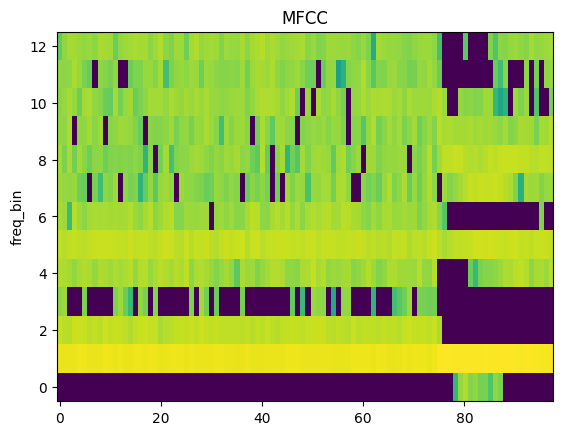

In [ ]:
transform = T.MFCC(sample_rate=sample_rate, n_mfcc=13, melkwargs={"n_fft": 400, "hop_length": 160, "n_mels": 23, "center": False},)
mfcc = transform(waveform)
plot_spectrogram(mfcc[0], title="MFCC")

En el código se crea la función aplicar_MFCC para crear los datasets transformados a coeficientes MFCC, computando su derivada y doble derivada, además de integrar el label del dataset original.

In [ ]:
def aplicar_MFCC (transform, dataset):
  MFCC_dataset = []
  for d in dataset:
    mfcc = transform(d[0])[0]
    delta = torchaudio.functional.compute_deltas(mfcc)
    delta2 = torchaudio.functional.compute_deltas(delta)
    MFCC_dataset.append([mfcc,delta,delta2, d[2]])
  return MFCC_dataset


### Ejemplo MFCC

Se prueba el código y se visualizan sus valores.

backward
backward
backward


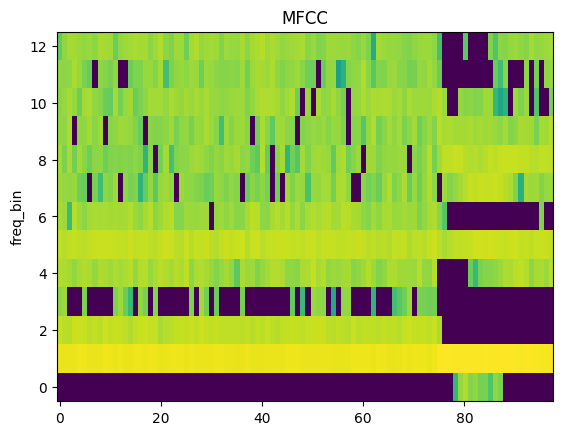

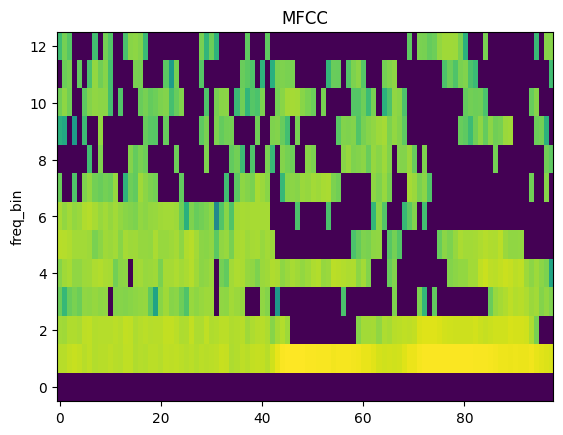

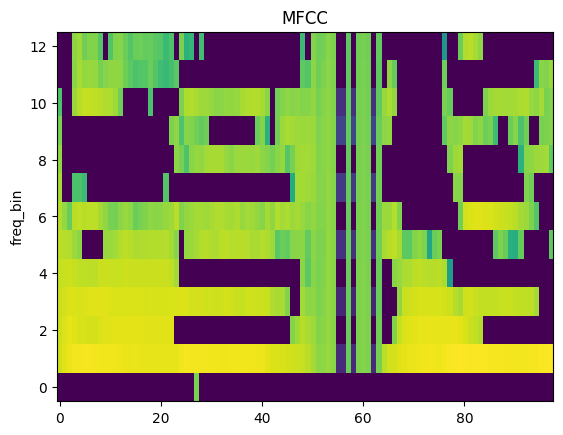

In [ ]:
MFCC_train_10 = aplicar_MFCC(transform, train_dataset)
MFCC_val_10 = aplicar_MFCC(transform, val_dataset)
MFCC_test_10 = aplicar_MFCC(transform, test_dataset)
plot_spectrogram(MFCC_train_10[0] [0], title="MFCC")
print (MFCC_train_10[0][3])
plot_spectrogram(MFCC_val_10[0] [0], title="MFCC")
print (MFCC_val_10[0][3])
plot_spectrogram(MFCC_test_10[0] [0], title="MFCC")
print (MFCC_test_10[0][3])

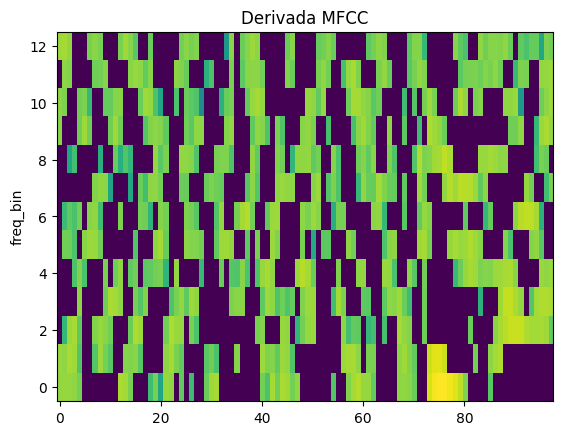

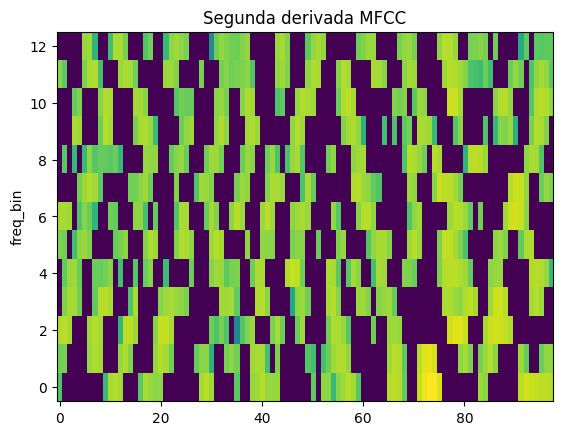

In [ ]:
plot_spectrogram(MFCC_train_10[0] [1], title="Derivada MFCC")
plot_spectrogram(MFCC_train_10[0] [2], title="Segunda derivada MFCC")

## Muestra de los datos

Se van a estudiar las características de las muestras originales de los datasets, desde el tamaño y distribución de cada clase al largo de los audios almacenados como tensores.

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from collections import Counter
import pandas as pd

In [ ]:
total = len (train_dataset) + len (test_dataset) + len (val_dataset)
print (f"Total = {total}")
print (f"Largo train: {len (train_dataset)}")
print (f"% train: {len (train_dataset)/total}")
print (f"Largo test: {len (test_dataset)}")
print (f"% test {len (test_dataset)/total}")
print (f"Largo val: {len (val_dataset)}")
print (f"% val: {len (val_dataset)/total}")

In [ ]:
def plot_labels(dataset, name):
    labels = []

    # extrae solo las etiquetas
    for i in range(len(dataset)):
        item = dataset[i]
        label = item[2] if len(item) > 2 else item[1]
        labels.append(label)

    counts = Counter(labels)
    # 10 etiquetas más frecuentes
    top10 = set([label for label, _ in counts.most_common(10)])
    # clasificar las demás como "unknown"
    labels_clasificadas = [label if label in top10 else "unknown" for label in labels]
    # nuevo conteo con "unknown"
    counts_final = Counter(labels_clasificadas)
    keys = np.array(list(counts_final.keys()))
    values = np.array(list(counts_final.values()), dtype=int)

    plt.figure(figsize=(12, 6))
    plt.bar(keys, values)
    plt.xlabel("Etiquetas")
    plt.ylabel("Frecuencia")
    plt.title(f"Distribución de etiquetas en el dataset {name}")
    plt.xticks(rotation=90)
    plt.tight_layout()
    plt.show()
    return labels

labels_train = plot_labels (train_dataset, "Train dataset")
labels_val =plot_labels (val_dataset, "Val dataset")
labels_test =plot_labels (test_dataset, "Test dataset")


In [ ]:
# Supongamos que tienes un elemento del dataset
waveform, sample_rate, label, speaker_id, utterance_number = train_dataset[1000]

# Guardar como archivo wav
torchaudio.save("ejemplo_train.wav", waveform, sample_rate)

print(f"Archivo guardado en ejemplo.wav, clase: {label}")

# Supongamos que tienes un elemento del dataset
waveform, sample_rate, label, speaker_id, utterance_number = val_dataset[500]
# Guardar como archivo wav
torchaudio.save("ejemplo_val.wav", waveform, sample_rate)

print(f"Archivo guardado en ejemplo_val.wav, clase:{label}")

# Supongamos que tienes un elemento del dataset
waveform, sample_rate, label, speaker_id, utterance_number = test_dataset[200]

# Guardar como archivo wav
torchaudio.save("ejemplo_test.wav", waveform, sample_rate)

print(f"Archivo guardado en ejemplo_test.wav, clase:{label}")

Audio("ejemplo_train.wav")

In [ ]:
Audio("ejemplo_val.wav")

In [ ]:
Audio("ejemplo_test.wav")

In [ ]:
def duracion (dataset):
  list_duration = []
  list_largo = []
  for valor in dataset:
    waveform, _, _,_ ,_ = valor
    num_samples = waveform.shape[-1]
    duracion_segundos = num_samples / sample_rate
    list_duration.append (duracion_segundos)
    list_largo.append (waveform.shape[-1])
  array_duration = np.array (list_duration)
  array_largo = np.array (list_largo)
  print (f"Promedio largo: {np.mean (array_largo)}")
  print (f"Mediana largo: {np.median (array_largo)}")
  print (f"Promedio duración: {np.mean (array_duration)}")
  print (f"Mediana duración: {np.median (array_duration)}")

duracion (train_dataset)
duracion (val_dataset)
duracion (test_dataset)


In [ ]:
def rango(dataset, labels):
    largo = len(np.unique (labels))
    matriz = np.zeros((largo, 3), dtype=object)  # permitir strings y números
    matriz[:, 0] = np.array(np.unique (labels), dtype=object)
    matriz[:, 1] = np.inf
    matriz[:, 2] = -np.inf

    for valor in dataset:
        waveform, _, label, _, _ = valor
        i = np.where(matriz[:, 0] == label)[0]
        matriz[i, 1] = min(waveform.min().item(), matriz[i, 1])
        matriz[i, 2] = max(waveform.max().item(), matriz[i, 2])
    df = pd.DataFrame(matriz)
    df.columns = ['Labels', 'Min', 'Max']
    return df
print (np.unique (labels_train))
print (rango(train_dataset, labels_train))
print (rango(val_dataset, labels_train))
print (rango(test_dataset, labels_train))

In [ ]:
import pandas as pd

def rango(dataset, labels):
    # etiquetas base conocidas (únicas)
    unique_labels = [str(lbl).strip().lower() for lbl in np.unique(labels)]
    largo = len(unique_labels)
    matriz = np.zeros((largo, 3), dtype=object)
    matriz[:, 0] = np.array(unique_labels, dtype=object)
    matriz[:, 1] = np.inf
    matriz[:, 2] = -np.inf

    for valor in dataset:
        waveform, _, label, _, _ = valor
        label = str(label).strip().lower()  # normaliza
        # si no pertenece al conjunto conocido → usar 'unknown'
        if label not in unique_labels:
            label = 'unknown'

        i = np.where(matriz[:, 0] == label)[0][0]
        matriz[i, 1] = min(waveform.min().item(), matriz[i, 1])
        matriz[i, 2] = max(waveform.max().item(), matriz[i, 2])

    df = pd.DataFrame(matriz, columns=['Label', 'Min', 'Max'])
    return df

# Ejemplo de uso
print("Train:")
print(rango(train_dataset, labels_train), "\n")

print("Validation:")
print(rango(val_dataset, labels_train), "\n")

print("Test:")
print(rango(test_dataset, labels_train))


## Variación en mfcc

Se va a observar cómo la variacion en los parámetros n_fft y hop_lenght afectan a cómo se cosntruyen los coeficientes de MFCC.

n_ftt: mayor valor, mayor resolución frecuencia y menor temporal (no se detectan cambios rápidos en frecuencia).

hop_lenght: solapamiento. Al aumentar el hop_length, se incrementa la distancia entre cada ventana de análisis. Esto reduce el solapamiento entre las ventanas.  La información sobre eventos acústicos rápidos (como los cambios bruscos en el sonido) se pierde, ya que se están muestreando con menos frecuencia.

### n_fft

In [ ]:
transform = T.MFCC(sample_rate=sample_rate, n_mfcc=13, melkwargs={"n_fft": 200, "hop_length": 160, "n_mels": 23, "center": False},)
waveform, _, _, _ ,_ = train_dataset [0]
mfcc = transform(waveform)
plot_spectrogram(mfcc[0], title="MFCC")

In [ ]:
transform = T.MFCC(sample_rate=sample_rate, n_mfcc=13, melkwargs={"n_fft": 400, "hop_length": 160, "n_mels": 23, "center": False},)
waveform, _, _, _ ,_ = train_dataset [0]
mfcc = transform(waveform)
plot_spectrogram(mfcc[0], title="MFCC")

In [ ]:
transform = T.MFCC(sample_rate=sample_rate, n_mfcc=13, melkwargs={"n_fft": 600, "hop_length": 160, "n_mels": 23, "center": False},)
waveform, _, _, _ ,_ = train_dataset [0]
mfcc = transform(waveform)
plot_spectrogram(mfcc[0], title="MFCC")

### hop_lenght

En los siguientes códigos se visualizan los coeficientes MFCC junto con su tamaño para distintos hop_lenghts que se van a usar en el entrenamiento de las redes.

In [ ]:
transform = T.MFCC(sample_rate=sample_rate, n_mfcc=13, melkwargs={"n_fft": 200, "hop_length": 35, "n_mels": 23, "center": False},)
waveform, _, _, _ ,_ = train_dataset [0]
mfcc = transform(waveform)
plot_spectrogram(mfcc[0], title="MFCC")
print (mfcc [0].shape)

In [ ]:
transform = T.MFCC(sample_rate=sample_rate, n_mfcc=13, melkwargs={"n_fft": 200, "hop_length": 75, "n_mels": 23, "center": False},)
waveform, _, _, _ ,_ = train_dataset [0]
mfcc = transform(waveform)
plot_spectrogram(mfcc[0], title="MFCC")
print (mfcc [0].shape)

In [ ]:
transform = T.MFCC(sample_rate=sample_rate, n_mfcc=13, melkwargs={"n_fft": 200, "hop_length": 100, "n_mels": 23, "center": False},)
waveform, _, _, _ ,_ = train_dataset [0]
mfcc = transform(waveform)
plot_spectrogram(mfcc[0], title="MFCC")
print (mfcc [0].shape)

In [ ]:
transform = T.MFCC(sample_rate=sample_rate, n_mfcc=13, melkwargs={"n_fft": 200, "hop_length": 130, "n_mels": 23, "center": False},)
waveform, _, _, _ ,_ = train_dataset [0]
mfcc = transform(waveform)
plot_spectrogram(mfcc[0], title="MFCC")
print (mfcc [0].shape)

In [ ]:
transform = T.MFCC(sample_rate=sample_rate, n_mfcc=13, melkwargs={"n_fft": 200, "hop_length": 160, "n_mels": 23, "center": False},)
waveform, _, _, _ ,_ = train_dataset [0]
mfcc = transform(waveform)
plot_spectrogram(mfcc[0], title="MFCC")
print (mfcc [0].shape)

In [ ]:
transform = T.MFCC(sample_rate=sample_rate, n_mfcc=13, melkwargs={"n_fft": 200, "hop_length": 220, "n_mels": 23, "center": False},)
waveform, _, _, _ ,_ = train_dataset [0]
mfcc = transform(waveform)
plot_spectrogram(mfcc[0], title="MFCC")
print (mfcc [0].shape)

In [ ]:
transform = T.MFCC(sample_rate=sample_rate, n_mfcc=13, melkwargs={"n_fft": 200, "hop_length": 280, "n_mels": 23, "center": False},)
waveform, _, _, _ ,_ = train_dataset [0]
mfcc = transform(waveform)
plot_spectrogram(mfcc[0], title="MFCC")
print (mfcc [0].shape)

In [ ]:
transform = T.MFCC(sample_rate=sample_rate, n_mfcc=13, melkwargs={"n_fft": 200, "hop_length": 360, "n_mels": 23, "center": False},)
waveform, _, _, _ ,_ = train_dataset [0]
mfcc = transform(waveform)
plot_spectrogram(mfcc[0], title="MFCC")
print (mfcc [0].shape)

## Conteo clases más comunes

En esta parte se van a identificar las clases más frecuentes y asignar el resto al conjunto unknown para balancear el entrenamiento.

In [ ]:
# Leer el archivo .txt
with open("train_list.txt", "r") as f:
    lineas = f.readlines()

# Extraer la palabra (carpeta/clase) antes del '/'
clases = [linea.strip().split('/')[0] for linea in lineas]

# Contar cuántos ejemplos hay de cada clase
cuentas = Counter(clases)

# Mostrar las 15 clases más frecuentes
print("15 clases más frecuentes:")
for palabra, cantidad in cuentas.most_common(15):
    print(f"{palabra:10s} : {cantidad}")


15 clases más frecuentes:
yes        : 2948
no         : 2948
up         : 2948
down       : 2948
left       : 2948
right      : 2948
on         : 2948
off        : 2948
stop       : 2948
go         : 2948
backward   : 119
bed        : 119
bird       : 119
cat        : 119
dog        : 119


In [ ]:
clases_10 = ['yes','no','up','down','left','right','on','off','stop','go']

def relabel(dataset,mfc):
    clases10_mf = []
    for wav, sr, label, spk, utn in dataset :
        if label not in mfc:
            label = "unknown"
        clases10_mf.append((wav, sr, label, spk, utn))
    return clases10_mf

train_dataset1 = relabel(train_dataset, clases_10)
val_dataset1   = relabel(val_dataset, clases_10)
test_dataset1  = relabel(test_dataset, clases_10)


## Preprocesamiento de dataset y transformación a MFCC

Se va a ajustar el largo de los audios y se va a crear el dataset base para verificar cuáles son los mejores parámetros para cada arquitectura.

In [ ]:

# Ajusta todos los waveforms al mismo largo
def adjust_len(tensor, target_len):
    n_features, T = tensor.shape
    if T < target_len:
        # Rellenar con ceros
        tensor = F.pad(tensor, (0, target_len - T))
    elif T > target_len:
        # Recortar si es más largo
        tensor = tensor[:, :target_len]
    return tensor

def adaptar_len_dataset (dataset, target_len_waveform):
    dataset_waveforms_fixed = []
    for waveform, sr, label, speaker, utterance in dataset:
        waveform_fixed = adjust_len(waveform, target_len_waveform)
        dataset_waveforms_fixed.append((waveform_fixed, sr, label, speaker, utterance))
    return dataset_waveforms_fixed

In [ ]:
train_adaptado = adaptar_len_dataset (train_dataset1, 16000)
val_adaptado = adaptar_len_dataset (val_dataset1, 16000)
test_adaptado = adaptar_len_dataset (test_dataset1, 16000)

In [ ]:
# Estándar con 160 hop
transform = T.MFCC(sample_rate=sample_rate, n_mfcc=13, melkwargs={"n_fft": 400, "hop_length": 160, "n_mels": 23, "center": False},)
MFCC_train_10 = aplicar_MFCC(transform, train_adaptado)
MFCC_val_10 = aplicar_MFCC(transform, val_adaptado)
MFCC_test_10 = aplicar_MFCC(transform, test_adaptado)

## Creación de modelos

En esta parte se van a especificar los dataloaders para entregar los datos y entrenar los modelos.

In [ ]:
def get_label_mapping(data_list):
    labels = sorted(set(d[3] for d in data_list))
    return {lbl: i for i, lbl in enumerate(labels)}
label_map = get_label_mapping(MFCC_train_10)

class SpeechCommandsMFCC(Dataset):
    def __init__(self, data, label_num):
        self.data = data
        #labels = sorted(set(d[3] for d in data_list))
        #return {lbl: i for i, lbl in enumerate(labels)}
        self.label_num = label_num

    def __getitem__(self, idx):
        mfcc, d1, d2, label = self.data[idx]
        x = torch.cat([mfcc, d1, d2], dim=0)
        y = self.label_num[label]
        return x, y

    def __len__(self):
        return len(self.data)


In [ ]:
def load (MFCC_train, MFCC_val, MFCC_test, batch_size=64):
    tr = SpeechCommandsMFCC(MFCC_train, label_num=label_map)
    print(tr.label_num)
    va = SpeechCommandsMFCC(MFCC_val, label_num=label_map)
    print(va.label_num)
    te = SpeechCommandsMFCC(MFCC_test, label_num=label_map)
    print(te.label_num)
    return (DataLoader(tr, batch_size=batch_size, shuffle=True),
            DataLoader(va, batch_size=batch_size, shuffle=False),
            DataLoader(te, batch_size=batch_size, shuffle=False))


Se definen a continuación los modelos de redes neuronales recurrentes a usar.

In [ ]:
class RNNVanilla(nn.Module):
    def __init__(self, input_size=39, hidden_size=128, num_layers=1,
                 bidirectional=False, nonlinearity="tanh", num_classes=11):
        super().__init__()
        self.rnn = nn.RNN(input_size, hidden_size, num_layers=num_layers,
                          nonlinearity=nonlinearity, bidirectional=bidirectional,
                          batch_first=True)
        bod_ = hidden_size * (2 if bidirectional else 1)
        self.fc = nn.Linear(bod_, num_classes)

    def forward(self, x):
        x = x.transpose(1, 2)
        _, mf_h = self.rnn(x)
        if self.rnn.bidirectional:
            mf_h_final = torch.cat([mf_h[-2], mf_h[-1]], dim=1)
        else:
            mf_h_final = mf_h[-1]
        return self.fc(mf_h_final)


In [ ]:
class GRUModel(nn.Module):
    def __init__(self, input_size=39, hidden_size=128, num_layers=1, bidirectional=False, num_classes=11):
        super().__init__()
        self.gru = nn.GRU(input_size, hidden_size, num_layers=num_layers, bidirectional=bidirectional, batch_first=True, dropout=0.2)
        bod_ = hidden_size * (2 if bidirectional else 1)
        self.fc = nn.Linear(bod_, num_classes)
    def forward(self, x):
        x = x.transpose(1,2)
        _, h = self.gru(x)
        mf_h_final = torch.cat([h[-2], h[-1]], dim=1) if self.gru.bidirectional else h[-1]
        return self.fc(mf_h_final)


In [ ]:

class LSTMModel(nn.Module):
    def __init__(self, input_size=39, hidden_size=128, num_layers=1, bidirectional=False, num_classes=11):
        super().__init__()
        self.lstm = nn.LSTM(input_size, hidden_size, num_layers=num_layers, bidirectional=bidirectional, batch_first=True)
        bod_ = hidden_size * (2 if bidirectional else 1)
        self.fc = nn.Linear(bod_, num_classes)
    def forward(self, x):
        x = x.transpose(1,2)
        _, (h, _) = self.lstm(x)
        mf_h_final = torch.cat([h[-2], h[-1]], dim=1) if self.lstm.bidirectional else h[-1]
        return self.fc(mf_h_final)

In [ ]:
class CNN1DModel(nn.Module):
    def __init__(self, input_size=39, hidden_size=128, num_layers=1, bidirectional=False, num_classes=11):
        super().__init__()

        self.conv_blocks = nn.Sequential(
            nn.Conv1d(input_size, input_size * 2, kernel_size=3, padding="same"),
            nn.ReLU(),
            nn.MaxPool1d(kernel_size=2),
        )

        self.gru = GRUModel(
            input_size=input_size * 2,
            hidden_size=hidden_size,
            num_layers=num_layers,
            bidirectional=bidirectional,
            num_classes=num_classes,
        )

    def forward(self, x):
        #x = x.permute(0, 2, 1)
        out = self.conv_blocks(x)
        #out = out.permute(0, 2, 1)
        return self.gru(out)




In [ ]:
class CNN1DModel_2(nn.Module):
    def __init__(self, input_size=39, hidden_size=128, num_layers=1, bidirectional=False, num_classes=11):
        super().__init__()

        self.conv_blocks = nn.Sequential(
            nn.Conv1d(input_size, input_size * 2, kernel_size=3, padding="same"),
            nn.ReLU(),
            nn.MaxPool1d(kernel_size=2),
            nn.Conv1d(input_size * 2, input_size * 2, kernel_size=3, padding="same"),
            nn.ReLU(),
            nn.MaxPool1d(kernel_size=2),
        )

        self.gru = GRUModel(
            input_size=input_size * 2,
            hidden_size=hidden_size,
            num_layers=num_layers,
            bidirectional=bidirectional,
            num_classes=num_classes,
        )

    def forward(self, x):
        #x = x.permute(0, 2, 1)
        out = self.conv_blocks(x)
        #out = out.permute(0, 2, 1)
        return self.gru(out)


In [ ]:
def train_step(x_batch, y_batch, model, optimizer, criterion):
    model.train()
    y_pred = model(x_batch)
    loss = criterion(y_pred, y_batch)
    optimizer.zero_grad()
    loss.backward()
    optimizer.step()
    return y_pred, loss

@torch.no_grad()
def evaluate(val_loader, model, criterion, device="cpu"):
    model.eval()
    cumulative_loss = 0.0
    cumulative_predictions = 0
    data_count = 0

    for x_val, y_val in val_loader:
        x_val, y_val = x_val.to(device), y_val.to(device)
        y_predicted = model(x_val)
        loss = criterion(y_predicted, y_val)
        class_prediction = torch.argmax(y_predicted, dim=1).long()

        cumulative_predictions += (y_val == class_prediction).sum().item()
        cumulative_loss += loss.item()
        data_count += y_val.size(0)

    val_acc = cumulative_predictions / data_count
    val_loss = cumulative_loss / max(1, len(val_loader))
    return val_acc, val_loss

def train_model(
    model,
    train_loader,
    val_loader,
    epochs,
    criterion,
    lr,
    device="cpu",
    n_evaluations_per_epoch=6,
    early_stopping_patience=None,
):
    if device == "cuda" and torch.cuda.is_available():
        model = model.cuda()

    optimizer = torch.optim.Adam(model.parameters(), lr=lr)

    curves = {"train_acc": [], "val_acc": [], "train_loss": [], "val_loss": []}
    t0 = time.perf_counter()
    iteration = 0
    n_batches = len(train_loader)

    best_val_acc = -1.0
    best_state = None
    patience = 0

    for epoch in range(epochs):
        print(f"\rEpoch {epoch + 1}/{epochs}")
        cumulative_train_loss = 0.0
        cumulative_train_corrects = 0
        train_loss_count = 0
        train_acc_count = 0

        model.train()
        for i, (x_batch, y_batch) in enumerate(train_loader):
            x_batch = x_batch.to(device)
            y_batch = y_batch.to(device)

            y_predicted, loss = train_step(x_batch, y_batch, model, optimizer, criterion)

            cumulative_train_loss += loss.item()
            train_loss_count += 1
            train_acc_count += y_batch.size(0)

            class_prediction = torch.argmax(y_predicted, dim=1).long()
            cumulative_train_corrects += (y_batch == class_prediction).sum().item()

            if (i % max(1, (n_batches // max(1, n_evaluations_per_epoch))) == 0) and (i > 0):
                train_loss = cumulative_train_loss / train_loss_count
                train_acc = cumulative_train_corrects / train_acc_count
                print(f"Iteration {iteration} - Batch {i}/{len(train_loader)} - "
                      f"Train loss: {train_loss:.4f}, Train acc: {train_acc:.2%}")
            iteration += 1

        # validación
        val_acc, val_loss = evaluate(val_loader, model, criterion, device=device)
        train_loss = cumulative_train_loss / max(1, train_loss_count)
        train_acc = cumulative_train_corrects / max(1, train_acc_count)

        print(f"Val loss: {val_loss:.4f}, Val acc: {val_acc:.2%}")

        curves["train_acc"].append(train_acc)
        curves["val_acc"].append(val_acc)
        curves["train_loss"].append(train_loss)
        curves["val_loss"].append(val_loss)

        # early stopping
        if early_stopping_patience is not None:
            if val_acc > best_val_acc:
                best_val_acc = val_acc
                best_state = {k: v.detach().cpu() for k, v in model.state_dict().items()}
                patience = 0
            else:
                patience += 1
                if patience >= early_stopping_patience:
                    print(f"Early stopping: sin mejora en {early_stopping_patience} épocas.")
                    if best_state is not None:
                        model.load_state_dict(best_state)
                    break

    print(f"\nTiempo total de entrenamiento: {time.perf_counter() - t0:.4f} [s]")
    model.cpu()
    return curves



In [ ]:
def show_curves(curves, title = None, filename = None):
    fig, ax = plt.subplots(1, 2, figsize=(13, 5))
    fig.set_facecolor('white')

    epochs = np.arange(len(curves["val_loss"])) + 1

    ax[0].plot(epochs, curves['val_loss'], label='validation')
    ax[0].plot(epochs, curves['train_loss'], label='training')
    ax[0].set_xlabel('Epoch')
    ax[0].set_ylabel('Loss')
    ax[0].set_ylim(0.0,3.0)
    ax[0].set_title('Loss evolution during training')
    ax[0].legend()

    ax[1].plot(epochs, curves['val_acc'], label='validation')
    ax[1].plot(epochs, curves['train_acc'], label='training')
    ax[1].set_xlabel('Epoch')
    ax[1].set_ylabel('Accuracy')
    ax[1].set_ylim(0.0,1.0)
    ax[1].set_title('Accuracy evolution during training')
    ax[1].legend()

    if title is not None:
        fig.suptitle(title)

    if filename is not None:
        plt.savefig(filename)

    plt.show()


In [ ]:
import json
import numpy as np
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay, classification_report, accuracy_score
import matplotlib.pyplot as plt

def show_confusion_matrix(
    y_true, y_pred, class_names,
    title=None, normalize=True,
    filename=None, selected_classes=None,
    metrics_filename=None
):
    # Índices completos
    labels = list(range(len(class_names)))

    # Matriz completa
    cm = confusion_matrix(y_true, y_pred, labels=labels)

    # Normalización
    if normalize:
        cm = cm.astype(float) / cm.sum(axis=1, keepdims=True).clip(min=1)

    # =====================================================
    # 🔹 FILTRO DE CLASES (versión corregida)
    # =====================================================
    if selected_classes is not None:

        selected_indices = [class_names.index(c) for c in selected_classes]

        # Filtrar matriz
        cm_filtered = cm[np.ix_(selected_indices, selected_indices)]

        # Remapear labels
        mask = np.isin(y_true, selected_indices)

        y_true_f = np.array([selected_indices.index(t) for t in np.array(y_true)[mask]])
        y_pred_f = np.array([
            selected_indices.index(p) if p in selected_indices else -1
            for p in np.array(y_pred)[mask]
        ])

        valid = y_pred_f != -1
        y_true_f = y_true_f[valid]
        y_pred_f = y_pred_f[valid]

        class_names_f = selected_classes
        cm = cm_filtered

    else:
        y_true_f = np.array(y_true)
        y_pred_f = np.array(y_pred)
        class_names_f = class_names

    # =====================================================
    # 🔹 GRÁFICO (idéntico al tuyo original)
    # =====================================================
    fig, ax = plt.subplots(figsize=(len(class_names_f)*0.6 + 6,
                                    len(class_names_f)*0.6 + 5))

    disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=class_names_f)
    disp.plot(ax=ax, xticks_rotation=90,
              values_format=".2f" if normalize else "d",
              cmap="Blues", colorbar=True)

    disp.ax_.tick_params(axis='x', labelsize=10)
    disp.ax_.tick_params(axis='y', labelsize=10)

    for text in disp.text_.ravel():
        text.set_fontsize(8)

    ax.set_xlabel("Predicción", fontsize=12)
    ax.set_ylabel("Verdad", fontsize=12)
    ax.set_title(title or "Matriz de Confusión", fontsize=14)

    plt.subplots_adjust(bottom=0.25, left=0.25, right=0.95, top=0.9)

    if filename:
        plt.savefig(filename, dpi=300, bbox_inches="tight")
    plt.show()

    # =====================================================
    # 🔹 PRINT DE MÉTRICAS (idéntico al tuyo)
    # =====================================================
    print(classification_report(
        y_true_f, y_pred_f,
        target_names=class_names_f
    ))

    accuracy = accuracy_score(y_true_f, y_pred_f)
    print(f"Precisión global (Accuracy): {accuracy:.4f}")

    # =====================================================
    # 🔹 GUARDAR JSON
    # =====================================================
    if metrics_filename is None:
        if filename:
            metrics_filename = filename.replace(".png", "_metrics.json")
        else:
            metrics_filename = "metrics.json"

    metrics_to_save = {
        "accuracy": float(accuracy),
        "classification_report": classification_report(
            y_true_f, y_pred_f,
            target_names=class_names_f,
            output_dict=True
        ),
        "confusion_matrix": cm.tolist(),
        "class_names": class_names_f,
        "normalized": normalize
    }

    with open(metrics_filename, "w") as f:
        json.dump(metrics_to_save, f, indent=4)

    print(f"📁 Métricas guardadas en: {metrics_filename}")








In [ ]:
train_dl, val_dl, test_dl = load (MFCC_train_10, MFCC_val_10, MFCC_test_10, batch_size=64)
dataset_instance = test_dl.dataset
num_label = {i: lbl for lbl, i in dataset_instance.label_num.items()}
class_names = [num_label[i] for i in sorted(num_label.keys())]

{'down': 0, 'go': 1, 'left': 2, 'no': 3, 'off': 4, 'on': 5, 'right': 6, 'stop': 7, 'unknown': 8, 'up': 9, 'yes': 10}
{'down': 0, 'go': 1, 'left': 2, 'no': 3, 'off': 4, 'on': 5, 'right': 6, 'stop': 7, 'unknown': 8, 'up': 9, 'yes': 10}
{'down': 0, 'go': 1, 'left': 2, 'no': 3, 'off': 4, 'on': 5, 'right': 6, 'stop': 7, 'unknown': 8, 'up': 9, 'yes': 10}


## Entrenamiento y experimentos

### RNN Vanilla


#### Variación de neuronas por capa

In [ ]:
device = "cuda" if torch.cuda.is_available() else "cpu"

clases_10 = ['down','go','left','no','off','on','right','stop','unkwown','up', "yes"]
train_dl, val_dl, test_dl = load (MFCC_train_10, MFCC_val_10, MFCC_test_10, batch_size=64)

model = RNNVanilla(input_size=39, hidden_size=128, num_layers=1,
                   bidirectional=False, nonlinearity="tanh", num_classes=11)

criterion = nn.CrossEntropyLoss()

curves = train_model(
    model, train_dl, val_dl,
    epochs=40, lr=1e-3, criterion=criterion,
    device=device, early_stopping_patience=7
)

show_curves(curves, title="RNN H = 128, L = 1, T = 98", filename="rnn_vanilla_h=128.png")

In [ ]:
@torch.no_grad()
def get_predictions(loader, model, device="cpu"):
    """Obtiene las predicciones del modelo y las etiquetas verdaderas."""
    model.eval()
    all_predictions = []
    all_true_labels = []
    for xb, yb in loader:
        xb, yb = xb.to(device), yb.to(device)

        pred = model(xb).argmax(1)

        all_predictions.extend(pred.cpu().numpy())
        all_true_labels.extend(yb.cpu().numpy())
    return all_true_labels, all_predictions

true_labels, predictions = get_predictions(test_dl, model.to(device), device)

show_confusion_matrix(true_labels, predictions, class_names, title="Matriz de Confusión ", filename = "matriz_de_confusión_H=128")

In [ ]:
device = "cuda" if torch.cuda.is_available() else "cpu"


train_dl, val_dl, test_dl = load (MFCC_train_10, MFCC_val_10, MFCC_test_10, batch_size=64)

model = RNNVanilla(input_size=39, hidden_size=64, num_layers=1,
                   bidirectional=False, nonlinearity="tanh", num_classes=11)

criterion = nn.CrossEntropyLoss()

curves = train_model(
    model, train_dl, val_dl,
    epochs=40, lr=1e-3, criterion=criterion,
    device=device, early_stopping_patience=7
)

show_curves(curves, title="RNN vanilla H=64, L=1, T=98", filename="rnn_vanilla_H=64.png")

In [ ]:
@torch.no_grad()
def get_predictions(loader, model, device="cpu"):
    """Obtiene las predicciones del modelo y las etiquetas verdaderas."""
    model.eval()
    all_predictions = []
    all_true_labels = []
    for xb, yb in loader:
        xb, yb = xb.to(device), yb.to(device)

        pred = model(xb).argmax(1)

        all_predictions.extend(pred.cpu().numpy())
        all_true_labels.extend(yb.cpu().numpy())
    return all_true_labels, all_predictions

true_labels, predictions = get_predictions(test_dl, model.to(device), device)

show_confusion_matrix(true_labels, predictions, class_names, title="Matriz de Confusión", filename = "matriz_de_confusión_H=64")


In [ ]:
device = "cuda" if torch.cuda.is_available() else "cpu"


train_dl, val_dl, test_dl = load (MFCC_train_10, MFCC_val_10, MFCC_test_10, batch_size=64)

model = RNNVanilla(input_size=39, hidden_size=256, num_layers=1,
                   bidirectional=False, nonlinearity="tanh", num_classes=11)

criterion = nn.CrossEntropyLoss()

curves = train_model(
    model, train_dl, val_dl,
    epochs=40, lr=1e-3, criterion=criterion,
    device=device, early_stopping_patience=7
)

show_curves(curves, title="RNN vanilla H=256, L=1, T=98", filename="rnn_vanilla_H=256.png")

In [ ]:
@torch.no_grad()
def get_predictions(loader, model, device="cpu"):
    """Obtiene las predicciones del modelo y las etiquetas verdaderas."""
    model.eval()
    all_predictions = []
    all_true_labels = []
    for xb, yb in loader:
        xb, yb = xb.to(device), yb.to(device)

        pred = model(xb).argmax(1)

        all_predictions.extend(pred.cpu().numpy())
        all_true_labels.extend(yb.cpu().numpy())
    return all_true_labels, all_predictions

true_labels, predictions = get_predictions(test_dl, model.to(device), device)

show_confusion_matrix(true_labels, predictions, class_names, title="Matriz de Confusión", filename = "matriz_de_confusión_h=256")


#### Variación número de capas

In [ ]:
device = "cuda" if torch.cuda.is_available() else "cpu"


train_dl, val_dl, test_dl = load (MFCC_train_10, MFCC_val_10, MFCC_test_10, batch_size=64)

model =RNNVanilla(input_size=39, hidden_size=128, num_layers=2,
                   bidirectional=False,nonlinearity="tanh", num_classes=11)

criterion = nn.CrossEntropyLoss()

curves = train_model(
    model, train_dl, val_dl,
    epochs=40, lr=1e-3, criterion=criterion,
    device=device, early_stopping_patience=7
)

show_curves(curves, title="RNN vanilla H=128, L=2, T=98)", filename="gru_vanilla_L=2.png")

In [ ]:
@torch.no_grad()
def get_predictions(loader, model, device="cpu"):
    """Obtiene las predicciones del modelo y las etiquetas verdaderas."""
    model.eval()
    all_predictions = []
    all_true_labels = []
    for xb, yb in loader:
        xb, yb = xb.to(device), yb.to(device)

        pred = model(xb).argmax(1)

        all_predictions.extend(pred.cpu().numpy())
        all_true_labels.extend(yb.cpu().numpy())
    return all_true_labels, all_predictions

true_labels, predictions = get_predictions(test_dl, model.to(device), device)

show_confusion_matrix(true_labels, predictions, class_names, title="Matriz de Confusión", filename = "matriz_de_confusión_L=2")

In [ ]:
device = "cuda" if torch.cuda.is_available() else "cpu"
train_dl, val_dl, test_dl = load (MFCC_train_10, MFCC_val_10, MFCC_test_10, batch_size=64)

model = RNNVanilla(input_size=39, hidden_size=128, num_layers=3,
                   bidirectional=False, nonlinearity="tanh", num_classes=11)

criterion = nn.CrossEntropyLoss()

curves = train_model(
    model, train_dl, val_dl,
    epochs=40, lr=1e-3, criterion=criterion,
    device=device, early_stopping_patience=7
)

show_curves(curves, title="RNN vanilla H=128, L=3, T=98", filename="gru_vanilla_L=3.png")

In [ ]:
@torch.no_grad()
def get_predictions(loader, model, device="cpu"):
    """Obtiene las predicciones del modelo y las etiquetas verdaderas."""
    model.eval()
    all_predictions = []
    all_true_labels = []
    for xb, yb in loader:
        xb, yb = xb.to(device), yb.to(device)

        pred = model(xb).argmax(1)

        all_predictions.extend(pred.cpu().numpy())
        all_true_labels.extend(yb.cpu().numpy())
    return all_true_labels, all_predictions

true_labels, predictions = get_predictions(test_dl, model.to(device), device)

show_confusion_matrix(true_labels, predictions, class_names, title="Matriz de Confusión", filename = "LM_matriz_de_confusión_L=3")

#### Variación largo de secuencia

Para variar el largo de secuencia, se va redefinir el dataset a usar con diferentes valores de hop_lenght.

In [ ]:
# Con 75 hop (mayor largo de secuencia)
transform = T.MFCC(sample_rate=sample_rate, n_mfcc=13, melkwargs={"n_fft": 400, "hop_length": 75, "n_mels": 23, "center": False},)
MFCC_train_10 = aplicar_MFCC(transform, train_adaptado)
MFCC_val_10 = aplicar_MFCC(transform, val_adaptado)
MFCC_test_10 = aplicar_MFCC(transform, test_adaptado)

In [ ]:
device = "cuda" if torch.cuda.is_available() else "cpu"
train_dl, val_dl, test_dl = load (MFCC_train_10, MFCC_val_10, MFCC_test_10, batch_size=64)

model = RNNVanilla(input_size=39, hidden_size=128, num_layers=1,
                   bidirectional=True,nonlinearity="tanh", num_classes=11)

criterion = nn.CrossEntropyLoss()

curves = train_model(
    model, train_dl, val_dl,
    epochs=40, lr=1e-3, criterion=criterion,
    device=device, early_stopping_patience=7
)

show_curves(curves, title="RNN vanilla H=128, L=1, T=120" , filename="gru_vanilla_B=TRUE.png")

In [ ]:
@torch.no_grad()
def get_predictions(loader, model, device="cpu"):
    """Obtiene las predicciones del modelo y las etiquetas verdaderas."""
    model.eval()
    all_predictions = []
    all_true_labels = []
    for xb, yb in loader:
        xb, yb = xb.to(device), yb.to(device)

        pred = model(xb).argmax(1)

        all_predictions.extend(pred.cpu().numpy())
        all_true_labels.extend(yb.cpu().numpy())
    return all_true_labels, all_predictions

true_labels, predictions = get_predictions(test_dl, model.to(device), device)

show_confusion_matrix(true_labels, predictions, class_names, title="Matriz de Confusión", filename = "RNN_matriz_de_confusión_b=True")

In [ ]:
# Con 100 hop (mayor largo de secuencia)
transform = T.MFCC(sample_rate=sample_rate, n_mfcc=13, melkwargs={"n_fft": 400, "hop_length": 100, "n_mels": 23, "center": False},)
MFCC_train_10 = aplicar_MFCC(transform, train_adaptado)
MFCC_val_10 = aplicar_MFCC(transform, val_adaptado)
MFCC_test_10 = aplicar_MFCC(transform, test_adaptado)

In [ ]:
device = "cuda" if torch.cuda.is_available() else "cpu"


train_dl, val_dl, test_dl = load (MFCC_train_10, MFCC_val_10, MFCC_test_10, batch_size=64)

model = RNNVanilla(input_size=39, hidden_size=128, num_layers=1,
                   bidirectional=False,nonlinearity="tanh", num_classes=11)

criterion = nn.CrossEntropyLoss()

curves = train_model(
    model, train_dl, val_dl,
    epochs=40, lr=1e-3, criterion=criterion,
    device=device, early_stopping_patience=7
)

show_curves(curves, title="RNN vanilla H=128, L=1, T=50", filename="rnn_vanilla_relu.png")

In [ ]:
@torch.no_grad()
def get_predictions(loader, model, device="cpu"):
    """Obtiene las predicciones del modelo y las etiquetas verdaderas."""
    model.eval()
    all_predictions = []
    all_true_labels = []
    for xb, yb in loader:
        xb, yb = xb.to(device), yb.to(device)

        pred = model(xb).argmax(1)

        all_predictions.extend(pred.cpu().numpy())
        all_true_labels.extend(yb.cpu().numpy())
    return all_true_labels, all_predictions

true_labels, predictions = get_predictions(test_dl, model.to(device), device)

show_confusion_matrix(true_labels, predictions, class_names, title="Matriz de Confusión", filename = "matriz_de_confusión_relu")

In [ ]:
transform = T.MFCC(sample_rate=sample_rate, n_mfcc=13, melkwargs={"n_fft": 400, "hop_length": 130, "n_mels": 23, "center": False},)
MFCC_train_10 = aplicar_MFCC(transform, train_adaptado)
MFCC_val_10 = aplicar_MFCC(transform, val_adaptado)
MFCC_test_10 = aplicar_MFCC(transform, test_adaptado)

In [ ]:
device = "cuda" if torch.cuda.is_available() else "cpu"


train_dl, val_dl, test_dl = load (MFCC_train_10, MFCC_val_10, MFCC_test_10, batch_size=64)

model = RNNVanilla(input_size=39, hidden_size=128, num_layers=1,
                   bidirectional=False,nonlinearity="tanh", num_classes=11)

criterion = nn.CrossEntropyLoss()

curves = train_model(
    model, train_dl, val_dl,
    epochs=40, lr=1e-3, criterion=criterion,
    device=device, early_stopping_patience=7
)

show_curves(curves, title="RNN vanilla H=128, L=1, T=50", filename="rnn_vanilla_relu.png")

In [ ]:
@torch.no_grad()
def get_predictions(loader, model, device="cpu"):
    """Obtiene las predicciones del modelo y las etiquetas verdaderas."""
    model.eval()
    all_predictions = []
    all_true_labels = []
    for xb, yb in loader:
        xb, yb = xb.to(device), yb.to(device)

        pred = model(xb).argmax(1)

        all_predictions.extend(pred.cpu().numpy())
        all_true_labels.extend(yb.cpu().numpy())
    return all_true_labels, all_predictions

true_labels, predictions = get_predictions(test_dl, model.to(device), device)

show_confusion_matrix(true_labels, predictions, class_names, title="Matriz de Confusión", filename = "matriz_de_confusión_relu")

In [ ]:
# Con 220 hop (mayor largo de secuencia)
transform = T.MFCC(sample_rate=sample_rate, n_mfcc=13, melkwargs={"n_fft": 400, "hop_length": 220, "n_mels": 23, "center": False},)
MFCC_train_10 = aplicar_MFCC(transform, train_adaptado)
MFCC_val_10 = aplicar_MFCC(transform, val_adaptado)
MFCC_test_10 = aplicar_MFCC(transform, test_adaptado)

In [ ]:

device = "cuda" if torch.cuda.is_available() else "cpu"


train_dl, val_dl, test_dl = load (MFCC_train_10, MFCC_val_10, MFCC_test_10, batch_size=64)

model = RNNVanilla(input_size=39, hidden_size=128, num_layers=1,
                   bidirectional=False,nonlinearity="tanh", num_classes=11)

criterion = nn.CrossEntropyLoss()

curves = train_model(
    model, train_dl, val_dl,
    epochs=40, lr=1e-3, criterion=criterion,
    device=device, early_stopping_patience=7
)

show_curves(curves, title="RNN vanilla H=128, L=1, T=50", filename="rnn_vanilla_relu.png")


In [ ]:
@torch.no_grad()
def get_predictions(loader, model, device="cpu"):
    """Obtiene las predicciones del modelo y las etiquetas verdaderas."""
    model.eval()
    all_predictions = []
    all_true_labels = []
    for xb, yb in loader:
        xb, yb = xb.to(device), yb.to(device)

        pred = model(xb).argmax(1)

        all_predictions.extend(pred.cpu().numpy())
        all_true_labels.extend(yb.cpu().numpy())
    return all_true_labels, all_predictions

true_labels, predictions = get_predictions(test_dl, model.to(device), device)

show_confusion_matrix(true_labels, predictions, class_names, title="Matriz de Confusión", filename = "matriz_de_confusión_relu")

In [ ]:
# Con 280 hop
transform = T.MFCC(sample_rate=sample_rate, n_mfcc=13, melkwargs={"n_fft": 400, "hop_length": 280, "n_mels": 23, "center": False},)
MFCC_train_10 = aplicar_MFCC(transform, train_adaptado)
MFCC_val_10 = aplicar_MFCC(transform, val_adaptado)
MFCC_test_10 = aplicar_MFCC(transform, test_adaptado)

In [ ]:
device = "cuda" if torch.cuda.is_available() else "cpu"


train_dl, val_dl, test_dl = load (MFCC_train_10, MFCC_val_10, MFCC_test_10, batch_size=64)

model = RNNVanilla(input_size=39, hidden_size=128, num_layers=1,
                   bidirectional=False,nonlinearity="tanh", num_classes=11)

criterion = nn.CrossEntropyLoss()

curves = train_model(
    model, train_dl, val_dl,
    epochs=40, lr=1e-3, criterion=criterion,
    device=device, early_stopping_patience=7
)

show_curves(curves, title="RNN vanilla H=128, L=1, T=50", filename="rnn_vanilla_relu.png")

In [ ]:
@torch.no_grad()
def get_predictions(loader, model, device="cpu"):
    """Obtiene las predicciones del modelo y las etiquetas verdaderas."""
    model.eval()
    all_predictions = []
    all_true_labels = []
    for xb, yb in loader:
        xb, yb = xb.to(device), yb.to(device)

        pred = model(xb).argmax(1)

        all_predictions.extend(pred.cpu().numpy())
        all_true_labels.extend(yb.cpu().numpy())
    return all_true_labels, all_predictions

true_labels, predictions = get_predictions(test_dl, model.to(device), device)

show_confusion_matrix(true_labels, predictions, class_names, title="Matriz de Confusión", filename = "matriz_de_confusión_relu")

In [ ]:
# Con 360 hop (mayor largo de secuencia)
transform = T.MFCC(sample_rate=sample_rate, n_mfcc=13, melkwargs={"n_fft": 400, "hop_length": 360, "n_mels": 23, "center": False},)
MFCC_train_10 = aplicar_MFCC(transform, train_adaptado)
MFCC_val_10 = aplicar_MFCC(transform, val_adaptado)
MFCC_test_10 = aplicar_MFCC(transform, test_adaptado)

In [ ]:
device = "cuda" if torch.cuda.is_available() else "cpu"


train_dl, val_dl, test_dl = load (MFCC_train_10, MFCC_val_10, MFCC_test_10, batch_size=64)

model = RNNVanilla(input_size=39, hidden_size=128, num_layers=1,
                   bidirectional=False,nonlinearity="tanh", num_classes=11)

criterion = nn.CrossEntropyLoss()

curves = train_model(
    model, train_dl, val_dl,
    epochs=40, lr=1e-3, criterion=criterion,
    device=device, early_stopping_patience=7
)

show_curves(curves, title="RNN vanilla H=128, L=1, T=50", filename="rnn_vanilla_relu.png")

In [ ]:
@torch.no_grad()
def get_predictions(loader, model, device="cpu"):
    """Obtiene las predicciones del modelo y las etiquetas verdaderas."""
    model.eval()
    all_predictions = []
    all_true_labels = []
    for xb, yb in loader:
        xb, yb = xb.to(device), yb.to(device)

        pred = model(xb).argmax(1)

        all_predictions.extend(pred.cpu().numpy())
        all_true_labels.extend(yb.cpu().numpy())
    return all_true_labels, all_predictions

true_labels, predictions = get_predictions(test_dl, model.to(device), device)

show_confusion_matrix(true_labels, predictions, class_names, title="Matriz de Confusión", filename = "matriz_de_confusión_relu")

### Modelo gru

#### Variación número de neuronas por capa

In [ ]:
transform = T.MFCC(sample_rate=sample_rate, n_mfcc=13, melkwargs={"n_fft": 400, "hop_length": 160, "n_mels": 23, "center": False},)
MFCC_train_10 = aplicar_MFCC(transform, train_adaptado)
MFCC_val_10 = aplicar_MFCC(transform, val_adaptado)
MFCC_test_10 = aplicar_MFCC(transform, test_adaptado)

In [ ]:
device = "cuda" if torch.cuda.is_available() else "cpu"


train_dl, val_dl, test_dl = load (MFCC_train_10, MFCC_val_10, MFCC_test_10, batch_size=64)

model = GRUModel(input_size=39, hidden_size=128, num_layers=1,
                   bidirectional=False, num_classes=11)

criterion = nn.CrossEntropyLoss()

curves = train_model(
    model, train_dl, val_dl,
    epochs=40, lr=1e-3, criterion=criterion,
    device=device, early_stopping_patience=7
)

show_curves(curves, title="GRU H=128, L=1, T=98", filename="gru_h=128.png")

In [ ]:
@torch.no_grad()
def get_predictions(loader, model, device="cpu"):
    """Obtiene las predicciones del modelo y las etiquetas verdaderas."""
    model.eval()
    all_predictions = []
    all_true_labels = []
    for xb, yb in loader:
        xb, yb = xb.to(device), yb.to(device)

        pred = model(xb).argmax(1)

        all_predictions.extend(pred.cpu().numpy())
        all_true_labels.extend(yb.cpu().numpy())
    return all_true_labels, all_predictions

true_labels, predictions = get_predictions(test_dl, model.to(device), device)

show_confusion_matrix(true_labels, predictions, class_names, title="Matriz de Confusión", filename = "matrizg_de_confusión_h=128")

In [ ]:
device = "cuda" if torch.cuda.is_available() else "cpu"


train_dl, val_dl, test_dl = load (MFCC_train_10, MFCC_val_10, MFCC_test_10, batch_size=64)

model = GRUModel(input_size=39, hidden_size=256, num_layers=1,
                   bidirectional=False, num_classes=11)

criterion = nn.CrossEntropyLoss()

curves = train_model(
    model, train_dl, val_dl,
    epochs=20, lr=1e-3, criterion=criterion,
    device=device, early_stopping_patience=7
)

show_curves(curves, title="GRU H=256, L=1, T=98", filename="gru_h=256.png")

In [ ]:
@torch.no_grad()
def get_predictions(loader, model, device="cpu"):
    """Obtiene las predicciones del modelo y las etiquetas verdaderas."""
    model.eval()
    all_predictions = []
    all_true_labels = []
    for xb, yb in loader:
        xb, yb = xb.to(device), yb.to(device)

        pred = model(xb).argmax(1)

        all_predictions.extend(pred.cpu().numpy())
        all_true_labels.extend(yb.cpu().numpy())
    return all_true_labels, all_predictions

true_labels, predictions = get_predictions(test_dl, model.to(device), device)

show_confusion_matrix(true_labels, predictions, class_names, title="Matriz de Confusión", filename = "matrizg_de_confusión_h=256")

In [ ]:
device = "cuda" if torch.cuda.is_available() else "cpu"


train_dl, val_dl, test_dl = load (MFCC_train_10, MFCC_val_10, MFCC_test_10, batch_size=64)

model = GRUModel(input_size=39, hidden_size=64, num_layers=1,
                   bidirectional=False, num_classes=11)

criterion = nn.CrossEntropyLoss()

curves = train_model(
    model, train_dl, val_dl,
    epochs=40, lr=1e-3, criterion=criterion,
    device=device, early_stopping_patience=7
)

show_curves(curves, title="GRU H=64, L=1, T=98", filename="gru_h=64.png")

In [ ]:
@torch.no_grad()
def get_predictions(loader, model, device="cpu"):
    """Obtiene las predicciones del modelo y las etiquetas verdaderas."""
    model.eval()
    all_predictions = []
    all_true_labels = []
    for xb, yb in loader:
        xb, yb = xb.to(device), yb.to(device)

        pred = model(xb).argmax(1)

        all_predictions.extend(pred.cpu().numpy())
        all_true_labels.extend(yb.cpu().numpy())
    return all_true_labels, all_predictions

true_labels, predictions = get_predictions(test_dl, model.to(device), device)

show_confusion_matrix(true_labels, predictions, class_names, title="Matriz de Confusión", filename = "matrizg_de_confusión_h=64")

#### Variación número de capas

In [ ]:
device = "cuda" if torch.cuda.is_available() else "cpu"


train_dl, val_dl, test_dl = load (MFCC_train_10, MFCC_val_10, MFCC_test_10, batch_size=64)

model = GRUModel(input_size=39, hidden_size=128, num_layers=2,
                   bidirectional=False, num_classes=11)

criterion = nn.CrossEntropyLoss()

curves = train_model(
    model, train_dl, val_dl,
    epochs=40, lr=1e-3, criterion=criterion,
    device=device, early_stopping_patience=7
)

show_curves(curves, title="GRU H=128, L=2, T=98", filename="gru_L=2.png")

In [ ]:
@torch.no_grad()
def get_predictions(loader, model, device="cpu"):
    """Obtiene las predicciones del modelo y las etiquetas verdaderas."""
    model.eval()
    all_predictions = []
    all_true_labels = []
    for xb, yb in loader:
        xb, yb = xb.to(device), yb.to(device)

        pred = model(xb).argmax(1)

        all_predictions.extend(pred.cpu().numpy())
        all_true_labels.extend(yb.cpu().numpy())
    return all_true_labels, all_predictions

true_labels, predictions = get_predictions(test_dl, model.to(device), device)

show_confusion_matrix(true_labels, predictions, class_names, title="Matriz de Confusión", filename = "matrizg_de_confusión_L=2")

In [ ]:
device = "cuda" if torch.cuda.is_available() else "cpu"


train_dl, val_dl, test_dl = load (MFCC_train_10, MFCC_val_10, MFCC_test_10, batch_size=64)

model = GRUModel(input_size=39, hidden_size=128, num_layers=3,
                   bidirectional=True, num_classes=11)

criterion = nn.CrossEntropyLoss()

curves = train_model(
    model, train_dl, val_dl,
    epochs=40, lr=1e-3, criterion=criterion,
    device=device, early_stopping_patience=7
)

show_curves(curves, title="GRU H=128, L=2, T=98", filename="gru_L=2.png")

In [ ]:
@torch.no_grad()
def get_predictions(loader, model, device="cpu"):
    """Obtiene las predicciones del modelo y las etiquetas verdaderas."""
    model.eval()
    all_predictions = []
    all_true_labels = []
    for xb, yb in loader:
        xb, yb = xb.to(device), yb.to(device)

        pred = model(xb).argmax(1)

        all_predictions.extend(pred.cpu().numpy())
        all_true_labels.extend(yb.cpu().numpy())
    return all_true_labels, all_predictions

true_labels, predictions = get_predictions(test_dl, model.to(device), device)

show_confusion_matrix(true_labels, predictions, class_names, title="Matriz de Confusión", filename = "matrizg_de_confusión_tr=2")

#### Mejor modelo

In [ ]:
device = "cuda" if torch.cuda.is_available() else "cpu"


train_dl, val_dl, test_dl = load (MFCC_train_10, MFCC_val_10, MFCC_test_10, batch_size=64)

model = GRUModel(input_size=39, hidden_size=256, num_layers=3,
                   bidirectional=True, num_classes=11)

criterion = nn.CrossEntropyLoss()

curves = train_model(
    model, train_dl, val_dl,
    epochs=40, lr=1e-3, criterion=criterion,
    device=device, early_stopping_patience=7
)

show_curves(curves, title="GRU H=128, L=2, T=98", filename="gru_L=2.png")

In [ ]:
@torch.no_grad()
def get_predictions(loader, model, device="cpu"):
    """Obtiene las predicciones del modelo y las etiquetas verdaderas."""
    model.eval()
    all_predictions = []
    all_true_labels = []
    for xb, yb in loader:
        xb, yb = xb.to(device), yb.to(device)

        pred = model(xb).argmax(1)

        all_predictions.extend(pred.cpu().numpy())
        all_true_labels.extend(yb.cpu().numpy())
    return all_true_labels, all_predictions

true_labels, predictions = get_predictions(test_dl, model.to(device), device)

show_confusion_matrix(true_labels, predictions, class_names, title="Matriz de Confusión", filename = "matrizg_de_confusión_tr=2")


#### Variación largo de secuencia

In [ ]:
MFCC_train_10 = 0
MFCC_val_10 = 0
MFCC_test_10 = 0

In [ ]:
transform = T.MFCC(sample_rate=sample_rate, n_mfcc=13, melkwargs={"n_fft": 400, "hop_length": 35, "n_mels": 23, "center": False},)
MFCC_train_10 = aplicar_MFCC(transform, train_adaptado)
MFCC_val_10 = aplicar_MFCC(transform, val_adaptado)
MFCC_test_10 = aplicar_MFCC(transform, test_adaptado)

In [ ]:
device = "cuda" if torch.cuda.is_available() else "cpu"


train_dl, val_dl, test_dl = load (MFCC_train_10, MFCC_val_10, MFCC_test_10, batch_size=64)

model = GRUModel(input_size=39, hidden_size=128, num_layers=1,
                   bidirectional=True, num_classes=11)

criterion = nn.CrossEntropyLoss()

curves = train_model(
    model, train_dl, val_dl,
    epochs=40, lr=1e-3, criterion=criterion,
    device=device, early_stopping_patience=7
)

show_curves(curves, title="GRU H=128, L=1, T=120", filename="gru_L=2.png")

In [ ]:
@torch.no_grad()
def get_predictions(loader, model, device="cpu"):
    """Obtiene las predicciones del modelo y las etiquetas verdaderas."""
    model.eval()
    all_predictions = []
    all_true_labels = []
    for xb, yb in loader:
        xb, yb = xb.to(device), yb.to(device)

        pred = model(xb).argmax(1)

        all_predictions.extend(pred.cpu().numpy())
        all_true_labels.extend(yb.cpu().numpy())
    return all_true_labels, all_predictions

true_labels, predictions = get_predictions(test_dl, model.to(device), device)

show_confusion_matrix(true_labels, predictions, class_names, title="Matriz de Confusión", filename = "matrizg_de_confusión_tr=2")

In [ ]:
transform = T.MFCC(sample_rate=sample_rate, n_mfcc=13, melkwargs={"n_fft": 400, "hop_length": 50, "n_mels": 23, "center": False},)
MFCC_train_10 = aplicar_MFCC(transform, train_adaptado)
MFCC_val_10 = aplicar_MFCC(transform, val_adaptado)
MFCC_test_10 = aplicar_MFCC(transform, test_adaptado)

In [ ]:
device = "cuda" if torch.cuda.is_available() else "cpu"


train_dl, val_dl, test_dl = load (MFCC_train_10, MFCC_val_10, MFCC_test_10, batch_size=64)

model = GRUModel(input_size=39, hidden_size=128, num_layers=1,
                   bidirectional=True, num_classes=11)

criterion = nn.CrossEntropyLoss()

curves = train_model(
    model, train_dl, val_dl,
    epochs=40, lr=1e-3, criterion=criterion,
    device=device, early_stopping_patience=7
)

show_curves(curves, title="GRU H=128, L=1, T=120", filename="gru_L=2.png")

In [ ]:
@torch.no_grad()
def get_predictions(loader, model, device="cpu"):
    """Obtiene las predicciones del modelo y las etiquetas verdaderas."""
    model.eval()
    all_predictions = []
    all_true_labels = []
    for xb, yb in loader:
        xb, yb = xb.to(device), yb.to(device)

        pred = model(xb).argmax(1)

        all_predictions.extend(pred.cpu().numpy())
        all_true_labels.extend(yb.cpu().numpy())
    return all_true_labels, all_predictions

true_labels, predictions = get_predictions(test_dl, model.to(device), device)

show_confusion_matrix(true_labels, predictions, class_names, title="Matriz de Confusión", filename = "matrizg_de_confusión_tr=2")

In [ ]:
# Con 75 hop (mayor largo de secuencia)
transform = T.MFCC(sample_rate=sample_rate, n_mfcc=13, melkwargs={"n_fft": 400, "hop_length": 75, "n_mels": 23, "center": False},)
MFCC_train_10 = aplicar_MFCC(transform, train_adaptado)
MFCC_val_10 = aplicar_MFCC(transform, val_adaptado)
MFCC_test_10 = aplicar_MFCC(transform, test_adaptado)

In [ ]:
device = "cuda" if torch.cuda.is_available() else "cpu"


train_dl, val_dl, test_dl = load (MFCC_train_10, MFCC_val_10, MFCC_test_10, batch_size=64)

model = GRUModel(input_size=39, hidden_size=128, num_layers=1,
                   bidirectional=True, num_classes=11)

criterion = nn.CrossEntropyLoss()

curves = train_model(
    model, train_dl, val_dl,
    epochs=40, lr=1e-3, criterion=criterion,
    device=device, early_stopping_patience=7
)

show_curves(curves, title="GRU H=128, L=1, T=120", filename="gru_L=2.png")

In [ ]:
@torch.no_grad()
def get_predictions(loader, model, device="cpu"):
    """Obtiene las predicciones del modelo y las etiquetas verdaderas."""
    model.eval()
    all_predictions = []
    all_true_labels = []
    for xb, yb in loader:
        xb, yb = xb.to(device), yb.to(device)

        pred = model(xb).argmax(1)

        all_predictions.extend(pred.cpu().numpy())
        all_true_labels.extend(yb.cpu().numpy())
    return all_true_labels, all_predictions

true_labels, predictions = get_predictions(test_dl, model.to(device), device)

show_confusion_matrix(true_labels, predictions, class_names, title="Matriz de Confusión", filename = "matrizg_de_confusión_tr=2")

In [ ]:
# Con 100 hop
transform = T.MFCC(sample_rate=sample_rate, n_mfcc=13, melkwargs={"n_fft": 400, "hop_length": 100, "n_mels": 23, "center": False},)
MFCC_train_10 = aplicar_MFCC(transform, train_adaptado)
MFCC_val_10 = aplicar_MFCC(transform, val_adaptado)
MFCC_test_10 = aplicar_MFCC(transform, test_adaptado)

In [ ]:
device = "cuda" if torch.cuda.is_available() else "cpu"


train_dl, val_dl, test_dl = load (MFCC_train_10, MFCC_val_10, MFCC_test_10, batch_size=64)

model = GRUModel(input_size=39, hidden_size=128, num_layers=1,
                   bidirectional=True, num_classes=11)

criterion = nn.CrossEntropyLoss()

curves = train_model(
    model, train_dl, val_dl,
    epochs=40, lr=1e-3, criterion=criterion,
    device=device, early_stopping_patience=7
)

show_curves(curves, title="GRU H=128, L=1, T=50", filename="gru_L=2.png")

In [ ]:
@torch.no_grad()
def get_predictions(loader, model, device="cpu"):
    """Obtiene las predicciones del modelo y las etiquetas verdaderas."""
    model.eval()
    all_predictions = []
    all_true_labels = []
    for xb, yb in loader:
        xb, yb = xb.to(device), yb.to(device)

        pred = model(xb).argmax(1)

        all_predictions.extend(pred.cpu().numpy())
        all_true_labels.extend(yb.cpu().numpy())
    return all_true_labels, all_predictions

true_labels, predictions = get_predictions(test_dl, model.to(device), device)

show_confusion_matrix(true_labels, predictions, class_names, title="Matriz de Confusión", filename = "matrizg_de_confusión_tr=2")

In [ ]:
# Con 130 hop
transform = T.MFCC(sample_rate=sample_rate, n_mfcc=13, melkwargs={"n_fft": 400, "hop_length": 130, "n_mels": 23, "center": False},)
MFCC_train_10 = aplicar_MFCC(transform, train_adaptado)
MFCC_val_10 = aplicar_MFCC(transform, val_adaptado)
MFCC_test_10 = aplicar_MFCC(transform, test_adaptado)

In [ ]:
device = "cuda" if torch.cuda.is_available() else "cpu"


train_dl, val_dl, test_dl = load (MFCC_train_10, MFCC_val_10, MFCC_test_10, batch_size=64)

model = GRUModel(input_size=39, hidden_size=128, num_layers=1,
                   bidirectional=False, num_classes=11)

criterion = nn.CrossEntropyLoss()

curves = train_model(
    model, train_dl, val_dl,
    epochs=40, lr=1e-3, criterion=criterion,
    device=device, early_stopping_patience=7
)

show_curves(curves, title="GRU H=128, L=1, T=120", filename="gru_L=2.png")

In [ ]:
@torch.no_grad()
def get_predictions(loader, model, device="cpu"):
    """Obtiene las predicciones del modelo y las etiquetas verdaderas."""
    model.eval()
    all_predictions = []
    all_true_labels = []
    for xb, yb in loader:
        xb, yb = xb.to(device), yb.to(device)

        pred = model(xb).argmax(1)

        all_predictions.extend(pred.cpu().numpy())
        all_true_labels.extend(yb.cpu().numpy())
    return all_true_labels, all_predictions

true_labels, predictions = get_predictions(test_dl, model.to(device), device)

show_confusion_matrix(true_labels, predictions, class_names, title="Matriz de Confusión", filename = "matrizg_de_confusión_tr=2")

In [ ]:
# Con 220 hop
transform = T.MFCC(sample_rate=sample_rate, n_mfcc=13, melkwargs={"n_fft": 400, "hop_length": 220, "n_mels": 23, "center": False},)
MFCC_train_10 = aplicar_MFCC(transform, train_adaptado)
MFCC_val_10 = aplicar_MFCC(transform, val_adaptado)
MFCC_test_10 = aplicar_MFCC(transform, test_adaptado)

In [ ]:
device = "cuda" if torch.cuda.is_available() else "cpu"


train_dl, val_dl, test_dl = load (MFCC_train_10, MFCC_val_10, MFCC_test_10, batch_size=64)

model = GRUModel(input_size=39, hidden_size=128, num_layers=1,
                   bidirectional=False, num_classes=11)

criterion = nn.CrossEntropyLoss()

curves = train_model(
    model, train_dl, val_dl,
    epochs=40, lr=1e-3, criterion=criterion,
    device=device, early_stopping_patience=7
)

show_curves(curves, title="GRU H=128, L=1, T=160", filename="gru_L=2.png")

In [ ]:
@torch.no_grad()
def get_predictions(loader, model, device="cpu"):
    """Obtiene las predicciones del modelo y las etiquetas verdaderas."""
    model.eval()
    all_predictions = []
    all_true_labels = []
    for xb, yb in loader:
        xb, yb = xb.to(device), yb.to(device)

        pred = model(xb).argmax(1)

        all_predictions.extend(pred.cpu().numpy())
        all_true_labels.extend(yb.cpu().numpy())
    return all_true_labels, all_predictions

true_labels, predictions = get_predictions(test_dl, model.to(device), device)

show_confusion_matrix(true_labels, predictions, class_names, title="Matriz de Confusión", filename = "matrizg_de_confusión_tr=2")

In [ ]:
# Con 280 hop
transform = T.MFCC(sample_rate=sample_rate, n_mfcc=13, melkwargs={"n_fft": 400, "hop_length": 280, "n_mels": 23, "center": False},)
MFCC_train_10 = aplicar_MFCC(transform, train_adaptado)
MFCC_val_10 = aplicar_MFCC(transform, val_adaptado)
MFCC_test_10 = aplicar_MFCC(transform, test_adaptado)

In [ ]:
device = "cuda" if torch.cuda.is_available() else "cpu"


train_dl, val_dl, test_dl = load (MFCC_train_10, MFCC_val_10, MFCC_test_10, batch_size=64)

model = GRUModel(input_size=39, hidden_size=128, num_layers=2,
                   bidirectional=False, num_classes=11)

criterion = nn.CrossEntropyLoss()

curves = train_model(
    model, train_dl, val_dl,
    epochs=40, lr=1e-3, criterion=criterion,
    device=device, early_stopping_patience=7
)

show_curves(curves, title="GRU H=128, L=2, T=150", filename="gru_L=2.png")

In [ ]:
@torch.no_grad()
def get_predictions(loader, model, device="cpu"):
    """Obtiene las predicciones del modelo y las etiquetas verdaderas."""
    model.eval()
    all_predictions = []
    all_true_labels = []
    for xb, yb in loader:
        xb, yb = xb.to(device), yb.to(device)

        pred = model(xb).argmax(1)

        all_predictions.extend(pred.cpu().numpy())
        all_true_labels.extend(yb.cpu().numpy())
    return all_true_labels, all_predictions

true_labels, predictions = get_predictions(test_dl, model.to(device), device)

show_confusion_matrix(true_labels, predictions, class_names, title="Matriz de Confusión", filename = "matrizg_de_confusión_L=2")

In [ ]:
# Con 360 hop
transform = T.MFCC(sample_rate=sample_rate, n_mfcc=13, melkwargs={"n_fft": 400, "hop_length": 360, "n_mels": 23, "center": False},)
MFCC_train_10 = aplicar_MFCC(transform, train_adaptado)
MFCC_val_10 = aplicar_MFCC(transform, val_adaptado)
MFCC_test_10 = aplicar_MFCC(transform, test_adaptado)

In [ ]:
device = "cuda" if torch.cuda.is_available() else "cpu"


train_dl, val_dl, test_dl = load (MFCC_train_10, MFCC_val_10, MFCC_test_10, batch_size=64)

model = GRUModel(input_size=39, hidden_size=128, num_layers=2,
                   bidirectional=False, num_classes=11)

criterion = nn.CrossEntropyLoss()

curves = train_model(
    model, train_dl, val_dl,
    epochs=40, lr=1e-3, criterion=criterion,
    device=device, early_stopping_patience=7
)

show_curves(curves, title="GRU H=128, L=2, T=150", filename="gru_L=2.png")

In [ ]:
@torch.no_grad()
def get_predictions(loader, model, device="cpu"):
    """Obtiene las predicciones del modelo y las etiquetas verdaderas."""
    model.eval()
    all_predictions = []
    all_true_labels = []
    for xb, yb in loader:
        xb, yb = xb.to(device), yb.to(device)

        pred = model(xb).argmax(1)

        all_predictions.extend(pred.cpu().numpy())
        all_true_labels.extend(yb.cpu().numpy())
    return all_true_labels, all_predictions

true_labels, predictions = get_predictions(test_dl, model.to(device), device)

show_confusion_matrix(true_labels, predictions, class_names, title="Matriz de Confusión", filename = "matrizg_de_confusión_L=2")

### Modelo LSTM

#### Variación número de neuronas por capa

In [ ]:
# Con 160 hop
transform = T.MFCC(sample_rate=sample_rate, n_mfcc=13, melkwargs={"n_fft": 400, "hop_length": 160, "n_mels": 23, "center": False},)
MFCC_train_10 = aplicar_MFCC(transform, train_adaptado)
MFCC_val_10 = aplicar_MFCC(transform, val_adaptado)
MFCC_test_10 = aplicar_MFCC(transform, test_adaptado)

In [ ]:
device = "cuda" if torch.cuda.is_available() else "cpu"


train_dl, val_dl, test_dl = load (MFCC_train_10, MFCC_val_10, MFCC_test_10, batch_size=64)

model = LSTMModel(input_size=39, hidden_size=128, num_layers=1,
                   bidirectional=False, num_classes=11)

criterion = nn.CrossEntropyLoss()

curves = train_model(
    model, train_dl, val_dl,
    epochs=40, lr=1e-3, criterion=criterion,
    device=device, early_stopping_patience=7
)

show_curves(curves, title="LSTM H=128, L=1, T=98", filename="LSTM_H=128.png")

In [ ]:
@torch.no_grad()
def get_predictions(loader, model, device="cpu"):
    """Obtiene las predicciones del modelo y las etiquetas verdaderas."""
    model.eval()
    all_predictions = []
    all_true_labels = []
    for xb, yb in loader:
        xb, yb = xb.to(device), yb.to(device)

        pred = model(xb).argmax(1)

        all_predictions.extend(pred.cpu().numpy())
        all_true_labels.extend(yb.cpu().numpy())
    return all_true_labels, all_predictions

true_labels, predictions = get_predictions(test_dl, model.to(device), device)

show_confusion_matrix(true_labels, predictions, class_names, title="Matriz de Confusión", filename = "matrizg_de_confusión_L=2")

In [ ]:
device = "cuda" if torch.cuda.is_available() else "cpu"


train_dl, val_dl, test_dl = load (MFCC_train_10, MFCC_val_10, MFCC_test_10, batch_size=64)

model = LSTMModel(input_size=39, hidden_size=256, num_layers=1,
                   bidirectional=False, num_classes=11)

criterion = nn.CrossEntropyLoss()

curves = train_model(
    model, train_dl, val_dl,
    epochs=40, lr=1e-3, criterion=criterion,
    device=device, early_stopping_patience=7
)

show_curves(curves, title="LSTM H=256, L=1, T=98", filename="LSTM_H=128.png")

In [ ]:
@torch.no_grad()
def get_predictions(loader, model, device="cpu"):
    """Obtiene las predicciones del modelo y las etiquetas verdaderas."""
    model.eval()
    all_predictions = []
    all_true_labels = []
    for xb, yb in loader:
        xb, yb = xb.to(device), yb.to(device)

        pred = model(xb).argmax(1)

        all_predictions.extend(pred.cpu().numpy())
        all_true_labels.extend(yb.cpu().numpy())
    return all_true_labels, all_predictions

true_labels, predictions = get_predictions(test_dl, model.to(device), device)

show_confusion_matrix(true_labels, predictions, class_names, title="Matriz de Confusión", filename = "matrizL_de_confusión_H=128")

#### Variacion número de capas

In [ ]:
device = "cuda" if torch.cuda.is_available() else "cpu"


train_dl, val_dl, test_dl = load (MFCC_train_10, MFCC_val_10, MFCC_test_10, batch_size=64)

model = LSTMModel(input_size=39, hidden_size=128, num_layers=2,
                   bidirectional=False, num_classes=11)

criterion = nn.CrossEntropyLoss()

curves = train_model(
    model, train_dl, val_dl,
    epochs=40, lr=1e-3, criterion=criterion,
    device=device, early_stopping_patience=7
)

show_curves(curves, title="LSTM H=256, L=1, T=98", filename="LSTM_H=128.png")

In [ ]:
@torch.no_grad()
def get_predictions(loader, model, device="cpu"):
    """Obtiene las predicciones del modelo y las etiquetas verdaderas."""
    model.eval()
    all_predictions = []
    all_true_labels = []
    for xb, yb in loader:
        xb, yb = xb.to(device), yb.to(device)

        pred = model(xb).argmax(1)

        all_predictions.extend(pred.cpu().numpy())
        all_true_labels.extend(yb.cpu().numpy())
    return all_true_labels, all_predictions

true_labels, predictions = get_predictions(test_dl, model.to(device), device)

show_confusion_matrix(true_labels, predictions, class_names, title="Matriz de Confusión", filename = "matrizL_de_confusión_H=128")

In [ ]:
device = "cuda" if torch.cuda.is_available() else "cpu"


train_dl, val_dl, test_dl = load (MFCC_train_10, MFCC_val_10, MFCC_test_10, batch_size=64)

model = LSTMModel(input_size=39, hidden_size=128, num_layers=3,
                   bidirectional=False, num_classes=11)

criterion = nn.CrossEntropyLoss()

curves = train_model(
    model, train_dl, val_dl,
    epochs=40, lr=1e-3, criterion=criterion,
    device=device, early_stopping_patience=7
)

show_curves(curves, title="LSTM H=256, L=1, T=98", filename="LSTM_H=128.png")

In [ ]:
@torch.no_grad()
def get_predictions(loader, model, device="cpu"):
    """Obtiene las predicciones del modelo y las etiquetas verdaderas."""
    model.eval()
    all_predictions = []
    all_true_labels = []
    for xb, yb in loader:
        xb, yb = xb.to(device), yb.to(device)

        pred = model(xb).argmax(1)

        all_predictions.extend(pred.cpu().numpy())
        all_true_labels.extend(yb.cpu().numpy())
    return all_true_labels, all_predictions

true_labels, predictions = get_predictions(test_dl, model.to(device), device)

show_confusion_matrix(true_labels, predictions, class_names, title="Matriz de Confusión", filename = "matrizL_de_confusión_H=128")

#### Mejor modelo

In [ ]:
device = "cuda" if torch.cuda.is_available() else "cpu"


train_dl, val_dl, test_dl = load (MFCC_train_10, MFCC_val_10, MFCC_test_10, batch_size=64)

model = LSTMModel(input_size=39, hidden_size=256, num_layers=3,
                   bidirectional=False, num_classes=11)

criterion = nn.CrossEntropyLoss()

curves = train_model(
    model, train_dl, val_dl,
    epochs=40, lr=1e-3, criterion=criterion,
    device=device, early_stopping_patience=7
)

show_curves(curves, title="LSTM H=256, L=1, T=98", filename="LSTM_H=128.png")

In [ ]:
@torch.no_grad()
def get_predictions(loader, model, device="cpu"):
    """Obtiene las predicciones del modelo y las etiquetas verdaderas."""
    model.eval()
    all_predictions = []
    all_true_labels = []
    for xb, yb in loader:
        xb, yb = xb.to(device), yb.to(device)

        pred = model(xb).argmax(1)

        all_predictions.extend(pred.cpu().numpy())
        all_true_labels.extend(yb.cpu().numpy())
    return all_true_labels, all_predictions

true_labels, predictions = get_predictions(test_dl, model.to(device), device)

show_confusion_matrix(true_labels, predictions, class_names, title="Matriz de Confusión", filename = "matrizL_de_confusión_H=128")

#### Variación largo de secuencia

In [ ]:
MFCC_train_10 = 0
MFCC_val_10 = 0
MFCC_test_10 = 0

In [ ]:
transform = T.MFCC(sample_rate=sample_rate, n_mfcc=13, melkwargs={"n_fft": 400, "hop_length": 35, "n_mels": 23, "center": False},)
MFCC_train_10 = aplicar_MFCC(transform, train_adaptado)
MFCC_val_10 = aplicar_MFCC(transform, val_adaptado)
MFCC_test_10 = aplicar_MFCC(transform, test_adaptado)

In [ ]:
device = "cuda" if torch.cuda.is_available() else "cpu"


train_dl, val_dl, test_dl = load (MFCC_train_10, MFCC_val_10, MFCC_test_10, batch_size=64)

model = LSTMModel(input_size=39, hidden_size=128, num_layers=1,
                   bidirectional=False, num_classes=11)

criterion = nn.CrossEntropyLoss()

curves = train_model(
    model, train_dl, val_dl,
    epochs=40, lr=1e-3, criterion=criterion,
    device=device, early_stopping_patience=7
)

show_curves(curves, title="LSTM H=128, L=1, T=150", filename="LSTM_H=256.png")

In [ ]:
@torch.no_grad()
def get_predictions(loader, model, device="cpu"):
    """Obtiene las predicciones del modelo y las etiquetas verdaderas."""
    model.eval()
    all_predictions = []
    all_true_labels = []
    for xb, yb in loader:
        xb, yb = xb.to(device), yb.to(device)

        pred = model(xb).argmax(1)

        all_predictions.extend(pred.cpu().numpy())
        all_true_labels.extend(yb.cpu().numpy())
    return all_true_labels, all_predictions

true_labels, predictions = get_predictions(test_dl, model.to(device), device)

show_confusion_matrix(true_labels, predictions, class_names, title="Matriz de Confusión", filename = "matrizL_de_confusión_H=256")

In [ ]:
# Con 50 hop (mayor largo de secuencia)
transform = T.MFCC(sample_rate=sample_rate, n_mfcc=13, melkwargs={"n_fft": 400, "hop_length": 50, "n_mels": 23, "center": False},)
MFCC_train_10 = aplicar_MFCC(transform, train_adaptado)
MFCC_val_10 = aplicar_MFCC(transform, val_adaptado)
MFCC_test_10 = aplicar_MFCC(transform, test_adaptado)

In [ ]:
device = "cuda" if torch.cuda.is_available() else "cpu"


train_dl, val_dl, test_dl = load (MFCC_train_10, MFCC_val_10, MFCC_test_10, batch_size=64)

model = LSTMModel(input_size=39, hidden_size=128, num_layers=1,
                   bidirectional=False, num_classes=11)

criterion = nn.CrossEntropyLoss()

curves = train_model(
    model, train_dl, val_dl,
    epochs=40, lr=1e-3, criterion=criterion,
    device=device, early_stopping_patience=7
)

show_curves(curves, title="LSTM H=128, L=1, T=150", filename="LSTM_H=256.png")

In [ ]:
@torch.no_grad()
def get_predictions(loader, model, device="cpu"):
    """Obtiene las predicciones del modelo y las etiquetas verdaderas."""
    model.eval()
    all_predictions = []
    all_true_labels = []
    for xb, yb in loader:
        xb, yb = xb.to(device), yb.to(device)

        pred = model(xb).argmax(1)

        all_predictions.extend(pred.cpu().numpy())
        all_true_labels.extend(yb.cpu().numpy())
    return all_true_labels, all_predictions

true_labels, predictions = get_predictions(test_dl, model.to(device), device)

show_confusion_matrix(true_labels, predictions, class_names, title="Matriz de Confusión", filename = "matrizL_de_confusión_H=256")

In [ ]:
# Con 75 hop
transform = T.MFCC(sample_rate=sample_rate, n_mfcc=13, melkwargs={"n_fft": 400, "hop_length": 75, "n_mels": 23, "center": False},)
MFCC_train_10 = aplicar_MFCC(transform, train_adaptado)
MFCC_val_10 = aplicar_MFCC(transform, val_adaptado)
MFCC_test_10 = aplicar_MFCC(transform, test_adaptado)

In [ ]:
device = "cuda" if torch.cuda.is_available() else "cpu"


train_dl, val_dl, test_dl = load (MFCC_train_10, MFCC_val_10, MFCC_test_10, batch_size=64)

model = LSTMModel(input_size=39, hidden_size=128, num_layers=1,
                   bidirectional=False, num_classes=11)

criterion = nn.CrossEntropyLoss()

curves = train_model(
    model, train_dl, val_dl,
    epochs=40, lr=1e-3, criterion=criterion,
    device=device, early_stopping_patience=7
)

show_curves(curves, title="LSTM H=128, L=1, T=150", filename="LSTM_H=256.png")

In [ ]:
@torch.no_grad()
def get_predictions(loader, model, device="cpu"):
    """Obtiene las predicciones del modelo y las etiquetas verdaderas."""
    model.eval()
    all_predictions = []
    all_true_labels = []
    for xb, yb in loader:
        xb, yb = xb.to(device), yb.to(device)

        pred = model(xb).argmax(1)

        all_predictions.extend(pred.cpu().numpy())
        all_true_labels.extend(yb.cpu().numpy())
    return all_true_labels, all_predictions

true_labels, predictions = get_predictions(test_dl, model.to(device), device)

show_confusion_matrix(true_labels, predictions, class_names, title="Matriz de Confusión", filename = "matrizL_de_confusión_H=256")

In [ ]:
# Con 100 hop
transform = T.MFCC(sample_rate=sample_rate, n_mfcc=13, melkwargs={"n_fft": 400, "hop_length": 100, "n_mels": 23, "center": False},)
MFCC_train_10 = aplicar_MFCC(transform, train_adaptado)
MFCC_val_10 = aplicar_MFCC(transform, val_adaptado)
MFCC_test_10 = aplicar_MFCC(transform, test_adaptado)

In [ ]:
device = "cuda" if torch.cuda.is_available() else "cpu"


train_dl, val_dl, test_dl = load (MFCC_train_10, MFCC_val_10, MFCC_test_10, batch_size=64)

model = LSTMModel(input_size=39, hidden_size=128, num_layers=1,
                   bidirectional=False, num_classes=11)

criterion = nn.CrossEntropyLoss()

curves = train_model(
    model, train_dl, val_dl,
    epochs=40, lr=1e-3, criterion=criterion,
    device=device, early_stopping_patience=7
)

show_curves(curves, title="LSTM H=128, L=1, T=50", filename="LSTM_H=256.png")

In [ ]:
@torch.no_grad()
def get_predictions(loader, model, device="cpu"):
    """Obtiene las predicciones del modelo y las etiquetas verdaderas."""
    model.eval()
    all_predictions = []
    all_true_labels = []
    for xb, yb in loader:
        xb, yb = xb.to(device), yb.to(device)

        pred = model(xb).argmax(1)

        all_predictions.extend(pred.cpu().numpy())
        all_true_labels.extend(yb.cpu().numpy())
    return all_true_labels, all_predictions

true_labels, predictions = get_predictions(test_dl, model.to(device), device)

show_confusion_matrix(true_labels, predictions, class_names, title="Matriz de Confusión", filename = "matrizL_de_confusión_H=256")

In [ ]:
# Con 130 hop
transform = T.MFCC(sample_rate=sample_rate, n_mfcc=13, melkwargs={"n_fft": 400, "hop_length": 130, "n_mels": 23, "center": False},)
MFCC_train_10 = aplicar_MFCC(transform, train_adaptado)
MFCC_val_10 = aplicar_MFCC(transform, val_adaptado)
MFCC_test_10 = aplicar_MFCC(transform, test_adaptado)

In [ ]:
device = "cuda" if torch.cuda.is_available() else "cpu"


train_dl, val_dl, test_dl = load (MFCC_train_10, MFCC_val_10, MFCC_test_10, batch_size=64)

model = LSTMModel(input_size=39, hidden_size=128, num_layers=1,
                   bidirectional=False, num_classes=11)

criterion = nn.CrossEntropyLoss()

curves = train_model(
    model, train_dl, val_dl,
    epochs=40, lr=1e-3, criterion=criterion,
    device=device, early_stopping_patience=7
)

show_curves(curves, title="LSTM H=128, L=1, T=50", filename="LSTM_H=256.png")

In [ ]:
@torch.no_grad()
def get_predictions(loader, model, device="cpu"):
    """Obtiene las predicciones del modelo y las etiquetas verdaderas."""
    model.eval()
    all_predictions = []
    all_true_labels = []
    for xb, yb in loader:
        xb, yb = xb.to(device), yb.to(device)

        pred = model(xb).argmax(1)

        all_predictions.extend(pred.cpu().numpy())
        all_true_labels.extend(yb.cpu().numpy())
    return all_true_labels, all_predictions

true_labels, predictions = get_predictions(test_dl, model.to(device), device)

show_confusion_matrix(true_labels, predictions, class_names, title="Matriz de Confusión", filename = "matrizL_de_confusión_H=256")

In [ ]:
# Con 220 hop
transform = T.MFCC(sample_rate=sample_rate, n_mfcc=13, melkwargs={"n_fft": 400, "hop_length": 220, "n_mels": 23, "center": False},)
MFCC_train_10 = aplicar_MFCC(transform, train_adaptado)
MFCC_val_10 = aplicar_MFCC(transform, val_adaptado)
MFCC_test_10 = aplicar_MFCC(transform, test_adaptado)

In [ ]:
device = "cuda" if torch.cuda.is_available() else "cpu"


train_dl, val_dl, test_dl = load (MFCC_train_10, MFCC_val_10, MFCC_test_10, batch_size=64)

model = LSTMModel(input_size=39, hidden_size=128, num_layers=1,
                   bidirectional=False, num_classes=11)

criterion = nn.CrossEntropyLoss()

curves = train_model(
    model, train_dl, val_dl,
    epochs=40, lr=1e-3, criterion=criterion,
    device=device, early_stopping_patience=7
)

show_curves(curves, title="LSTM H=128, L=1, T=50", filename="LSTM_H=256.png")

In [ ]:
@torch.no_grad()
def get_predictions(loader, model, device="cpu"):
    """Obtiene las predicciones del modelo y las etiquetas verdaderas."""
    model.eval()
    all_predictions = []
    all_true_labels = []
    for xb, yb in loader:
        xb, yb = xb.to(device), yb.to(device)

        pred = model(xb).argmax(1)

        all_predictions.extend(pred.cpu().numpy())
        all_true_labels.extend(yb.cpu().numpy())
    return all_true_labels, all_predictions

true_labels, predictions = get_predictions(test_dl, model.to(device), device)

show_confusion_matrix(true_labels, predictions, class_names, title="Matriz de Confusión", filename = "matrizL_de_confusión_H=256")

In [ ]:
# Con 280 hop
transform = T.MFCC(sample_rate=sample_rate, n_mfcc=13, melkwargs={"n_fft": 400, "hop_length": 280, "n_mels": 23, "center": False},)
MFCC_train_10 = aplicar_MFCC(transform, train_adaptado)
MFCC_val_10 = aplicar_MFCC(transform, val_adaptado)
MFCC_test_10 = aplicar_MFCC(transform, test_adaptado)

In [ ]:
device = "cuda" if torch.cuda.is_available() else "cpu"


train_dl, val_dl, test_dl = load (MFCC_train_10, MFCC_val_10, MFCC_test_10, batch_size=64)

model = LSTMModel(input_size=39, hidden_size=128, num_layers=1,
                   bidirectional=False, num_classes=11)

criterion = nn.CrossEntropyLoss()

curves = train_model(
    model, train_dl, val_dl,
    epochs=40, lr=1e-3, criterion=criterion,
    device=device, early_stopping_patience=7
)

show_curves(curves, title="LSTM H=128, L=1, T=50", filename="LSTM_H=256.png")

In [ ]:
@torch.no_grad()
def get_predictions(loader, model, device="cpu"):
    """Obtiene las predicciones del modelo y las etiquetas verdaderas."""
    model.eval()
    all_predictions = []
    all_true_labels = []
    for xb, yb in loader:
        xb, yb = xb.to(device), yb.to(device)

        pred = model(xb).argmax(1)

        all_predictions.extend(pred.cpu().numpy())
        all_true_labels.extend(yb.cpu().numpy())
    return all_true_labels, all_predictions

true_labels, predictions = get_predictions(test_dl, model.to(device), device)

show_confusion_matrix(true_labels, predictions, class_names, title="Matriz de Confusión", filename = "matrizL_de_confusión_H=256")

In [ ]:
# Con 360 hop
transform = T.MFCC(sample_rate=sample_rate, n_mfcc=13, melkwargs={"n_fft": 400, "hop_length": 360, "n_mels": 23, "center": False},)
MFCC_train_10 = aplicar_MFCC(transform, train_adaptado)
MFCC_val_10 = aplicar_MFCC(transform, val_adaptado)
MFCC_test_10 = aplicar_MFCC(transform, test_adaptado)

In [ ]:
device = "cuda" if torch.cuda.is_available() else "cpu"


train_dl, val_dl, test_dl = load (MFCC_train_10, MFCC_val_10, MFCC_test_10, batch_size=64)

model = LSTMModel(input_size=39, hidden_size=128, num_layers=1,
                   bidirectional=False, num_classes=11)

criterion = nn.CrossEntropyLoss()

curves = train_model(
    model, train_dl, val_dl,
    epochs=40, lr=1e-3, criterion=criterion,
    device=device, early_stopping_patience=7
)

show_curves(curves, title="LSTM H=128, L=1, T=50", filename="LSTM_H=256.png")

In [ ]:
@torch.no_grad()
def get_predictions(loader, model, device="cpu"):
    """Obtiene las predicciones del modelo y las etiquetas verdaderas."""
    model.eval()
    all_predictions = []
    all_true_labels = []
    for xb, yb in loader:
        xb, yb = xb.to(device), yb.to(device)

        pred = model(xb).argmax(1)

        all_predictions.extend(pred.cpu().numpy())
        all_true_labels.extend(yb.cpu().numpy())
    return all_true_labels, all_predictions

true_labels, predictions = get_predictions(test_dl, model.to(device), device)

show_confusion_matrix(true_labels, predictions, class_names, title="Matriz de Confusión", filename = "matrizL_de_confusión_H=256")

### Modelo combinado GRU CNN

In [ ]:
transform = T.MFCC(sample_rate=sample_rate, n_mfcc=13, melkwargs={"n_fft": 400, "hop_length": 160, "n_mels": 23, "center": False},)
MFCC_train_10 = aplicar_MFCC(transform, train_adaptado)
MFCC_val_10 = aplicar_MFCC(transform, val_adaptado)
MFCC_test_10 = aplicar_MFCC(transform, test_adaptado)

In [ ]:
device = "cuda" if torch.cuda.is_available() else "cpu"

# Datos y clases
clases_10 = ['down','go','left','no','off','on','right','stop','unknown','up','yes']
train_dl, val_dl, test_dl = load(MFCC_train_10, MFCC_val_10, MFCC_test_10, batch_size=64)

# Función para obtener predicciones
@torch.no_grad()
def get_predictions(loader, model, device="cuda"):
    model = model.to(device)
    model.eval()
    all_predictions, all_true_labels = [], []
    for xb, yb in loader:
        xb, yb = xb.to(device), yb.to(device)
        pred = model(xb).argmax(1)
        all_predictions.extend(pred.cpu().numpy())
        all_true_labels.extend(yb.cpu().numpy())
    return np.array(all_true_labels), np.array(all_predictions)

accuracies = []
for i in range(5):
    print(f"\n========== Iteración {i+1}/5 ==========")
    torch.cuda.empty_cache()

    model = GRUModel(
        input_size=39,
        hidden_size=128,
        num_layers=1,
        bidirectional=False,
        num_classes=len(clases_10)
    ).to(device)   # ✅ <--- ESTE PASO ES CLAVE

    criterion = nn.CrossEntropyLoss()

    curves = train_model(
        model, train_dl, val_dl,
        epochs=40, lr=1e-3,
        criterion=criterion,
        device=device,
        early_stopping_patience=7
    )

    true_labels, predictions = get_predictions(test_dl, model, device)
    acc = (predictions == true_labels).mean() * 100
    accuracies.append(acc)
    print(f"✅ Precisión iteración {i+1}: {acc:.2f}%")

# Promedio y desviación estándar
mean_acc = np.mean(accuracies)
std_acc = np.std(accuracies)
print("\n===== Resultados finales =====")
print(f"Precisión promedio (5 runs): {mean_acc:.2f}% ± {std_acc:.2f}%")

# Matriz de confusión del último modelo entrenado
show_confusion_matrix(
    true_labels, predictions,
    clases_10,
    title=f"Matriz de Confusión (último run)",
    filename="matriz_confusion_final.png"
)


In [ ]:
device = "cuda" if torch.cuda.is_available() else "cpu"

# Datos y clases
clases_10 = ['down','go','left','no','off','on','right','stop','unknown','up','yes']
train_dl, val_dl, test_dl = load(MFCC_train_10, MFCC_val_10, MFCC_test_10, batch_size=64)

# Función para obtener predicciones
@torch.no_grad()
def get_predictions(loader, model, device="cpu"):
    model = model.to(device)
    model.eval()
    all_predictions, all_true_labels = [], []
    for xb, yb in loader:
        xb, yb = xb.to(device), yb.to(device)
        pred = model(xb).argmax(1)
        all_predictions.extend(pred.cpu().numpy())
        all_true_labels.extend(yb.cpu().numpy())
    return np.array(all_true_labels), np.array(all_predictions)

# Loop de 5 iteraciones
accuracies = []

for i in range(5):
    print(f"\n========== Iteración {i+1}/5 ==========")
    model = CNN1DModel(
        input_size=39,
        hidden_size=128,
        num_layers=1,
        bidirectional=False,
        num_classes=len(clases_10)
    ).to(device)

    criterion = nn.CrossEntropyLoss()

    curves = train_model(
        model, train_dl, val_dl,
        epochs=40, lr=1e-3,
        criterion=criterion,
        device=device,
        early_stopping_patience=7
    )

    true_labels, predictions = get_predictions(test_dl, model, device)
    acc = (predictions == true_labels).mean() * 100
    accuracies.append(acc)
    print(f"✅ Precisión iteración {i+1}: {acc:.2f}%")

# Promedio y desviación estándar
mean_acc = np.mean(accuracies)
std_acc = np.std(accuracies)

print("\n===== Resultados finales =====")
print(f"Precisión promedio (5 runs): {mean_acc:.2f}% ± {std_acc:.2f}%")

# Matriz de confusión del último modelo entrenado
show_confusion_matrix(
    true_labels, predictions,
    clases_10,
    title=f"Matriz de Confusión (último run)",
    filename="matriz_confusion_final.png"
)


### Modelo GRU CNN 2 capas

In [ ]:
device = "cuda" if torch.cuda.is_available() else "cpu"

# Datos y clases
clases_10 = ['down','go','left','no','off','on','right','stop','unknown','up','yes']
train_dl, val_dl, test_dl = load(MFCC_train_10, MFCC_val_10, MFCC_test_10, batch_size=64)

# Función para obtener predicciones
@torch.no_grad()
def get_predictions(loader, model, device="cpu"):
    model = model.to(device)
    model.eval()
    all_predictions, all_true_labels = [], []
    for xb, yb in loader:
        xb, yb = xb.to(device), yb.to(device)
        pred = model(xb).argmax(1)
        all_predictions.extend(pred.cpu().numpy())
        all_true_labels.extend(yb.cpu().numpy())
    return np.array(all_true_labels), np.array(all_predictions)

# Loop de 5 iteraciones
accuracies = []

for i in range(1):
    print(f"\n========== Iteración {i+1}/5 ==========")
    model = CNN1DModel_2(
        input_size=39,
        hidden_size=128,
        num_layers=1,
        bidirectional=False,
        num_classes=len(clases_10)
    ).to(device)

    criterion = nn.CrossEntropyLoss()

    curves = train_model(
        model, train_dl, val_dl,
        epochs=20, lr=1e-3,
        criterion=criterion,
        device=device,
        early_stopping_patience=7
    )

    true_labels, predictions = get_predictions(test_dl, model, device)
    acc = (predictions == true_labels).mean() * 100
    accuracies.append(acc)
    print(f"✅ Precisión iteración {i+1}: {acc:.2f}%")

# Promedio y desviación estándar
mean_acc = np.mean(accuracies)
std_acc = np.std(accuracies)

print("\n===== Resultados finales =====")
print(f"Precisión promedio (5 runs): {mean_acc:.2f}% ± {std_acc:.2f}%")

# Matriz de confusión del último modelo entrenado
show_confusion_matrix(
    true_labels, predictions,
    clases_10,
    title=f"Matriz de Confusión (último run)",
    filename="matriz_confusion_final.png"
)


### Modelo GRU bidireccional

In [ ]:
device = "cuda" if torch.cuda.is_available() else "cpu"

# Datos y clases
clases_10 = ['down','go','left','no','off','on','right','stop','unknown','up','yes']
train_dl, val_dl, test_dl = load(MFCC_train_10, MFCC_val_10, MFCC_test_10, batch_size=64)

# Función para obtener predicciones
@torch.no_grad()
def get_predictions(loader, model, device="cpu"):
    model = model.to(device)
    model.eval()
    all_predictions, all_true_labels = [], []
    for xb, yb in loader:
        xb, yb = xb.to(device), yb.to(device)
        pred = model(xb).argmax(1)
        all_predictions.extend(pred.cpu().numpy())
        all_true_labels.extend(yb.cpu().numpy())
    return np.array(all_true_labels), np.array(all_predictions)

# Loop de 5 iteraciones
accuracies = []

for i in range(5):
    print(f"\n========== Iteración {i+1}/5 ==========")
    model = GRUModel(
        input_size=39,
        hidden_size=128,
        num_layers=1,
        bidirectional=True,
        num_classes=len(clases_10)
    ).to(device)

    criterion = nn.CrossEntropyLoss()

    curves = train_model(
        model, train_dl, val_dl,
        epochs=40, lr=1e-3,
        criterion=criterion,
        device=device,
        early_stopping_patience=7
    )

    true_labels, predictions = get_predictions(test_dl, model, device)
    acc = (predictions == true_labels).mean() * 100
    accuracies.append(acc)
    print(f"✅ Precisión iteración {i+1}: {acc:.2f}%")

# Promedio y desviación estándar
mean_acc = np.mean(accuracies)
std_acc = np.std(accuracies)

print("\n===== Resultados finales =====")
print(f"Precisión promedio (5 runs): {mean_acc:.2f}% ± {std_acc:.2f}%")

# Matriz de confusión del último modelo entrenado
show_confusion_matrix(
    true_labels, predictions,
    clases_10,
    title=f"Matriz de Confusión (último run)",
    filename="matriz_confusion_final.png"
)


### Modelo combinado GRU CNN bidireccional

In [ ]:
device = "cuda" if torch.cuda.is_available() else "cpu"

# Datos y clases
clases_10 = ['down','go','left','no','off','on','right','stop','unknown','up','yes']
train_dl, val_dl, test_dl = load(MFCC_train_10, MFCC_val_10, MFCC_test_10, batch_size=64)

# Función para obtener predicciones
@torch.no_grad()
def get_predictions(loader, model, device="cpu"):
    model = model.to(device)
    model.eval()
    all_predictions, all_true_labels = [], []
    for xb, yb in loader:
        xb, yb = xb.to(device), yb.to(device)
        pred = model(xb).argmax(1)
        all_predictions.extend(pred.cpu().numpy())
        all_true_labels.extend(yb.cpu().numpy())
    return np.array(all_true_labels), np.array(all_predictions)

# Loop de 5 iteraciones
accuracies = []

for i in range(5):
    print(f"\n========== Iteración {i+1}/5 ==========")
    model = CNN1DModel(
        input_size=39,
        hidden_size=128,
        num_layers=1,
        bidirectional=True,
        num_classes=len(clases_10)
    ).to(device)

    criterion = nn.CrossEntropyLoss()

    curves = train_model(
        model, train_dl, val_dl,
        epochs=40, lr=1e-3,
        criterion=criterion,
        device=device,
        early_stopping_patience=7
    )

    true_labels, predictions = get_predictions(test_dl, model, device)
    acc = (predictions == true_labels).mean() * 100
    accuracies.append(acc)
    print(f"✅ Precisión iteración {i+1}: {acc:.2f}%")

# Promedio y desviación estándar
mean_acc = np.mean(accuracies)
std_acc = np.std(accuracies)

print("\n===== Resultados finales =====")
print(f"Precisión promedio (5 runs): {mean_acc:.2f}% ± {std_acc:.2f}%")

# Matriz de confusión del último modelo entrenado
show_confusion_matrix(
    true_labels, predictions,
    clases_10,
    title=f"Matriz de Confusión (último run)",
    filename="matriz_confusion_final.png"
)


In [ ]:
device = "cuda" if torch.cuda.is_available() else "cpu"

# Datos y clases
clases_10 = ['down','go','left','no','off','on','right','stop','unknown','up','yes']
train_dl, val_dl, test_dl = load(MFCC_train_10, MFCC_val_10, MFCC_test_10, batch_size=64)

# Función para obtener predicciones
@torch.no_grad()
def get_predictions(loader, model, device="cpu"):
    model = model.to(device)
    model.eval()
    all_predictions, all_true_labels = [], []
    for xb, yb in loader:
        xb, yb = xb.to(device), yb.to(device)
        pred = model(xb).argmax(1)
        all_predictions.extend(pred.cpu().numpy())
        all_true_labels.extend(yb.cpu().numpy())
    return np.array(all_true_labels), np.array(all_predictions)

# Loop de 5 iteraciones
accuracies = []

for i in range(1):
    print(f"\n========== Iteración {i+1}/5 ==========")
    model = CNN1DModel_2(
        input_size=39,
        hidden_size=128,
        num_layers=1,
        bidirectional=True,
        num_classes=len(clases_10)
    ).to(device)

    criterion = nn.CrossEntropyLoss()

    curves = train_model(
        model, train_dl, val_dl,
        epochs=20, lr=1e-3,
        criterion=criterion,
        device=device,
        early_stopping_patience=7
    )

    true_labels, predictions = get_predictions(test_dl, model, device)
    acc = (predictions == true_labels).mean() * 100
    accuracies.append(acc)
    print(f"✅ Precisión iteración {i+1}: {acc:.2f}%")

# Promedio y desviación estándar
mean_acc = np.mean(accuracies)
std_acc = np.std(accuracies)

print("\n===== Resultados finales =====")
print(f"Precisión promedio (5 runs): {mean_acc:.2f}% ± {std_acc:.2f}%")

# Matriz de confusión del último modelo entrenado
show_confusion_matrix(
    true_labels, predictions,
    clases_10,
    title=f"Matriz de Confusión (último run)",
    filename="matriz_confusion_final.png"
)


Mejor resultado para unkown con solo CNN en lugar de bidireccional (bidireccional no permite que aumente mucho).

# Segunda parte

### Dataset desequilibrado

In [ ]:
train_adaptado_original = adaptar_len_dataset (train_dataset, 16000)
val_adaptado_original = adaptar_len_dataset (val_dataset, 16000)
test_adaptado_original = adaptar_len_dataset (test_dataset, 16000)


In [ ]:

# Estándar con 160 hop
transform = T.MFCC(sample_rate=sample_rate, n_mfcc=13, melkwargs={"n_fft": 400, "hop_length": 160, "n_mels": 23, "center": False},)
MFCC_train_10 = aplicar_MFCC(transform, train_adaptado_original)
MFCC_val_10 = aplicar_MFCC(transform, val_adaptado_original)
MFCC_test_10 = aplicar_MFCC(transform, test_adaptado_original)
label_map = get_label_mapping(MFCC_train_10)
def load2 (MFCC_train, MFCC_val, MFCC_test, batch_size=64):
    tr = SpeechCommandsMFCC(MFCC_train, label_num=label_map)
    print(tr.label_num)
    va = SpeechCommandsMFCC(MFCC_val, label_num=label_map)
    print(va.label_num)
    te = SpeechCommandsMFCC(MFCC_test, label_num=label_map)
    print(te.label_num)
    return (DataLoader(tr, batch_size=batch_size, shuffle=True, drop_last=False),
            DataLoader(va, batch_size=batch_size, shuffle=False, drop_last=False),
            DataLoader(te, batch_size=batch_size, shuffle=False, drop_last=False))

### Modelo CNN con RNN Vanilla

In [ ]:
class CNN1DModel_RNN(nn.Module):
    def __init__(self, input_size=39, hidden_size=128, num_layers=1, bidirectional=False, num_classes=11):
        super().__init__()

        self.conv_blocks = nn.Sequential(
            nn.Conv1d(input_size, input_size * 2, kernel_size=11, padding="same"),
            nn.ReLU(),
            nn.MaxPool1d(kernel_size=3),
            nn.Conv1d(input_size * 2, input_size * 2, kernel_size=8, padding="same"),
            nn.ReLU(),
            nn.MaxPool1d(kernel_size=3),
            nn.Conv1d(input_size * 2, input_size * 2, kernel_size=5, padding="same"),
            nn.ReLU(),
            nn.MaxPool1d(kernel_size=3),
        )

        self.RNN = RNNVanilla(
            input_size=input_size * 2,
            hidden_size=hidden_size,
            num_layers=num_layers,
            bidirectional=bidirectional,
            num_classes=num_classes,
        )

    def forward(self, x):
        out = self.conv_blocks(x)
        return self.RNN(out)

### t-CNN

https://pypi.org/project/pytorch-tcn/1.0.0/


https://unit8.com/resources/temporal-convolutional-networks-and-forecasting/#:~:text=Overview,component%20of%20the%20input%20sequence.


In [ ]:
pip install pytorch-tcn --no-dependencies

In [ ]:
from pytorch_tcn import TCN

class T_CNN (nn.Module):
  def __init__(self, num_inputs=13, num_layers=2,channels_per_layer=50, kernel_size=3, n_classes=35, dropout=0.2, causal=True):
    super().__init__()
    # Generar lista de canales dinámicamente
    num_channels = [channels_per_layer] * num_layers

    # TCN
    self.tcn = TCN(num_inputs=num_inputs, num_channels=num_channels, kernel_size=kernel_size, dropout=dropout,causal=causal)
    self.num_layers = num_layers
    self.final_channels = num_channels[-1]
    self.adaptive_pool = nn.AdaptiveAvgPool1d(1)

    # Clasificador
    self.classifier = nn.Sequential(
        nn.Linear(self.final_channels, 128),
        nn.BatchNorm1d(128),
        nn.ReLU(),
        nn.Dropout(dropout),
        nn.Linear(128, 64),
        nn.BatchNorm1d(64),
        nn.ReLU(),
        nn.Dropout(dropout),
        nn.Linear(64, n_classes)
    )
  def forward(self, x):
      # TCN
      tcn_out = self.tcn(x)  # (batch, final_channels, time_steps)

      # Pooling adaptativo
      pooled = self.adaptive_pool(tcn_out)  # (batch, final_channels, 1)
      pooled = pooled.squeeze(-1)  # (batch, final_channels)

      # Clasificación
      logits = self.classifier(pooled)  # (batch, n_classes)

      return logits


### Transformers

https://docs.pytorch.org/docs/stable/generated/torch.nn.Transformer.html

https://medium.com/we-talk-data/in-depth-guide-on-pytorchs-nn-transformer-901ad061a195

https://www.datacamp.com/tutorial/how-transformers-work

In [ ]:
from torch.nn import Transformer
import torch
import torch.nn as nn
import math

import torch
import torch.nn as nn
import math

class AudioTransformer(nn.Module):
    def __init__(self, input_dim=39, embed_dim=128, nhead=4,
                 num_layers=4, num_classes=35, max_len=2000, dropout=0.1):
        super().__init__()

        # 1. Proyección MFCC → embedding
        self.input_proj = nn.Linear(input_dim, embed_dim)

        # 2. Positional encoding SENOIDAL (MUCHO mejor que aleatorio)
        self.pos_encoding = self.build_sinusoidal_positional_encoding(
            max_len=max_len,
            d_model=embed_dim
        )  # (1, max_len, embed_dim)

        # 3. Transformer Encoder
        encoder_layer = nn.TransformerEncoderLayer(
            d_model=embed_dim,
            nhead=nhead,
            dropout=dropout,
            batch_first=True,
            norm_first=True     # mejora estabilidad
        )
        self.encoder = nn.TransformerEncoder(encoder_layer, num_layers=num_layers)

        # 4. Capa final de clasificación
        self.classifier = nn.Linear(embed_dim * 2, num_classes)
        # concat mean + max

    # ---------------------------------------------------
    # POSitional Encoding Sinusoidal
    # ---------------------------------------------------
    def build_sinusoidal_positional_encoding(self, max_len, d_model):
        pe = torch.zeros(max_len, d_model)
        position = torch.arange(0, max_len).unsqueeze(1)
        div_term = torch.exp(torch.arange(0, d_model, 2) * (-math.log(10000.0) / d_model))

        pe[:, 0::2] = torch.sin(position * div_term)
        pe[:, 1::2] = torch.cos(position * div_term)

        return pe.unsqueeze(0)  # (1, max_len, d_model)

    # ---------------------------------------------------
    # Forward
    # ---------------------------------------------------
    def forward(self, x):

        # Si viene como (B, F, T) → transponer a (B, T, F)
        if x.shape[1] == 39:
            x = x.transpose(1, 2)

        # 1. Proyección
        x = self.input_proj(x)

        # 2. Positional encoding (sin gradiente)
        pe = self.pos_encoding[:, :x.size(1), :].to(x.device)
        x = x + pe

        # 3. Transformer Encoder
        x = self.encoder(x)

        # 4. Pooling: mezcla mean + max
        mean_pool = x.mean(dim=1)
        max_pool, _ = x.max(dim=1)
        pooled = torch.cat([mean_pool, max_pool], dim=1)  # (B, embed_dim * 2)

        # 5. Clasificación
        return self.classifier(pooled)


### RNN con atención (se usó multi head self-attention).

No se usó embedding al tener una representación vectorial de los audios

https://docs.pytorch.org/tutorials/beginner/chatbot_tutorial.html

In [ ]:
import torch
import torch.nn as nn

class EncoderRNN(nn.Module):
    def __init__(self, input_size, hidden_size, n_layers=3, dropout=0.1):
        super().__init__()
        self.hidden_size = hidden_size

        self.input_proj = nn.Linear(input_size, hidden_size)

        self.gru = nn.GRU(
            hidden_size,
            hidden_size,
            n_layers,
            batch_first=True,
            bidirectional=True,
            dropout=(0 if n_layers==1 else dropout)
        )

        self.out_proj = nn.Linear(2 * hidden_size, hidden_size)
        self.ln = nn.LayerNorm(hidden_size)

    def forward(self, x):
        x = self.input_proj(x)
        out, _ = self.gru(x)
        out = self.out_proj(out)
        out = self.ln(out)   # 🔥 necesario para estabilidad
        return out



class MultiHeadAttentionPooling(nn.Module):
    def __init__(self, embed_dim, num_heads=4, dropout=0.1):
        super().__init__()

        self.query = nn.Parameter(torch.randn(1, 1, embed_dim) * 0.02)

        self.mha = nn.MultiheadAttention(
            embed_dim,
            num_heads,
            dropout=dropout,
            batch_first=True
        )

        self.ln = nn.LayerNorm(embed_dim)
        self.out_dropout = nn.Dropout(dropout)

    def forward(self, x):
        B = x.size(0)

        q = self.query.repeat(B, 1, 1)  # (B,1,E)

        attn_out, attn_weights = self.mha(q, x, x)  # (B,1,E)

        h = attn_out.squeeze(1)  # (B,E)
        h = self.ln(h)
        h = self.out_dropout(h)

        return h


class RNN_MHAP(nn.Module):
    def __init__(self, input_size, hidden_size, num_clases=35, num_heads=4, dropout=0.1):
        super().__init__()

        self.encoder = EncoderRNN(input_size, hidden_size, dropout=dropout)

        self.mhap = MultiHeadAttentionPooling(
            embed_dim=hidden_size,
            num_heads=num_heads,
            dropout=dropout
        )

        self.classifier = nn.Sequential(
            nn.Linear(hidden_size, hidden_size),
            nn.ReLU(),
            nn.Dropout(dropout),
            nn.Linear(hidden_size, num_clases)
        )

    def forward(self, x):
        enc = self.encoder(x)
        pooled = self.mhap(enc)
        logits = self.classifier(pooled)
        return logits


### Inferencia

In [ ]:
import os
def count_parameters(model):
    return sum(p.numel() for p in model.parameters() if p.requires_grad)


def model_size_in_mb(model):
    param_size = 0
    for param in model.parameters():
        param_size += param.nelement() * param.element_size()
    buffer_size = 0
    for buffer in model.buffers():
        buffer_size += buffer.nelement() * buffer.element_size()
    size_all_bytes = param_size + buffer_size
    return size_all_bytes / (1024 ** 2)  # MB


def model_summary(model):
    params = count_parameters(model)
    size = model_size_in_mb(model)

    print(f"📌 Parámetros entrenables: {params:,}")
    print(f"📦 Tamaño aproximado en memoria: {size:.2f} MB")

    # Tamaño real en disco
    torch.save(model.state_dict(), "temp_weight_test.pth")
    real_size = os.path.getsize("temp_weight_test.pth") / (1024**2)
    print(f"💾 Tamaño real del archivo .pth: {real_size:.2f} MB")

    os.remove("temp_weight_test.pth")
import time
import torch

def measure_inference_time(model, loader, device="cpu"):
    model.eval()
    model.to(device)

    total_time = 0
    total_samples = 0

    with torch.no_grad():
        for xb, yb in loader:

            xb = xb.to(device)

            # 🚀 Asegurar que la GPU esté sincronizada antes de medir
            if device == "cuda":
                torch.cuda.synchronize()

            start = time.time()

            _ = model(xb)

            # 🚀 Volver a sincronizar antes de leer el tiempo
            if device == "cuda":
                torch.cuda.synchronize()

            end = time.time()

            batch_time = end - start
            total_time += batch_time
            total_samples += xb.shape[0]

    time_per_sample = total_time / total_samples

    return time_per_sample, total_time


In [ ]:
clases_grandes = ['yes','no','up','down','left','right','on','off','stop','go']
print (clases_grandes)

print (label_map)
clases_10= list(label_map.keys())
print(clases_10)
clases_chicas = [c for c in clases_10 if c not in clases_grandes]
print(clases_chicas)


['yes', 'no', 'up', 'down', 'left', 'right', 'on', 'off', 'stop', 'go']
{'backward': 0, 'bed': 1, 'bird': 2, 'cat': 3, 'dog': 4, 'down': 5, 'eight': 6, 'five': 7, 'follow': 8, 'forward': 9, 'four': 10, 'go': 11, 'happy': 12, 'house': 13, 'learn': 14, 'left': 15, 'marvin': 16, 'nine': 17, 'no': 18, 'off': 19, 'on': 20, 'one': 21, 'right': 22, 'seven': 23, 'sheila': 24, 'six': 25, 'stop': 26, 'three': 27, 'tree': 28, 'two': 29, 'up': 30, 'visual': 31, 'wow': 32, 'yes': 33, 'zero': 34}
['backward', 'bed', 'bird', 'cat', 'dog', 'down', 'eight', 'five', 'follow', 'forward', 'four', 'go', 'happy', 'house', 'learn', 'left', 'marvin', 'nine', 'no', 'off', 'on', 'one', 'right', 'seven', 'sheila', 'six', 'stop', 'three', 'tree', 'two', 'up', 'visual', 'wow', 'yes', 'zero']
['backward', 'bed', 'bird', 'cat', 'dog', 'eight', 'five', 'follow', 'forward', 'four', 'happy', 'house', 'learn', 'marvin', 'nine', 'one', 'seven', 'sheila', 'six', 'three', 'tree', 'two', 'visual', 'wow', 'zero']


### Pruebas en función de largo de secuencia

#### 160 hop lenght (inferencia)

##### CNN con RNN Vanilla

Se redefine clases_10 considerando a todas las clases y se define clases_grandes con las clases más usadas y quitando a unknown

{'backward': 0, 'bed': 1, 'bird': 2, 'cat': 3, 'dog': 4, 'down': 5, 'eight': 6, 'five': 7, 'follow': 8, 'forward': 9, 'four': 10, 'go': 11, 'happy': 12, 'house': 13, 'learn': 14, 'left': 15, 'marvin': 16, 'nine': 17, 'no': 18, 'off': 19, 'on': 20, 'one': 21, 'right': 22, 'seven': 23, 'sheila': 24, 'six': 25, 'stop': 26, 'three': 27, 'tree': 28, 'two': 29, 'up': 30, 'visual': 31, 'wow': 32, 'yes': 33, 'zero': 34}
{'backward': 0, 'bed': 1, 'bird': 2, 'cat': 3, 'dog': 4, 'down': 5, 'eight': 6, 'five': 7, 'follow': 8, 'forward': 9, 'four': 10, 'go': 11, 'happy': 12, 'house': 13, 'learn': 14, 'left': 15, 'marvin': 16, 'nine': 17, 'no': 18, 'off': 19, 'on': 20, 'one': 21, 'right': 22, 'seven': 23, 'sheila': 24, 'six': 25, 'stop': 26, 'three': 27, 'tree': 28, 'two': 29, 'up': 30, 'visual': 31, 'wow': 32, 'yes': 33, 'zero': 34}
{'backward': 0, 'bed': 1, 'bird': 2, 'cat': 3, 'dog': 4, 'down': 5, 'eight': 6, 'five': 7, 'follow': 8, 'forward': 9, 'four': 10, 'go': 11, 'happy': 12, 'house': 13, 'l

/usr/local/lib/python3.12/dist-packages/torch/nn/modules/conv.py:366: UserWarning: Using padding='same' with even kernel lengths and odd dilation may require a zero-padded copy of the input be created (Triggered internally at /pytorch/aten/src/ATen/native/Convolution.cpp:1031.)
  return F.conv1d(


Iteration 84 - Batch 84/508 - Train loss: 2.4302, Train acc: 27.00%
Iteration 168 - Batch 168/508 - Train loss: 1.9165, Train acc: 44.27%
Iteration 252 - Batch 252/508 - Train loss: 1.5814, Train acc: 54.55%
Iteration 336 - Batch 336/508 - Train loss: 1.3629, Train acc: 61.11%
Iteration 420 - Batch 420/508 - Train loss: 1.2076, Train acc: 65.68%
Iteration 504 - Batch 504/508 - Train loss: 1.0934, Train acc: 68.99%
Val loss: 0.5007, Val acc: 85.86%
Epoch 2/40
Iteration 592 - Batch 84/508 - Train loss: 0.4594, Train acc: 86.42%
Iteration 676 - Batch 168/508 - Train loss: 0.4563, Train acc: 86.84%
Iteration 760 - Batch 252/508 - Train loss: 0.4326, Train acc: 87.56%
Iteration 844 - Batch 336/508 - Train loss: 0.4173, Train acc: 88.10%
Iteration 928 - Batch 420/508 - Train loss: 0.4088, Train acc: 88.35%
Iteration 1012 - Batch 504/508 - Train loss: 0.3988, Train acc: 88.65%
Val loss: 0.3493, Val acc: 89.68%
Epoch 3/40
Iteration 1100 - Batch 84/508 - Train loss: 0.3014, Train acc: 91.43%
It

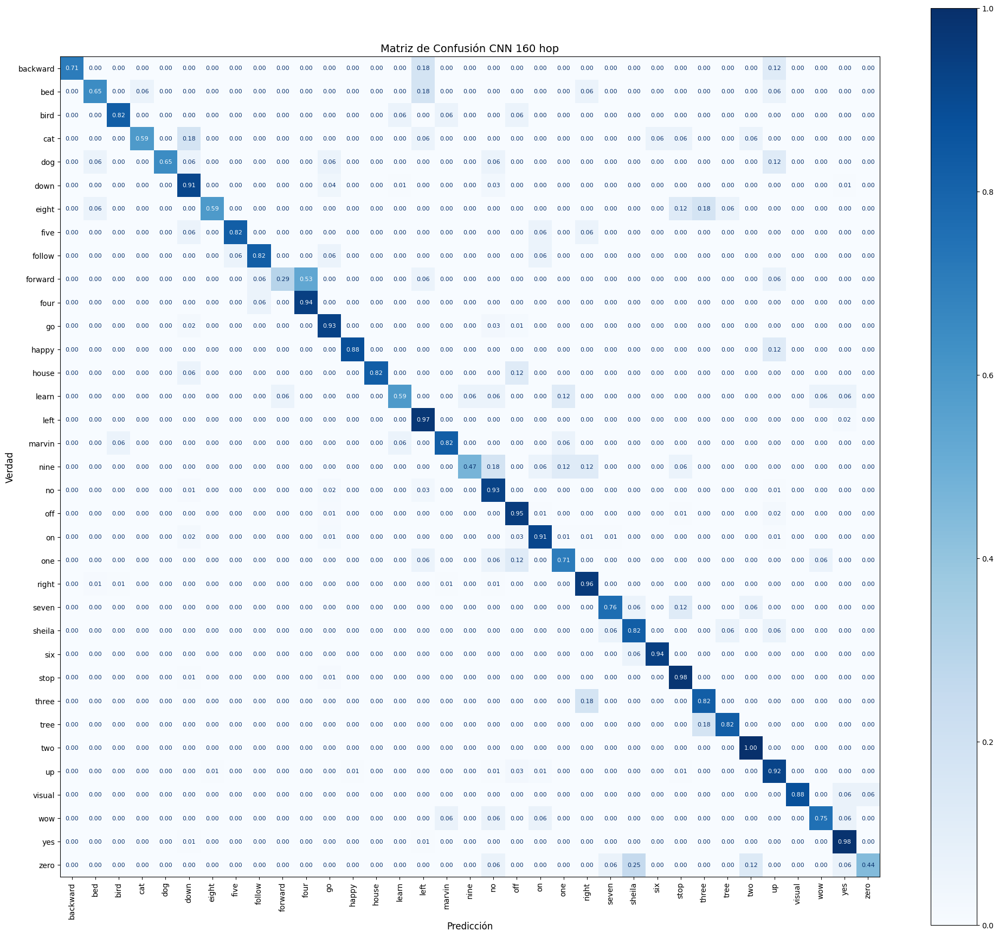

              precision    recall  f1-score   support

    backward       0.86      0.71      0.77        17
         bed       0.61      0.65      0.63        17
        bird       0.82      0.82      0.82        17
         cat       0.77      0.59      0.67        17
         dog       0.92      0.65      0.76        17
        down       0.92      0.91      0.92       396
       eight       0.83      0.59      0.69        17
        five       0.88      0.82      0.85        17
      follow       0.88      0.82      0.85        17
     forward       0.83      0.29      0.43        17
        four       0.62      0.94      0.74        17
          go       0.91      0.93      0.92       396
       happy       0.83      0.88      0.86        17
       house       0.93      0.82      0.88        17
       learn       0.71      0.59      0.65        17
        left       0.93      0.97      0.95       396
      marvin       0.70      0.82      0.76        17
        nine       0.80    

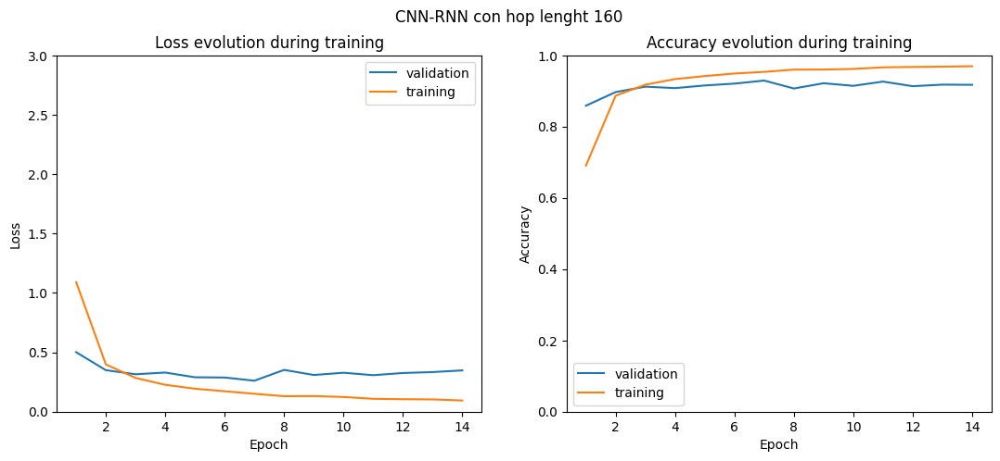

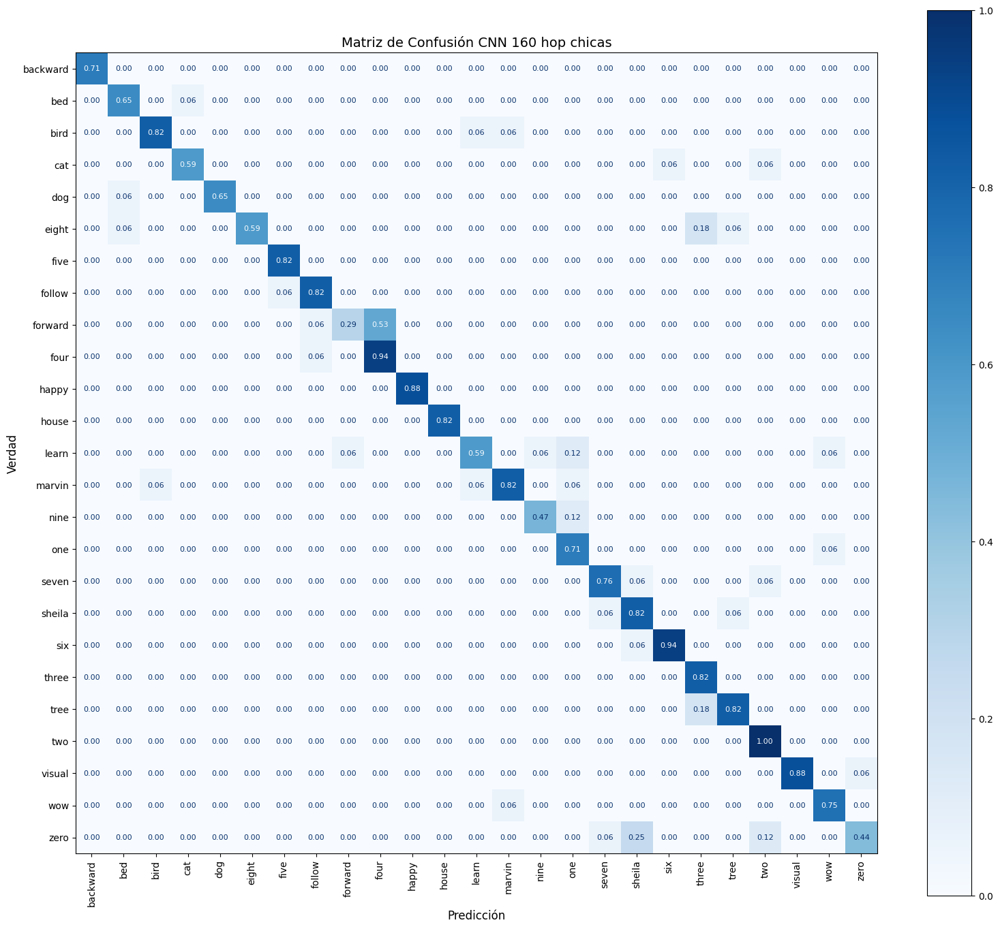

              precision    recall  f1-score   support

    backward       1.00      1.00      1.00        12
         bed       0.85      0.92      0.88        12
        bird       0.93      0.88      0.90        16
         cat       0.91      0.83      0.87        12
         dog       1.00      0.92      0.96        12
       eight       1.00      0.67      0.80        15
        five       0.93      1.00      0.97        14
      follow       0.88      0.93      0.90        15
     forward       0.83      0.33      0.48        15
        four       0.64      0.94      0.76        17
       happy       1.00      1.00      1.00        15
       house       1.00      1.00      1.00        14
       learn       0.83      0.67      0.74        15
      marvin       0.88      0.82      0.85        17
        nine       0.89      0.80      0.84        10
         one       0.71      0.92      0.80        13
       seven       0.87      0.87      0.87        15
      sheila       0.70    

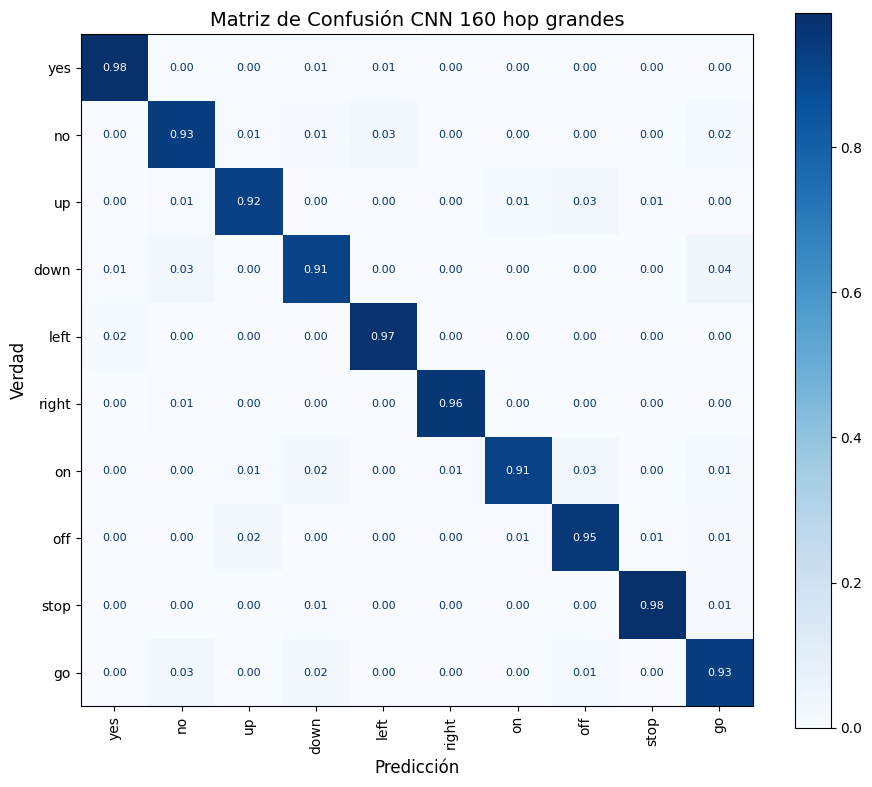

              precision    recall  f1-score   support

         yes       0.98      0.99      0.98       395
          no       0.93      0.94      0.93       393
          up       0.96      0.94      0.95       388
        down       0.94      0.92      0.93       392
        left       0.96      0.97      0.96       395
       right       0.98      0.99      0.99       384
          on       0.97      0.93      0.95       389
         off       0.93      0.95      0.94       395
        stop       0.98      0.98      0.98       396
          go       0.91      0.93      0.92       394

    accuracy                           0.95      3921
   macro avg       0.95      0.95      0.95      3921
weighted avg       0.95      0.95      0.95      3921

Precisión global (Accuracy): 0.9543
📁 Métricas guardadas en: metricas_CNN_160_hop_grandes.json

========== Iteración 2/5 ==========
Epoch 1/40
Iteration 84 - Batch 84/508 - Train loss: 2.4791, Train acc: 22.13%
Iteration 168 - Batch 168/508 

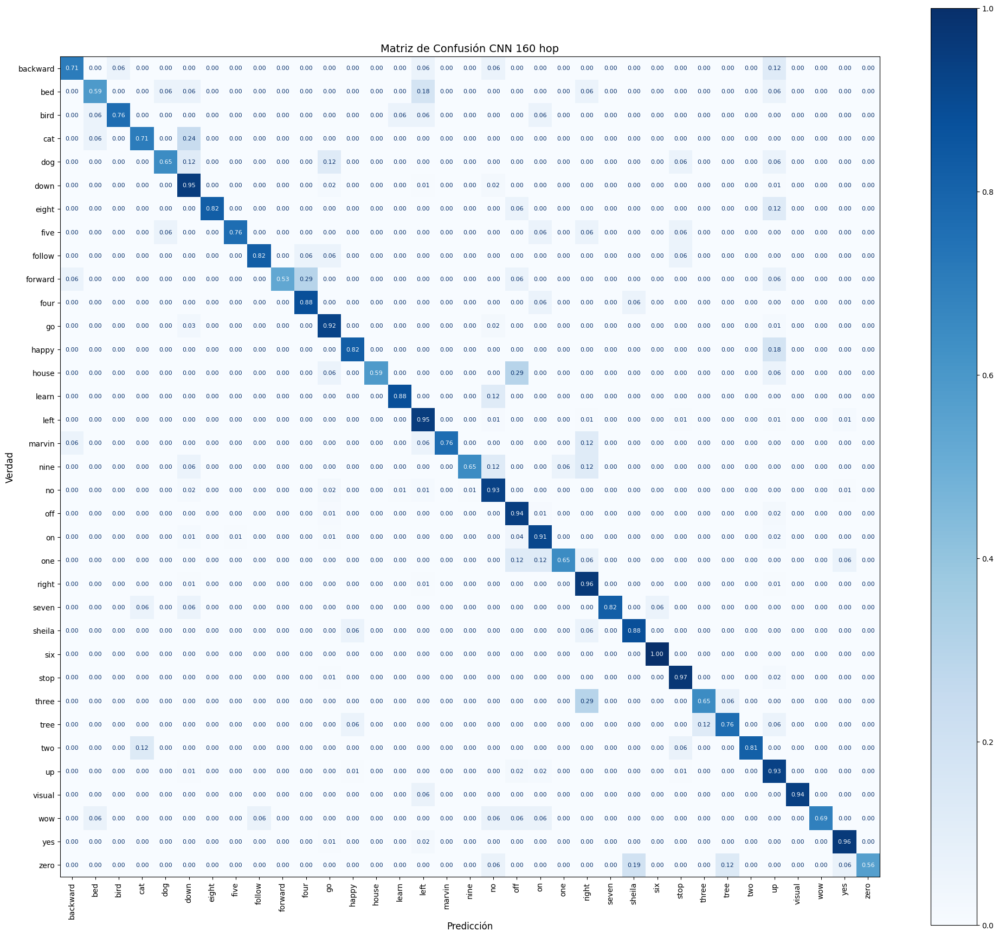

              precision    recall  f1-score   support

    backward       0.86      0.71      0.77        17
         bed       0.59      0.59      0.59        17
        bird       0.81      0.76      0.79        17
         cat       0.67      0.71      0.69        17
         dog       0.73      0.65      0.69        17
        down       0.91      0.95      0.93       396
       eight       0.93      0.82      0.88        17
        five       0.81      0.76      0.79        17
      follow       0.93      0.82      0.88        17
     forward       1.00      0.53      0.69        17
        four       0.68      0.88      0.77        17
          go       0.92      0.92      0.92       396
       happy       0.78      0.82      0.80        17
       house       0.91      0.59      0.71        17
       learn       0.75      0.88      0.81        17
        left       0.94      0.95      0.94       396
      marvin       1.00      0.76      0.87        17
        nine       0.85    

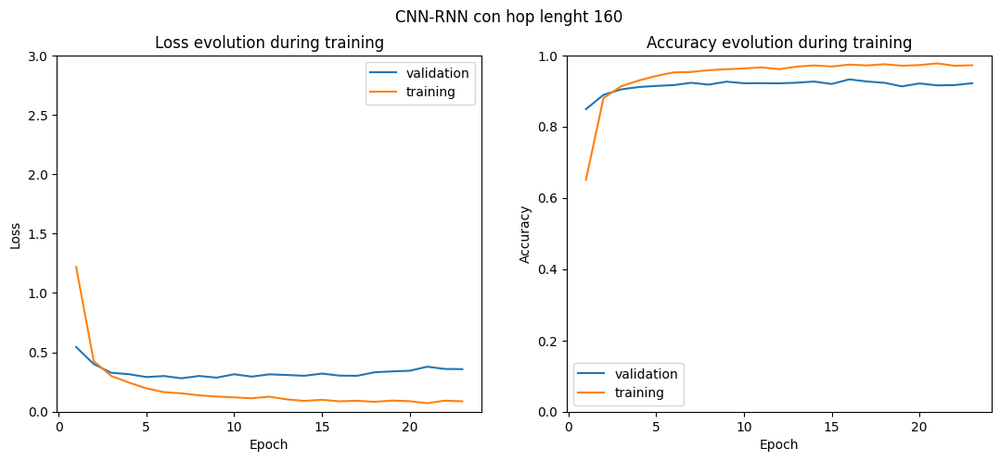

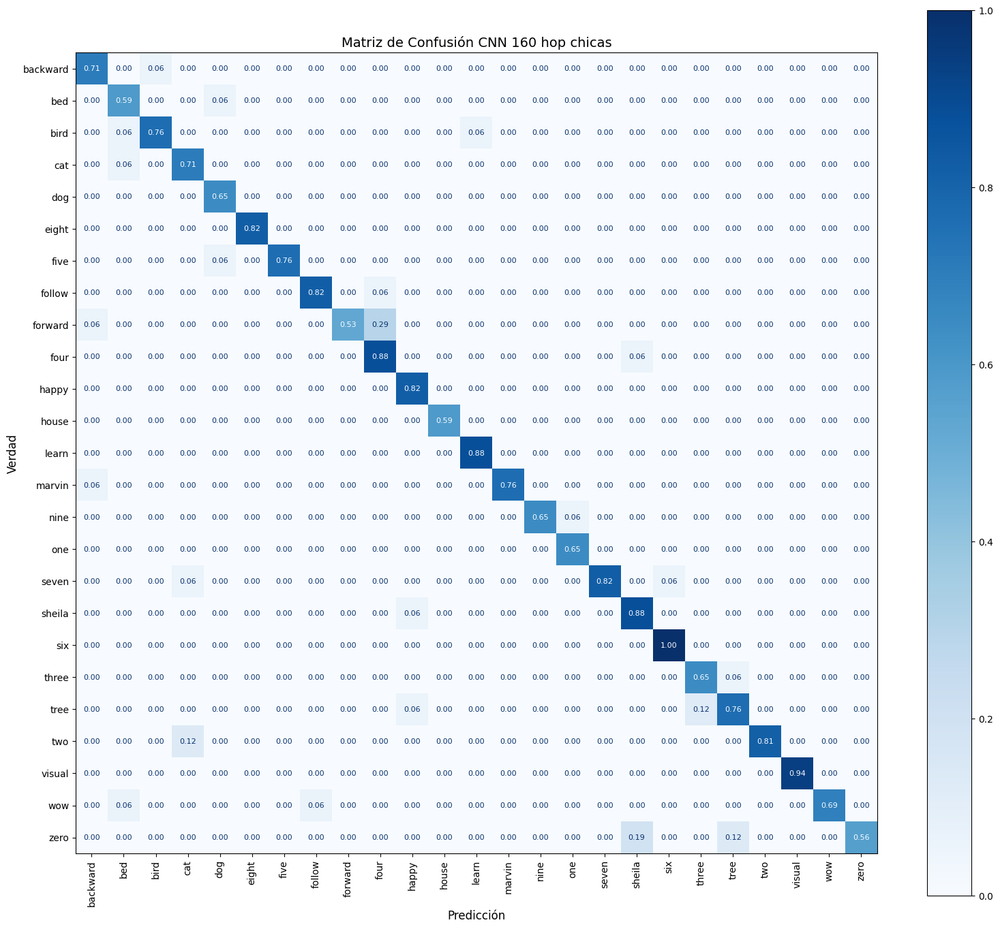

              precision    recall  f1-score   support

    backward       0.86      0.92      0.89        13
         bed       0.77      0.91      0.83        11
        bird       0.93      0.87      0.90        15
         cat       0.80      0.92      0.86        13
         dog       0.85      1.00      0.92        11
       eight       1.00      1.00      1.00        14
        five       1.00      0.93      0.96        14
      follow       0.93      0.93      0.93        15
     forward       1.00      0.60      0.75        15
        four       0.71      0.94      0.81        16
       happy       0.88      1.00      0.93        14
       house       1.00      1.00      1.00        10
       learn       0.94      1.00      0.97        15
      marvin       1.00      0.93      0.96        14
        nine       1.00      0.92      0.96        12
         one       0.92      1.00      0.96        11
       seven       1.00      0.88      0.93        16
      sheila       0.79    

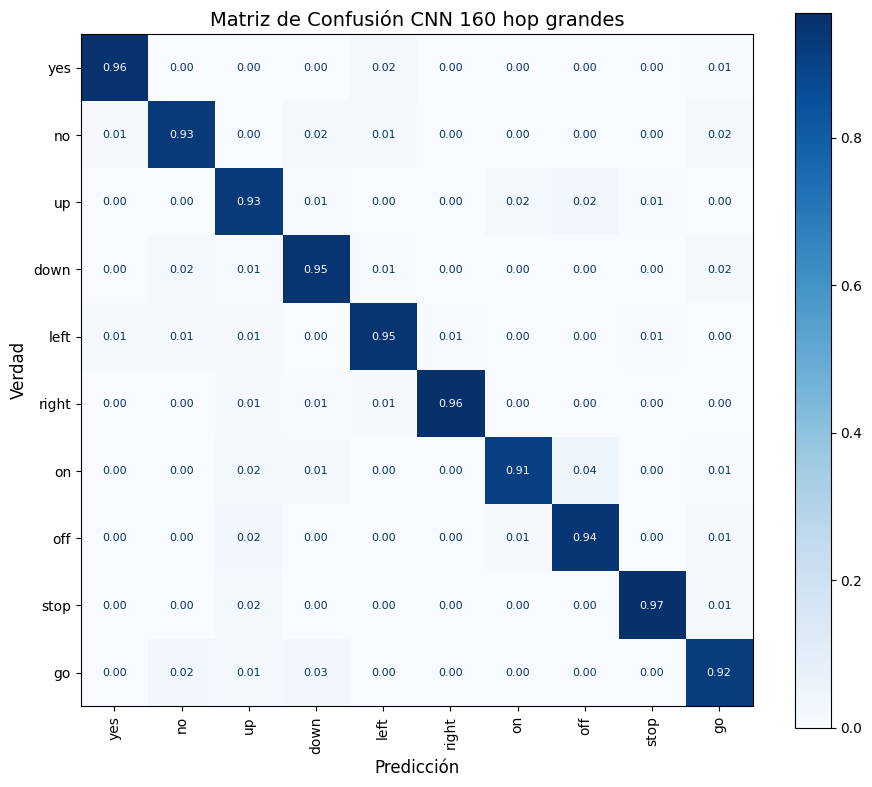

              precision    recall  f1-score   support

         yes       0.98      0.97      0.97       392
          no       0.94      0.95      0.94       390
          up       0.92      0.94      0.93       391
        down       0.93      0.95      0.94       394
        left       0.95      0.96      0.95       393
       right       0.99      0.97      0.98       393
          on       0.97      0.92      0.94       392
         off       0.93      0.95      0.94       393
        stop       0.98      0.98      0.98       393
          go       0.93      0.93      0.93       394

    accuracy                           0.95      3925
   macro avg       0.95      0.95      0.95      3925
weighted avg       0.95      0.95      0.95      3925

Precisión global (Accuracy): 0.9521
📁 Métricas guardadas en: metricas_CNN_160_hop_grandes.json

========== Iteración 3/5 ==========
Epoch 1/40
Iteration 84 - Batch 84/508 - Train loss: 2.3468, Train acc: 28.93%
Iteration 168 - Batch 168/508 

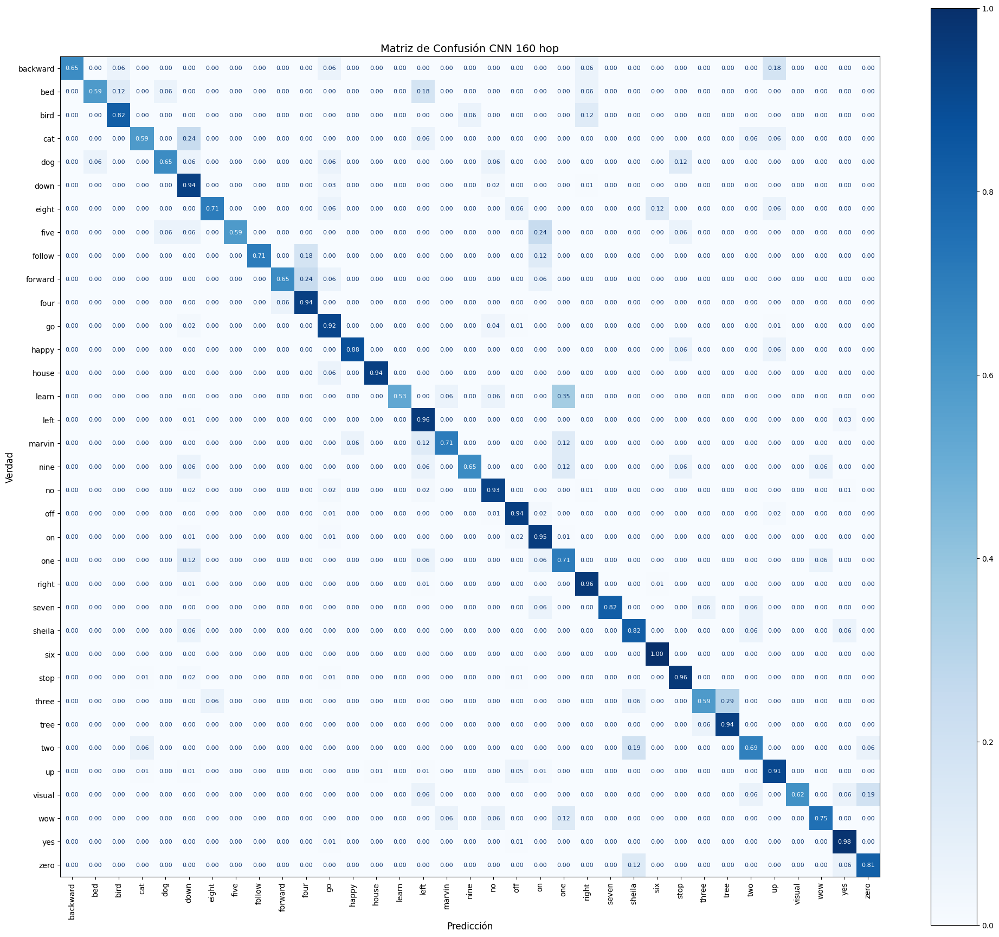

              precision    recall  f1-score   support

    backward       1.00      0.65      0.79        17
         bed       0.83      0.59      0.69        17
        bird       0.82      0.82      0.82        17
         cat       0.62      0.59      0.61        17
         dog       0.79      0.65      0.71        17
        down       0.90      0.94      0.92       396
       eight       0.92      0.71      0.80        17
        five       1.00      0.59      0.74        17
      follow       1.00      0.71      0.83        17
     forward       0.85      0.65      0.73        17
        four       0.70      0.94      0.80        17
          go       0.91      0.92      0.92       396
       happy       0.94      0.88      0.91        17
       house       0.76      0.94      0.84        17
       learn       0.90      0.53      0.67        17
        left       0.94      0.96      0.95       396
      marvin       0.86      0.71      0.77        17
        nine       0.85    

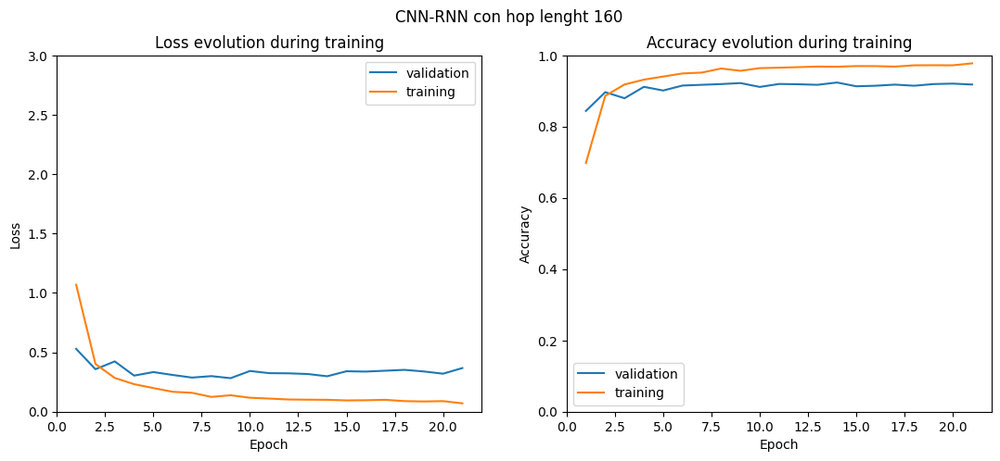

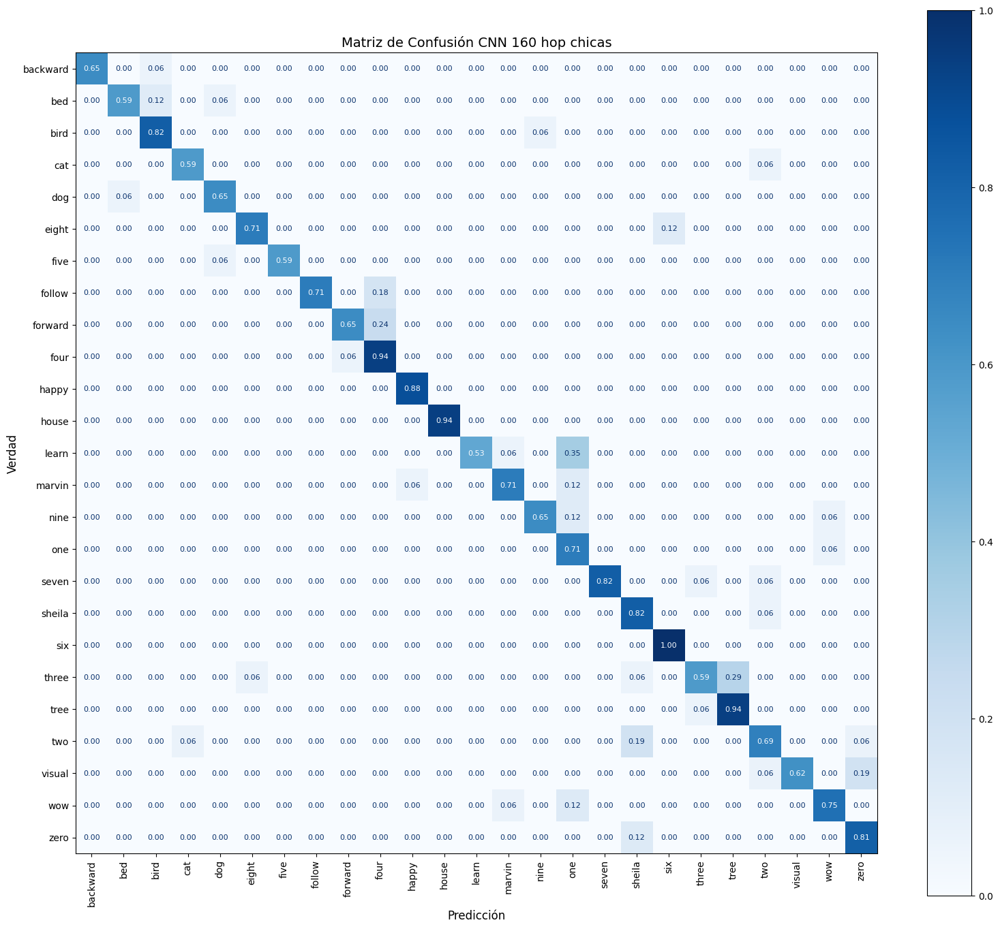

              precision    recall  f1-score   support

    backward       1.00      0.92      0.96        12
         bed       0.91      0.77      0.83        13
        bird       0.82      0.93      0.88        15
         cat       0.91      0.91      0.91        11
         dog       0.85      0.92      0.88        12
       eight       0.92      0.86      0.89        14
        five       1.00      0.91      0.95        11
      follow       1.00      0.80      0.89        15
     forward       0.92      0.73      0.81        15
        four       0.70      0.94      0.80        17
       happy       0.94      1.00      0.97        15
       house       1.00      1.00      1.00        16
       learn       1.00      0.56      0.72        16
      marvin       0.86      0.80      0.83        15
        nine       0.92      0.79      0.85        14
         one       0.50      0.92      0.65        13
       seven       1.00      0.88      0.93        16
      sheila       0.70    

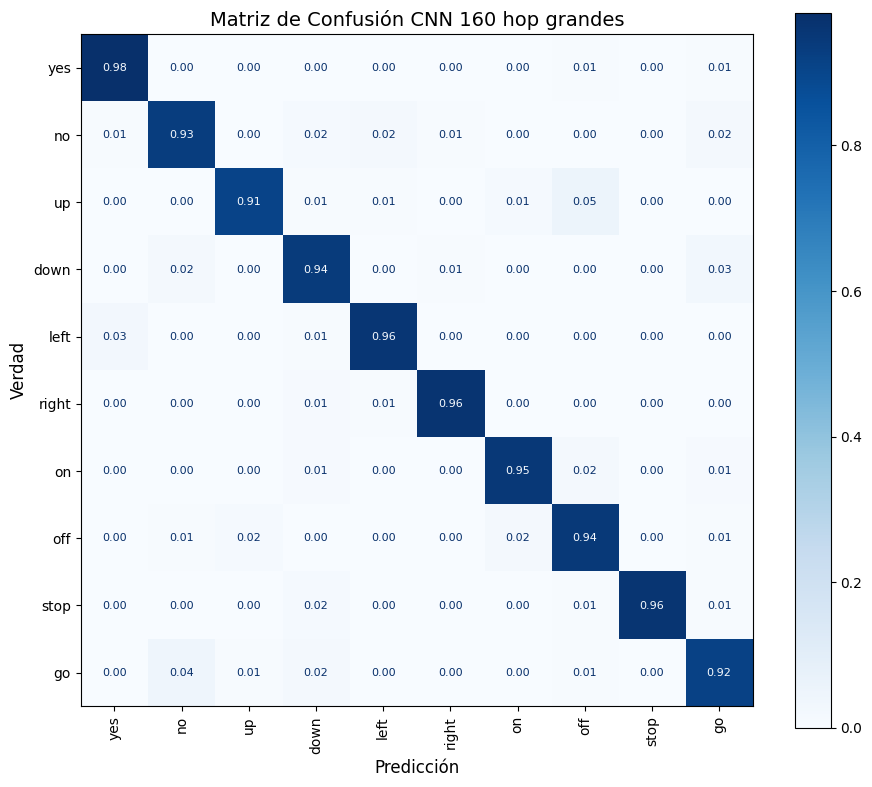

              precision    recall  f1-score   support

         yes       0.96      0.98      0.97       395
          no       0.93      0.93      0.93       395
          up       0.97      0.92      0.94       392
        down       0.92      0.94      0.93       394
        left       0.96      0.96      0.96       394
       right       0.98      0.97      0.98       392
          on       0.96      0.95      0.96       394
         off       0.91      0.95      0.93       395
        stop       0.99      0.97      0.98       394
          go       0.93      0.92      0.92       394

    accuracy                           0.95      3939
   macro avg       0.95      0.95      0.95      3939
weighted avg       0.95      0.95      0.95      3939

Precisión global (Accuracy): 0.9502
📁 Métricas guardadas en: metricas_CNN_160_hop_grandes.json

========== Iteración 4/5 ==========
Epoch 1/40
Iteration 84 - Batch 84/508 - Train loss: 2.5702, Train acc: 20.55%
Iteration 168 - Batch 168/508 

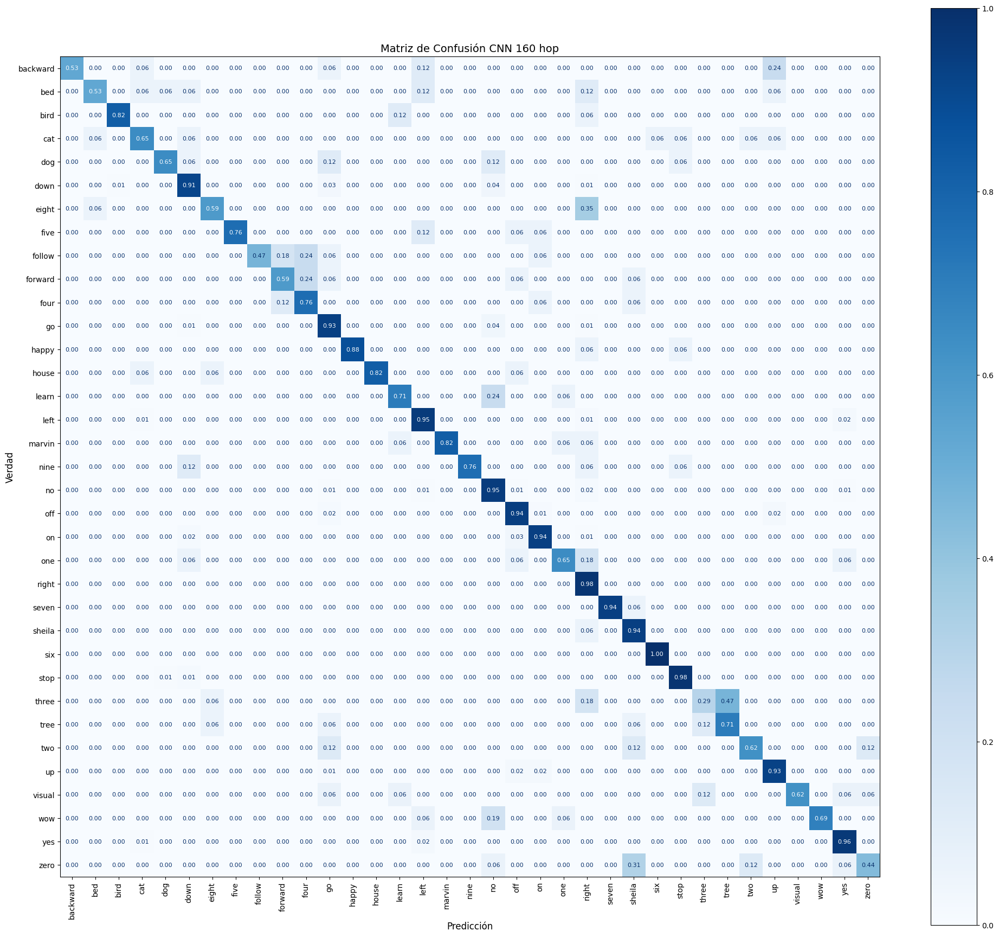

              precision    recall  f1-score   support

    backward       0.82      0.53      0.64        17
         bed       0.60      0.53      0.56        17
        bird       0.78      0.82      0.80        17
         cat       0.52      0.65      0.58        17
         dog       0.79      0.65      0.71        17
        down       0.94      0.91      0.93       396
       eight       0.67      0.59      0.62        17
        five       1.00      0.76      0.87        17
      follow       1.00      0.47      0.64        17
     forward       0.62      0.59      0.61        17
        four       0.62      0.76      0.68        17
          go       0.92      0.93      0.93       396
       happy       1.00      0.88      0.94        17
       house       1.00      0.82      0.90        17
       learn       0.75      0.71      0.73        17
        left       0.95      0.95      0.95       396
      marvin       0.88      0.82      0.85        17
        nine       1.00    

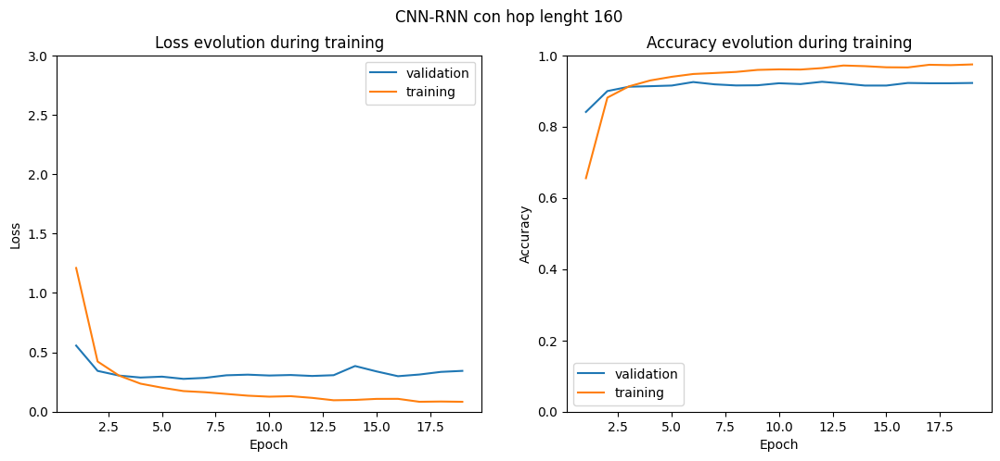

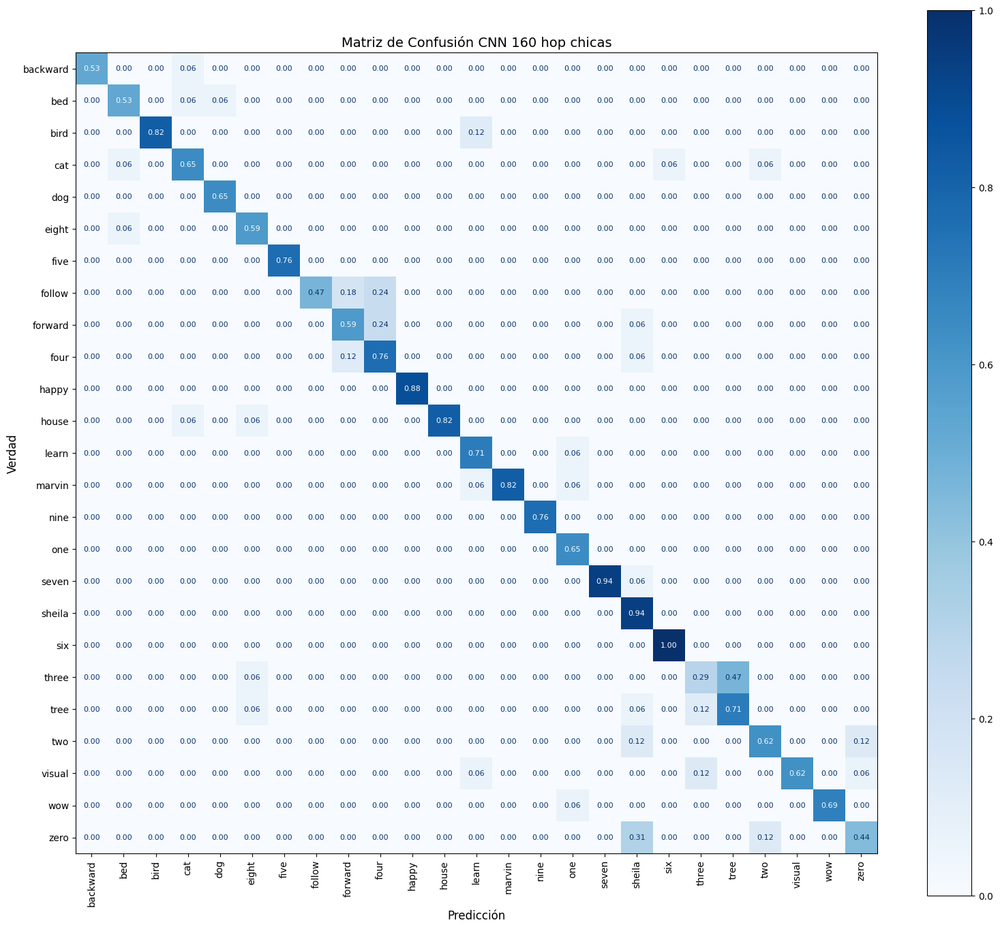

              precision    recall  f1-score   support

    backward       1.00      0.90      0.95        10
         bed       0.82      0.82      0.82        11
        bird       1.00      0.88      0.93        16
         cat       0.79      0.79      0.79        14
         dog       0.92      1.00      0.96        11
       eight       0.77      0.91      0.83        11
        five       1.00      1.00      1.00        13
      follow       1.00      0.53      0.70        15
     forward       0.67      0.67      0.67        15
        four       0.62      0.81      0.70        16
       happy       1.00      1.00      1.00        15
       house       1.00      0.88      0.93        16
       learn       0.75      0.92      0.83        13
      marvin       1.00      0.88      0.93        16
        nine       1.00      1.00      1.00        13
         one       0.79      1.00      0.88        11
       seven       1.00      0.94      0.97        17
      sheila       0.59    

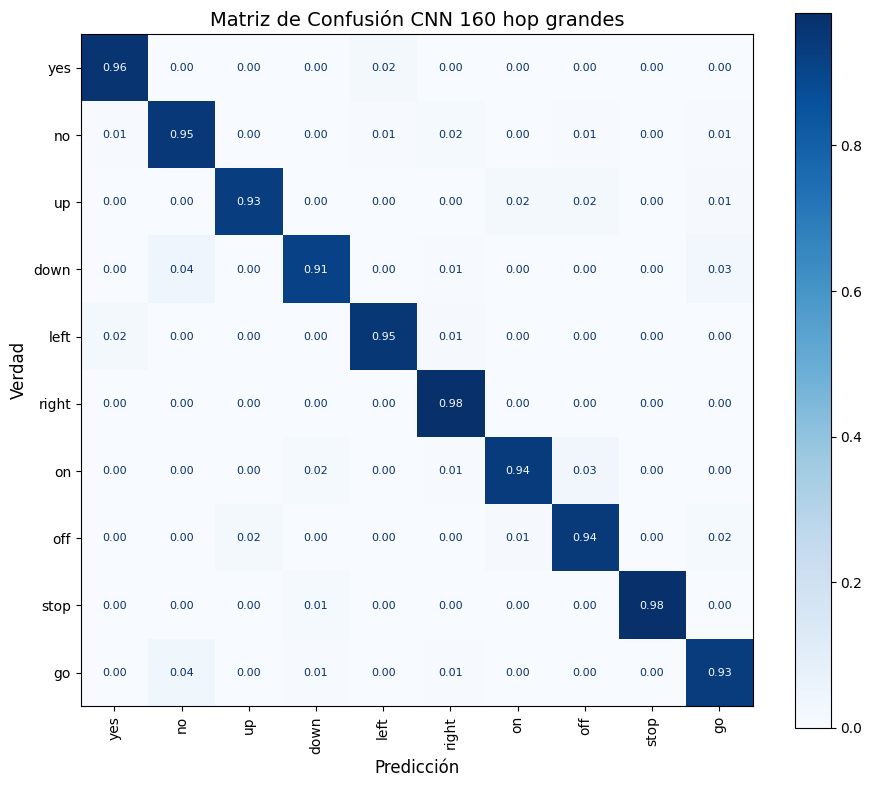

              precision    recall  f1-score   support

         yes       0.96      0.97      0.97       393
          no       0.92      0.96      0.94       393
          up       0.97      0.94      0.95       392
        down       0.95      0.93      0.94       391
        left       0.96      0.96      0.96       393
       right       0.95      0.98      0.97       393
          on       0.97      0.94      0.96       394
         off       0.94      0.95      0.94       394
        stop       0.99      0.99      0.99       394
          go       0.94      0.94      0.94       393

    accuracy                           0.96      3930
   macro avg       0.96      0.96      0.96      3930
weighted avg       0.96      0.96      0.96      3930

Precisión global (Accuracy): 0.9557
📁 Métricas guardadas en: metricas_CNN_160_hop_grandes.json

========== Iteración 5/5 ==========
Epoch 1/40
Iteration 84 - Batch 84/508 - Train loss: 2.3653, Train acc: 29.23%
Iteration 168 - Batch 168/508 

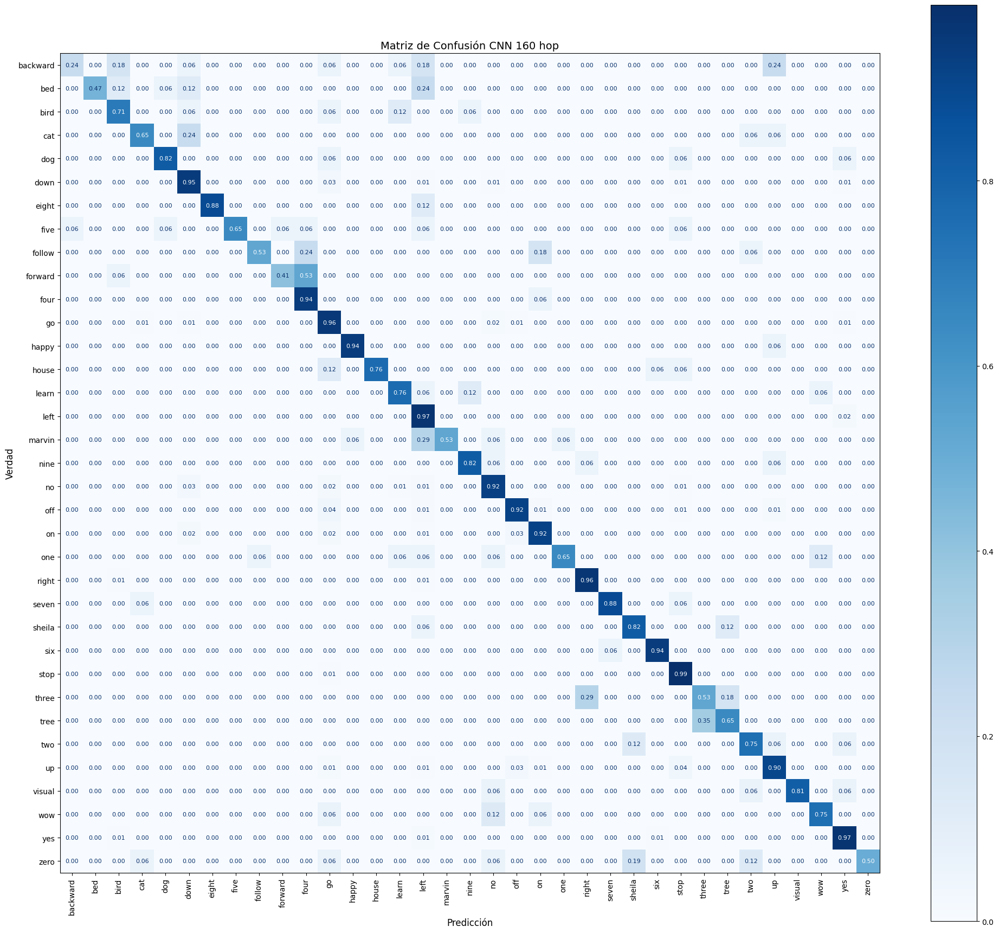

              precision    recall  f1-score   support

    backward       0.57      0.24      0.33        17
         bed       0.89      0.47      0.62        17
        bird       0.55      0.71      0.62        17
         cat       0.61      0.65      0.63        17
         dog       0.88      0.82      0.85        17
        down       0.92      0.95      0.93       396
       eight       1.00      0.88      0.94        17
        five       1.00      0.65      0.79        17
      follow       0.90      0.53      0.67        17
     forward       0.88      0.41      0.56        17
        four       0.53      0.94      0.68        17
          go       0.87      0.96      0.91       396
       happy       0.94      0.94      0.94        17
       house       0.93      0.76      0.84        17
       learn       0.65      0.76      0.70        17
        left       0.90      0.97      0.93       396
      marvin       1.00      0.53      0.69        17
        nine       0.82    

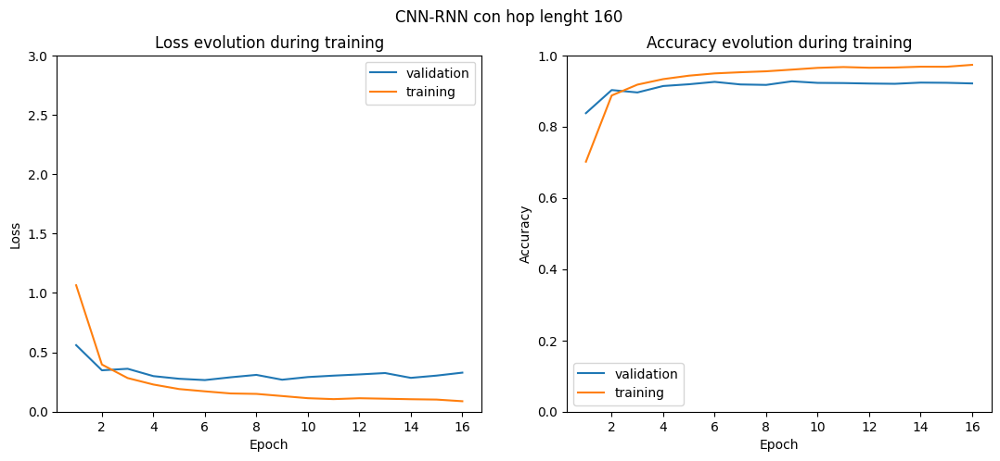

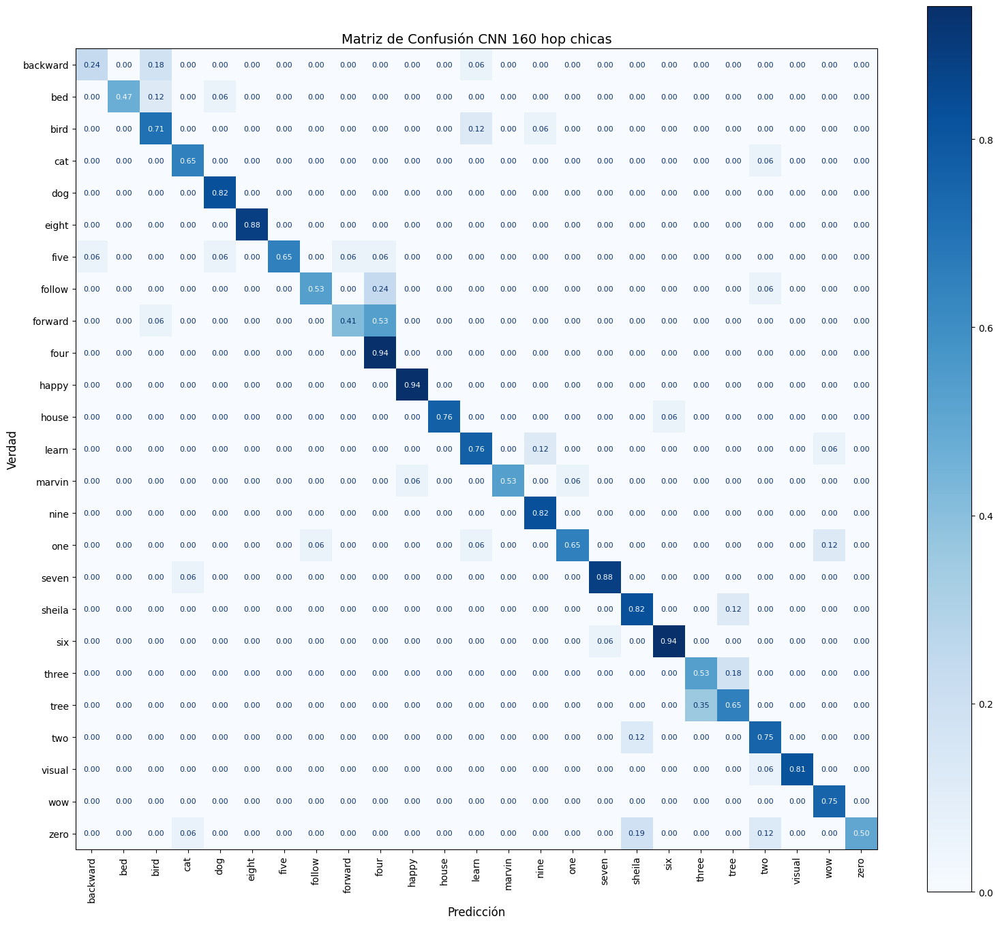

              precision    recall  f1-score   support

    backward       0.80      0.50      0.62         8
         bed       1.00      0.73      0.84        11
        bird       0.67      0.80      0.73        15
         cat       0.85      0.92      0.88        12
         dog       0.88      1.00      0.93        14
       eight       1.00      1.00      1.00        15
        five       1.00      0.73      0.85        15
      follow       0.90      0.64      0.75        14
     forward       0.88      0.41      0.56        17
        four       0.53      1.00      0.70        16
       happy       0.94      1.00      0.97        16
       house       1.00      0.93      0.96        14
       learn       0.76      0.81      0.79        16
      marvin       1.00      0.82      0.90        11
        nine       0.82      1.00      0.90        14
         one       0.92      0.73      0.81        15
       seven       0.94      0.94      0.94        16
      sheila       0.74    

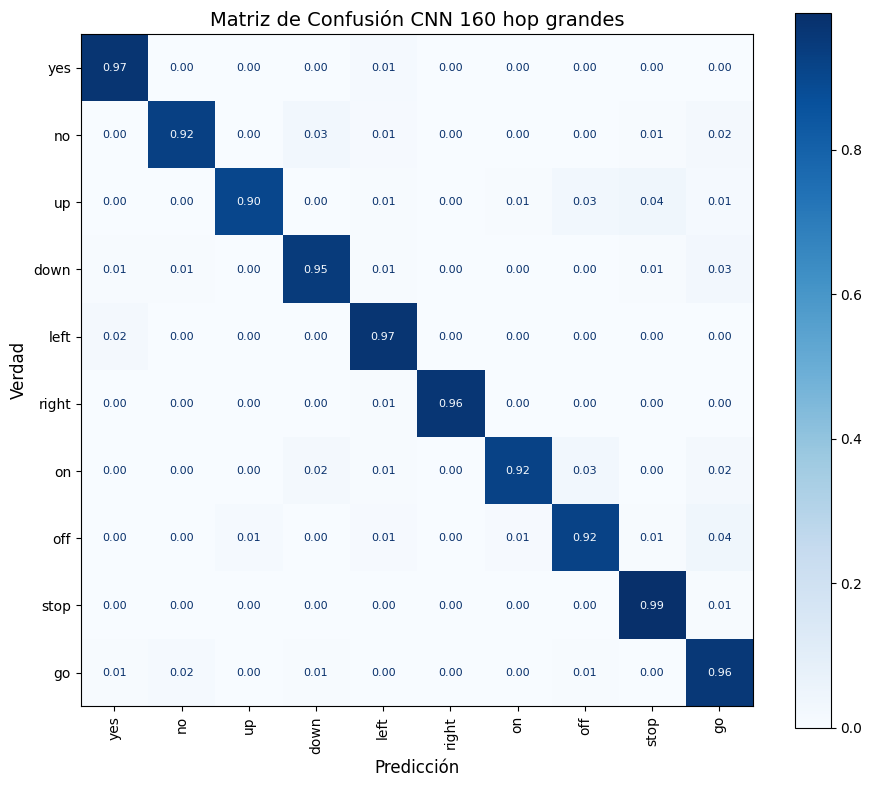

              precision    recall  f1-score   support

         yes       0.96      0.98      0.97       390
          no       0.96      0.93      0.95       393
          up       0.98      0.90      0.94       396
        down       0.94      0.95      0.94       396
        left       0.94      0.97      0.96       394
       right       1.00      0.98      0.99       391
          on       0.98      0.92      0.95       395
         off       0.93      0.92      0.92       394
        stop       0.94      0.99      0.96       396
          go       0.89      0.96      0.92       394

    accuracy                           0.95      3939
   macro avg       0.95      0.95      0.95      3939
weighted avg       0.95      0.95      0.95      3939

Precisión global (Accuracy): 0.9507
📁 Métricas guardadas en: metricas_CNN_160_hop_grandes.json
Modelo final guardado

===== Resultados finales =====
Precisión promedio (3 runs): 92.40% ± 0.12%


In [ ]:
device = "cuda" if torch.cuda.is_available() else "cpu"

# Datos y clases
train_dl, val_dl, test_dl = load2(MFCC_train_10, MFCC_val_10, MFCC_test_10, batch_size=64)

# Función para obtener predicciones
@torch.no_grad()
def get_predictions(loader, model, device="cpu"):
    model = model.to(device)
    model.eval()
    all_predictions, all_true_labels = [], []
    for xb, yb in loader:
        xb, yb = xb.to(device), yb.to(device)
        pred = model(xb).argmax(1)
        all_predictions.extend(pred.cpu().numpy())
        all_true_labels.extend(yb.cpu().numpy())
    return np.array(all_true_labels), np.array(all_predictions)

# Loop de 5 iteraciones
accuracies = []

for i in range(5):
    print(f"\n========== Iteración {i+1}/5 ==========")
    model = CNN1DModel_RNN(
        input_size=39,
        hidden_size=128,
        num_layers=1,
        bidirectional=False,
        num_classes=len(label_map)
    ).to(device)

    criterion = nn.CrossEntropyLoss()

    curves = train_model(
        model, train_dl, val_dl,
        epochs=40, lr=1e-3,
        criterion=criterion,
        device=device,
        early_stopping_patience=7
    )

    true_labels, predictions = get_predictions(test_dl, model, device)
    print("Tamaño de true_labels:", len(true_labels))
    print("Tamaño de predictions:", len(predictions))
    acc = (predictions == true_labels).mean() * 100
    accuracies.append(acc)
    print(f"✅ Precisión iteración {i+1}: {acc:.2f}%")
    # Matriz de confusión del último modelo entrenado
    show_confusion_matrix(
        true_labels, predictions,
        clases_10,
        title=f"Matriz de Confusión CNN 160 hop",
        filename="matriz_confusion_CNN_160_hop.png",
        metrics_filename="metricas_CNN_160_hop.json"
    )


    show_curves(curves, title="CNN-RNN con hop lenght 160" , filename="Curva_CNN_160_hop.png")

    # Matriz de confusión del último modelo entrenado
    show_confusion_matrix(
        true_labels, predictions,
        clases_10,
        title=f"Matriz de Confusión CNN 160 hop chicas",
        filename="matriz_confusion_CNN_160_hop_chicas.png",
        selected_classes = clases_chicas,
        metrics_filename="metricas_CNN_160_hop_chicas.json"
    )

    # Matriz de confusión del último modelo entrenado
    show_confusion_matrix(
        true_labels, predictions,
        clases_10,
        title=f"Matriz de Confusión CNN 160 hop grandes",
        filename="matriz_confusion_CNN_160_hop_grandes.png",
        selected_classes = clases_grandes,
        metrics_filename="metricas_CNN_160_hop_grandes.json"
    )


torch.save(model.state_dict(), "modelo_CNN_160.pth")
print("Modelo final guardado")

# Promedio y desviación estándar
mean_acc = np.mean(accuracies)
std_acc = np.std(accuracies)

print("\n===== Resultados finales =====")
print(f"Precisión promedio (3 runs): {mean_acc:.2f}% ± {std_acc:.2f}%")




In [ ]:
import os

model_summary(model)
time_per_sample, total_time = measure_inference_time(model, test_dl, device)

print(f"⏱️ Tiempo promedio por muestra: {time_per_sample*1000:.3f} ms")
print(f"⏱️ Tiempo total sobre el test: {total_time:.2f} s")

📌 Parámetros entrenables: 143,927
📦 Tamaño aproximado en memoria: 0.55 MB
💾 Tamaño real del archivo .pth: 0.55 MB
⏱️ Tiempo promedio por muestra: 0.017 ms
⏱️ Tiempo total sobre el test: 0.07 s


##### T-CNN

{'backward': 0, 'bed': 1, 'bird': 2, 'cat': 3, 'dog': 4, 'down': 5, 'eight': 6, 'five': 7, 'follow': 8, 'forward': 9, 'four': 10, 'go': 11, 'happy': 12, 'house': 13, 'learn': 14, 'left': 15, 'marvin': 16, 'nine': 17, 'no': 18, 'off': 19, 'on': 20, 'one': 21, 'right': 22, 'seven': 23, 'sheila': 24, 'six': 25, 'stop': 26, 'three': 27, 'tree': 28, 'two': 29, 'up': 30, 'visual': 31, 'wow': 32, 'yes': 33, 'zero': 34}
{'backward': 0, 'bed': 1, 'bird': 2, 'cat': 3, 'dog': 4, 'down': 5, 'eight': 6, 'five': 7, 'follow': 8, 'forward': 9, 'four': 10, 'go': 11, 'happy': 12, 'house': 13, 'learn': 14, 'left': 15, 'marvin': 16, 'nine': 17, 'no': 18, 'off': 19, 'on': 20, 'one': 21, 'right': 22, 'seven': 23, 'sheila': 24, 'six': 25, 'stop': 26, 'three': 27, 'tree': 28, 'two': 29, 'up': 30, 'visual': 31, 'wow': 32, 'yes': 33, 'zero': 34}
{'backward': 0, 'bed': 1, 'bird': 2, 'cat': 3, 'dog': 4, 'down': 5, 'eight': 6, 'five': 7, 'follow': 8, 'forward': 9, 'four': 10, 'go': 11, 'happy': 12, 'house': 13, 'l

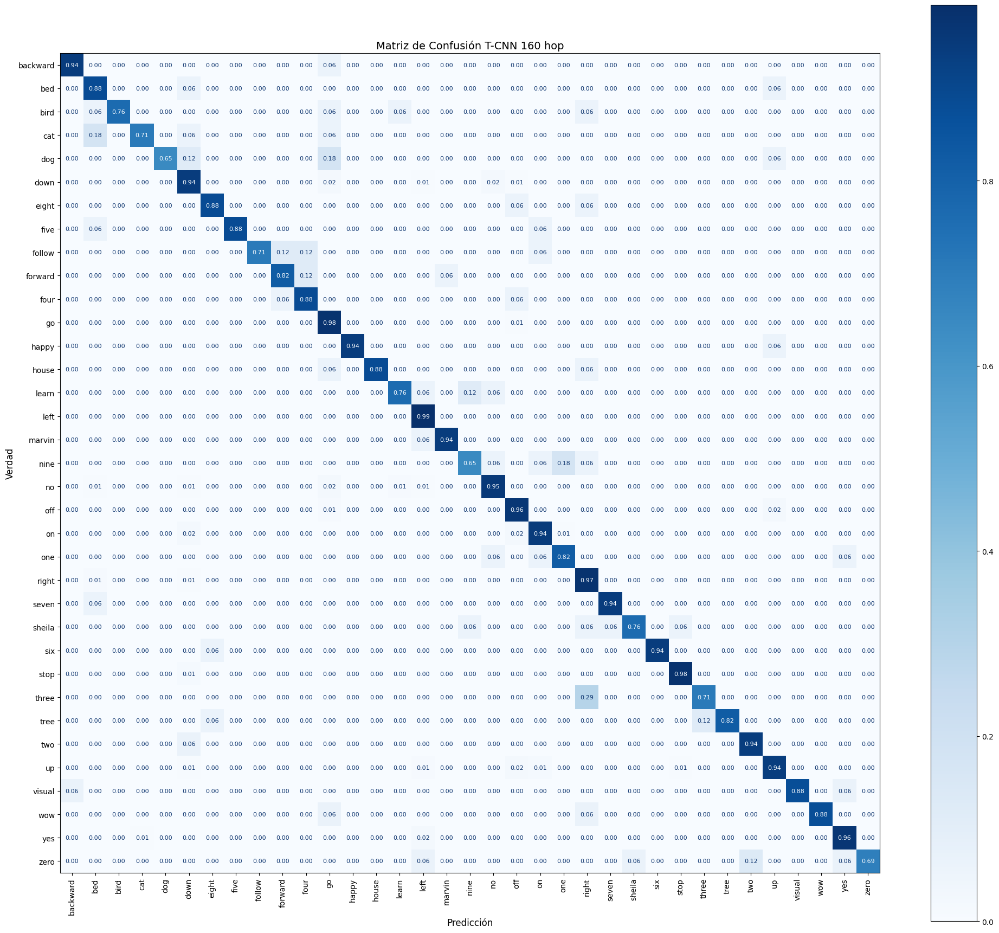

              precision    recall  f1-score   support

    backward       0.89      0.94      0.91        17
         bed       0.50      0.88      0.64        17
        bird       0.87      0.76      0.81        17
         cat       0.80      0.71      0.75        17
         dog       0.92      0.65      0.76        17
        down       0.93      0.94      0.94       396
       eight       0.88      0.88      0.88        17
        five       0.94      0.88      0.91        17
      follow       1.00      0.71      0.83        17
     forward       0.82      0.82      0.82        17
        four       0.79      0.88      0.83        17
          go       0.93      0.98      0.95       396
       happy       1.00      0.94      0.97        17
       house       1.00      0.88      0.94        17
       learn       0.68      0.76      0.72        17
        left       0.94      0.99      0.96       396
      marvin       0.94      0.94      0.94        17
        nine       0.79    

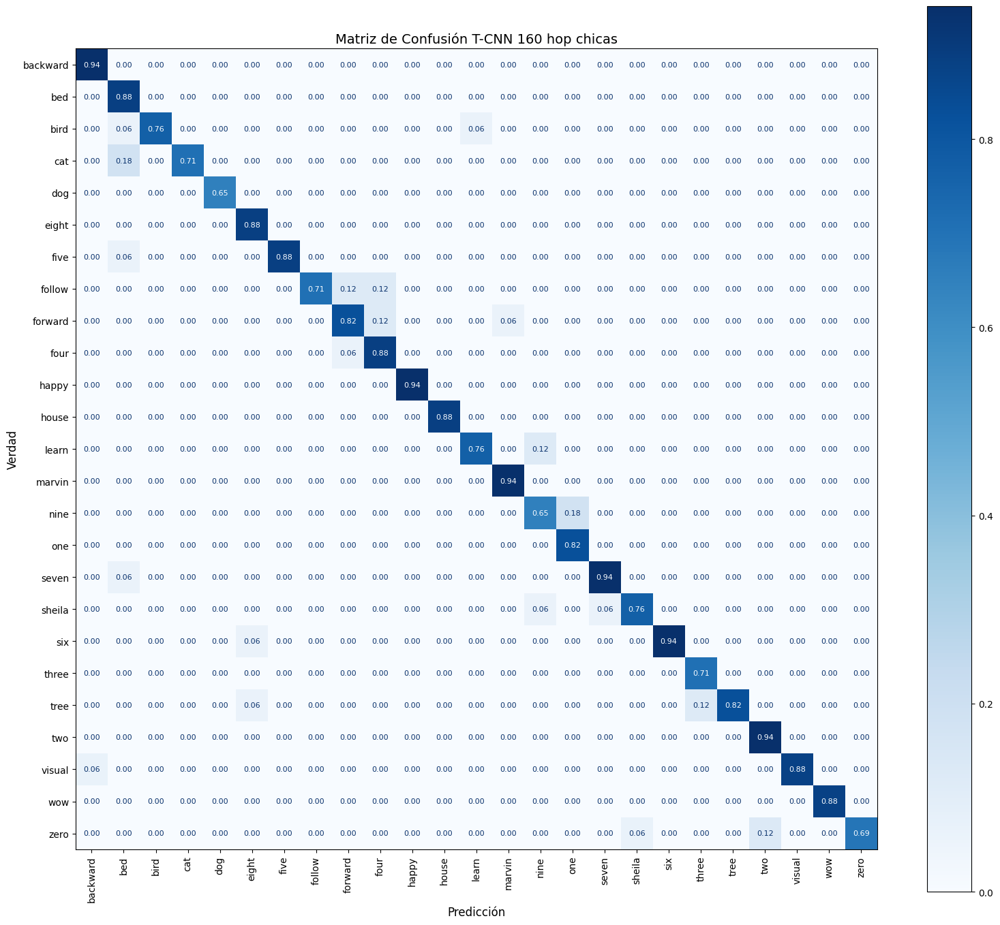

              precision    recall  f1-score   support

    backward       0.94      1.00      0.97        16
         bed       0.71      1.00      0.83        15
        bird       1.00      0.87      0.93        15
         cat       1.00      0.80      0.89        15
         dog       1.00      1.00      1.00        11
       eight       0.88      1.00      0.94        15
        five       1.00      0.94      0.97        16
      follow       1.00      0.75      0.86        16
     forward       0.82      0.82      0.82        17
        four       0.79      0.94      0.86        16
       happy       1.00      1.00      1.00        16
       house       1.00      1.00      1.00        15
       learn       0.93      0.87      0.90        15
      marvin       0.94      1.00      0.97        16
        nine       0.79      0.79      0.79        14
         one       0.82      1.00      0.90        14
       seven       0.94      0.94      0.94        17
      sheila       0.93    

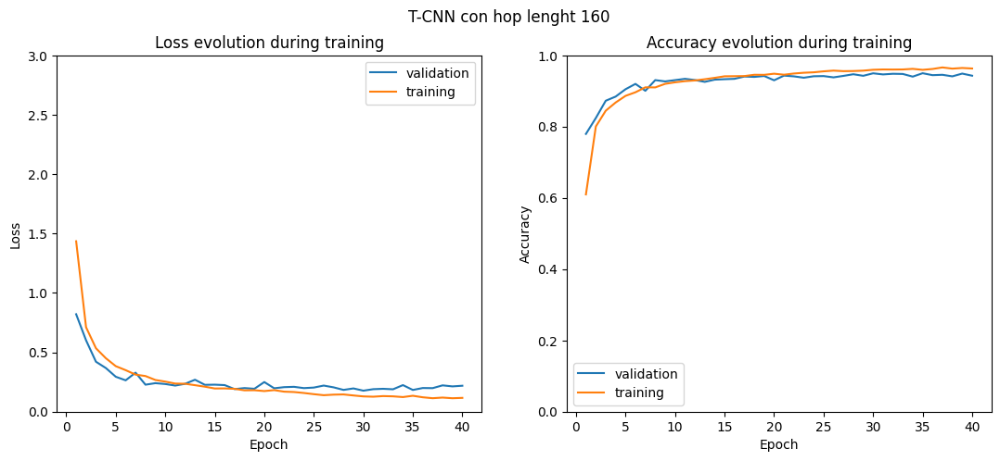

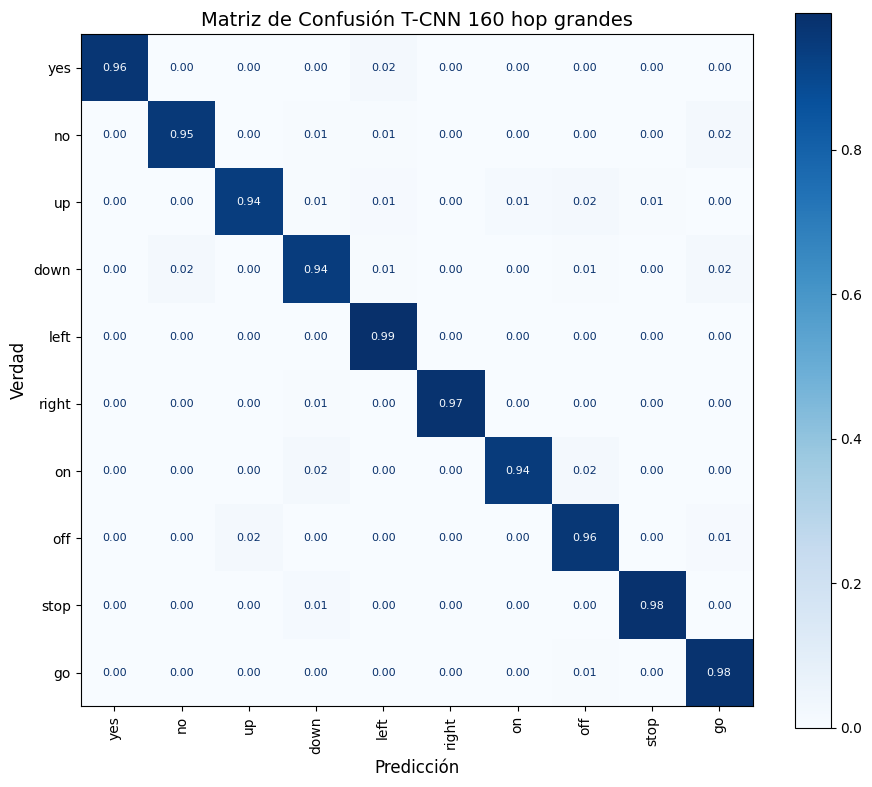

              precision    recall  f1-score   support

         yes       1.00      0.97      0.98       393
          no       0.98      0.97      0.97       390
          up       0.97      0.94      0.95       394
        down       0.95      0.94      0.95       395
        left       0.95      0.99      0.97       394
       right       0.99      0.99      0.99       391
          on       0.98      0.95      0.96       393
         off       0.95      0.96      0.95       396
        stop       0.99      0.98      0.99       395
          go       0.94      0.98      0.96       393

    accuracy                           0.97      3934
   macro avg       0.97      0.97      0.97      3934
weighted avg       0.97      0.97      0.97      3934

Precisión global (Accuracy): 0.9687
📁 Métricas guardadas en: metricas_T-CNN_160_hop_grandes.json

========== Iteración 2/3 ==========
Epoch 1/40
Iteration 84 - Batch 84/508 - Train loss: 2.7868, Train acc: 23.97%
Iteration 168 - Batch 168/50

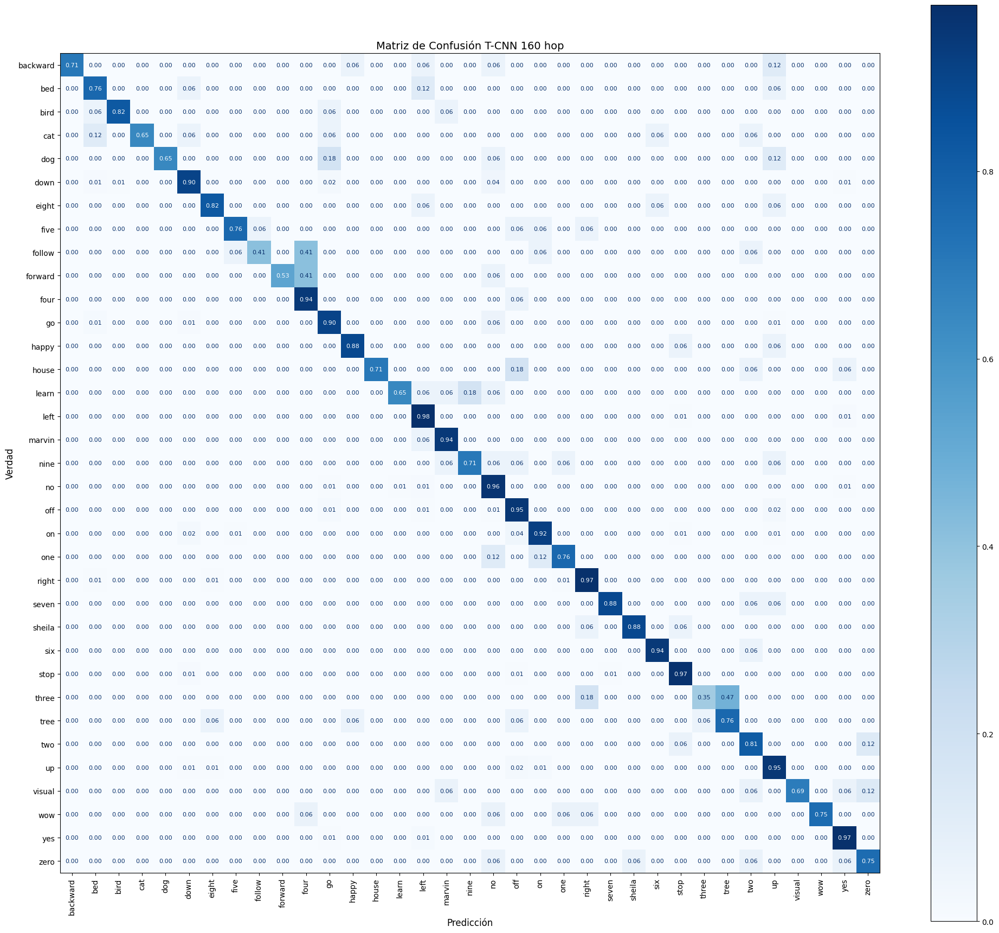

              precision    recall  f1-score   support

    backward       1.00      0.71      0.83        17
         bed       0.46      0.76      0.58        17
        bird       0.82      0.82      0.82        17
         cat       0.92      0.65      0.76        17
         dog       0.92      0.65      0.76        17
        down       0.95      0.90      0.92       396
       eight       0.70      0.82      0.76        17
        five       0.76      0.76      0.76        17
      follow       0.70      0.41      0.52        17
     forward       1.00      0.53      0.69        17
        four       0.50      0.94      0.65        17
          go       0.94      0.90      0.92       396
       happy       0.83      0.88      0.86        17
       house       1.00      0.71      0.83        17
       learn       0.79      0.65      0.71        17
        left       0.95      0.98      0.96       396
      marvin       0.80      0.94      0.86        17
        nine       0.75    

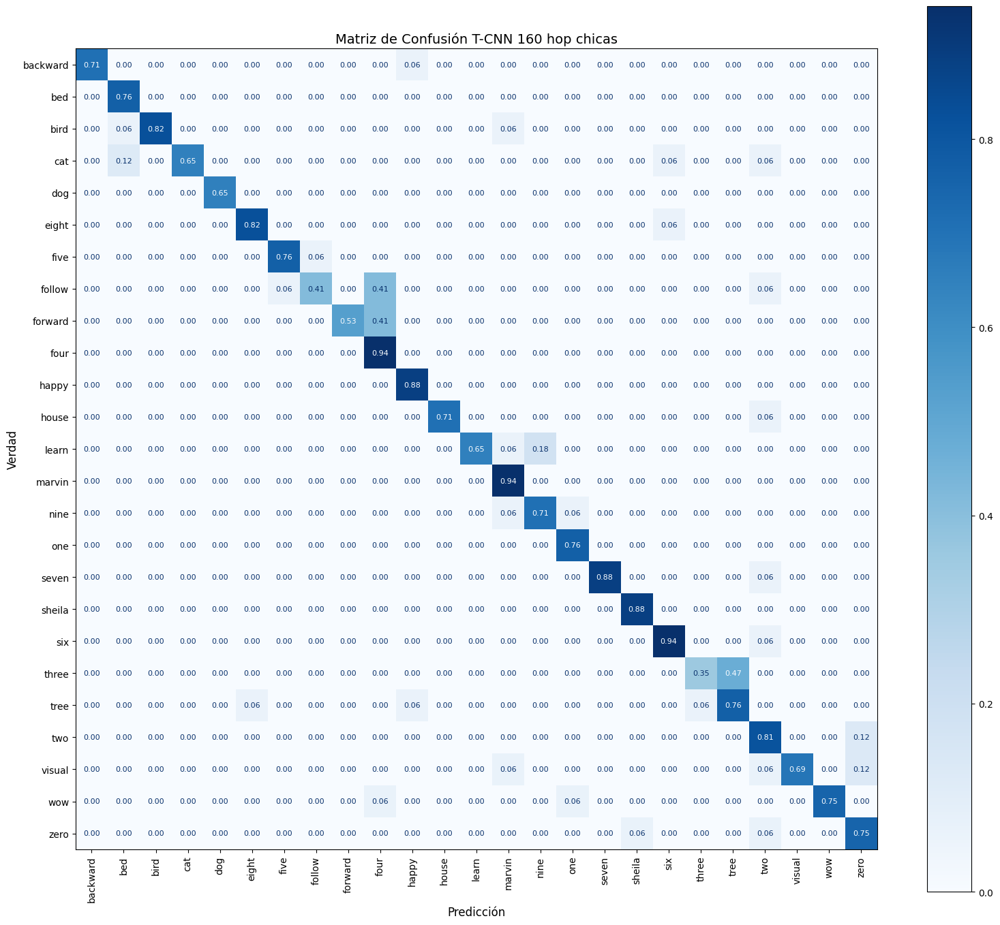

              precision    recall  f1-score   support

    backward       1.00      0.92      0.96        13
         bed       0.81      1.00      0.90        13
        bird       1.00      0.88      0.93        16
         cat       1.00      0.73      0.85        15
         dog       1.00      1.00      1.00        11
       eight       0.93      0.93      0.93        15
        five       0.93      0.93      0.93        14
      follow       0.88      0.44      0.58        16
     forward       1.00      0.56      0.72        16
        four       0.52      1.00      0.68        16
       happy       0.88      1.00      0.94        15
       house       1.00      0.92      0.96        13
       learn       1.00      0.73      0.85        15
      marvin       0.80      1.00      0.89        16
        nine       0.80      0.86      0.83        14
         one       0.87      1.00      0.93        13
       seven       1.00      0.94      0.97        16
      sheila       0.94    

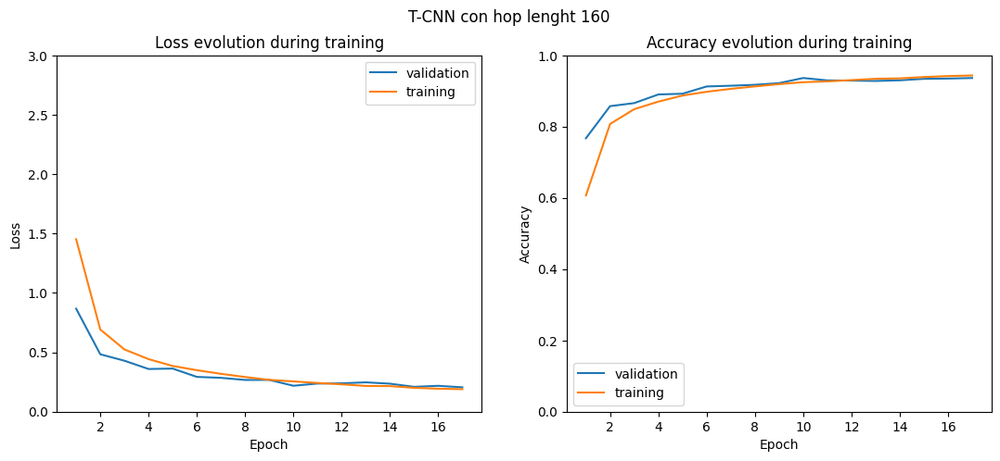

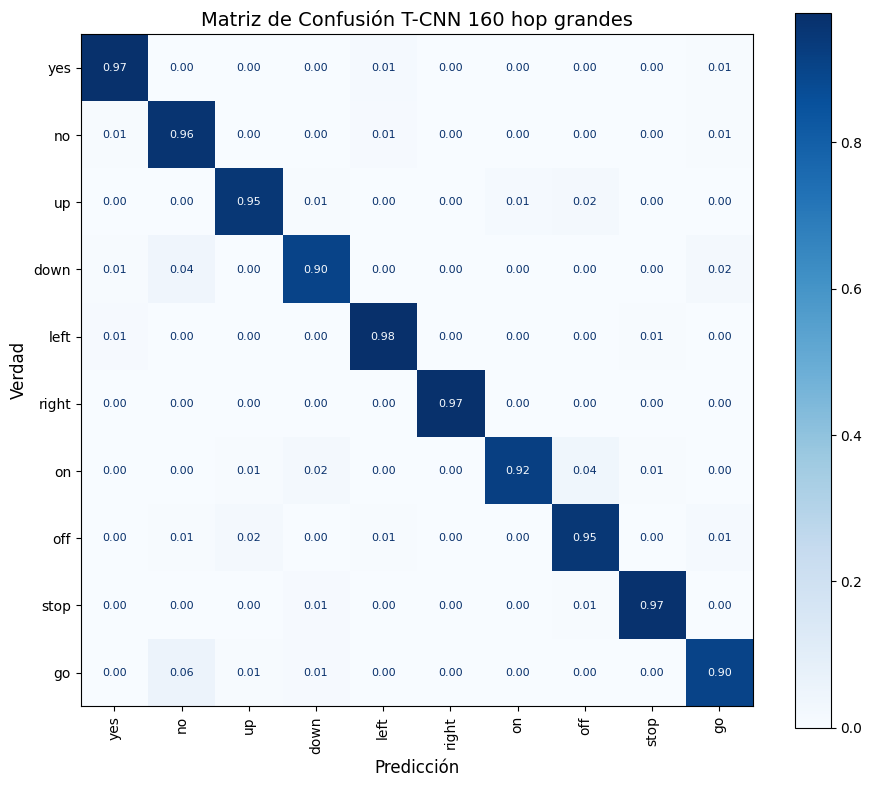

              precision    recall  f1-score   support

         yes       0.97      0.97      0.97       395
          no       0.89      0.97      0.93       393
          up       0.96      0.96      0.96       391
        down       0.95      0.92      0.94       387
        left       0.96      0.98      0.97       395
       right       0.99      0.99      0.99       389
          on       0.98      0.93      0.95       391
         off       0.93      0.95      0.94       396
        stop       0.98      0.97      0.98       393
          go       0.95      0.92      0.94       388

    accuracy                           0.96      3918
   macro avg       0.96      0.96      0.96      3918
weighted avg       0.96      0.96      0.96      3918

Precisión global (Accuracy): 0.9566
📁 Métricas guardadas en: metricas_T-CNN_160_hop_grandes.json

========== Iteración 3/3 ==========
Epoch 1/40
Iteration 84 - Batch 84/508 - Train loss: 2.6516, Train acc: 26.65%
Iteration 168 - Batch 168/50

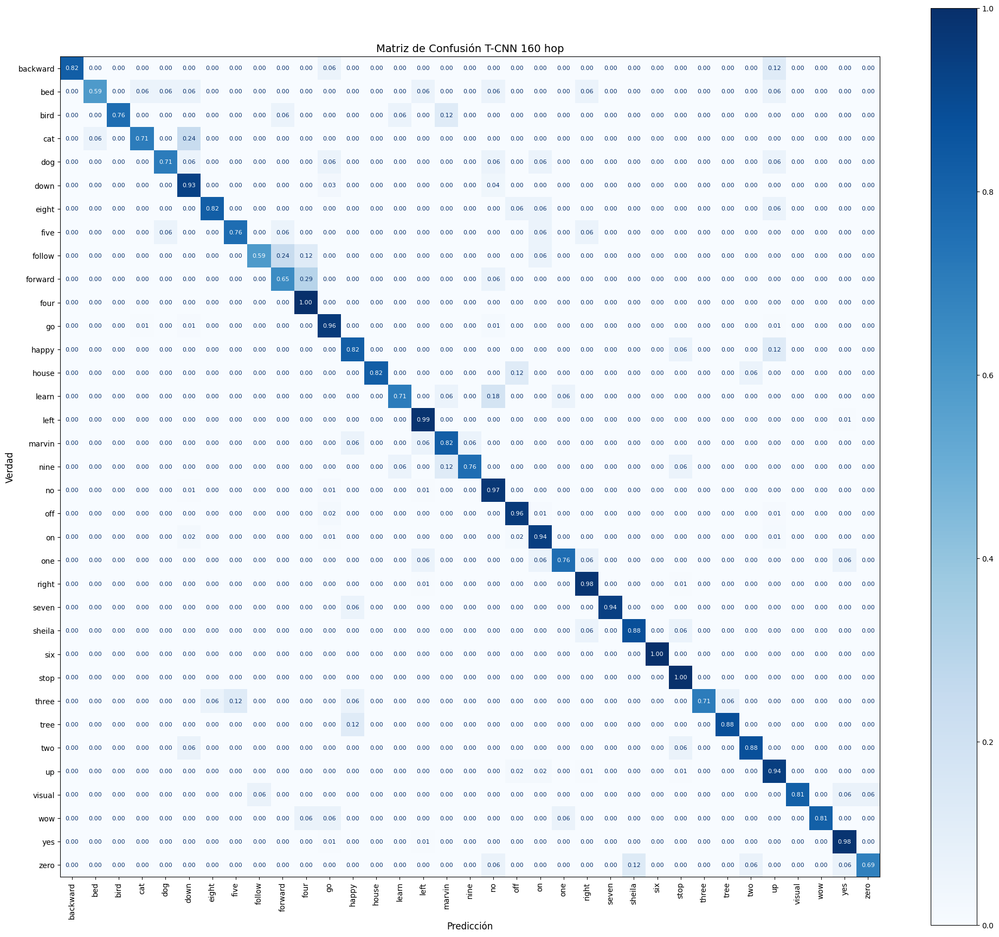

              precision    recall  f1-score   support

    backward       1.00      0.82      0.90        17
         bed       0.91      0.59      0.71        17
        bird       0.93      0.76      0.84        17
         cat       0.75      0.71      0.73        17
         dog       0.80      0.71      0.75        17
        down       0.94      0.93      0.94       396
       eight       0.93      0.82      0.88        17
        five       0.76      0.76      0.76        17
      follow       0.83      0.59      0.69        17
     forward       0.65      0.65      0.65        17
        four       0.68      1.00      0.81        17
          go       0.93      0.96      0.94       396
       happy       0.74      0.82      0.78        17
       house       0.93      0.82      0.88        17
       learn       0.86      0.71      0.77        17
        left       0.97      0.99      0.98       396
      marvin       0.74      0.82      0.78        17
        nine       0.93    

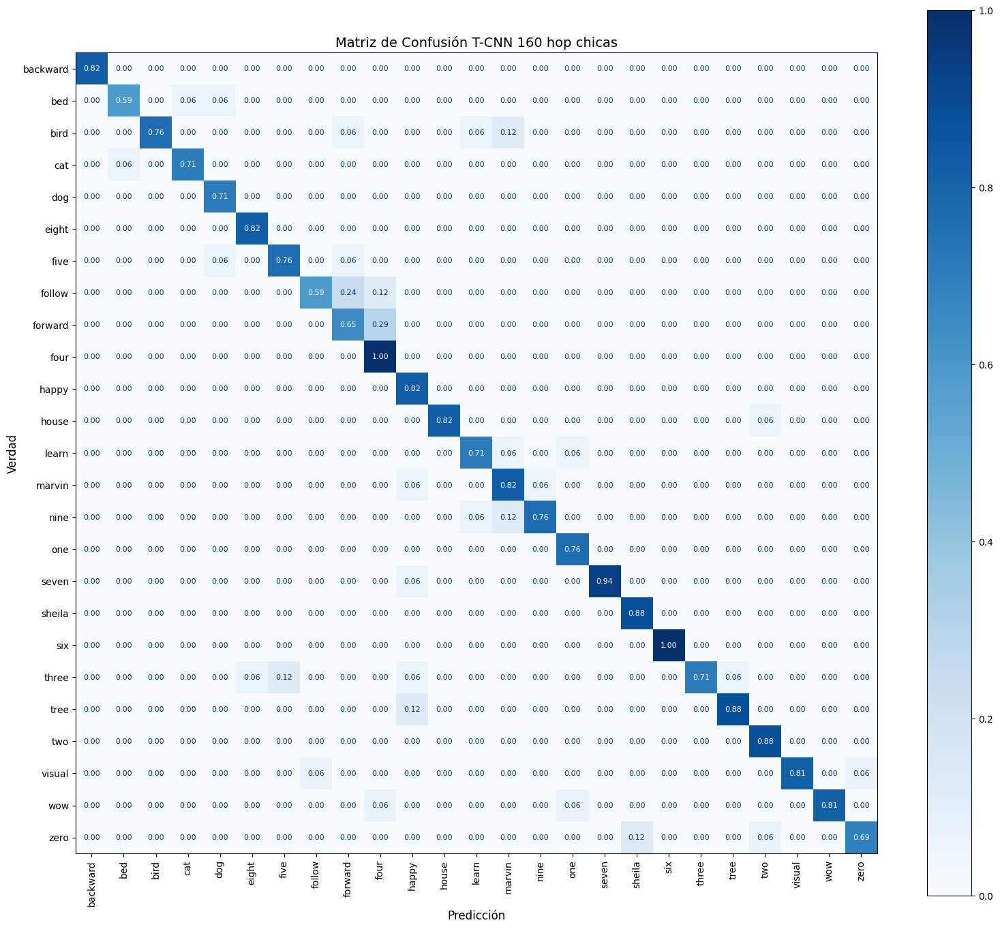

              precision    recall  f1-score   support

    backward       1.00      1.00      1.00        14
         bed       0.91      0.83      0.87        12
        bird       1.00      0.76      0.87        17
         cat       0.92      0.92      0.92        13
         dog       0.86      1.00      0.92        12
       eight       0.93      1.00      0.97        14
        five       0.87      0.87      0.87        15
      follow       0.91      0.62      0.74        16
     forward       0.65      0.69      0.67        16
        four       0.68      1.00      0.81        17
       happy       0.74      1.00      0.85        14
       house       1.00      0.93      0.97        15
       learn       0.86      0.86      0.86        14
      marvin       0.74      0.88      0.80        16
        nine       0.93      0.81      0.87        16
         one       0.87      1.00      0.93        13
       seven       1.00      0.94      0.97        17
      sheila       0.88    

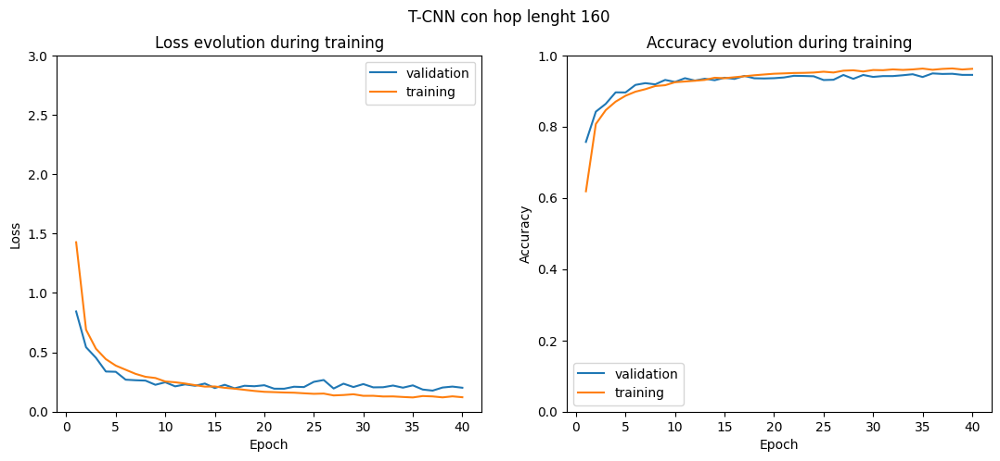

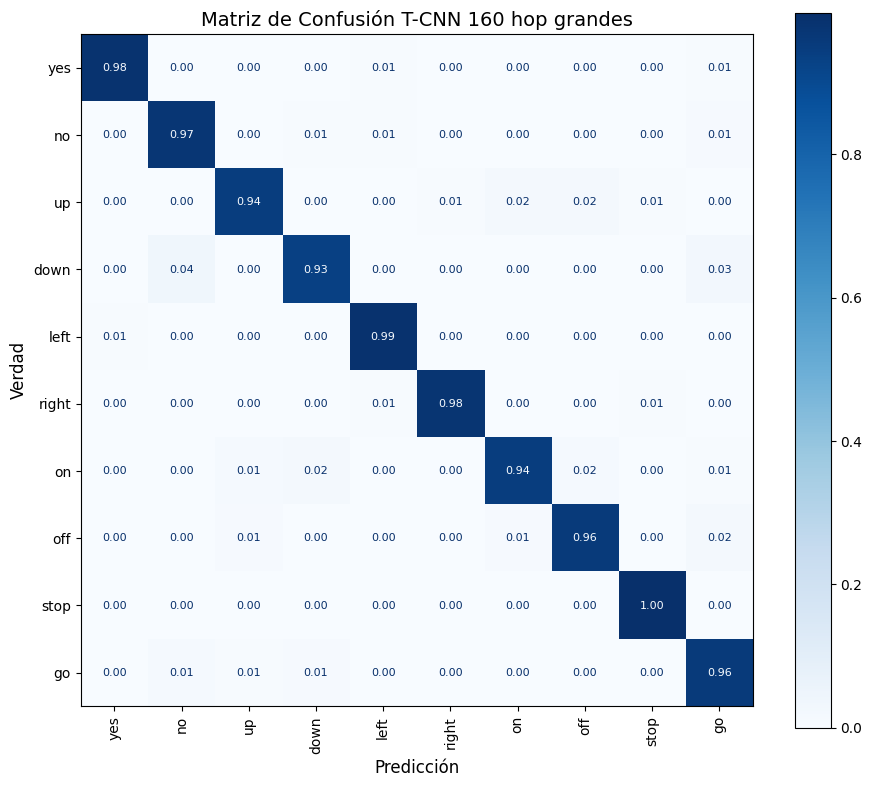

              precision    recall  f1-score   support

         yes       0.99      0.98      0.99       396
          no       0.95      0.97      0.96       395
          up       0.96      0.95      0.96       393
        down       0.96      0.93      0.94       396
        left       0.98      0.99      0.98       395
       right       0.99      0.98      0.99       393
          on       0.97      0.95      0.96       395
         off       0.96      0.96      0.96       396
        stop       0.99      1.00      0.99       396
          go       0.94      0.97      0.95       392

    accuracy                           0.97      3947
   macro avg       0.97      0.97      0.97      3947
weighted avg       0.97      0.97      0.97      3947

Precisión global (Accuracy): 0.9683
📁 Métricas guardadas en: metricas_T-CNN_160_hop_grandes.json

========== Iteración 4/3 ==========
Epoch 1/40
Iteration 84 - Batch 84/508 - Train loss: 2.6243, Train acc: 29.67%
Iteration 168 - Batch 168/50

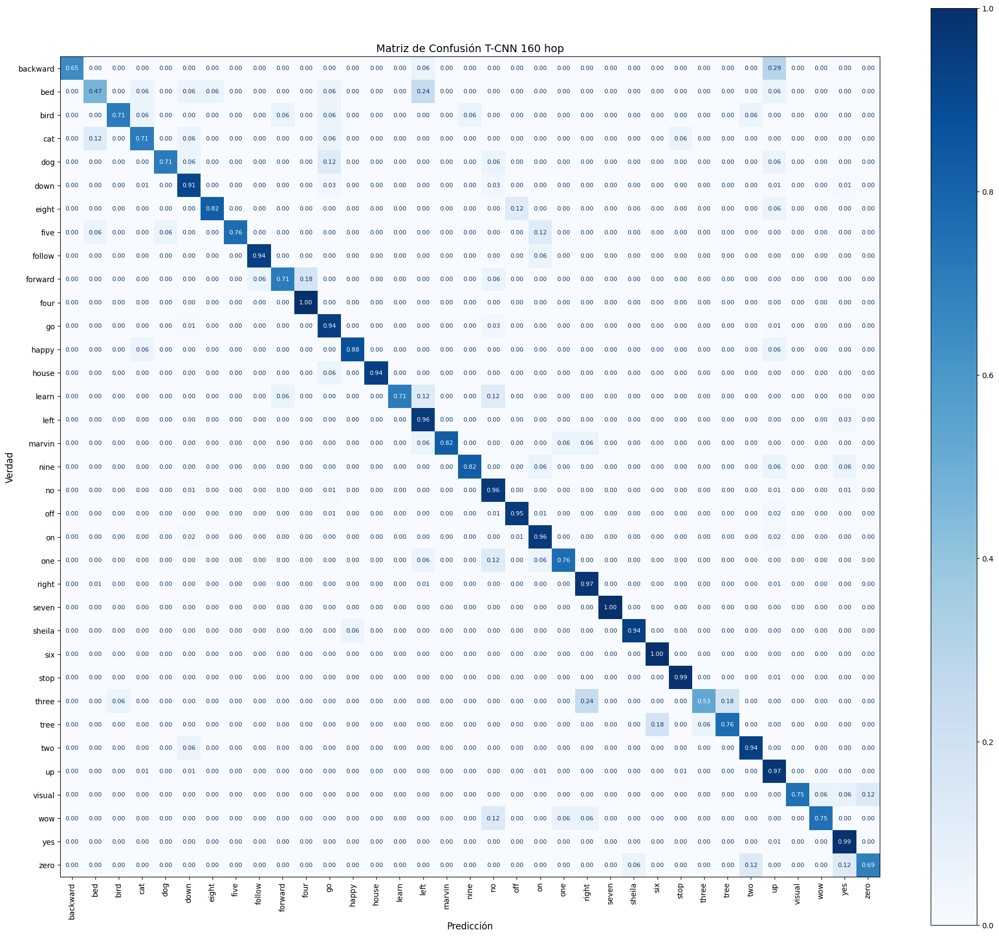

              precision    recall  f1-score   support

    backward       1.00      0.65      0.79        17
         bed       0.62      0.47      0.53        17
        bird       0.92      0.71      0.80        17
         cat       0.57      0.71      0.63        17
         dog       0.92      0.71      0.80        17
        down       0.95      0.91      0.93       396
       eight       0.93      0.82      0.88        17
        five       1.00      0.76      0.87        17
      follow       0.89      0.94      0.91        17
     forward       0.86      0.71      0.77        17
        four       0.85      1.00      0.92        17
          go       0.93      0.94      0.94       396
       happy       0.94      0.88      0.91        17
       house       1.00      0.94      0.97        17
       learn       1.00      0.71      0.83        17
        left       0.96      0.96      0.96       396
      marvin       1.00      0.82      0.90        17
        nine       0.93    

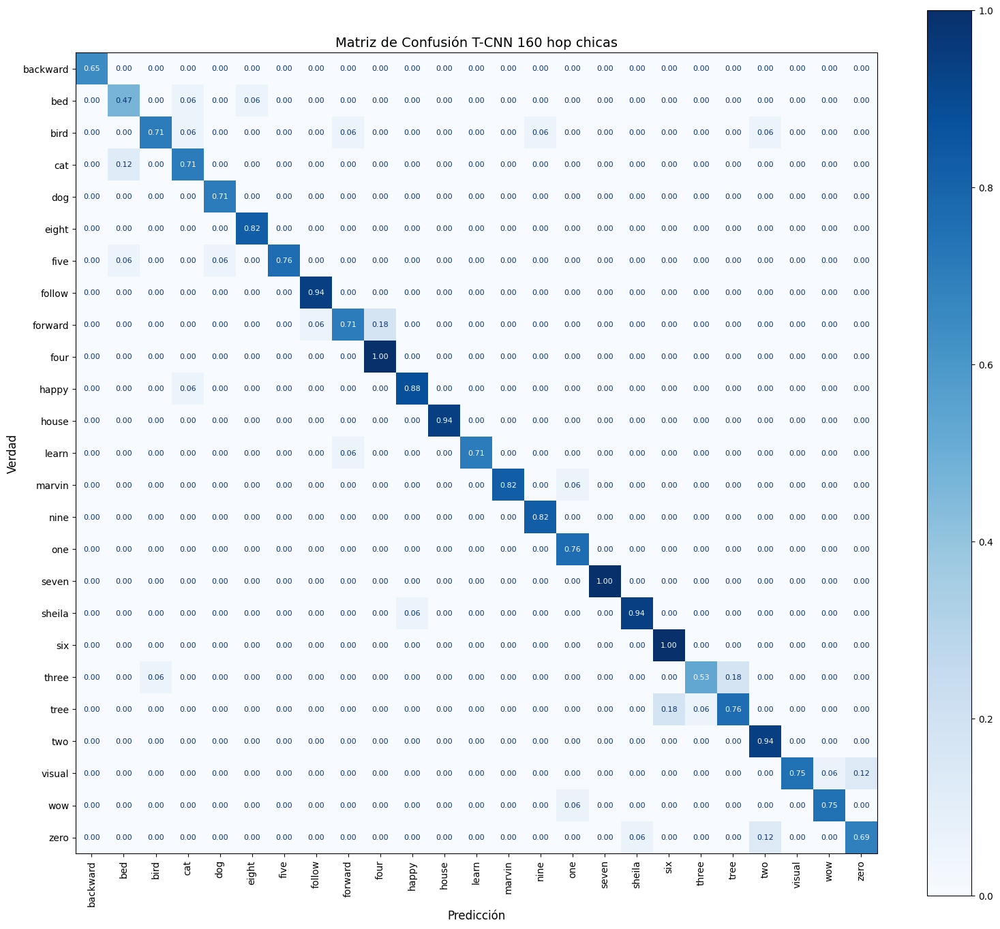

              precision    recall  f1-score   support

    backward       1.00      1.00      1.00        11
         bed       0.73      0.80      0.76        10
        bird       0.92      0.75      0.83        16
         cat       0.80      0.86      0.83        14
         dog       0.92      1.00      0.96        12
       eight       0.93      1.00      0.97        14
        five       1.00      0.87      0.93        15
      follow       0.94      1.00      0.97        16
     forward       0.86      0.75      0.80        16
        four       0.85      1.00      0.92        17
       happy       0.94      0.94      0.94        16
       house       1.00      1.00      1.00        16
       learn       1.00      0.92      0.96        13
      marvin       1.00      0.93      0.97        15
        nine       0.93      1.00      0.97        14
         one       0.87      1.00      0.93        13
       seven       1.00      1.00      1.00        17
      sheila       0.94    

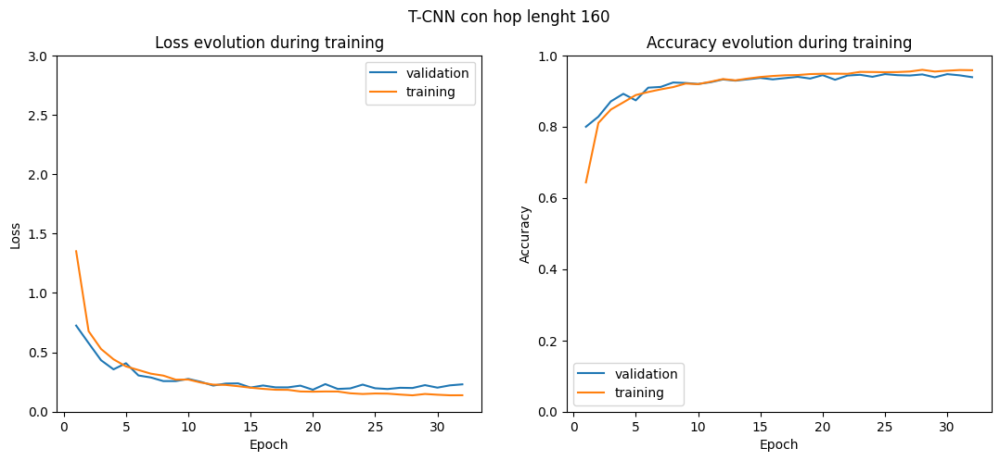

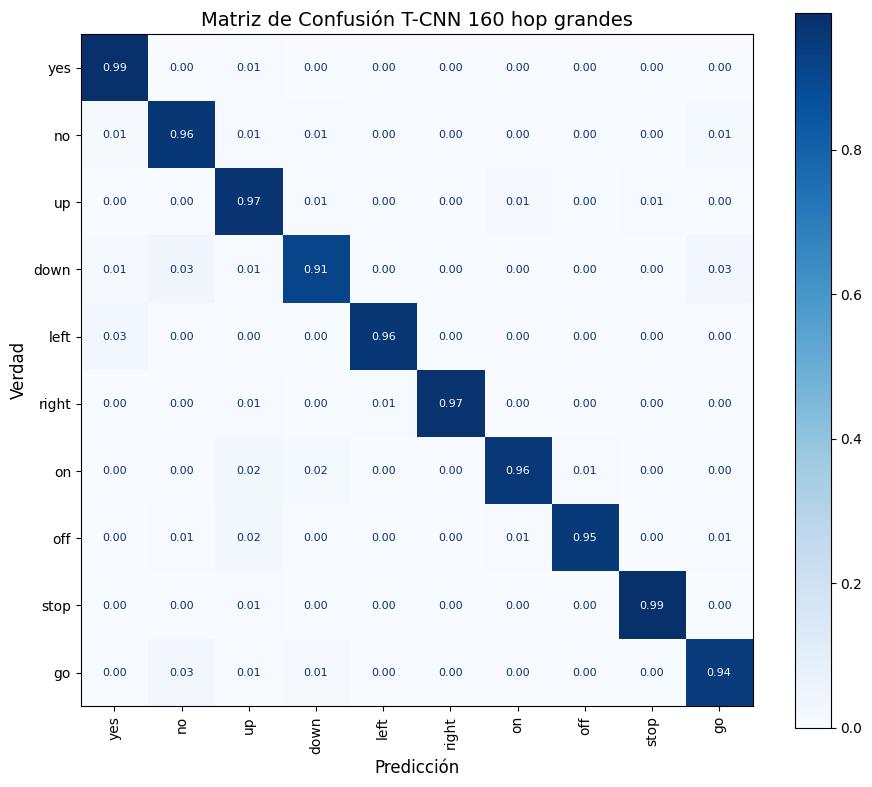

              precision    recall  f1-score   support

         yes       0.95      0.99      0.97       395
          no       0.94      0.96      0.95       395
          up       0.92      0.98      0.95       394
        down       0.96      0.92      0.94       394
        left       0.99      0.96      0.97       395
       right       0.99      0.98      0.99       394
          on       0.98      0.96      0.97       395
         off       0.99      0.95      0.97       396
        stop       0.98      0.99      0.99       396
          go       0.95      0.95      0.95       393

    accuracy                           0.96      3947
   macro avg       0.96      0.96      0.96      3947
weighted avg       0.96      0.96      0.96      3947

Precisión global (Accuracy): 0.9640
📁 Métricas guardadas en: metricas_T-CNN_160_hop_grandes.json

========== Iteración 5/3 ==========
Epoch 1/40
Iteration 84 - Batch 84/508 - Train loss: 2.6334, Train acc: 26.99%
Iteration 168 - Batch 168/50

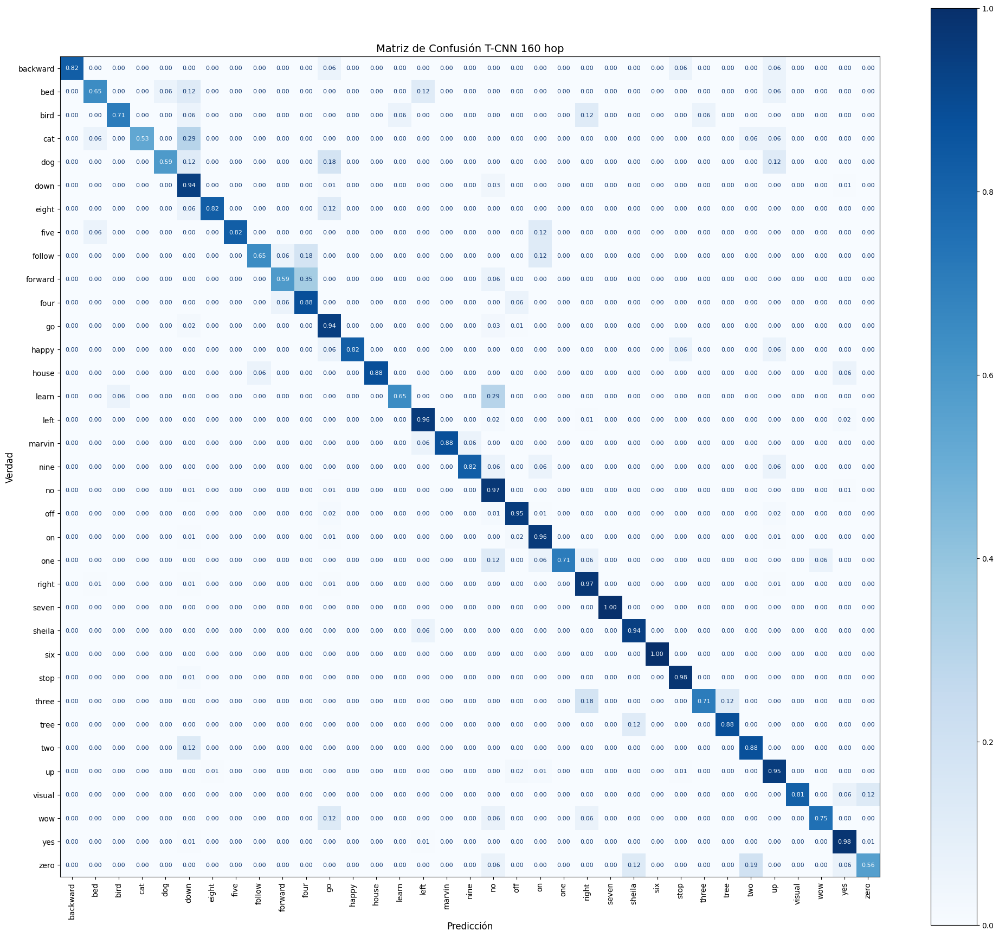

              precision    recall  f1-score   support

    backward       1.00      0.82      0.90        17
         bed       0.73      0.65      0.69        17
        bird       0.86      0.71      0.77        17
         cat       0.90      0.53      0.67        17
         dog       0.91      0.59      0.71        17
        down       0.92      0.94      0.93       396
       eight       0.88      0.82      0.85        17
        five       1.00      0.82      0.90        17
      follow       0.92      0.65      0.76        17
     forward       0.83      0.59      0.69        17
        four       0.62      0.88      0.73        17
          go       0.92      0.94      0.93       396
       happy       1.00      0.82      0.90        17
       house       1.00      0.88      0.94        17
       learn       0.92      0.65      0.76        17
        left       0.97      0.96      0.97       396
      marvin       0.94      0.88      0.91        17
        nine       0.93    

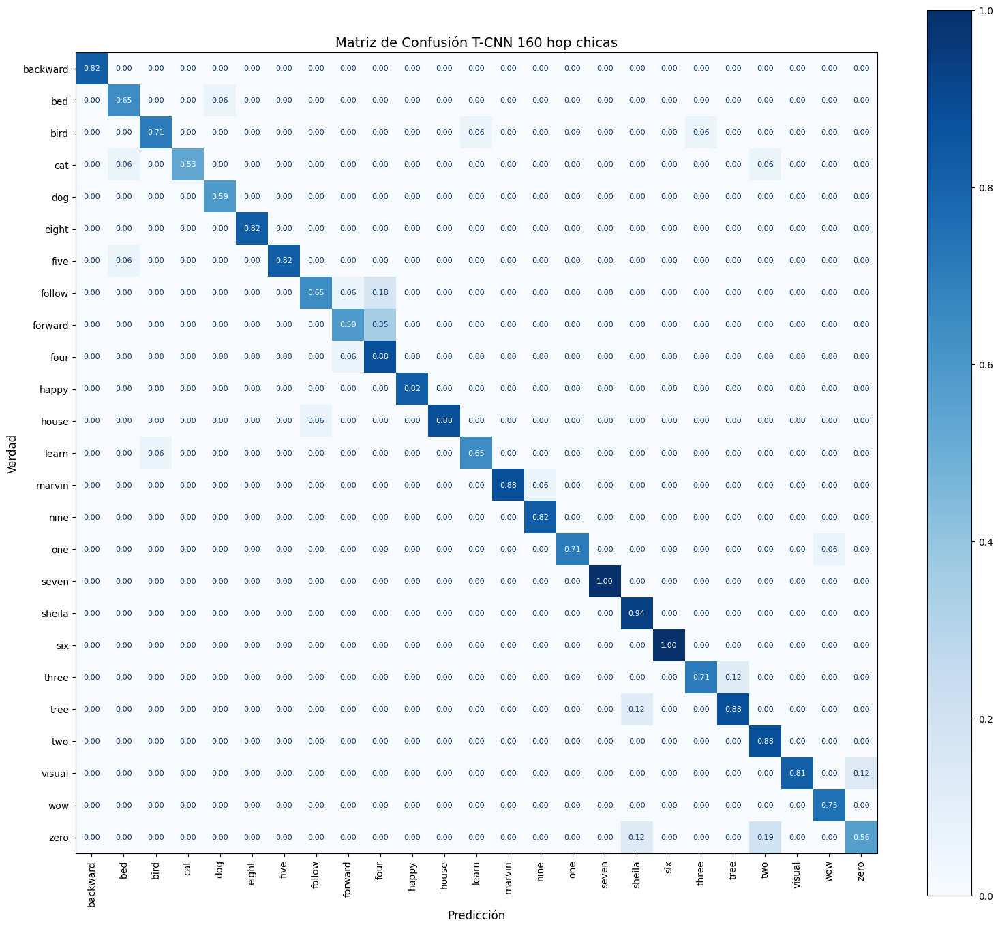

              precision    recall  f1-score   support

    backward       1.00      1.00      1.00        14
         bed       0.85      0.92      0.88        12
        bird       0.92      0.86      0.89        14
         cat       1.00      0.82      0.90        11
         dog       0.91      1.00      0.95        10
       eight       1.00      1.00      1.00        14
        five       1.00      0.93      0.97        15
      follow       0.92      0.73      0.81        15
     forward       0.83      0.62      0.71        16
        four       0.62      0.94      0.75        16
       happy       1.00      1.00      1.00        14
       house       1.00      0.94      0.97        16
       learn       0.92      0.92      0.92        12
      marvin       1.00      0.94      0.97        16
        nine       0.93      1.00      0.97        14
         one       1.00      0.92      0.96        13
       seven       1.00      1.00      1.00        17
      sheila       0.80    

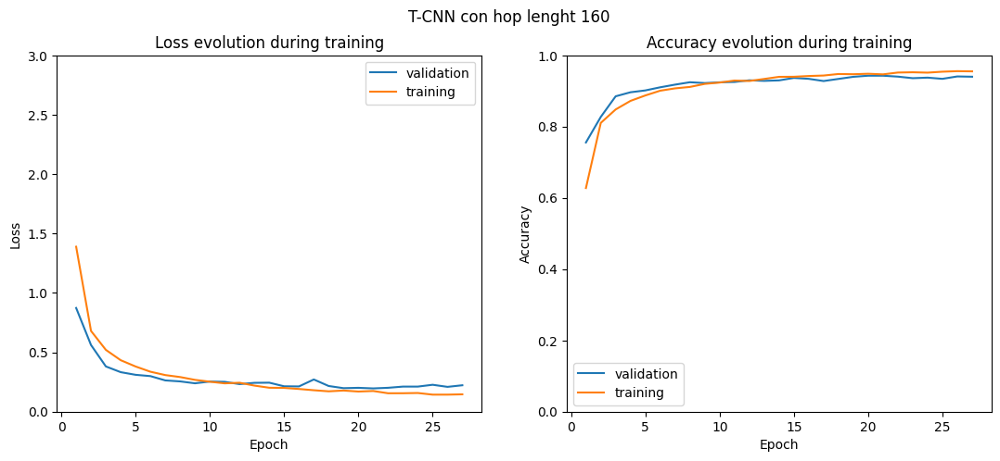

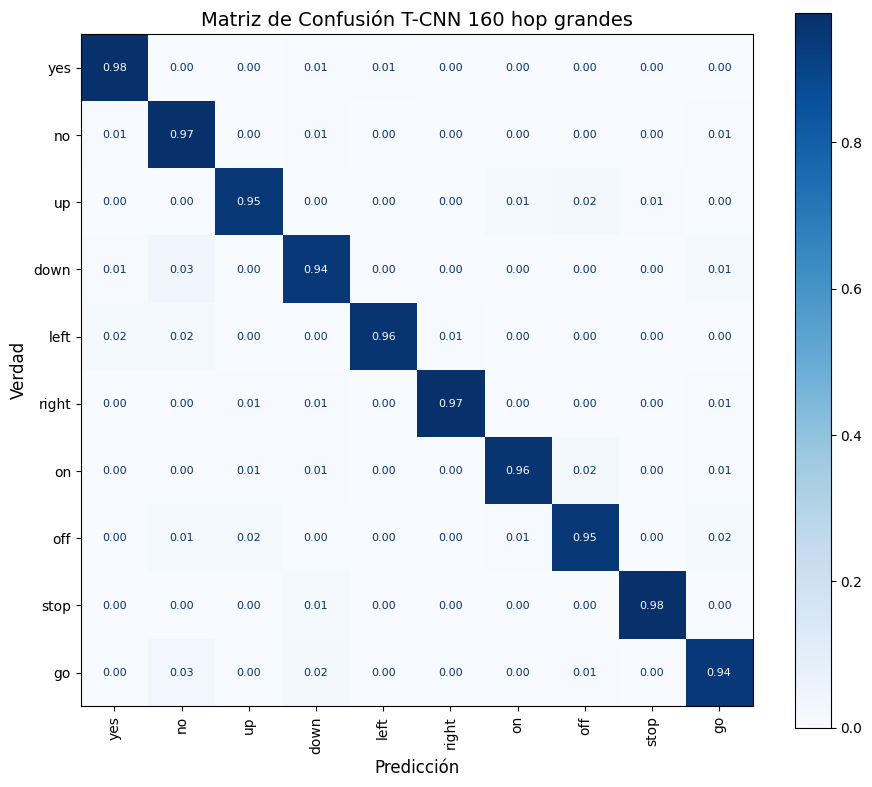

              precision    recall  f1-score   support

         yes       0.97      0.98      0.98       393
          no       0.92      0.97      0.94       396
          up       0.96      0.96      0.96       393
        down       0.95      0.94      0.95       396
        left       0.98      0.96      0.97       395
       right       0.99      0.98      0.99       393
          on       0.97      0.96      0.97       396
         off       0.96      0.95      0.95       395
        stop       0.99      0.98      0.98       395
          go       0.94      0.95      0.95       395

    accuracy                           0.96      3947
   macro avg       0.96      0.96      0.96      3947
weighted avg       0.96      0.96      0.96      3947

Precisión global (Accuracy): 0.9633
📁 Métricas guardadas en: metricas_T-CNN_160_hop_grandes.json

===== Resultados finales =====
Precisión promedio (5 runs): 94.22% ± 0.81%
Modelo final guardado


In [ ]:
device = "cuda" if torch.cuda.is_available() else "cpu"

# Datos y clases
train_dl, val_dl, test_dl = load2(MFCC_train_10, MFCC_val_10, MFCC_test_10, batch_size=64)

# Función para obtener predicciones
@torch.no_grad()
def get_predictions(loader, model, device="cpu"):
    model = model.to(device)
    model.eval()
    all_predictions, all_true_labels = [], []
    for xb, yb in loader:
        xb, yb = xb.to(device), yb.to(device)
        pred = model(xb).argmax(1)
        all_predictions.extend(pred.cpu().numpy())
        all_true_labels.extend(yb.cpu().numpy())
    return np.array(all_true_labels), np.array(all_predictions)

# Loop de 5 iteraciones
accuracies = []

for i in range(5):
    print(f"\n========== Iteración {i+1}/3 ==========")
    model = T_CNN(num_inputs=39,
        num_layers=6,
        channels_per_layer=50,
        kernel_size=3,
        n_classes=35,
        dropout=0.2,
        causal=True).to(device)

    criterion = nn.CrossEntropyLoss()

    curves = train_model(
        model, train_dl, val_dl,
        epochs=40, lr=1e-3,
        criterion=criterion,
        device=device,
        early_stopping_patience=7
    )

    true_labels, predictions = get_predictions(test_dl, model, device)
    acc = (predictions == true_labels).mean() * 100
    accuracies.append(acc)
    print(f"✅ Precisión iteración {i+1}: {acc:.2f}%")
    # Matriz de confusión del último modelo entrenado
    show_confusion_matrix(
        true_labels, predictions,
        clases_10,
        title=f"Matriz de Confusión T-CNN 160 hop",
        filename="matriz_confusion_T-CNN_160_hop.png",
        metrics_filename="metricas_T-CNN_160_hop.json"
    )

    # Matriz de confusión del último modelo entrenado
    show_confusion_matrix(
        true_labels, predictions,
        clases_10,
        title=f"Matriz de Confusión T-CNN 160 hop chicas",
        filename="matriz_confusion_T-CNN_160_hop_chicas.png",
        selected_classes = clases_chicas,
        metrics_filename="metricas_T-CNN_160_hop_chicas.json"
    )
    show_curves(curves, title="T-CNN con hop lenght 160" , filename="Curva_T-CNN_160_hop.png")

    # Matriz de confusión del último modelo entrenado
    show_confusion_matrix(
        true_labels, predictions,
        clases_10,
        title=f"Matriz de Confusión T-CNN 160 hop grandes",
        filename="matriz_confusion_T-CNN_160_hop_grandes.png",
        selected_classes = clases_grandes,
        metrics_filename="metricas_T-CNN_160_hop_grandes.json"
)

# Promedio y desviación estándar
mean_acc = np.mean(accuracies)
std_acc = np.std(accuracies)

print("\n===== Resultados finales =====")
print(f"Precisión promedio (5 runs): {mean_acc:.2f}% ± {std_acc:.2f}%")

torch.save(model.state_dict(), "modelo_T-CNN_160.pth")
print("Modelo final guardado")



In [ ]:
model_summary(model)
time_per_sample, total_time = measure_inference_time(model, test_dl, device)

print(f"⏱️ Tiempo promedio por muestra: {time_per_sample*1000:.3f} ms")
print(f"⏱️ Tiempo total sobre el test: {total_time:.2f} s")

📌 Parámetros entrenables: 108,993
📦 Tamaño aproximado en memoria: 0.47 MB
💾 Tamaño real del archivo .pth: 0.49 MB
⏱️ Tiempo promedio por muestra: 0.055 ms
⏱️ Tiempo total sobre el test: 0.24 s


##### GRU

{'backward': 0, 'bed': 1, 'bird': 2, 'cat': 3, 'dog': 4, 'down': 5, 'eight': 6, 'five': 7, 'follow': 8, 'forward': 9, 'four': 10, 'go': 11, 'happy': 12, 'house': 13, 'learn': 14, 'left': 15, 'marvin': 16, 'nine': 17, 'no': 18, 'off': 19, 'on': 20, 'one': 21, 'right': 22, 'seven': 23, 'sheila': 24, 'six': 25, 'stop': 26, 'three': 27, 'tree': 28, 'two': 29, 'up': 30, 'visual': 31, 'wow': 32, 'yes': 33, 'zero': 34}
{'backward': 0, 'bed': 1, 'bird': 2, 'cat': 3, 'dog': 4, 'down': 5, 'eight': 6, 'five': 7, 'follow': 8, 'forward': 9, 'four': 10, 'go': 11, 'happy': 12, 'house': 13, 'learn': 14, 'left': 15, 'marvin': 16, 'nine': 17, 'no': 18, 'off': 19, 'on': 20, 'one': 21, 'right': 22, 'seven': 23, 'sheila': 24, 'six': 25, 'stop': 26, 'three': 27, 'tree': 28, 'two': 29, 'up': 30, 'visual': 31, 'wow': 32, 'yes': 33, 'zero': 34}
{'backward': 0, 'bed': 1, 'bird': 2, 'cat': 3, 'dog': 4, 'down': 5, 'eight': 6, 'five': 7, 'follow': 8, 'forward': 9, 'four': 10, 'go': 11, 'happy': 12, 'house': 13, 'l

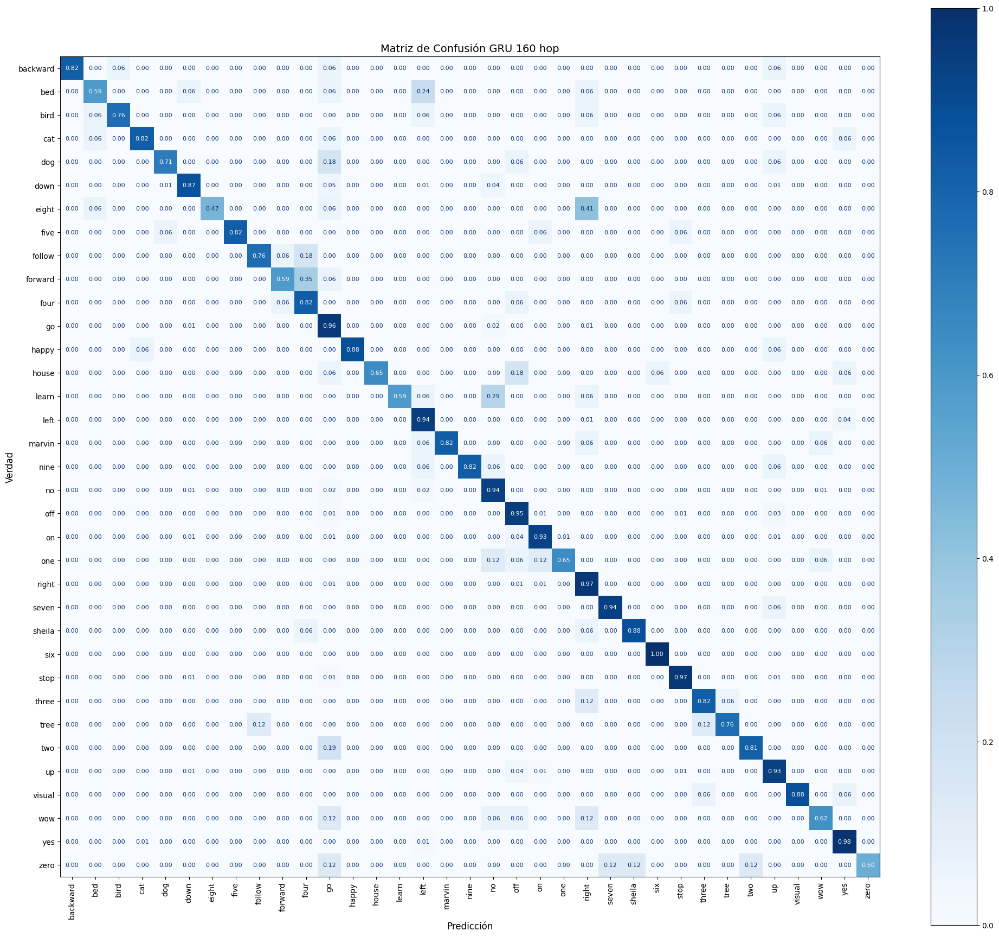

              precision    recall  f1-score   support

    backward       1.00      0.82      0.90        17
         bed       0.62      0.59      0.61        17
        bird       0.87      0.76      0.81        17
         cat       0.74      0.82      0.78        17
         dog       0.71      0.71      0.71        17
        down       0.96      0.87      0.92       396
       eight       1.00      0.47      0.64        17
        five       0.93      0.82      0.88        17
      follow       0.87      0.76      0.81        17
     forward       0.83      0.59      0.69        17
        four       0.58      0.82      0.68        17
          go       0.87      0.96      0.91       396
       happy       1.00      0.88      0.94        17
       house       1.00      0.65      0.79        17
       learn       0.91      0.59      0.71        17
        left       0.93      0.94      0.94       396
      marvin       1.00      0.82      0.90        17
        nine       0.93    

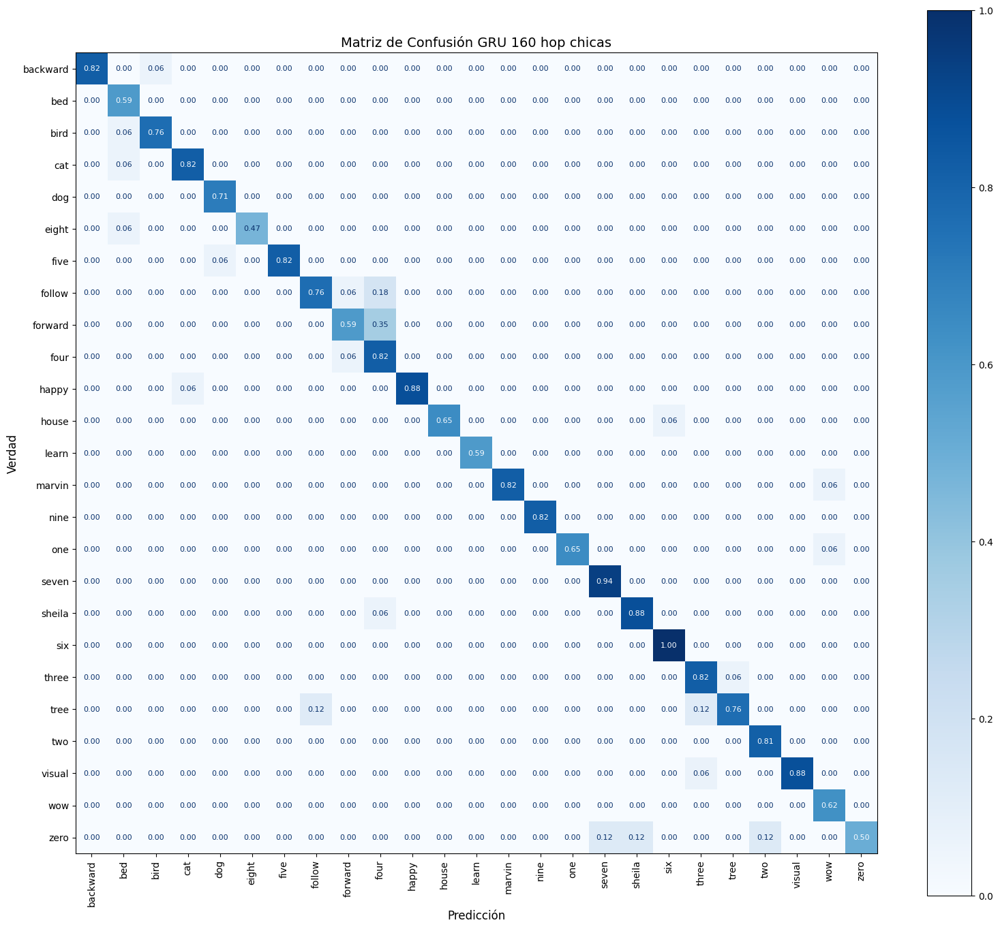

              precision    recall  f1-score   support

    backward       1.00      0.93      0.97        15
         bed       0.77      1.00      0.87        10
        bird       0.93      0.93      0.93        14
         cat       0.93      0.93      0.93        15
         dog       0.92      1.00      0.96        12
       eight       1.00      0.89      0.94         9
        five       1.00      0.93      0.97        15
      follow       0.87      0.76      0.81        17
     forward       0.83      0.62      0.71        16
        four       0.58      0.93      0.72        15
       happy       1.00      0.94      0.97        16
       house       1.00      0.92      0.96        12
       learn       1.00      1.00      1.00        10
      marvin       1.00      0.93      0.97        15
        nine       1.00      1.00      1.00        14
         one       1.00      0.92      0.96        12
       seven       0.89      1.00      0.94        16
      sheila       0.88    

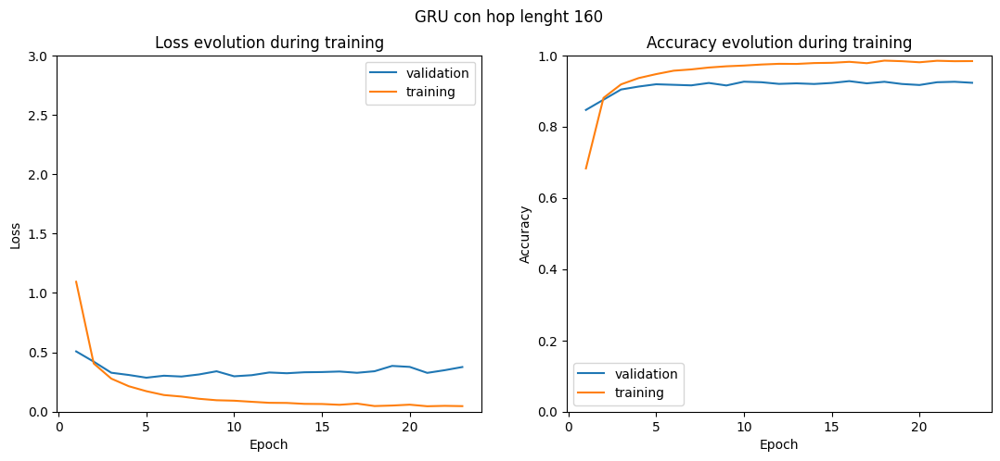

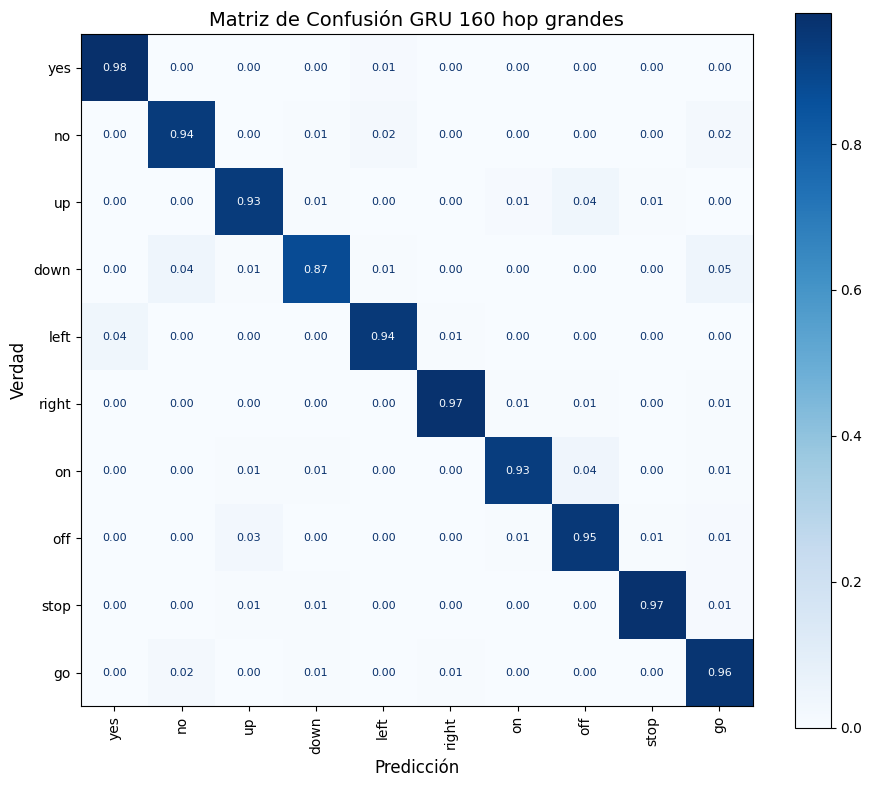

              precision    recall  f1-score   support

         yes       0.96      0.98      0.97       394
          no       0.93      0.95      0.94       391
          up       0.95      0.94      0.94       395
        down       0.96      0.89      0.93       388
        left       0.95      0.95      0.95       392
       right       0.98      0.97      0.98       394
          on       0.97      0.93      0.95       393
         off       0.91      0.95      0.93       396
        stop       0.99      0.97      0.98       395
          go       0.90      0.96      0.93       395

    accuracy                           0.95      3933
   macro avg       0.95      0.95      0.95      3933
weighted avg       0.95      0.95      0.95      3933

Precisión global (Accuracy): 0.9504
📁 Métricas guardadas en: metricas_GRU_160_hop_grandes.json

========== Iteración 2/3 ==========
Epoch 1/40
Iteration 84 - Batch 84/508 - Train loss: 2.2793, Train acc: 31.43%
Iteration 168 - Batch 168/508 

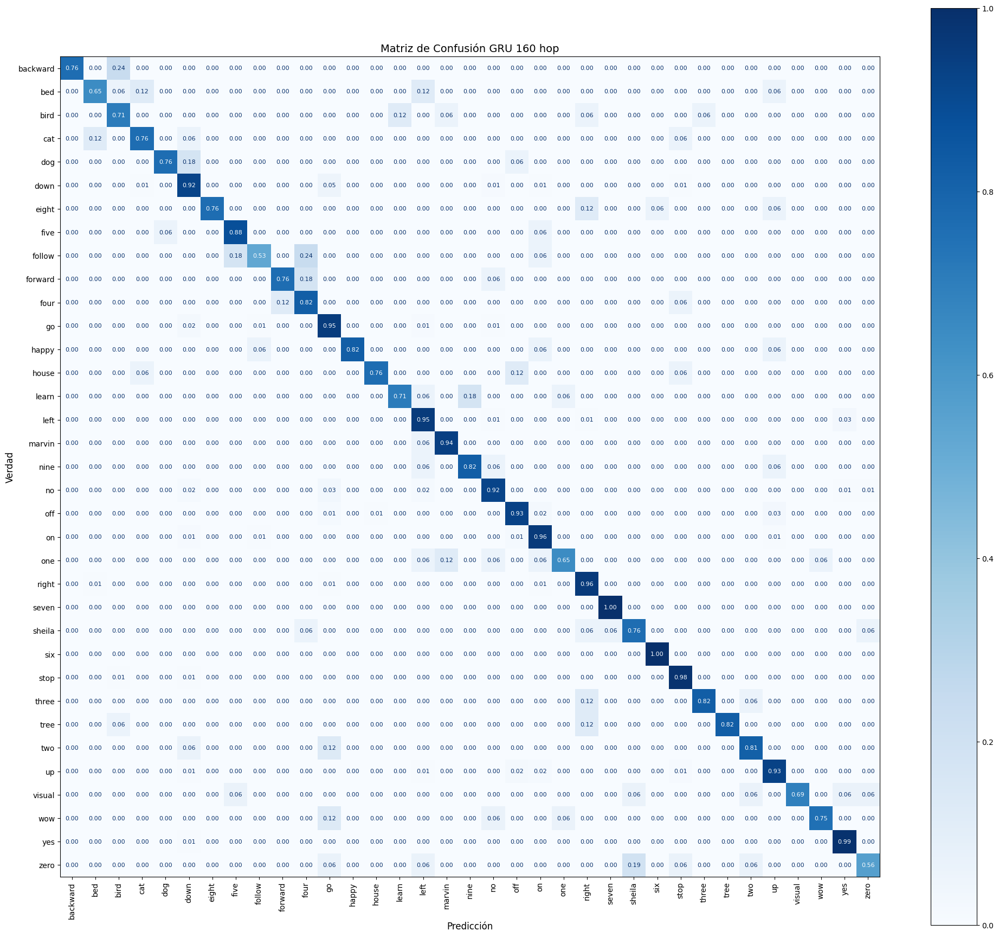

              precision    recall  f1-score   support

    backward       1.00      0.76      0.87        17
         bed       0.69      0.65      0.67        17
        bird       0.52      0.71      0.60        17
         cat       0.62      0.76      0.68        17
         dog       0.87      0.76      0.81        17
        down       0.93      0.92      0.92       396
       eight       1.00      0.76      0.87        17
        five       0.75      0.88      0.81        17
      follow       0.64      0.53      0.58        17
     forward       0.81      0.76      0.79        17
        four       0.64      0.82      0.72        17
          go       0.89      0.95      0.92       396
       happy       1.00      0.82      0.90        17
       house       0.81      0.76      0.79        17
       learn       0.80      0.71      0.75        17
        left       0.94      0.95      0.95       396
      marvin       0.84      0.94      0.89        17
        nine       0.82    

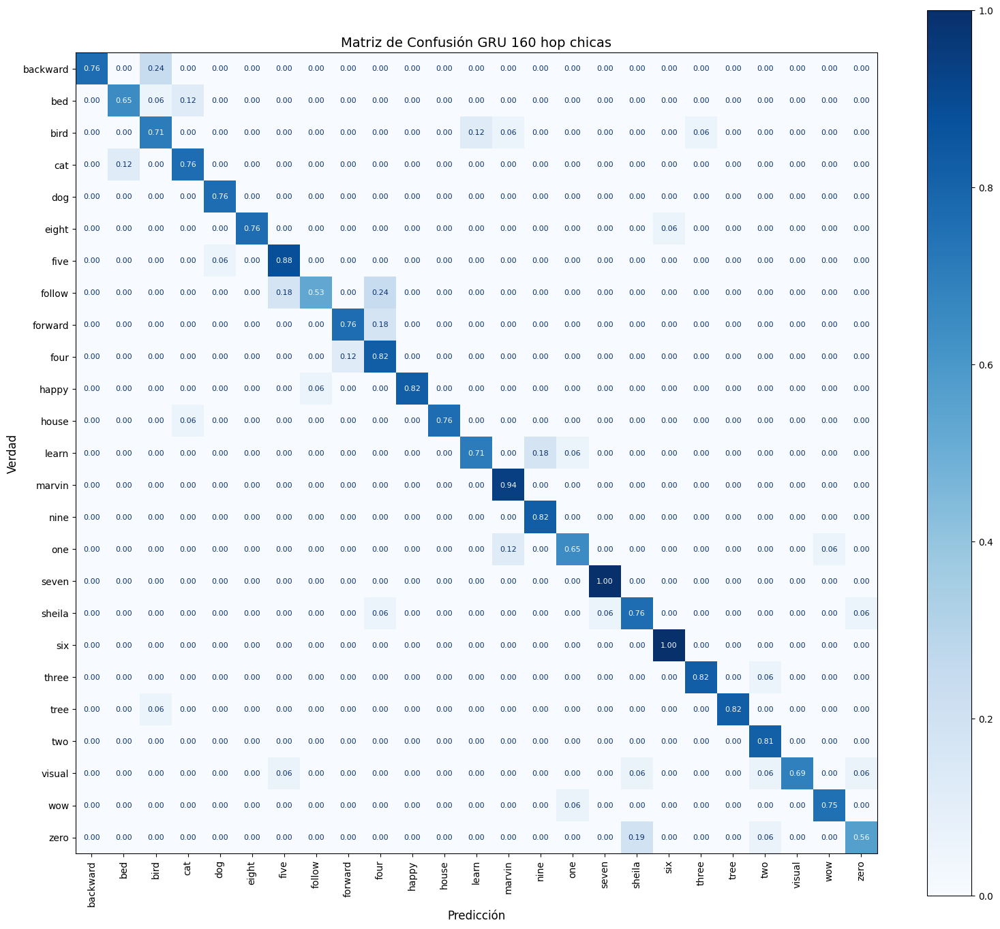

              precision    recall  f1-score   support

    backward       1.00      0.76      0.87        17
         bed       0.85      0.79      0.81        14
        bird       0.67      0.75      0.71        16
         cat       0.81      0.87      0.84        15
         dog       0.93      1.00      0.96        13
       eight       1.00      0.93      0.96        14
        five       0.79      0.94      0.86        16
      follow       0.90      0.56      0.69        16
     forward       0.87      0.81      0.84        16
        four       0.64      0.88      0.74        16
       happy       1.00      0.93      0.97        15
       house       1.00      0.93      0.96        14
       learn       0.86      0.75      0.80        16
      marvin       0.84      1.00      0.91        16
        nine       0.82      1.00      0.90        14
         one       0.85      0.79      0.81        14
       seven       0.94      1.00      0.97        17
      sheila       0.76    

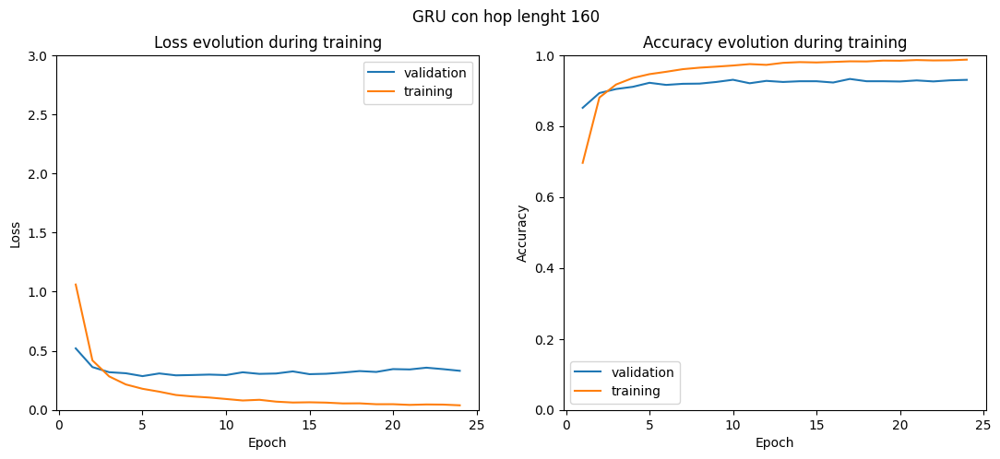

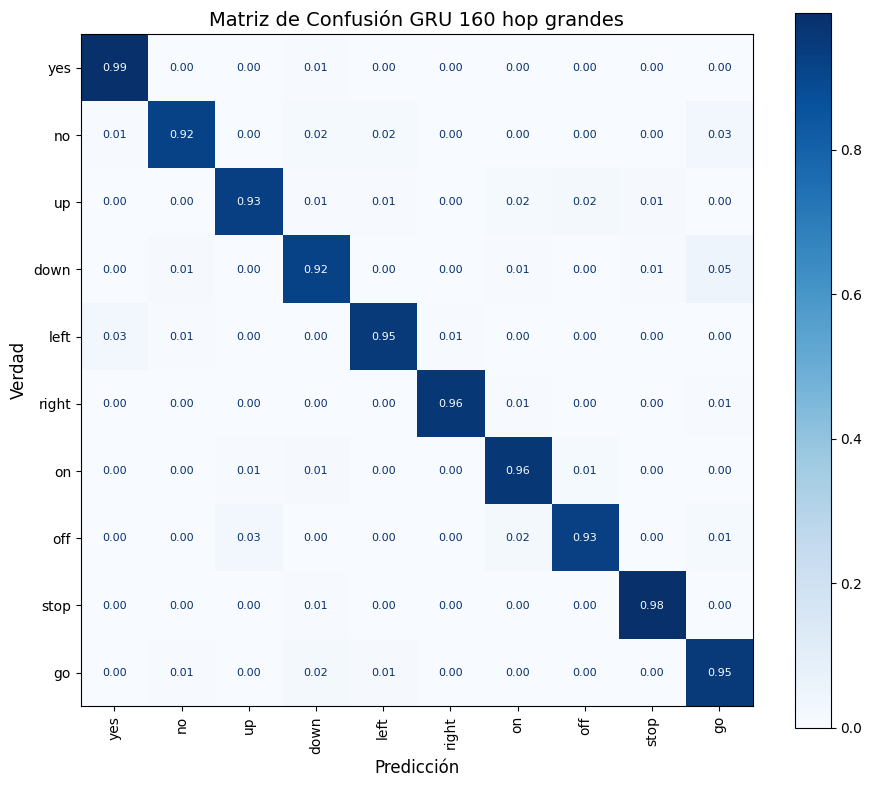

              precision    recall  f1-score   support

         yes       0.97      0.99      0.98       396
          no       0.97      0.93      0.95       392
          up       0.96      0.94      0.95       393
        down       0.94      0.92      0.93       394
        left       0.96      0.96      0.96       393
       right       0.99      0.98      0.98       388
          on       0.95      0.97      0.96       392
         off       0.97      0.94      0.95       392
        stop       0.98      0.99      0.98       394
          go       0.90      0.96      0.93       391

    accuracy                           0.96      3925
   macro avg       0.96      0.96      0.96      3925
weighted avg       0.96      0.96      0.96      3925

Precisión global (Accuracy): 0.9577
📁 Métricas guardadas en: metricas_GRU_160_hop_grandes.json

========== Iteración 3/3 ==========
Epoch 1/40
Iteration 84 - Batch 84/508 - Train loss: 2.2977, Train acc: 28.92%
Iteration 168 - Batch 168/508 

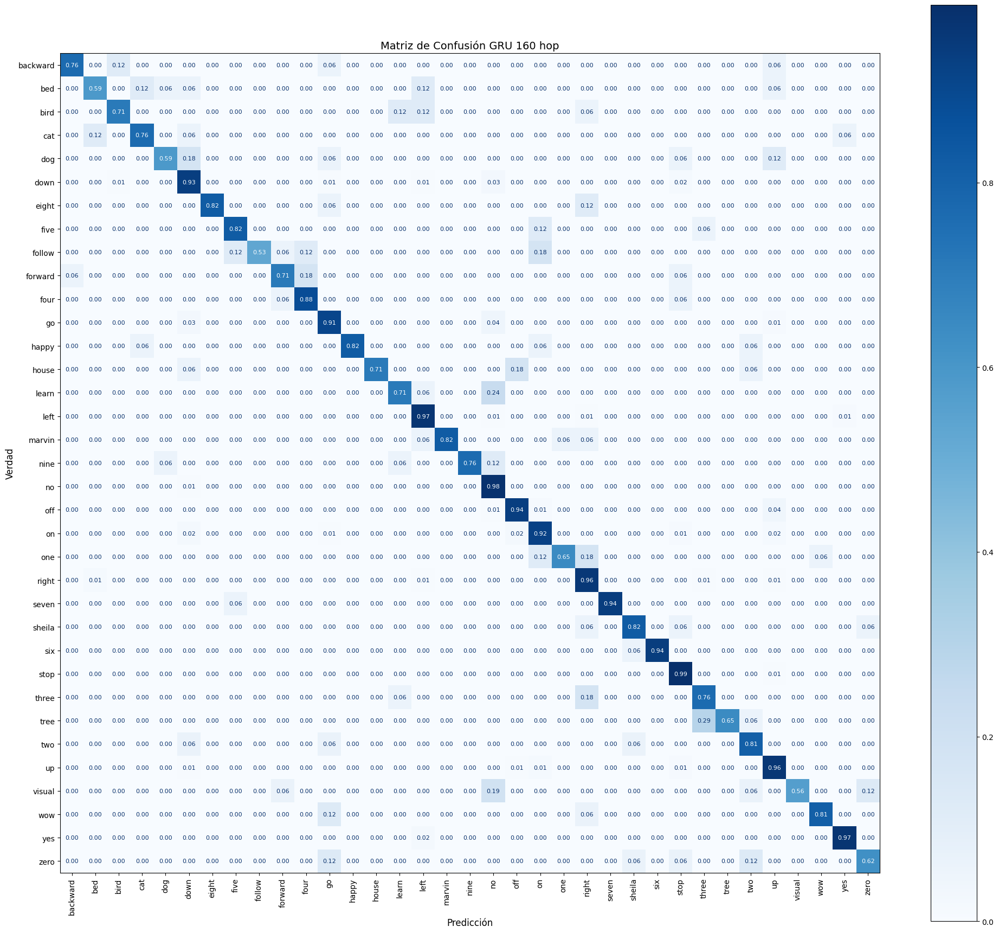

              precision    recall  f1-score   support

    backward       0.87      0.76      0.81        17
         bed       0.53      0.59      0.56        17
        bird       0.67      0.71      0.69        17
         cat       0.76      0.76      0.76        17
         dog       0.83      0.59      0.69        17
        down       0.92      0.93      0.93       396
       eight       1.00      0.82      0.90        17
        five       0.82      0.82      0.82        17
      follow       0.82      0.53      0.64        17
     forward       0.80      0.71      0.75        17
        four       0.75      0.88      0.81        17
          go       0.96      0.91      0.93       396
       happy       0.93      0.82      0.88        17
       house       1.00      0.71      0.83        17
       learn       0.67      0.71      0.69        17
        left       0.95      0.97      0.96       396
      marvin       1.00      0.82      0.90        17
        nine       0.93    

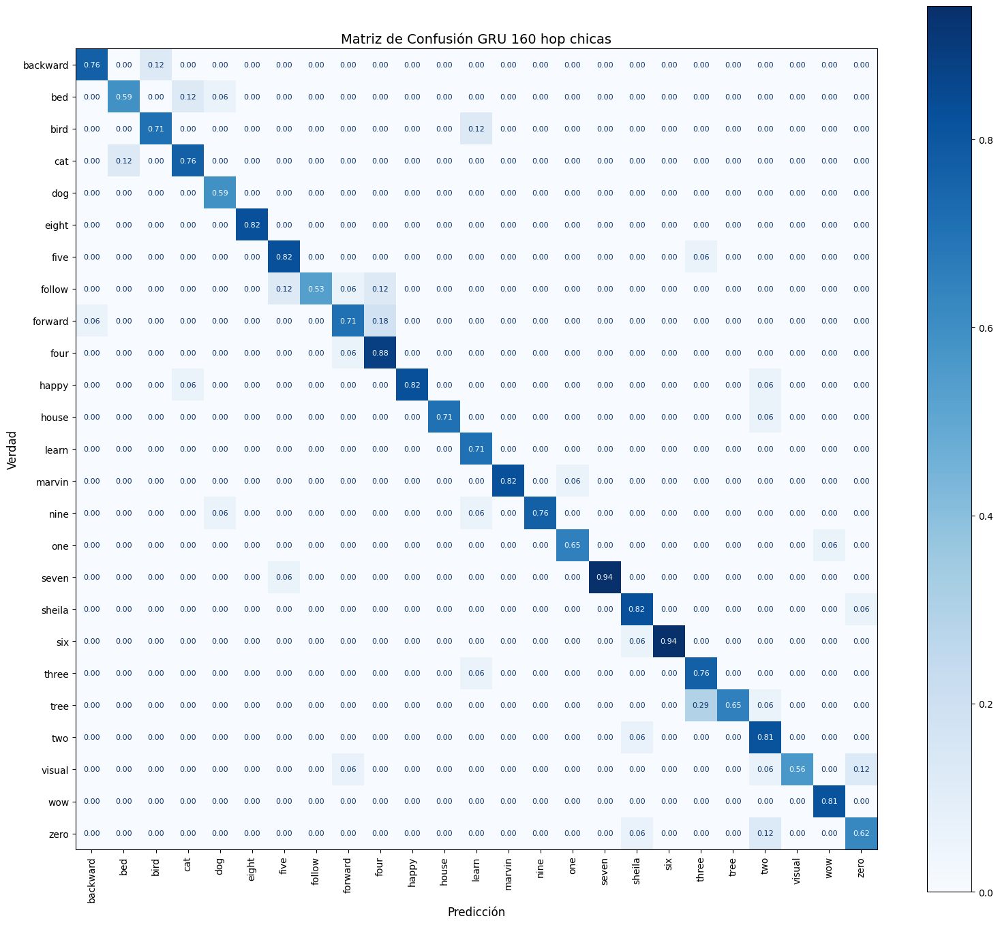

              precision    recall  f1-score   support

    backward       0.93      0.87      0.90        15
         bed       0.83      0.77      0.80        13
        bird       0.86      0.86      0.86        14
         cat       0.81      0.87      0.84        15
         dog       0.83      1.00      0.91        10
       eight       1.00      1.00      1.00        14
        five       0.82      0.93      0.88        15
      follow       1.00      0.64      0.78        14
     forward       0.80      0.75      0.77        16
        four       0.75      0.94      0.83        16
       happy       1.00      0.88      0.93        16
       house       1.00      0.92      0.96        13
       learn       0.75      1.00      0.86        12
      marvin       1.00      0.93      0.97        15
        nine       1.00      0.87      0.93        15
         one       0.92      0.92      0.92        12
       seven       1.00      0.94      0.97        17
      sheila       0.82    

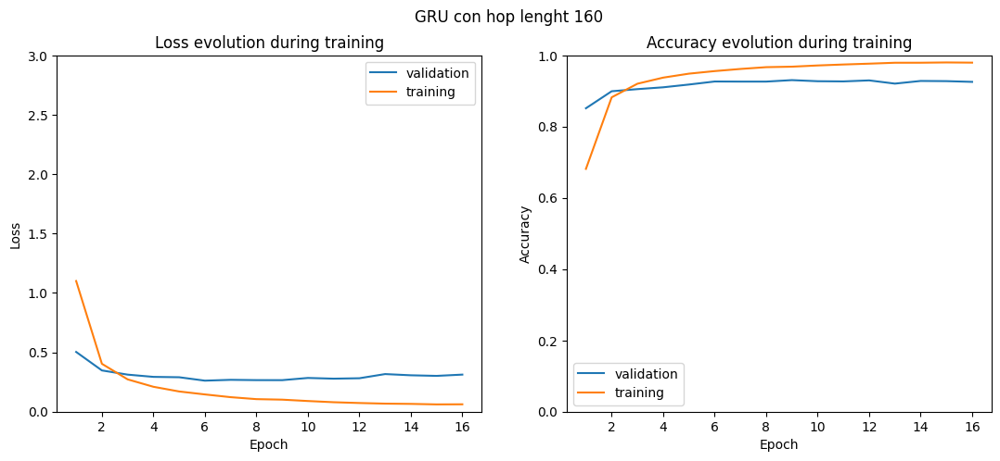

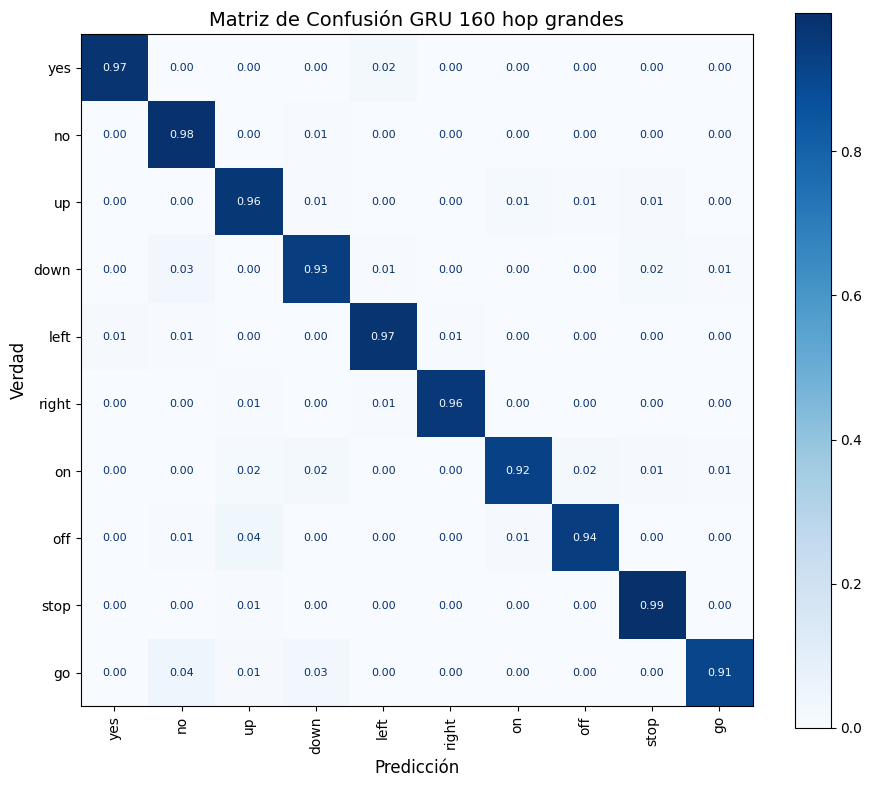

              precision    recall  f1-score   support

         yes       0.99      0.97      0.98       395
          no       0.92      0.98      0.95       395
          up       0.92      0.96      0.94       395
        down       0.94      0.94      0.94       392
        left       0.96      0.98      0.97       394
       right       0.99      0.98      0.98       388
          on       0.97      0.93      0.95       393
         off       0.97      0.94      0.95       396
        stop       0.96      0.99      0.98       396
          go       0.98      0.92      0.95       393

    accuracy                           0.96      3937
   macro avg       0.96      0.96      0.96      3937
weighted avg       0.96      0.96      0.96      3937

Precisión global (Accuracy): 0.9601
📁 Métricas guardadas en: metricas_GRU_160_hop_grandes.json

========== Iteración 4/3 ==========
Epoch 1/40
Iteration 84 - Batch 84/508 - Train loss: 2.3564, Train acc: 27.28%
Iteration 168 - Batch 168/508 

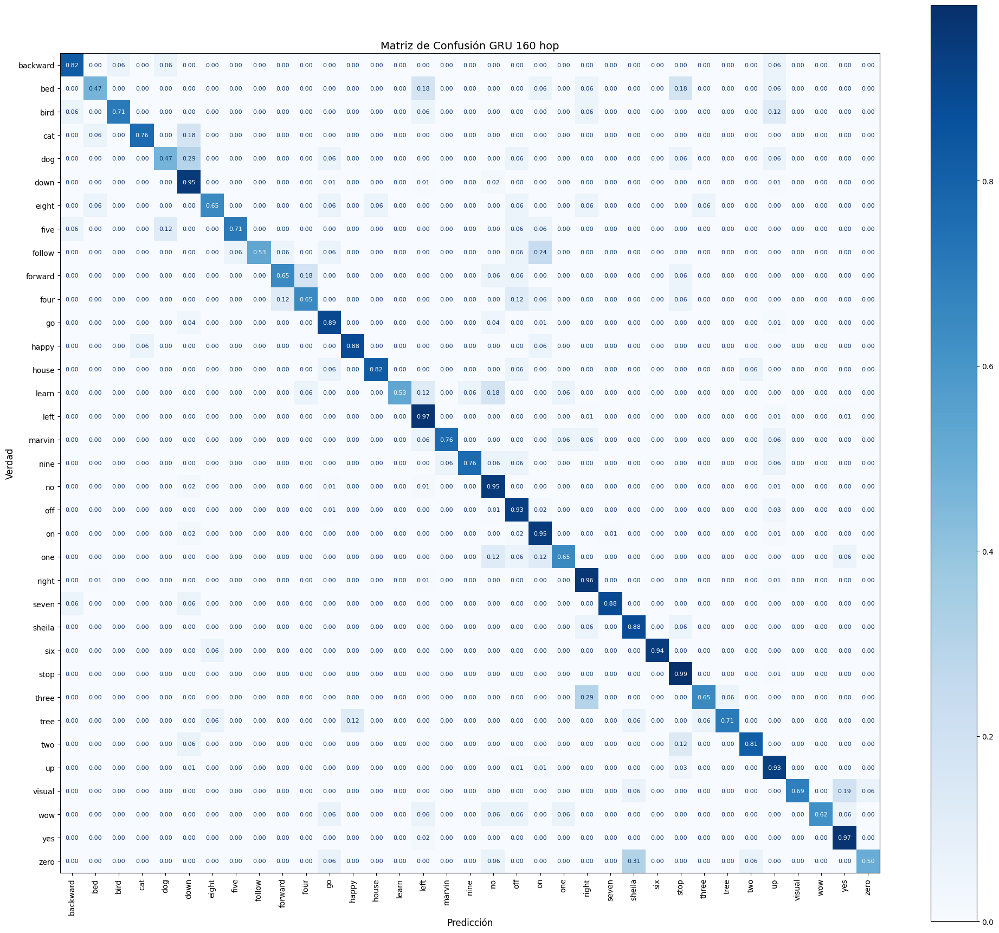

              precision    recall  f1-score   support

    backward       0.82      0.82      0.82        17
         bed       0.57      0.47      0.52        17
        bird       0.86      0.71      0.77        17
         cat       0.87      0.76      0.81        17
         dog       0.67      0.47      0.55        17
        down       0.89      0.95      0.92       396
       eight       0.85      0.65      0.73        17
        five       0.86      0.71      0.77        17
      follow       1.00      0.53      0.69        17
     forward       0.79      0.65      0.71        17
        four       0.73      0.65      0.69        17
          go       0.96      0.89      0.93       396
       happy       0.88      0.88      0.88        17
       house       0.93      0.82      0.88        17
       learn       1.00      0.53      0.69        17
        left       0.94      0.97      0.95       396
      marvin       0.87      0.76      0.81        17
        nine       0.81    

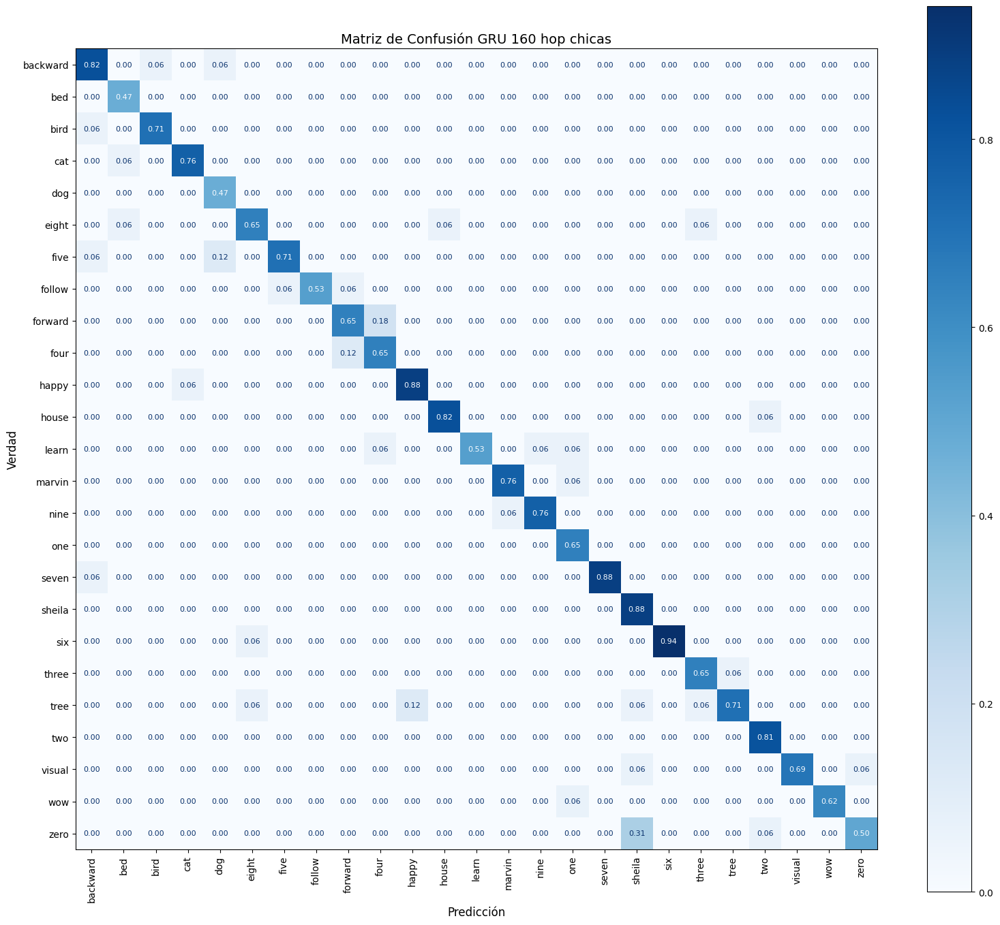

              precision    recall  f1-score   support

    backward       0.82      0.88      0.85        16
         bed       0.80      1.00      0.89         8
        bird       0.92      0.92      0.92        13
         cat       0.93      0.93      0.93        14
         dog       0.73      1.00      0.84         8
       eight       0.85      0.79      0.81        14
        five       0.92      0.80      0.86        15
      follow       1.00      0.82      0.90        11
     forward       0.79      0.79      0.79        14
        four       0.73      0.85      0.79        13
       happy       0.88      0.94      0.91        16
       house       0.93      0.93      0.93        15
       learn       1.00      0.75      0.86        12
      marvin       0.93      0.93      0.93        14
        nine       0.93      0.93      0.93        14
         one       0.79      1.00      0.88        11
       seven       1.00      0.94      0.97        16
      sheila       0.68    

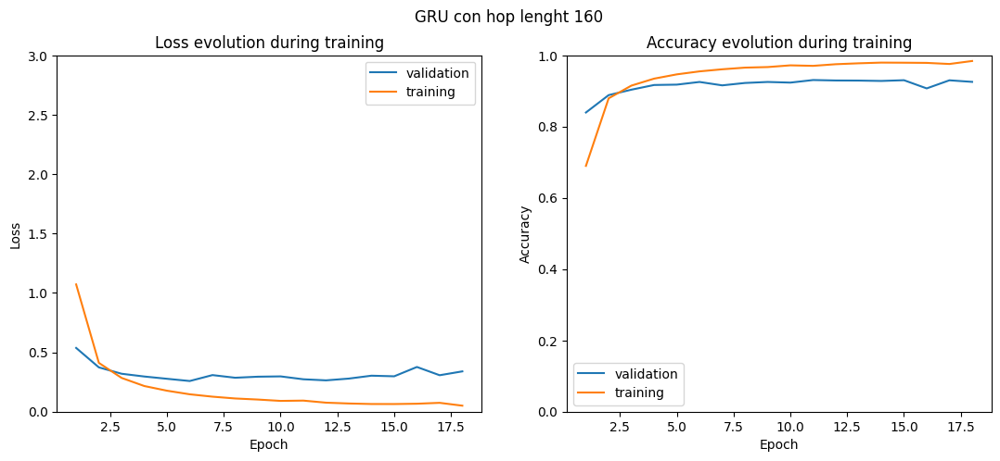

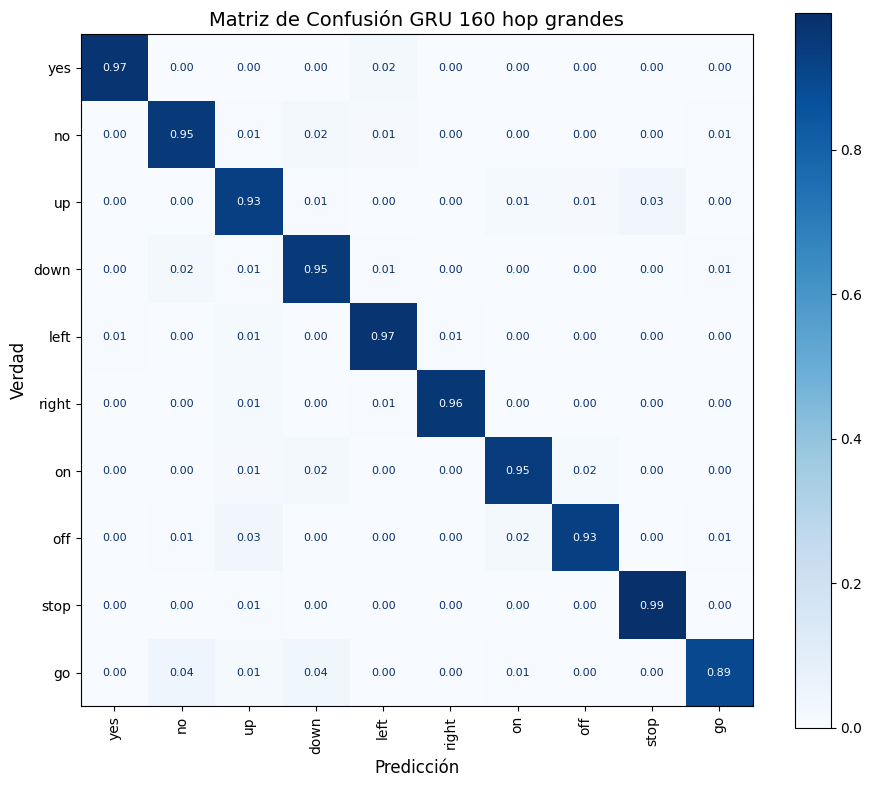

              precision    recall  f1-score   support

         yes       0.99      0.97      0.98       396
          no       0.93      0.95      0.94       395
          up       0.90      0.93      0.92       395
        down       0.91      0.95      0.93       395
        left       0.96      0.97      0.96       395
       right       0.98      0.98      0.98       390
          on       0.96      0.95      0.96       394
         off       0.97      0.93      0.95       395
        stop       0.96      0.99      0.98       396
          go       0.98      0.90      0.94       394

    accuracy                           0.95      3945
   macro avg       0.95      0.95      0.95      3945
weighted avg       0.95      0.95      0.95      3945

Precisión global (Accuracy): 0.9534
📁 Métricas guardadas en: metricas_GRU_160_hop_grandes.json

========== Iteración 5/3 ==========
Epoch 1/40
Iteration 84 - Batch 84/508 - Train loss: 2.2785, Train acc: 29.82%
Iteration 168 - Batch 168/508 

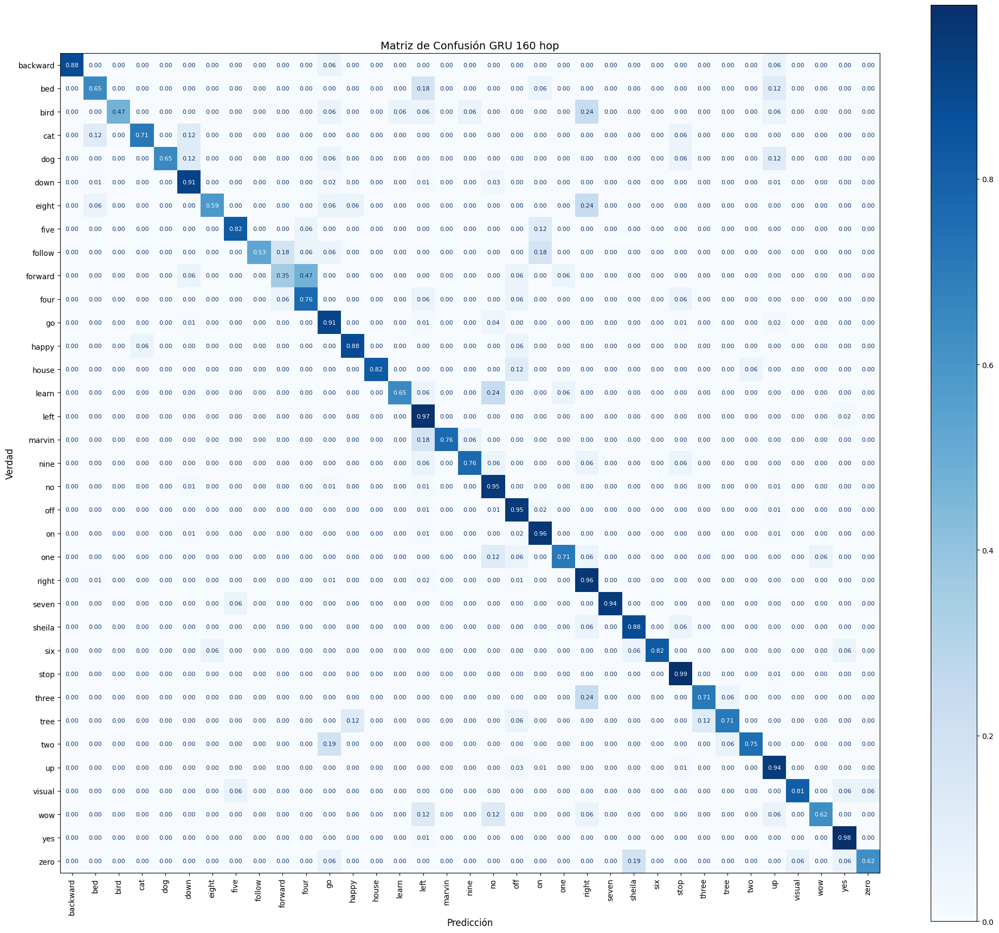

              precision    recall  f1-score   support

    backward       0.94      0.88      0.91        17
         bed       0.58      0.65      0.61        17
        bird       0.89      0.47      0.62        17
         cat       0.86      0.71      0.77        17
         dog       0.92      0.65      0.76        17
        down       0.96      0.91      0.93       396
       eight       0.91      0.59      0.71        17
        five       0.82      0.82      0.82        17
      follow       0.82      0.53      0.64        17
     forward       0.60      0.35      0.44        17
        four       0.57      0.76      0.65        17
          go       0.93      0.91      0.92       396
       happy       0.83      0.88      0.86        17
       house       1.00      0.82      0.90        17
       learn       0.85      0.65      0.73        17
        left       0.90      0.97      0.94       396
      marvin       1.00      0.76      0.87        17
        nine       0.81    

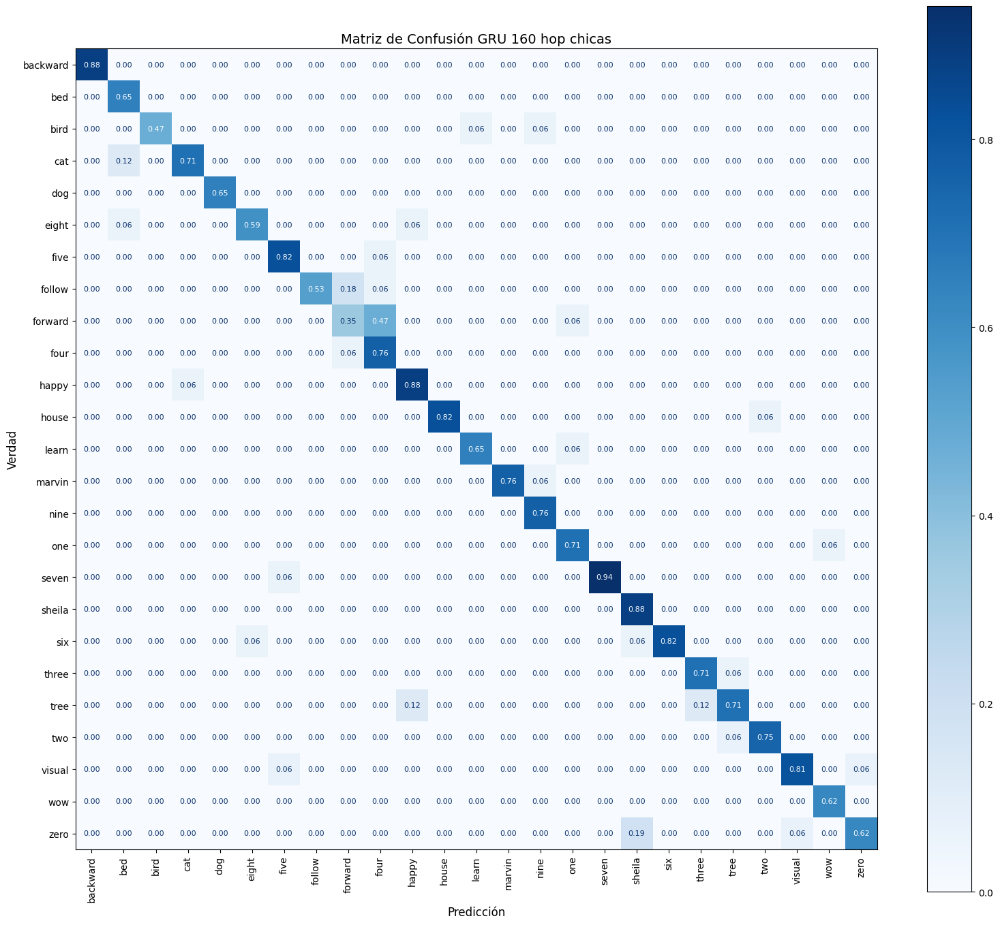

              precision    recall  f1-score   support

    backward       1.00      1.00      1.00        15
         bed       0.79      1.00      0.88        11
        bird       1.00      0.80      0.89        10
         cat       0.92      0.86      0.89        14
         dog       1.00      1.00      1.00        11
       eight       0.91      0.83      0.87        12
        five       0.88      0.93      0.90        15
      follow       1.00      0.69      0.82        13
     forward       0.60      0.40      0.48        15
        four       0.57      0.93      0.70        14
       happy       0.83      0.94      0.88        16
       house       1.00      0.93      0.97        15
       learn       0.92      0.92      0.92        12
      marvin       1.00      0.93      0.96        14
        nine       0.87      1.00      0.93        13
         one       0.86      0.92      0.89        13
       seven       1.00      0.94      0.97        17
      sheila       0.79    

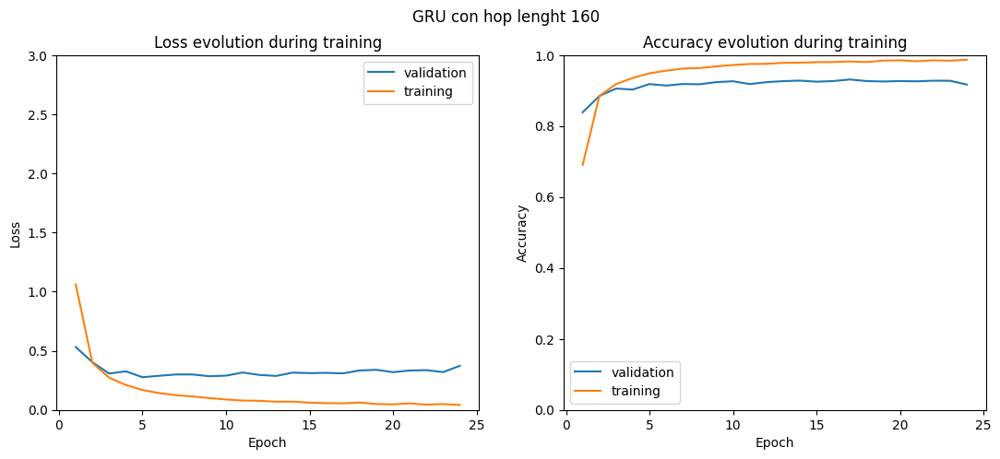

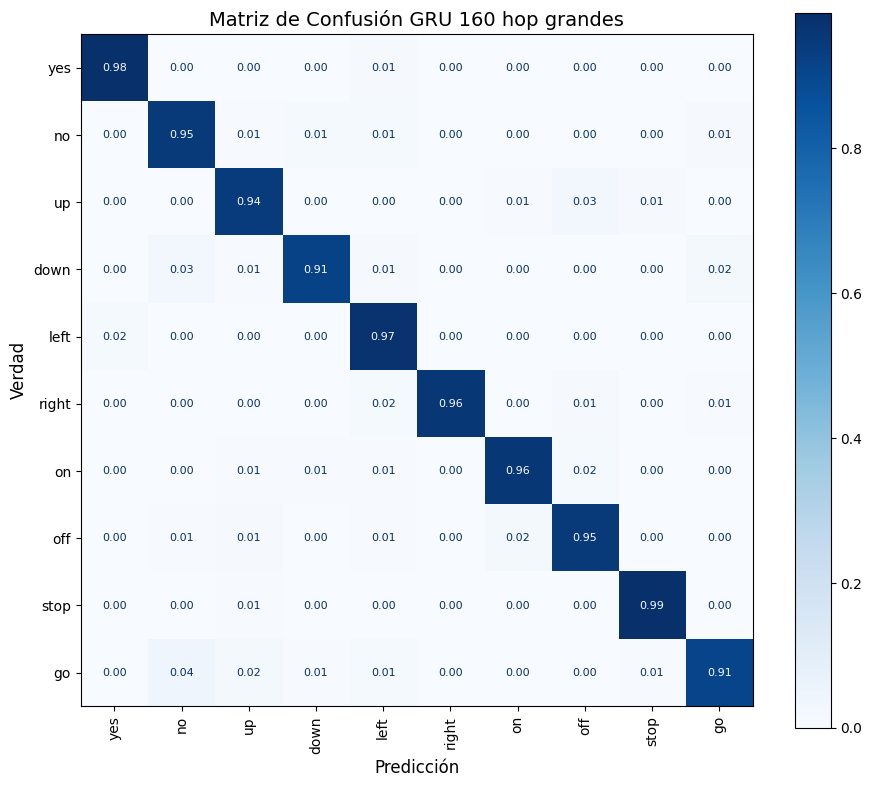

              precision    recall  f1-score   support

         yes       0.98      0.98      0.98       394
          no       0.92      0.96      0.94       394
          up       0.94      0.95      0.95       394
        down       0.97      0.93      0.95       390
        left       0.93      0.98      0.95       395
       right       0.99      0.96      0.98       393
          on       0.97      0.96      0.97       394
         off       0.94      0.95      0.95       396
        stop       0.98      0.99      0.98       396
          go       0.95      0.91      0.93       395

    accuracy                           0.96      3941
   macro avg       0.96      0.96      0.96      3941
weighted avg       0.96      0.96      0.96      3941

Precisión global (Accuracy): 0.9574
📁 Métricas guardadas en: metricas_GRU_160_hop_grandes.json

===== Resultados finales =====
Precisión promedio (5 runs): 92.96% ± 0.35%
Modelo final guardado


In [ ]:
device = "cuda" if torch.cuda.is_available() else "cpu"

# Datos y clases
train_dl, val_dl, test_dl = load2(MFCC_train_10, MFCC_val_10, MFCC_test_10, batch_size=64)

# Función para obtener predicciones
@torch.no_grad()
def get_predictions(loader, model, device="cpu"):
    model = model.to(device)
    model.eval()
    all_predictions, all_true_labels = [], []
    for xb, yb in loader:
        xb, yb = xb.to(device), yb.to(device)
        pred = model(xb).argmax(1)
        all_predictions.extend(pred.cpu().numpy())
        all_true_labels.extend(yb.cpu().numpy())
    return np.array(all_true_labels), np.array(all_predictions)

# Loop de 5 iteraciones
accuracies = []

for i in range(5):
    print(f"\n========== Iteración {i+1}/3 ==========")
    model = GRUModel(
        input_size=39,
        hidden_size=128,
        num_layers=3,
        bidirectional=False,
        num_classes=len(label_map)
    ).to(device)

    criterion = nn.CrossEntropyLoss()

    curves = train_model(
        model, train_dl, val_dl,
        epochs=40, lr=1e-3,
        criterion=criterion,
        device=device,
        early_stopping_patience=7
    )

    true_labels, predictions = get_predictions(test_dl, model, device)
    acc = (predictions == true_labels).mean() * 100
    accuracies.append(acc)
    print(f"✅ Precisión iteración {i+1}: {acc:.2f}%")
    # Matriz de confusión del último modelo entrenado
    show_confusion_matrix(
        true_labels, predictions,
        clases_10,
        title=f"Matriz de Confusión GRU 160 hop",
        filename="matriz_confusion_GRU_160_hop.png",
        metrics_filename="metricas_GRU_160_hop.json"
    )

    # Matriz de confusión del último modelo entrenado
    show_confusion_matrix(
        true_labels, predictions,
        clases_10,
        title=f"Matriz de Confusión GRU 160 hop chicas",
        filename="matriz_confusion_GRU_160_hop_chicas.png",
        selected_classes = clases_chicas,
        metrics_filename="metricas_GRU_160_hop_chicas.json"
    )
    show_curves(curves, title="GRU con hop lenght 160" , filename="Curva_GRU_160_hop.png")

    # Matriz de confusión del último modelo entrenado
    show_confusion_matrix(
        true_labels, predictions,
        clases_10,
        title=f"Matriz de Confusión GRU 160 hop grandes",
        filename="matriz_confusion_GRU_160_hop_grandes.png",
        selected_classes = clases_grandes,
        metrics_filename="metricas_GRU_160_hop_grandes.json"
    )

# Promedio y desviación estándar
mean_acc = np.mean(accuracies)
std_acc = np.std(accuracies)

print("\n===== Resultados finales =====")
print(f"Precisión promedio (5 runs): {mean_acc:.2f}% ± {std_acc:.2f}%")


torch.save(model.state_dict(), "modelo_GRU_160.pth")
print("Modelo final guardado")



In [ ]:
model_summary(model)
time_per_sample, total_time = measure_inference_time(model, test_dl, device)

print(f"⏱️ Tiempo promedio por muestra: {time_per_sample*1000:.3f} ms")
print(f"⏱️ Tiempo total sobre el test: {total_time:.2f} s")

📌 Parámetros entrenables: 267,555
📦 Tamaño aproximado en memoria: 1.02 MB
💾 Tamaño real del archivo .pth: 1.02 MB
⏱️ Tiempo promedio por muestra: 0.054 ms
⏱️ Tiempo total sobre el test: 0.24 s


##### LSTM

{'backward': 0, 'bed': 1, 'bird': 2, 'cat': 3, 'dog': 4, 'down': 5, 'eight': 6, 'five': 7, 'follow': 8, 'forward': 9, 'four': 10, 'go': 11, 'happy': 12, 'house': 13, 'learn': 14, 'left': 15, 'marvin': 16, 'nine': 17, 'no': 18, 'off': 19, 'on': 20, 'one': 21, 'right': 22, 'seven': 23, 'sheila': 24, 'six': 25, 'stop': 26, 'three': 27, 'tree': 28, 'two': 29, 'up': 30, 'visual': 31, 'wow': 32, 'yes': 33, 'zero': 34}
{'backward': 0, 'bed': 1, 'bird': 2, 'cat': 3, 'dog': 4, 'down': 5, 'eight': 6, 'five': 7, 'follow': 8, 'forward': 9, 'four': 10, 'go': 11, 'happy': 12, 'house': 13, 'learn': 14, 'left': 15, 'marvin': 16, 'nine': 17, 'no': 18, 'off': 19, 'on': 20, 'one': 21, 'right': 22, 'seven': 23, 'sheila': 24, 'six': 25, 'stop': 26, 'three': 27, 'tree': 28, 'two': 29, 'up': 30, 'visual': 31, 'wow': 32, 'yes': 33, 'zero': 34}
{'backward': 0, 'bed': 1, 'bird': 2, 'cat': 3, 'dog': 4, 'down': 5, 'eight': 6, 'five': 7, 'follow': 8, 'forward': 9, 'four': 10, 'go': 11, 'happy': 12, 'house': 13, 'l

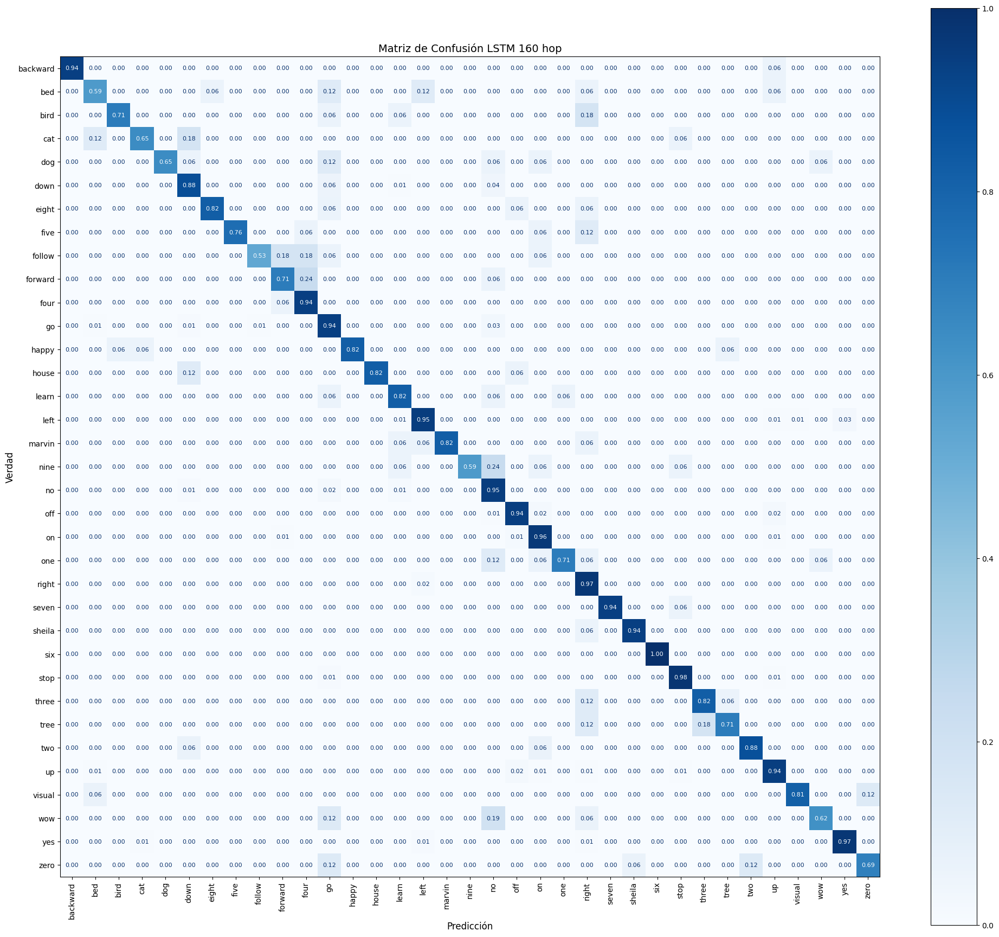

              precision    recall  f1-score   support

    backward       0.89      0.94      0.91        17
         bed       0.59      0.59      0.59        17
        bird       0.86      0.71      0.77        17
         cat       0.73      0.65      0.69        17
         dog       0.73      0.65      0.69        17
        down       0.95      0.88      0.92       396
       eight       0.93      0.82      0.88        17
        five       0.93      0.76      0.84        17
      follow       0.82      0.53      0.64        17
     forward       0.63      0.71      0.67        17
        four       0.67      0.94      0.78        17
          go       0.88      0.94      0.91       396
       happy       0.88      0.82      0.85        17
       house       1.00      0.82      0.90        17
       learn       0.52      0.82      0.64        17
        left       0.96      0.95      0.95       396
      marvin       0.93      0.82      0.88        17
        nine       1.00    

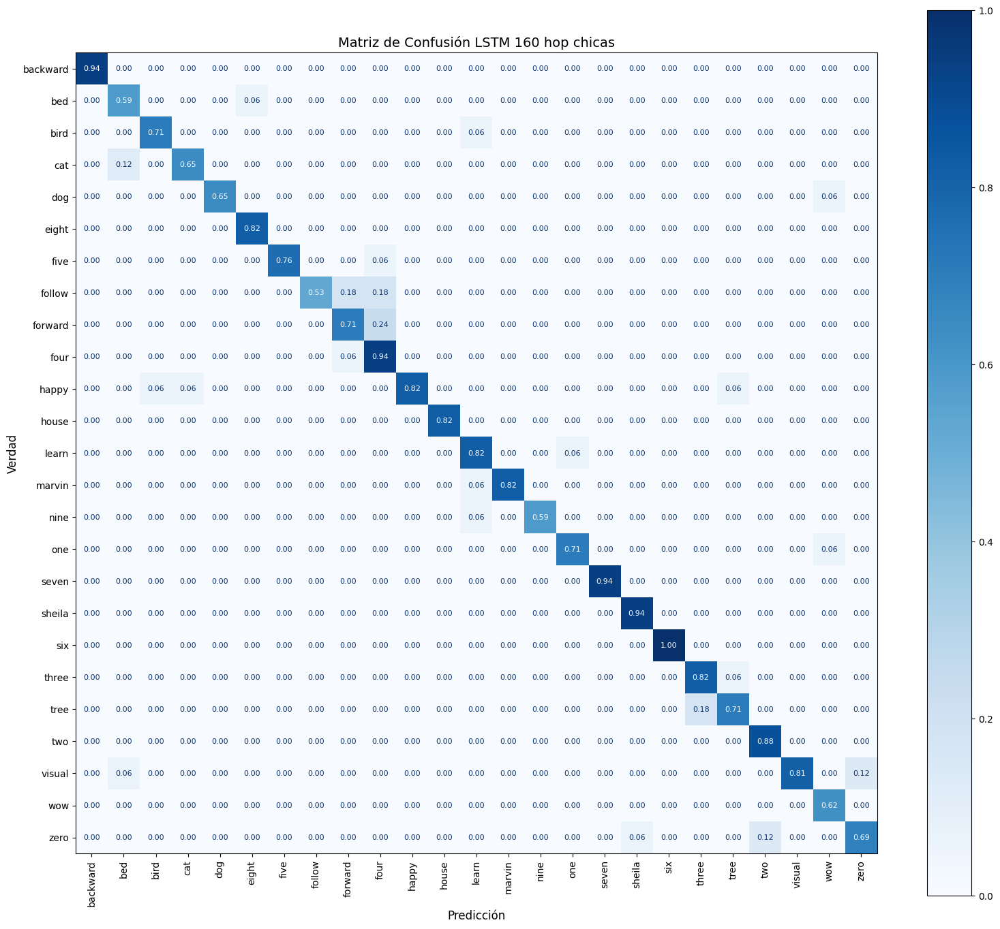

              precision    recall  f1-score   support

    backward       1.00      1.00      1.00        16
         bed       0.77      0.91      0.83        11
        bird       0.92      0.92      0.92        13
         cat       0.92      0.85      0.88        13
         dog       1.00      0.92      0.96        12
       eight       0.93      1.00      0.97        14
        five       1.00      0.93      0.96        14
      follow       1.00      0.60      0.75        15
     forward       0.75      0.75      0.75        16
        four       0.67      0.94      0.78        17
       happy       1.00      0.82      0.90        17
       house       1.00      1.00      1.00        14
       learn       0.82      0.93      0.88        15
      marvin       1.00      0.93      0.97        15
        nine       1.00      0.91      0.95        11
         one       0.92      0.92      0.92        13
       seven       1.00      1.00      1.00        16
      sheila       0.94    

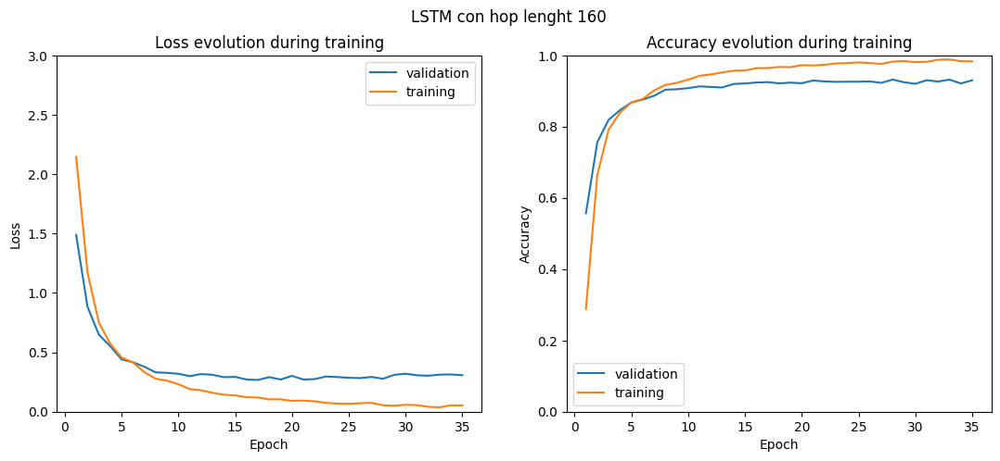

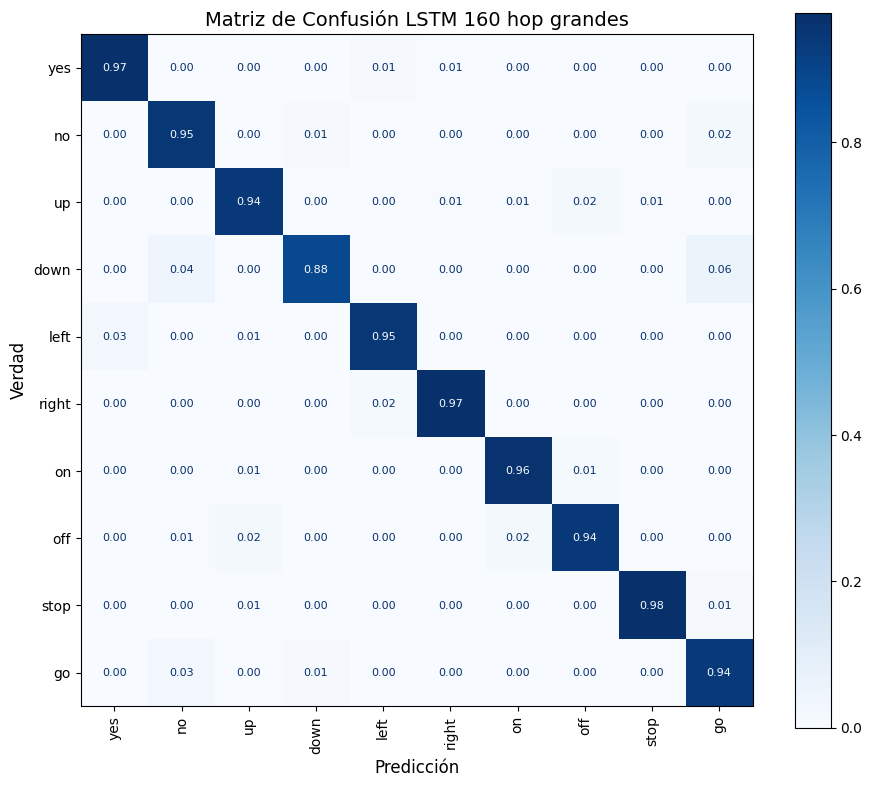

              precision    recall  f1-score   support

         yes       0.97      0.98      0.97       393
          no       0.92      0.96      0.94       390
          up       0.96      0.96      0.96       391
        down       0.97      0.90      0.93       391
        left       0.96      0.96      0.96       389
       right       0.98      0.97      0.98       394
          on       0.97      0.98      0.97       390
         off       0.96      0.94      0.95       396
        stop       0.99      0.98      0.99       395
          go       0.91      0.95      0.93       390

    accuracy                           0.96      3919
   macro avg       0.96      0.96      0.96      3919
weighted avg       0.96      0.96      0.96      3919

Precisión global (Accuracy): 0.9587
📁 Métricas guardadas en: metricas_LSTM_160_hop_grandes.json

========== Iteración 2/3 ==========
Epoch 1/40
Iteration 84 - Batch 84/508 - Train loss: 2.5792, Train acc: 16.32%
Iteration 168 - Batch 168/508

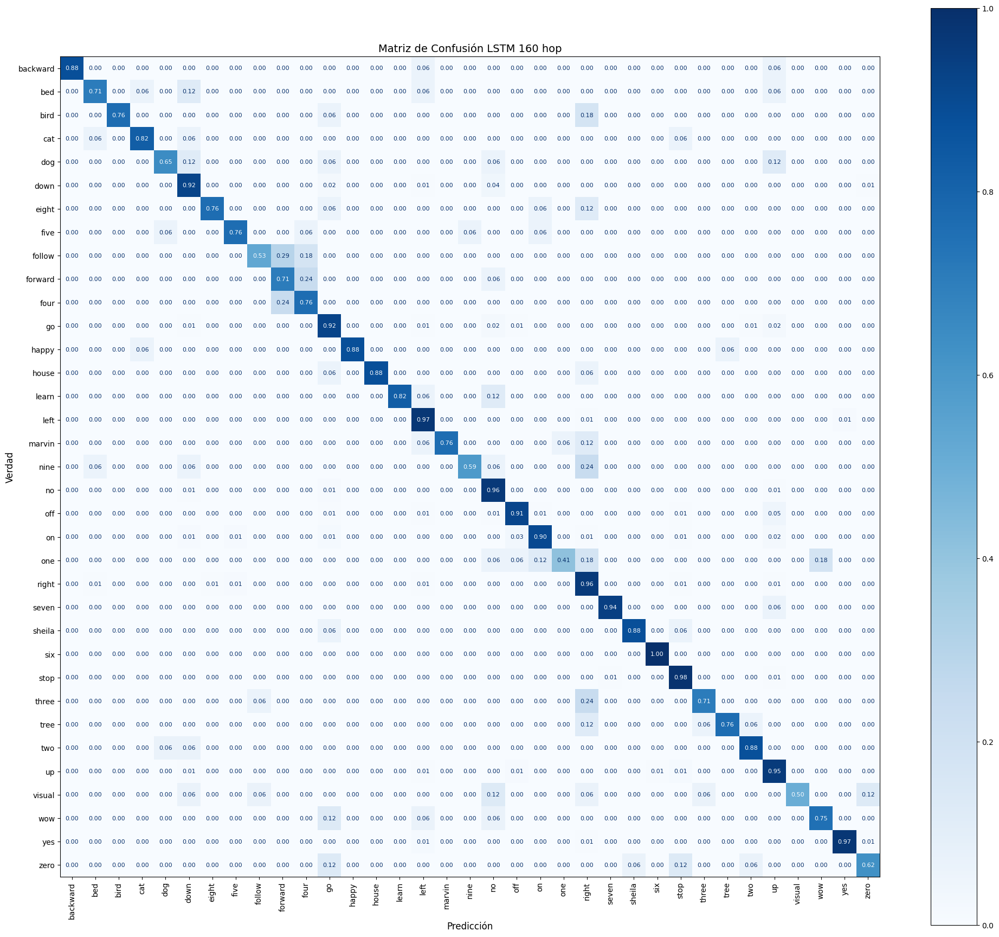

              precision    recall  f1-score   support

    backward       0.94      0.88      0.91        17
         bed       0.60      0.71      0.65        17
        bird       0.93      0.76      0.84        17
         cat       0.82      0.82      0.82        17
         dog       0.79      0.65      0.71        17
        down       0.94      0.92      0.93       396
       eight       0.87      0.76      0.81        17
        five       0.62      0.76      0.68        17
      follow       0.69      0.53      0.60        17
     forward       0.55      0.71      0.62        17
        four       0.62      0.76      0.68        17
          go       0.92      0.92      0.92       396
       happy       0.94      0.88      0.91        17
       house       1.00      0.88      0.94        17
       learn       1.00      0.82      0.90        17
        left       0.94      0.97      0.96       396
      marvin       1.00      0.76      0.87        17
        nine       0.83    

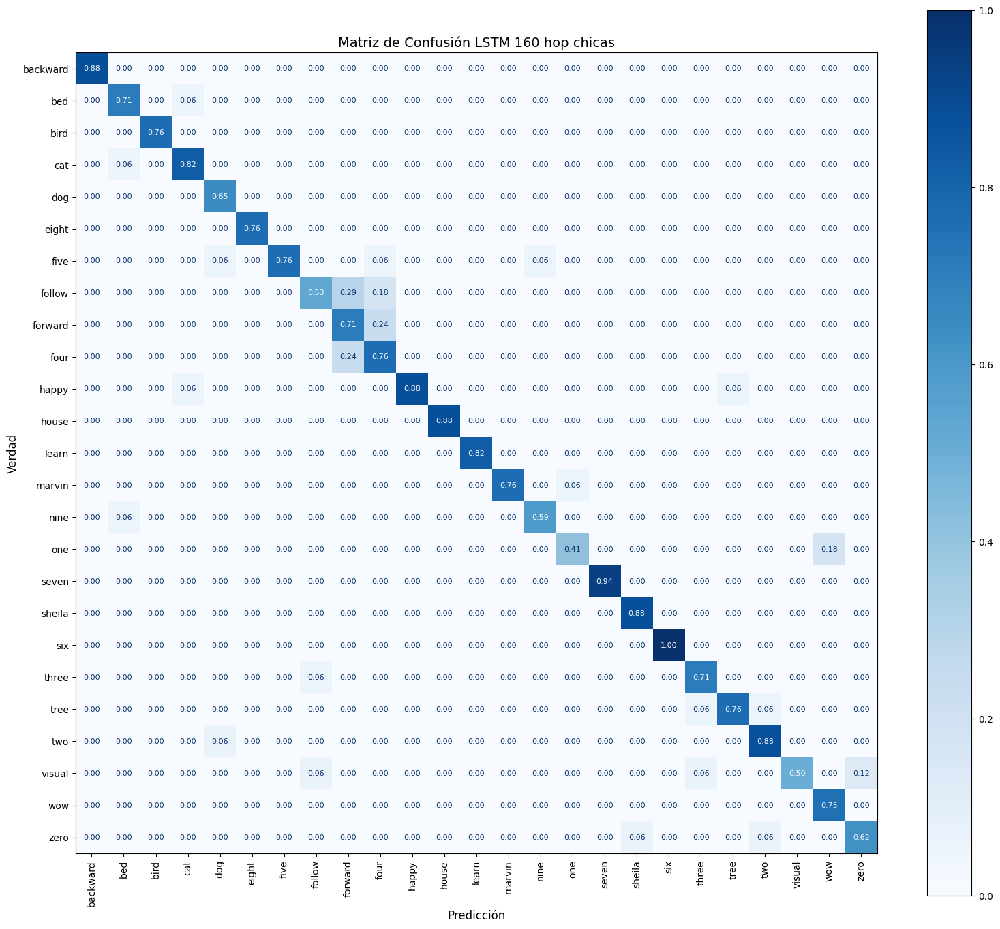

              precision    recall  f1-score   support

    backward       1.00      1.00      1.00        15
         bed       0.86      0.92      0.89        13
        bird       1.00      1.00      1.00        13
         cat       0.88      0.93      0.90        15
         dog       0.85      1.00      0.92        11
       eight       1.00      1.00      1.00        13
        five       1.00      0.81      0.90        16
      follow       0.82      0.53      0.64        17
     forward       0.57      0.75      0.65        16
        four       0.62      0.76      0.68        17
       happy       1.00      0.88      0.94        17
       house       1.00      1.00      1.00        15
       learn       1.00      1.00      1.00        14
      marvin       1.00      0.93      0.96        14
        nine       0.91      0.91      0.91        11
         one       0.88      0.70      0.78        10
       seven       1.00      1.00      1.00        16
      sheila       0.94    

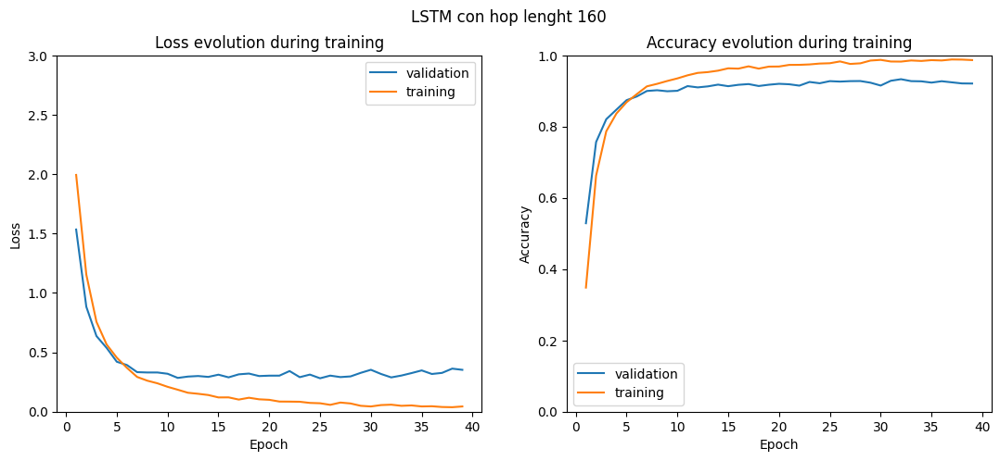

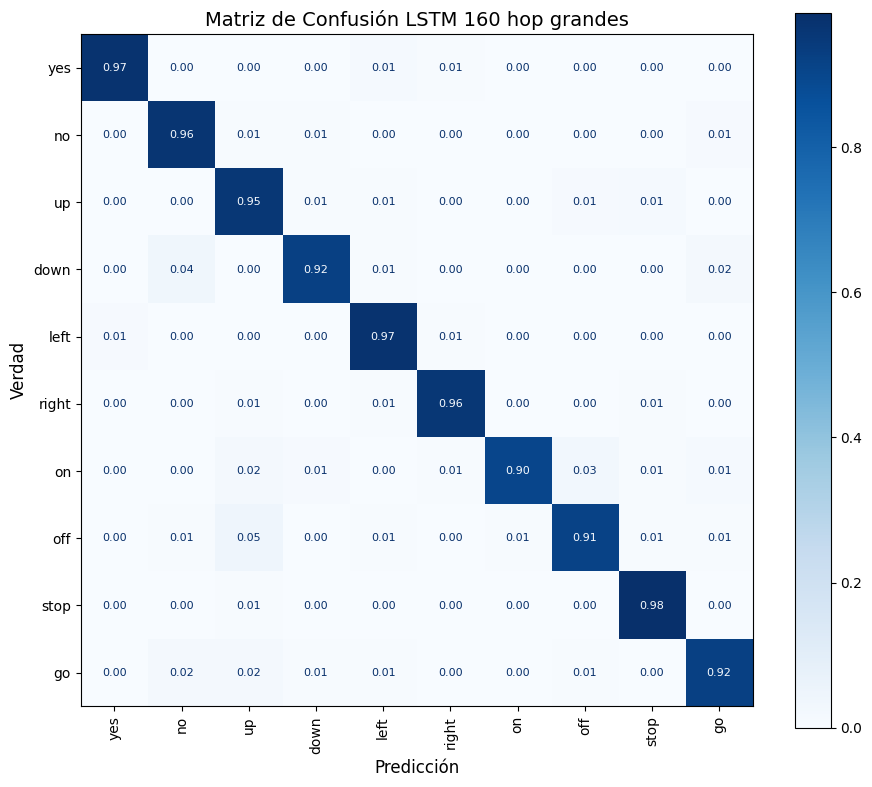

              precision    recall  f1-score   support

         yes       0.98      0.98      0.98       393
          no       0.93      0.97      0.95       391
          up       0.90      0.96      0.93       394
        down       0.96      0.93      0.95       392
        left       0.95      0.98      0.96       394
       right       0.97      0.98      0.98       388
          on       0.99      0.92      0.95       390
         off       0.96      0.92      0.94       395
        stop       0.97      0.99      0.98       394
          go       0.94      0.93      0.94       392

    accuracy                           0.95      3923
   macro avg       0.96      0.95      0.95      3923
weighted avg       0.96      0.95      0.95      3923

Precisión global (Accuracy): 0.9549
📁 Métricas guardadas en: metricas_LSTM_160_hop_grandes.json

========== Iteración 3/3 ==========
Epoch 1/40
Iteration 84 - Batch 84/508 - Train loss: 2.6365, Train acc: 15.42%
Iteration 168 - Batch 168/508

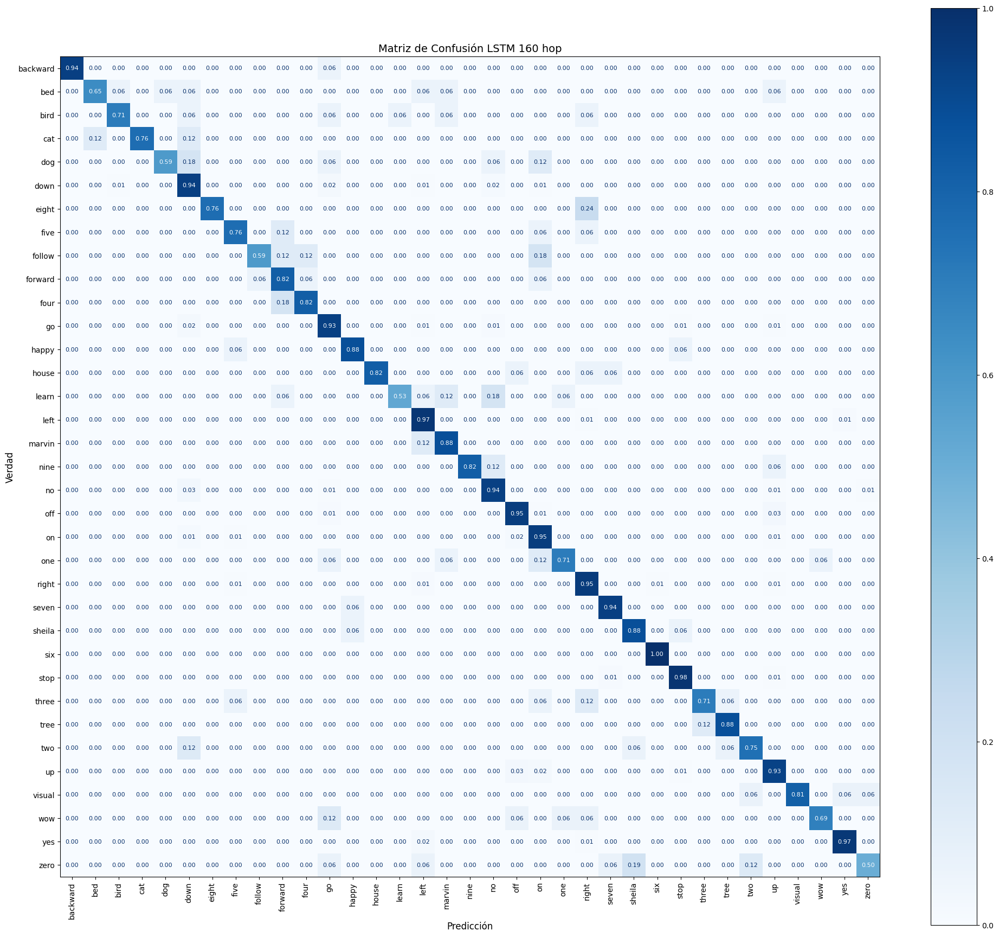

              precision    recall  f1-score   support

    backward       1.00      0.94      0.97        17
         bed       0.69      0.65      0.67        17
        bird       0.75      0.71      0.73        17
         cat       0.72      0.76      0.74        17
         dog       0.91      0.59      0.71        17
        down       0.91      0.94      0.93       396
       eight       0.93      0.76      0.84        17
        five       0.68      0.76      0.72        17
      follow       0.67      0.59      0.62        17
     forward       0.61      0.82      0.70        17
        four       0.82      0.82      0.82        17
          go       0.94      0.93      0.94       396
       happy       0.79      0.88      0.83        17
       house       0.93      0.82      0.88        17
       learn       0.82      0.53      0.64        17
        left       0.94      0.97      0.96       396
      marvin       0.62      0.88      0.73        17
        nine       1.00    

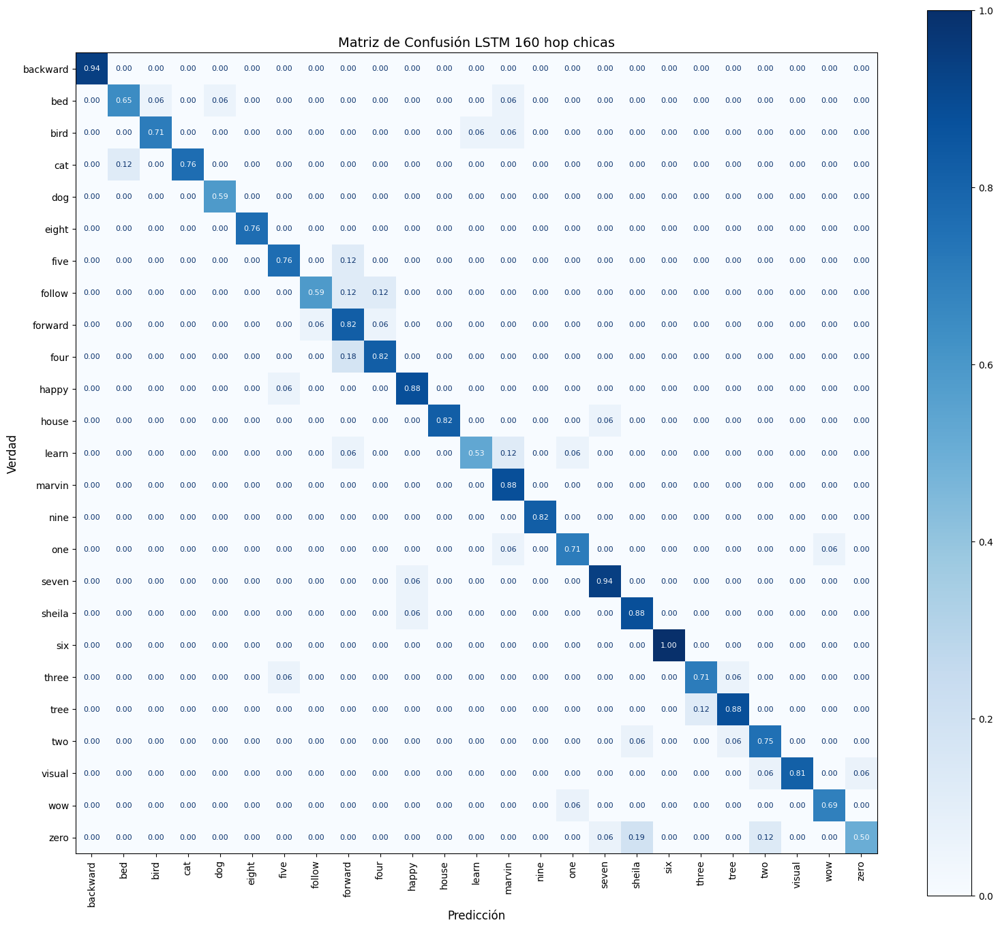

              precision    recall  f1-score   support

    backward       1.00      1.00      1.00        16
         bed       0.85      0.79      0.81        14
        bird       0.92      0.86      0.89        14
         cat       1.00      0.87      0.93        15
         dog       0.91      1.00      0.95        10
       eight       1.00      1.00      1.00        13
        five       0.87      0.87      0.87        15
      follow       0.91      0.71      0.80        14
     forward       0.64      0.88      0.74        16
        four       0.82      0.82      0.82        17
       happy       0.88      0.94      0.91        16
       house       1.00      0.93      0.97        15
       learn       0.90      0.69      0.78        13
      marvin       0.75      1.00      0.86        15
        nine       1.00      1.00      1.00        14
         one       0.86      0.86      0.86        14
       seven       0.89      0.94      0.91        17
      sheila       0.79    

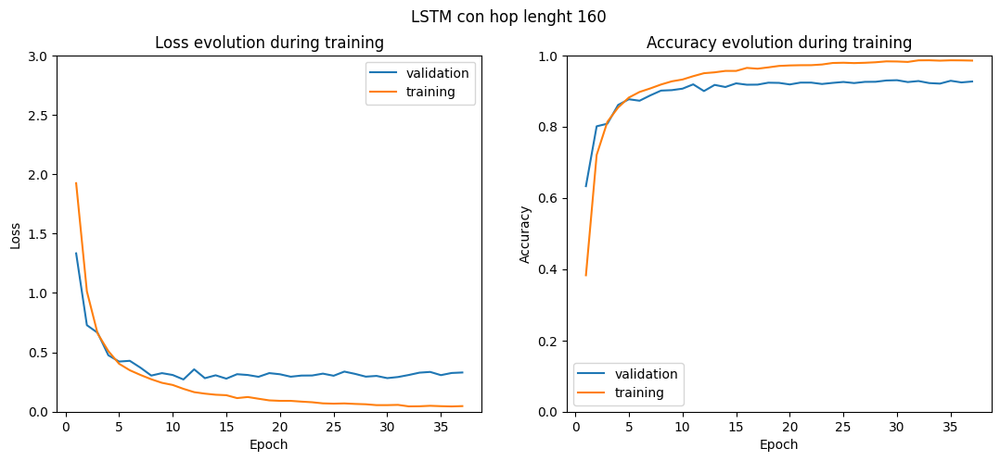

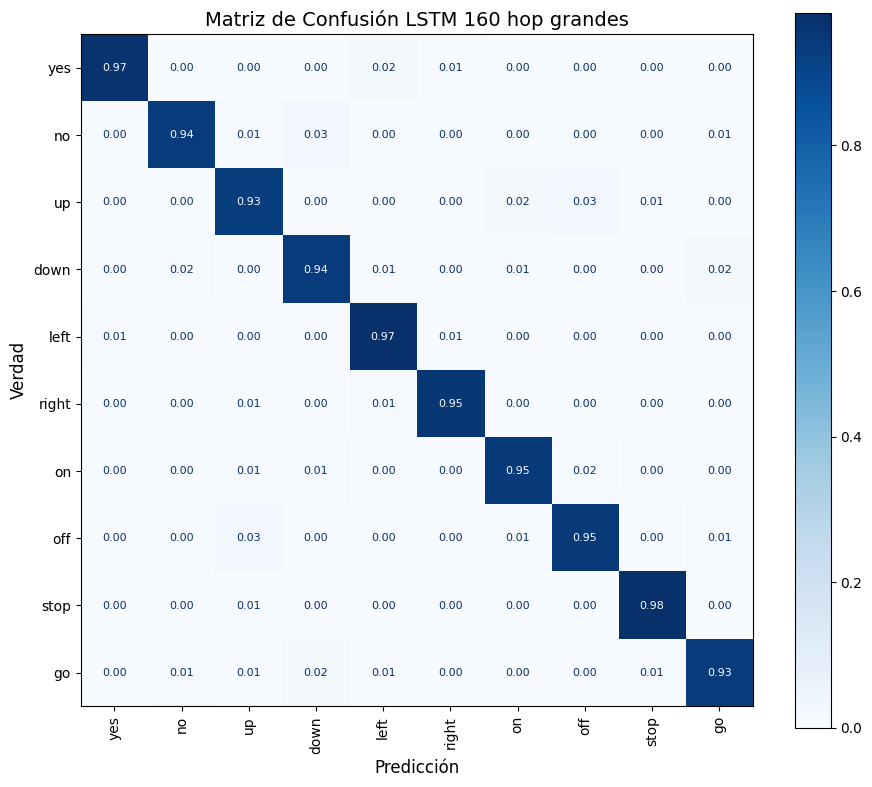

              precision    recall  f1-score   support

         yes       0.98      0.97      0.98       395
          no       0.97      0.95      0.96       390
          up       0.94      0.94      0.94       392
        down       0.93      0.95      0.94       392
        left       0.95      0.98      0.97       393
       right       0.98      0.98      0.98       386
          on       0.96      0.96      0.96       391
         off       0.96      0.95      0.95       395
        stop       0.98      0.99      0.99       392
          go       0.95      0.94      0.95       392

    accuracy                           0.96      3918
   macro avg       0.96      0.96      0.96      3918
weighted avg       0.96      0.96      0.96      3918

Precisión global (Accuracy): 0.9615
📁 Métricas guardadas en: metricas_LSTM_160_hop_grandes.json

========== Iteración 4/3 ==========
Epoch 1/40
Iteration 84 - Batch 84/508 - Train loss: 2.6813, Train acc: 13.99%
Iteration 168 - Batch 168/508

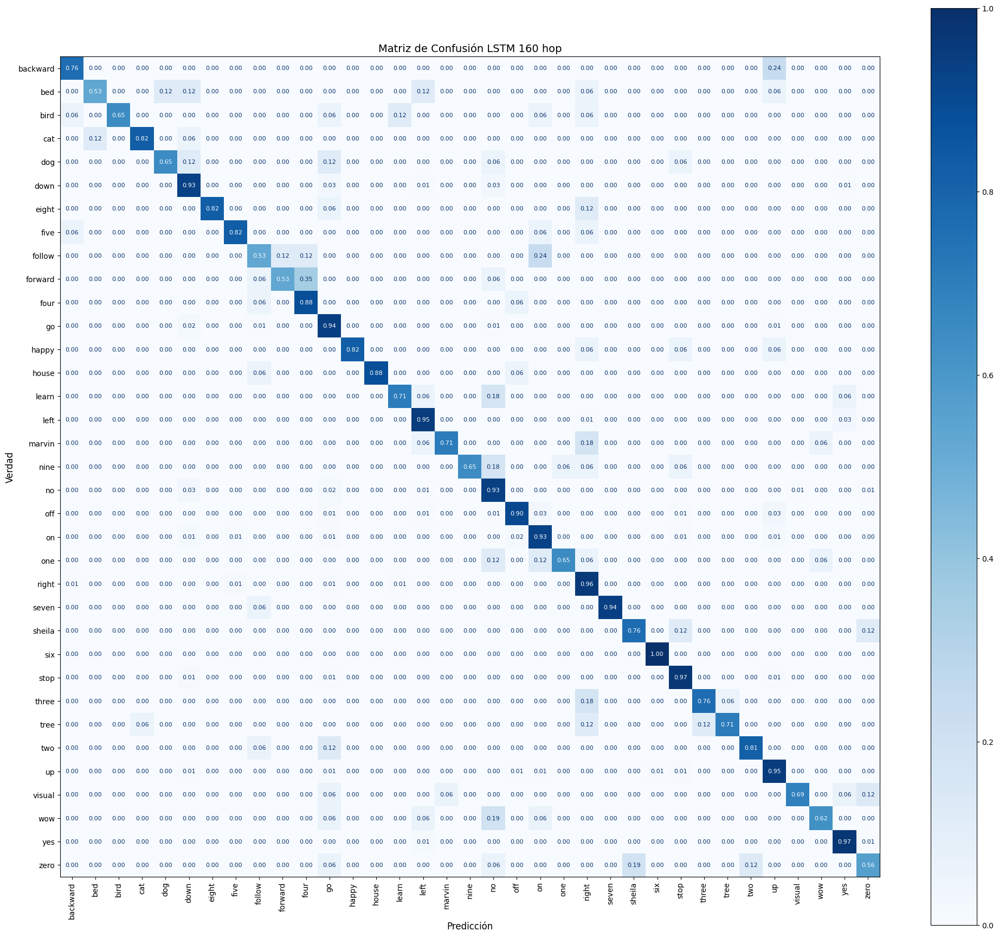

              precision    recall  f1-score   support

    backward       0.68      0.76      0.72        17
         bed       0.64      0.53      0.58        17
        bird       1.00      0.65      0.79        17
         cat       0.74      0.82      0.78        17
         dog       0.79      0.65      0.71        17
        down       0.92      0.93      0.92       396
       eight       0.93      0.82      0.88        17
        five       0.70      0.82      0.76        17
      follow       0.47      0.53      0.50        17
     forward       0.75      0.53      0.62        17
        four       0.65      0.88      0.75        17
          go       0.89      0.94      0.91       396
       happy       0.93      0.82      0.88        17
       house       1.00      0.88      0.94        17
       learn       0.71      0.71      0.71        17
        left       0.95      0.95      0.95       396
      marvin       0.86      0.71      0.77        17
        nine       1.00    

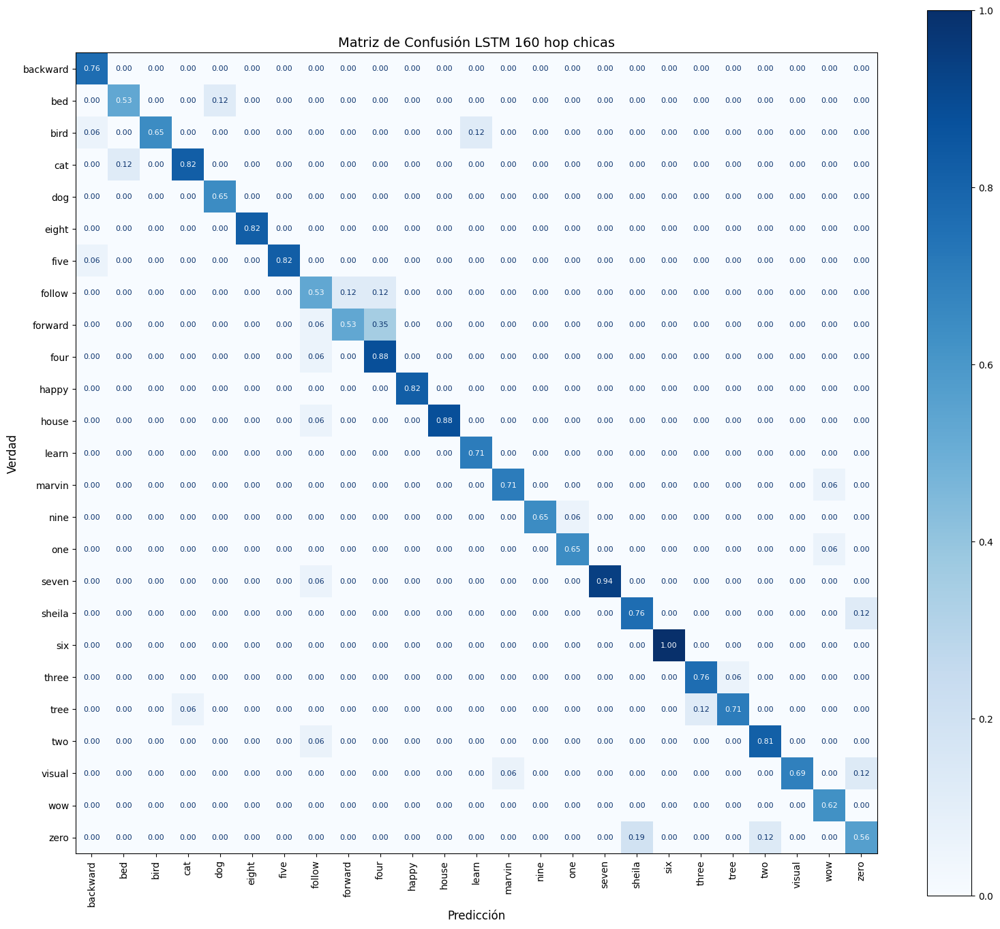

              precision    recall  f1-score   support

    backward       0.87      1.00      0.93        13
         bed       0.82      0.82      0.82        11
        bird       1.00      0.79      0.88        14
         cat       0.93      0.88      0.90        16
         dog       0.85      1.00      0.92        11
       eight       1.00      1.00      1.00        14
        five       1.00      0.93      0.97        15
      follow       0.64      0.69      0.67        13
     forward       0.82      0.56      0.67        16
        four       0.65      0.94      0.77        16
       happy       1.00      1.00      1.00        14
       house       1.00      0.94      0.97        16
       learn       0.86      1.00      0.92        12
      marvin       0.92      0.92      0.92        13
        nine       1.00      0.92      0.96        12
         one       0.92      0.92      0.92        12
       seven       1.00      0.94      0.97        17
      sheila       0.81    

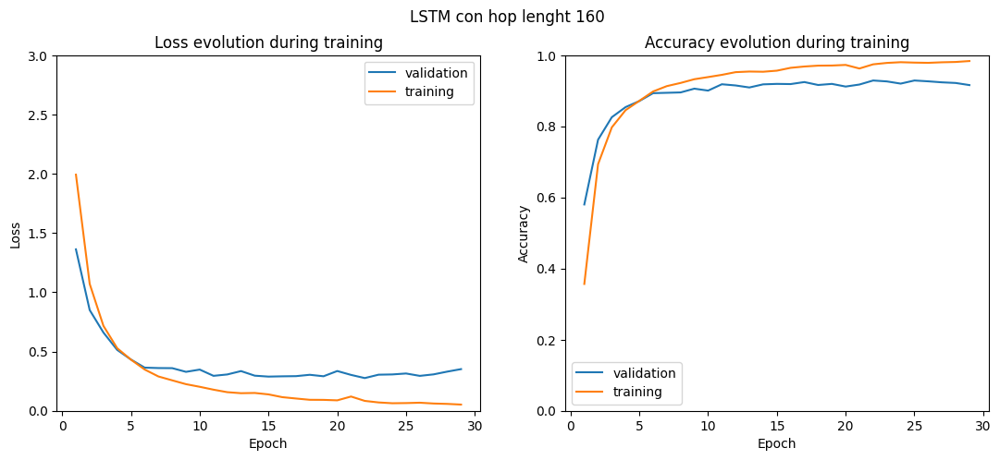

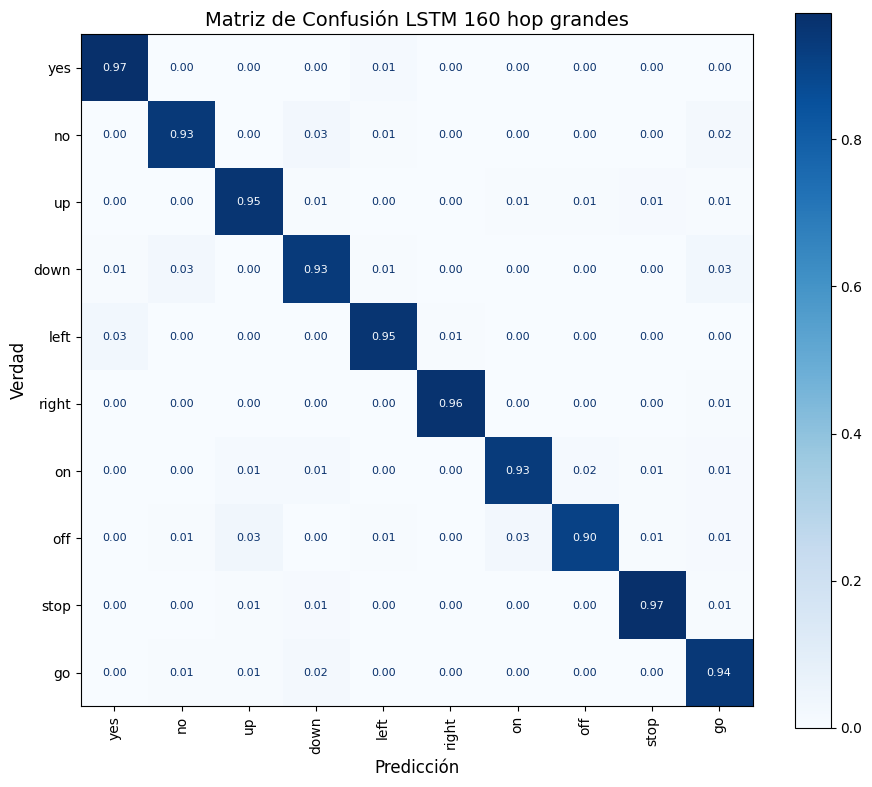

              precision    recall  f1-score   support

         yes       0.96      0.98      0.97       392
          no       0.96      0.95      0.95       391
          up       0.94      0.96      0.95       391
        down       0.93      0.94      0.93       394
        left       0.97      0.96      0.96       393
       right       0.98      0.98      0.98       385
          on       0.96      0.94      0.95       391
         off       0.98      0.91      0.94       393
        stop       0.97      0.97      0.97       394
          go       0.91      0.96      0.93       389

    accuracy                           0.96      3913
   macro avg       0.96      0.96      0.96      3913
weighted avg       0.96      0.96      0.96      3913

Precisión global (Accuracy): 0.9553
📁 Métricas guardadas en: metricas_LSTM_160_hop_grandes.json

========== Iteración 5/3 ==========
Epoch 1/40
Iteration 84 - Batch 84/508 - Train loss: 2.7070, Train acc: 14.14%
Iteration 168 - Batch 168/508

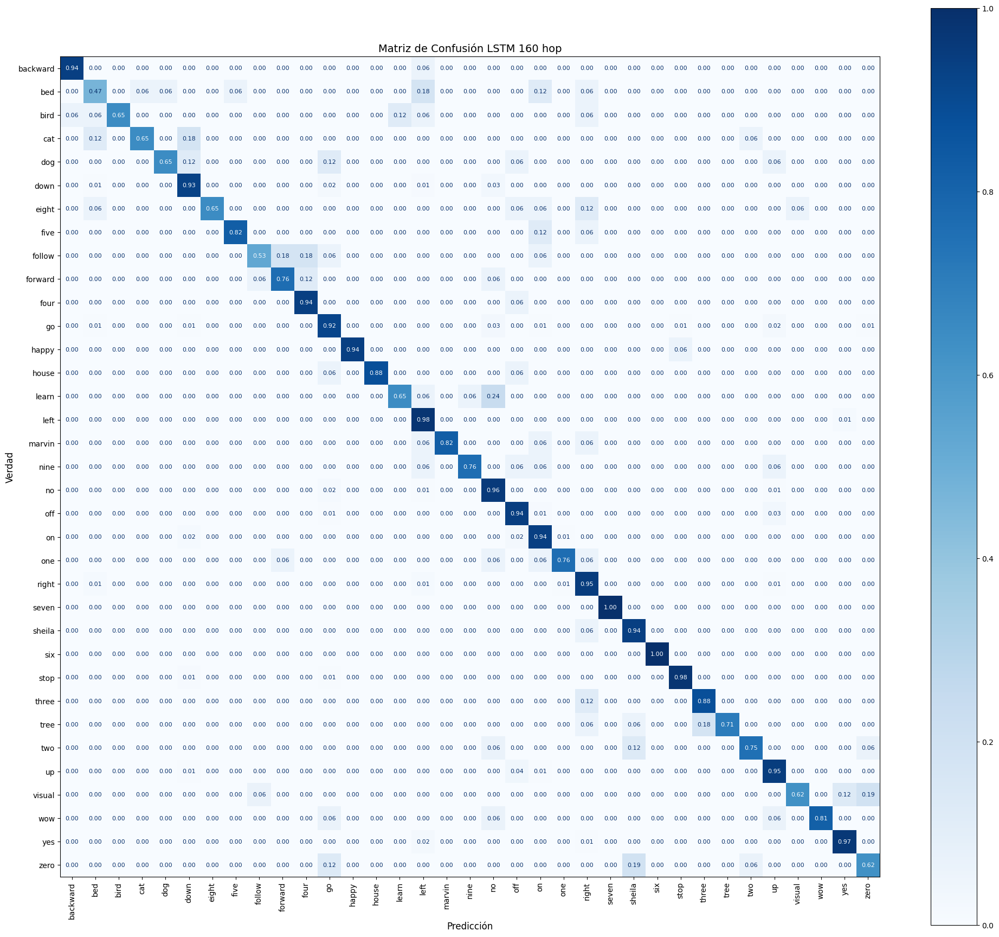

              precision    recall  f1-score   support

    backward       0.80      0.94      0.86        17
         bed       0.33      0.47      0.39        17
        bird       0.92      0.65      0.76        17
         cat       0.79      0.65      0.71        17
         dog       0.85      0.65      0.73        17
        down       0.95      0.93      0.94       396
       eight       1.00      0.65      0.79        17
        five       0.88      0.82      0.85        17
      follow       0.69      0.53      0.60        17
     forward       0.76      0.76      0.76        17
        four       0.76      0.94      0.84        17
          go       0.93      0.92      0.92       396
       happy       0.94      0.94      0.94        17
       house       0.94      0.88      0.91        17
       learn       0.73      0.65      0.69        17
        left       0.93      0.98      0.95       396
      marvin       1.00      0.82      0.90        17
        nine       0.93    

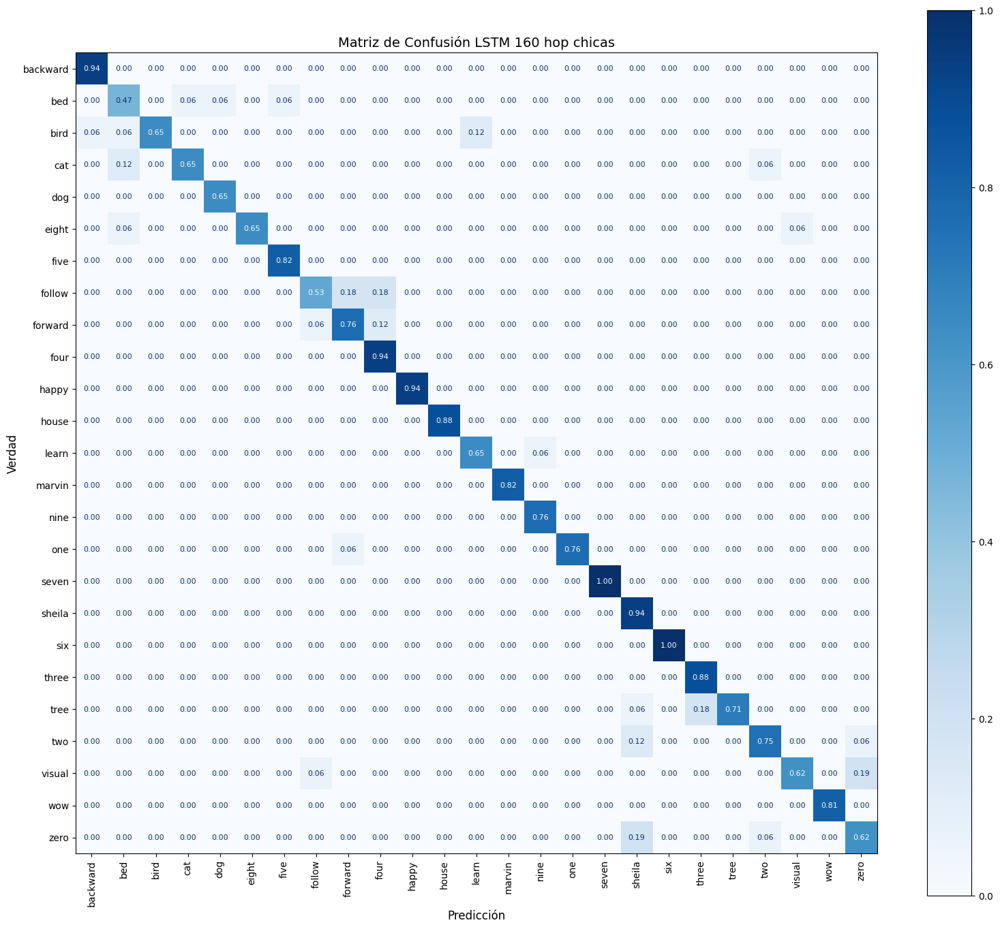

              precision    recall  f1-score   support

    backward       0.94      1.00      0.97        16
         bed       0.67      0.73      0.70        11
        bird       1.00      0.73      0.85        15
         cat       0.92      0.79      0.85        14
         dog       0.92      1.00      0.96        11
       eight       1.00      0.85      0.92        13
        five       0.93      1.00      0.97        14
      follow       0.82      0.60      0.69        15
     forward       0.76      0.81      0.79        16
        four       0.76      1.00      0.86        16
       happy       1.00      1.00      1.00        16
       house       1.00      1.00      1.00        15
       learn       0.85      0.92      0.88        12
      marvin       1.00      1.00      1.00        14
        nine       0.93      1.00      0.96        13
         one       1.00      0.93      0.96        14
       seven       1.00      1.00      1.00        17
      sheila       0.73    

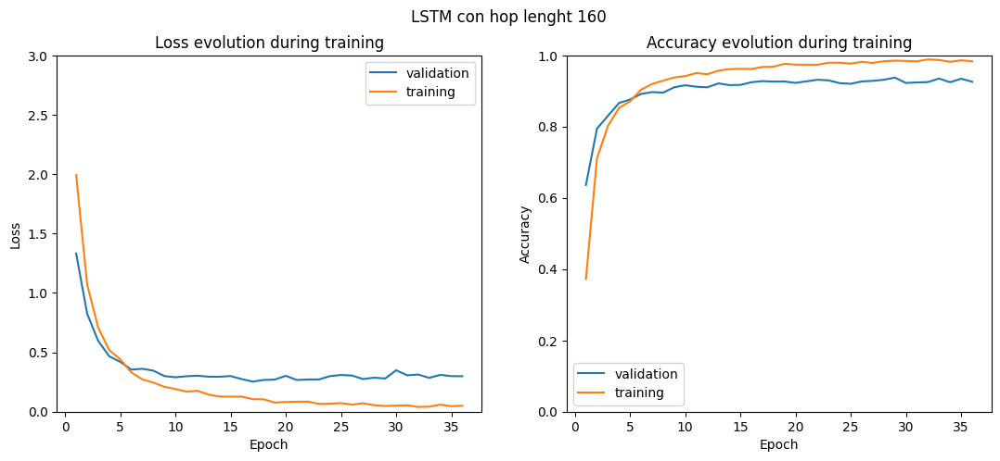

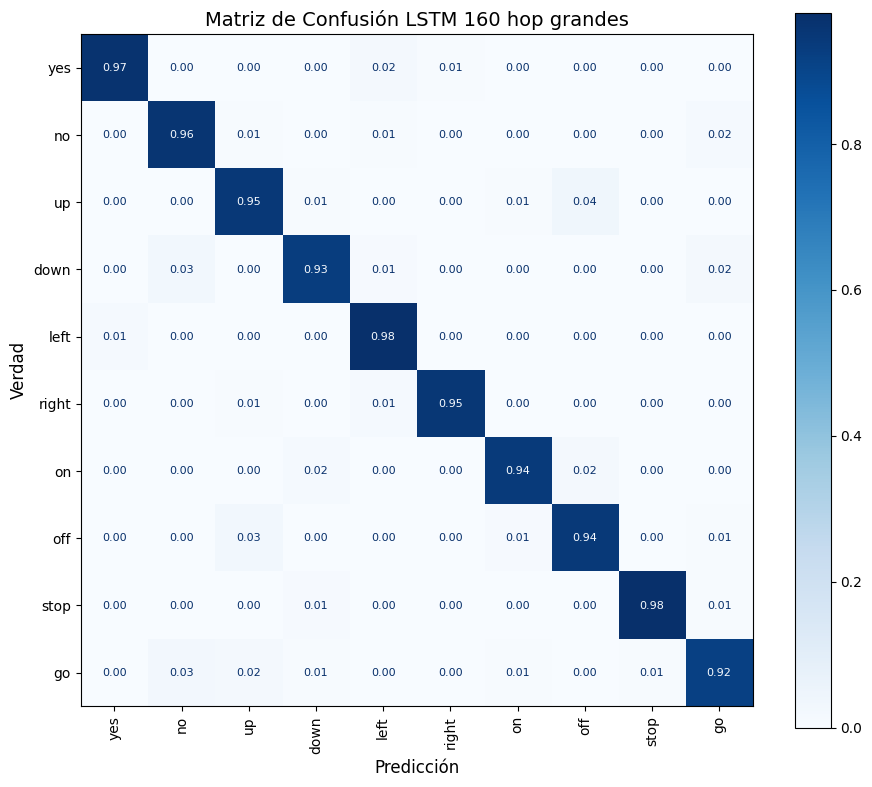

              precision    recall  f1-score   support

         yes       0.98      0.97      0.98       395
          no       0.94      0.96      0.95       394
          up       0.93      0.95      0.94       395
        down       0.96      0.94      0.95       391
        left       0.95      0.98      0.96       395
       right       0.99      0.97      0.98       388
          on       0.97      0.95      0.96       391
         off       0.94      0.95      0.94       393
        stop       0.98      0.98      0.98       395
          go       0.95      0.94      0.94       388

    accuracy                           0.96      3925
   macro avg       0.96      0.96      0.96      3925
weighted avg       0.96      0.96      0.96      3925

Precisión global (Accuracy): 0.9595
📁 Métricas guardadas en: metricas_LSTM_160_hop_grandes.json

===== Resultados finales =====
Precisión promedio (5 runs): 93.00% ± 0.40%
Modelo final guardado


In [ ]:
device = "cuda" if torch.cuda.is_available() else "cpu"

# Datos y clases
train_dl, val_dl, test_dl = load2(MFCC_train_10, MFCC_val_10, MFCC_test_10, batch_size=64)

# Función para obtener predicciones
@torch.no_grad()
def get_predictions(loader, model, device="cpu"):
    model = model.to(device)
    model.eval()
    all_predictions, all_true_labels = [], []
    for xb, yb in loader:
        xb, yb = xb.to(device), yb.to(device)
        pred = model(xb).argmax(1)
        all_predictions.extend(pred.cpu().numpy())
        all_true_labels.extend(yb.cpu().numpy())
    return np.array(all_true_labels), np.array(all_predictions)

# Loop de 5 iteraciones
accuracies = []

for i in range(5):
    print(f"\n========== Iteración {i+1}/3 ==========")
    model = LSTMModel(
        input_size=39,
        hidden_size=128,
        num_layers=3,
        bidirectional=False,
        num_classes=len(label_map)
    ).to(device)

    criterion = nn.CrossEntropyLoss()

    curves = train_model(
        model, train_dl, val_dl,
        epochs=40, lr=1e-3,
        criterion=criterion,
        device=device,
        early_stopping_patience=7
    )

    true_labels, predictions = get_predictions(test_dl, model, device)
    acc = (predictions == true_labels).mean() * 100
    accuracies.append(acc)
    print(f"✅ Precisión iteración {i+1}: {acc:.2f}%")
    # Matriz de confusión del último modelo entrenado
    show_confusion_matrix(
        true_labels, predictions,
        clases_10,
        title=f"Matriz de Confusión LSTM 160 hop",
        filename="matriz_confusion_LSTM_160_hop.png",
        metrics_filename="metricas_LSTM_160_hop.json"
    )

    # Matriz de confusión del último modelo entrenado
    show_confusion_matrix(
        true_labels, predictions,
        clases_10,
        title=f"Matriz de Confusión LSTM 160 hop chicas",
        filename="matriz_confusion_LSTM_160_hop_chicas.png",
        selected_classes = clases_chicas,
        metrics_filename="metricas_LSTM_160_hop_chicas.json"
    )
    show_curves(curves, title="LSTM con hop lenght 160" , filename="Curva_LSTM_160_hop.png")

    # Matriz de confusión del último modelo entrenado
    show_confusion_matrix(
        true_labels, predictions,
        clases_10,
        title=f"Matriz de Confusión LSTM 160 hop grandes",
        filename="matriz_confusion_LSTM_160_hop_grandes.png",
        selected_classes = clases_grandes,
        metrics_filename="metricas_LSTM_160_hop_grandes.json"
    )

# Promedio y desviación estándar
mean_acc = np.mean(accuracies)
std_acc = np.std(accuracies)

print("\n===== Resultados finales =====")
print(f"Precisión promedio (5 runs): {mean_acc:.2f}% ± {std_acc:.2f}%")


torch.save(model.state_dict(), "modelo_LSTM_160.pth")
print("Modelo final guardado")


In [ ]:
model_summary(model)
time_per_sample, total_time = measure_inference_time(model, test_dl, device)

print(f"⏱️ Tiempo promedio por muestra: {time_per_sample*1000:.3f} ms")
print(f"⏱️ Tiempo total sobre el test: {total_time:.2f} s")

📌 Parámetros entrenables: 355,235
📦 Tamaño aproximado en memoria: 1.36 MB
💾 Tamaño real del archivo .pth: 1.36 MB
⏱️ Tiempo promedio por muestra: 0.072 ms
⏱️ Tiempo total sobre el test: 0.32 s


##### GRU bidireccional

{'backward': 0, 'bed': 1, 'bird': 2, 'cat': 3, 'dog': 4, 'down': 5, 'eight': 6, 'five': 7, 'follow': 8, 'forward': 9, 'four': 10, 'go': 11, 'happy': 12, 'house': 13, 'learn': 14, 'left': 15, 'marvin': 16, 'nine': 17, 'no': 18, 'off': 19, 'on': 20, 'one': 21, 'right': 22, 'seven': 23, 'sheila': 24, 'six': 25, 'stop': 26, 'three': 27, 'tree': 28, 'two': 29, 'up': 30, 'visual': 31, 'wow': 32, 'yes': 33, 'zero': 34}
{'backward': 0, 'bed': 1, 'bird': 2, 'cat': 3, 'dog': 4, 'down': 5, 'eight': 6, 'five': 7, 'follow': 8, 'forward': 9, 'four': 10, 'go': 11, 'happy': 12, 'house': 13, 'learn': 14, 'left': 15, 'marvin': 16, 'nine': 17, 'no': 18, 'off': 19, 'on': 20, 'one': 21, 'right': 22, 'seven': 23, 'sheila': 24, 'six': 25, 'stop': 26, 'three': 27, 'tree': 28, 'two': 29, 'up': 30, 'visual': 31, 'wow': 32, 'yes': 33, 'zero': 34}
{'backward': 0, 'bed': 1, 'bird': 2, 'cat': 3, 'dog': 4, 'down': 5, 'eight': 6, 'five': 7, 'follow': 8, 'forward': 9, 'four': 10, 'go': 11, 'happy': 12, 'house': 13, 'l

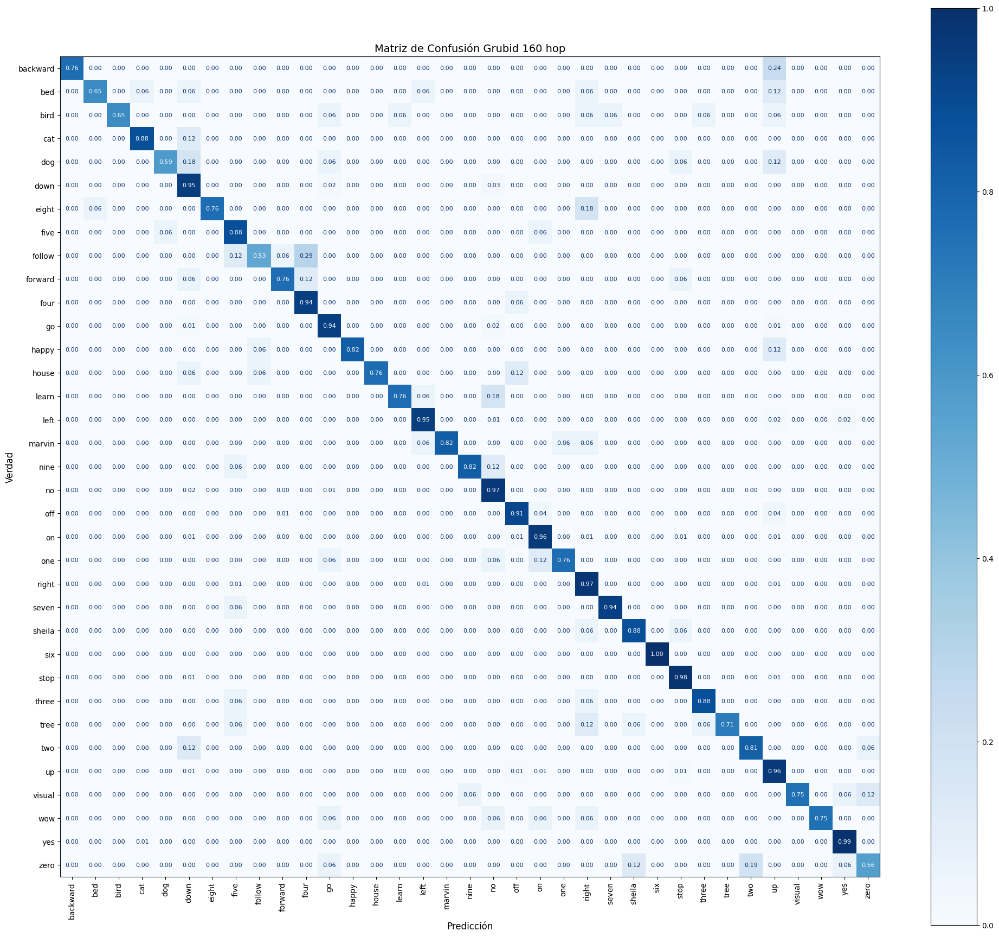

              precision    recall  f1-score   support

    backward       1.00      0.76      0.87        17
         bed       0.79      0.65      0.71        17
        bird       1.00      0.65      0.79        17
         cat       0.75      0.88      0.81        17
         dog       0.91      0.59      0.71        17
        down       0.93      0.95      0.94       396
       eight       1.00      0.76      0.87        17
        five       0.62      0.88      0.73        17
      follow       0.64      0.53      0.58        17
     forward       0.81      0.76      0.79        17
        four       0.70      0.94      0.80        17
          go       0.95      0.94      0.95       396
       happy       1.00      0.82      0.90        17
       house       1.00      0.76      0.87        17
       learn       0.87      0.76      0.81        17
        left       0.98      0.95      0.96       396
      marvin       1.00      0.82      0.90        17
        nine       0.88    

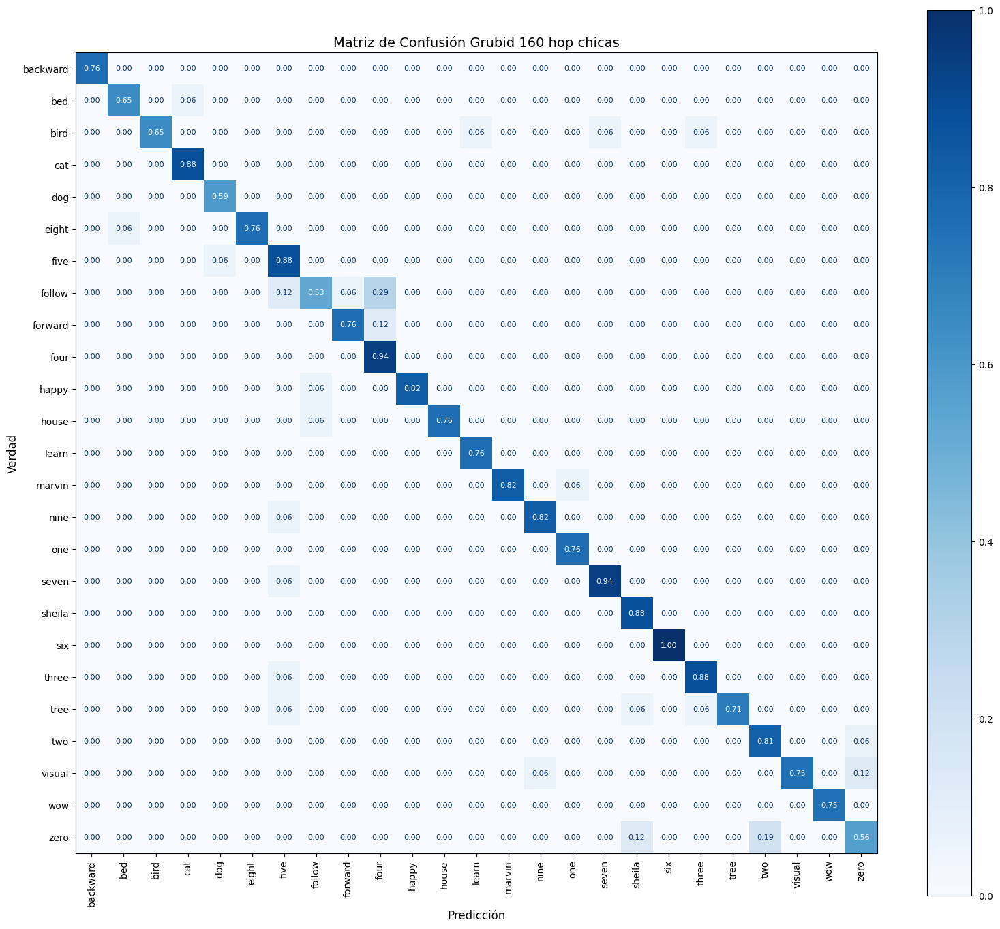

              precision    recall  f1-score   support

    backward       1.00      1.00      1.00        13
         bed       0.92      0.92      0.92        12
        bird       1.00      0.79      0.88        14
         cat       0.94      1.00      0.97        15
         dog       0.91      1.00      0.95        10
       eight       1.00      0.93      0.96        14
        five       0.71      0.94      0.81        16
      follow       0.82      0.53      0.64        17
     forward       0.93      0.87      0.90        15
        four       0.70      1.00      0.82        16
       happy       1.00      0.93      0.97        15
       house       1.00      0.93      0.96        14
       learn       0.93      1.00      0.96        13
      marvin       1.00      0.93      0.97        15
        nine       0.93      0.93      0.93        15
         one       0.93      1.00      0.96        13
       seven       0.94      0.94      0.94        17
      sheila       0.83    

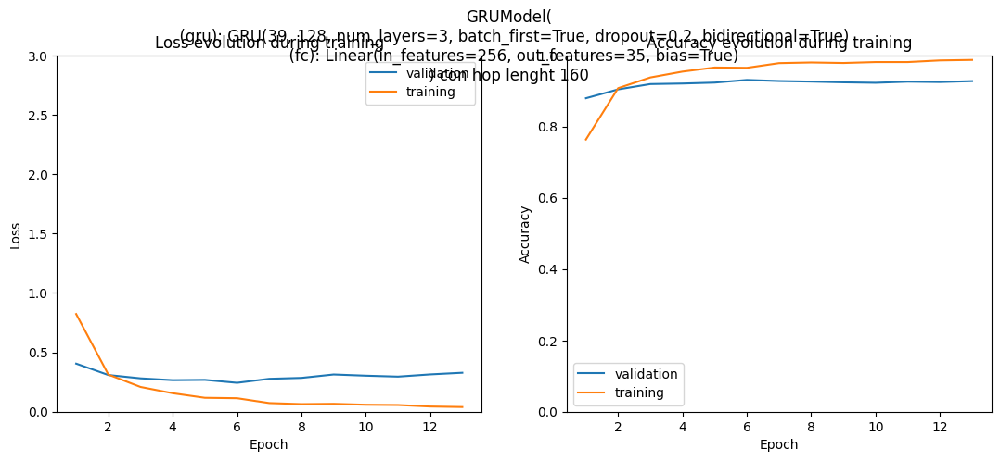

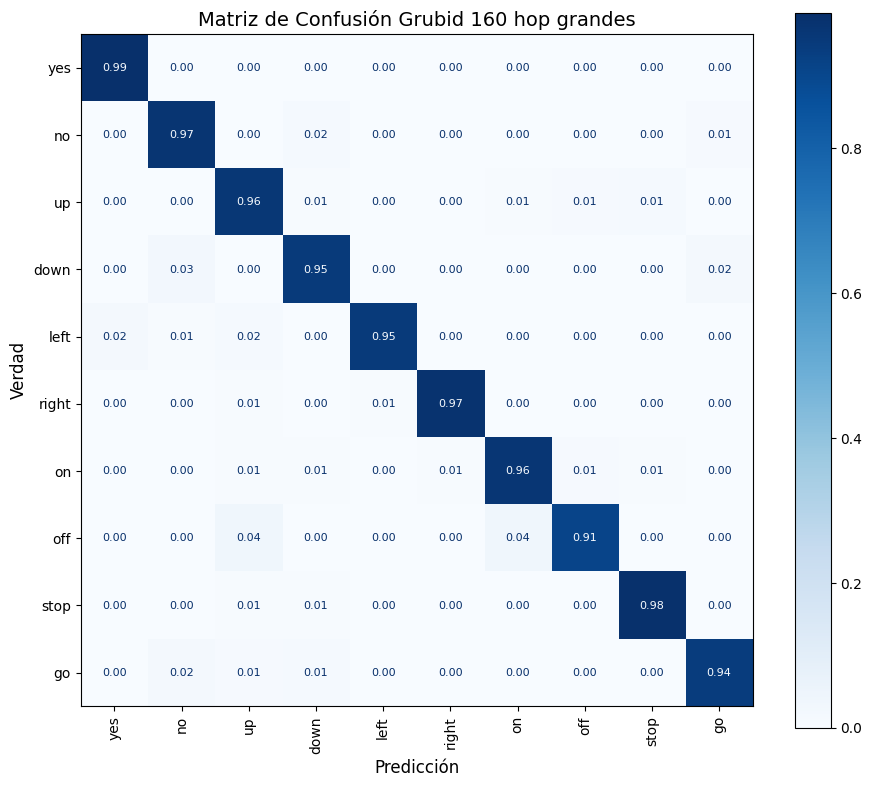

              precision    recall  f1-score   support

         yes       0.98      0.99      0.98       394
          no       0.94      0.97      0.96       395
          up       0.92      0.96      0.94       394
        down       0.95      0.95      0.95       395
        left       0.99      0.95      0.97       393
       right       0.99      0.98      0.99       392
          on       0.95      0.96      0.96       395
         off       0.97      0.92      0.94       392
        stop       0.97      0.98      0.98       395
          go       0.96      0.95      0.96       393

    accuracy                           0.96      3938
   macro avg       0.96      0.96      0.96      3938
weighted avg       0.96      0.96      0.96      3938

Precisión global (Accuracy): 0.9624
📁 Métricas guardadas en: metricas_Grubid_160_hop_grandes.json

========== Iteración 2/3 ==========
Epoch 1/40
Iteration 84 - Batch 84/508 - Train loss: 1.7951, Train acc: 49.94%
Iteration 168 - Batch 168/5

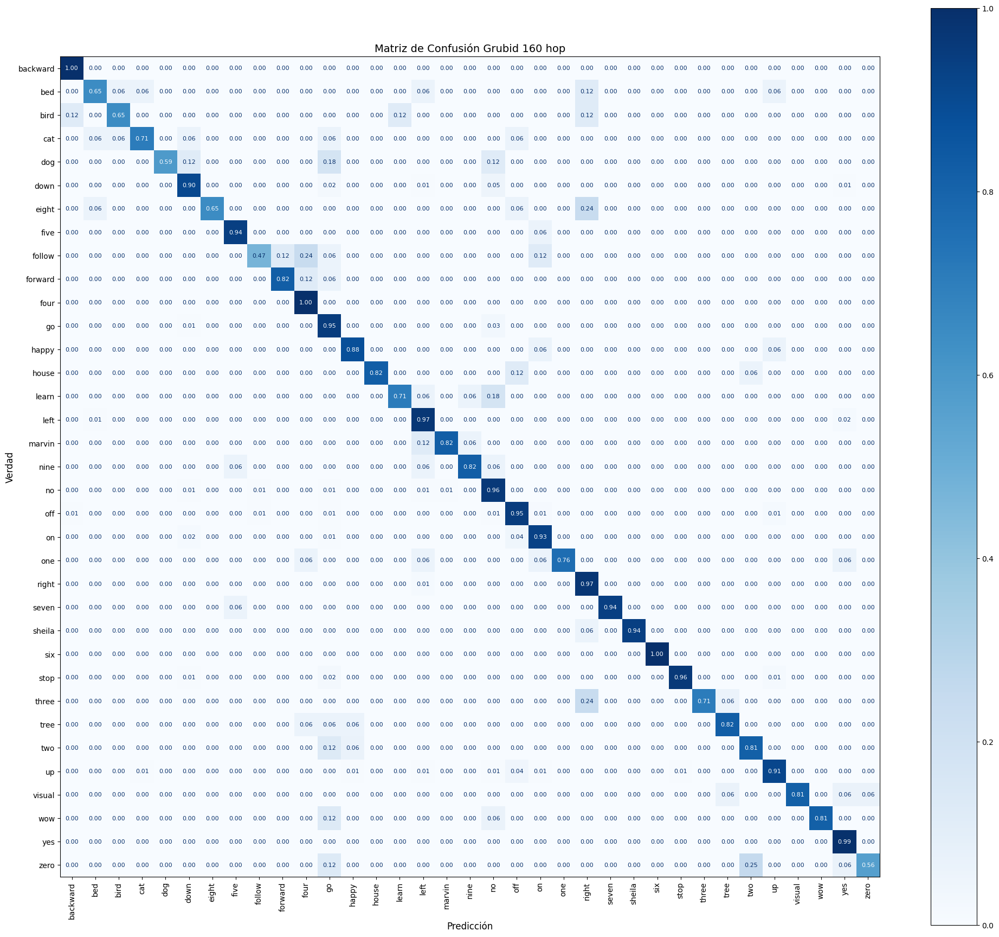

              precision    recall  f1-score   support

    backward       0.81      1.00      0.89        17
         bed       0.65      0.65      0.65        17
        bird       0.85      0.65      0.73        17
         cat       0.71      0.71      0.71        17
         dog       0.83      0.59      0.69        17
        down       0.95      0.90      0.93       396
       eight       0.92      0.65      0.76        17
        five       0.89      0.94      0.91        17
      follow       0.57      0.47      0.52        17
     forward       0.82      0.82      0.82        17
        four       0.68      1.00      0.81        17
          go       0.90      0.95      0.92       396
       happy       0.79      0.88      0.83        17
       house       1.00      0.82      0.90        17
       learn       0.75      0.71      0.73        17
        left       0.95      0.97      0.96       396
      marvin       0.88      0.82      0.85        17
        nine       0.82    

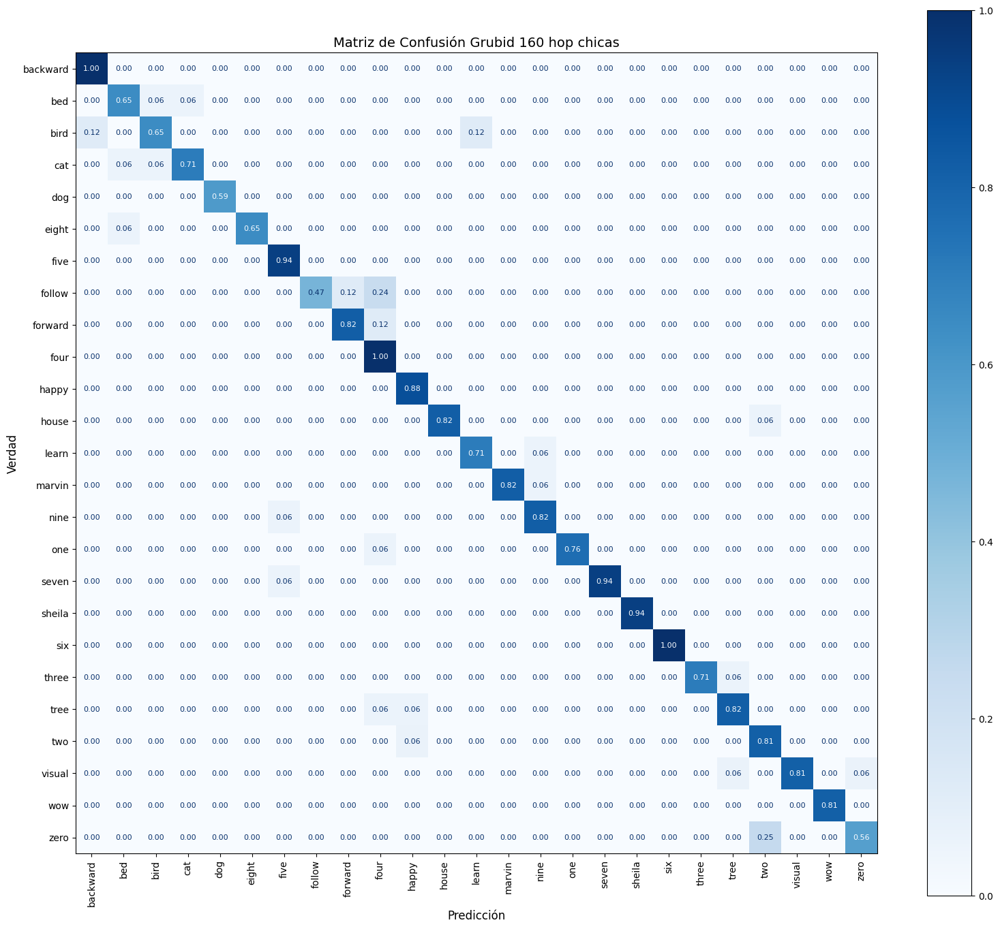

              precision    recall  f1-score   support

    backward       0.89      1.00      0.94        17
         bed       0.85      0.85      0.85        13
        bird       0.85      0.73      0.79        15
         cat       0.92      0.86      0.89        14
         dog       1.00      1.00      1.00        10
       eight       1.00      0.92      0.96        12
        five       0.89      1.00      0.94        16
      follow       1.00      0.57      0.73        14
     forward       0.88      0.88      0.88        16
        four       0.68      1.00      0.81        17
       happy       0.88      1.00      0.94        15
       house       1.00      0.93      0.97        15
       learn       0.86      0.92      0.89        13
      marvin       1.00      0.93      0.97        15
        nine       0.88      0.93      0.90        15
         one       1.00      0.93      0.96        14
       seven       1.00      0.94      0.97        17
      sheila       1.00    

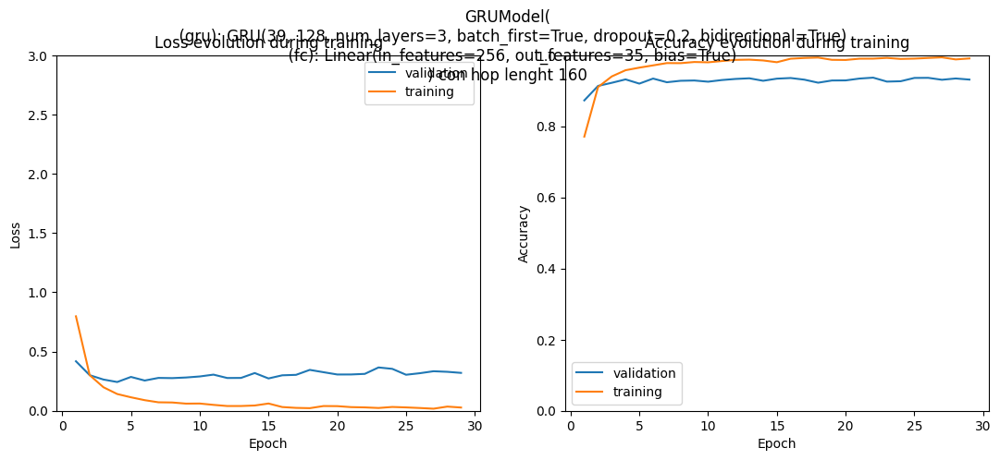

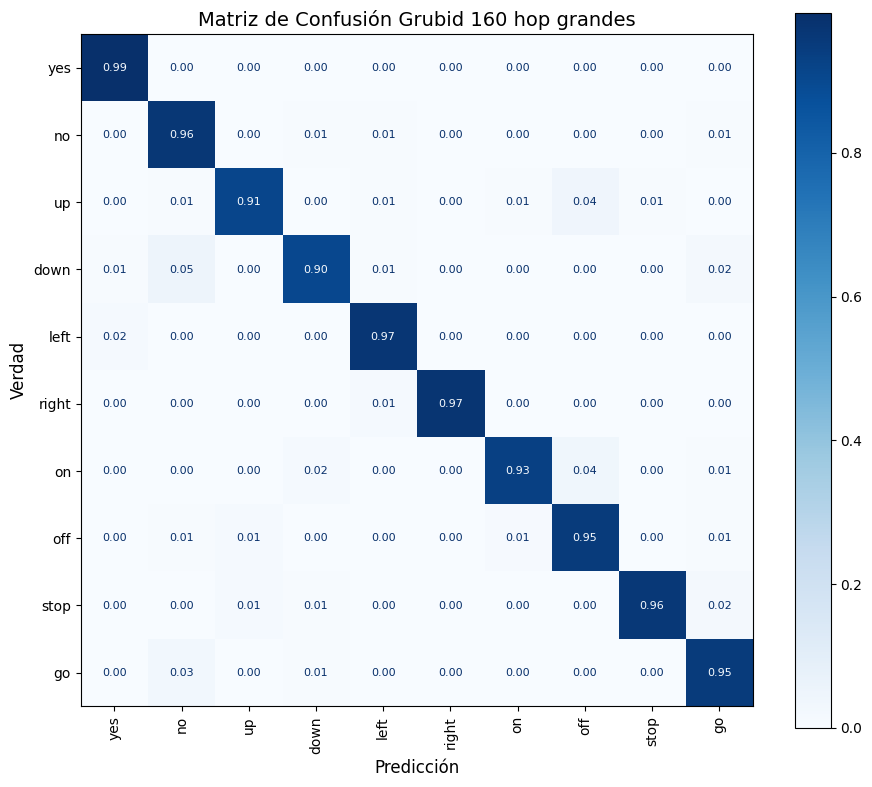

              precision    recall  f1-score   support

         yes       0.98      0.99      0.98       396
          no       0.91      0.97      0.94       392
          up       0.97      0.93      0.95       389
        down       0.96      0.92      0.94       391
        left       0.96      0.98      0.97       392
       right       0.99      0.98      0.98       395
          on       0.98      0.94      0.96       394
         off       0.92      0.96      0.94       391
        stop       0.99      0.96      0.98       395
          go       0.93      0.95      0.94       394

    accuracy                           0.96      3929
   macro avg       0.96      0.96      0.96      3929
weighted avg       0.96      0.96      0.96      3929

Precisión global (Accuracy): 0.9588
📁 Métricas guardadas en: metricas_Grubid_160_hop_grandes.json

========== Iteración 3/3 ==========
Epoch 1/40
Iteration 84 - Batch 84/508 - Train loss: 1.7883, Train acc: 47.87%
Iteration 168 - Batch 168/5

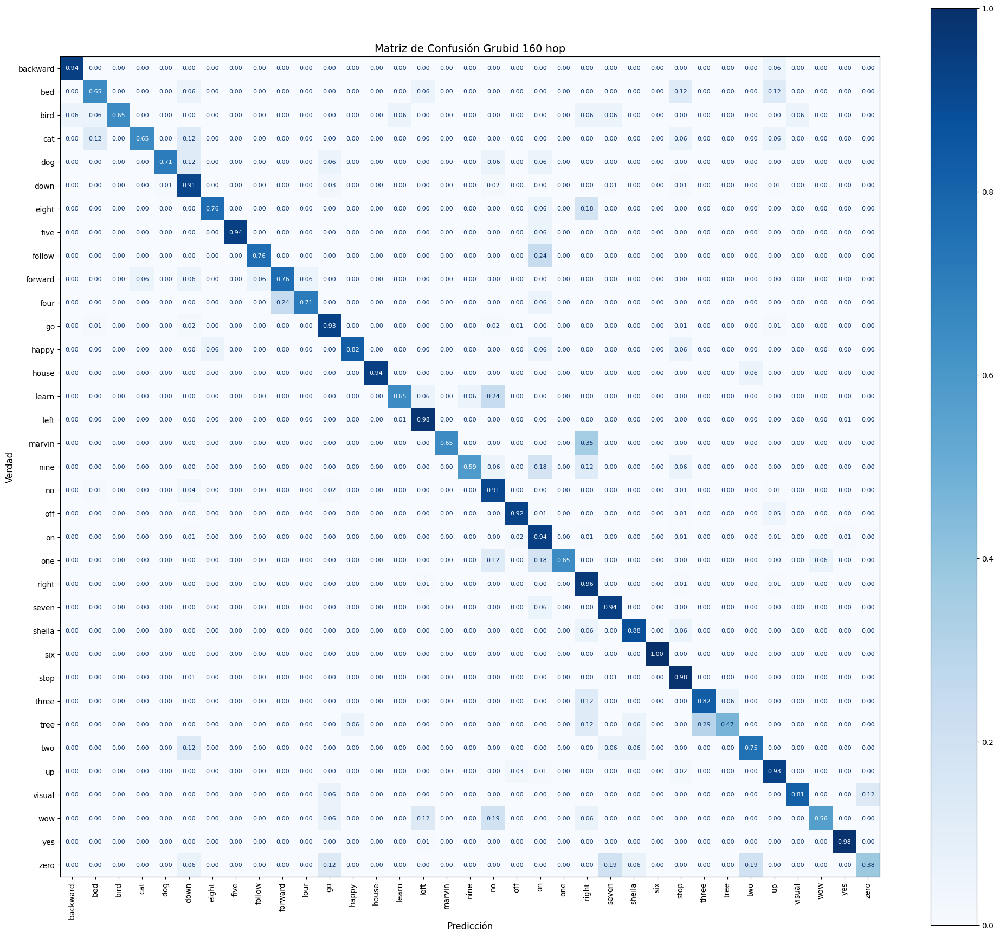

              precision    recall  f1-score   support

    backward       0.94      0.94      0.94        17
         bed       0.46      0.65      0.54        17
        bird       0.92      0.65      0.76        17
         cat       0.79      0.65      0.71        17
         dog       0.67      0.71      0.69        17
        down       0.91      0.91      0.91       396
       eight       0.87      0.76      0.81        17
        five       0.89      0.94      0.91        17
      follow       0.93      0.76      0.84        17
     forward       0.76      0.76      0.76        17
        four       0.86      0.71      0.77        17
          go       0.93      0.93      0.93       396
       happy       0.88      0.82      0.85        17
       house       0.94      0.94      0.94        17
       learn       0.79      0.65      0.71        17
        left       0.97      0.98      0.98       396
      marvin       1.00      0.65      0.79        17
        nine       0.91    

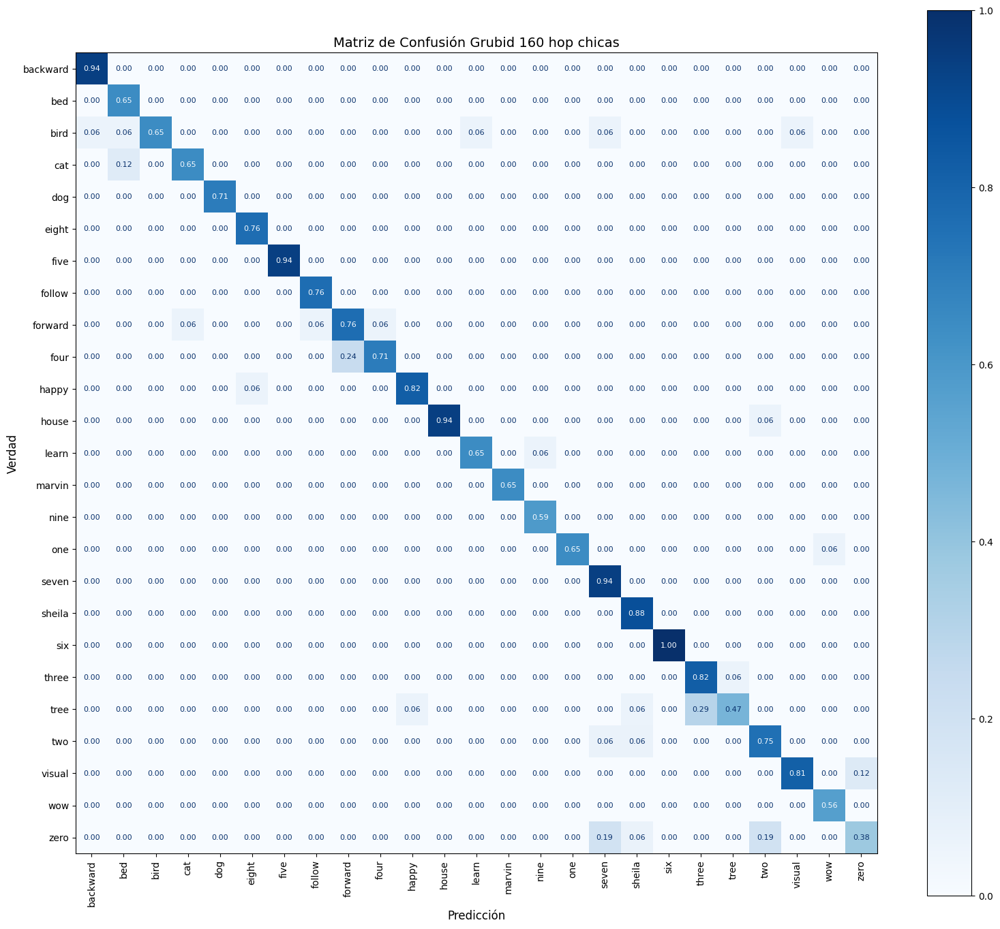

              precision    recall  f1-score   support

    backward       0.94      1.00      0.97        16
         bed       0.79      1.00      0.88        11
        bird       1.00      0.69      0.81        16
         cat       0.92      0.85      0.88        13
         dog       1.00      1.00      1.00        12
       eight       0.93      1.00      0.96        13
        five       1.00      1.00      1.00        16
      follow       0.93      1.00      0.96        13
     forward       0.76      0.81      0.79        16
        four       0.92      0.75      0.83        16
       happy       0.93      0.93      0.93        15
       house       1.00      0.94      0.97        17
       learn       0.92      0.92      0.92        12
      marvin       1.00      1.00      1.00        11
        nine       0.91      1.00      0.95        10
         one       1.00      0.92      0.96        12
       seven       0.76      1.00      0.86        16
      sheila       0.83    

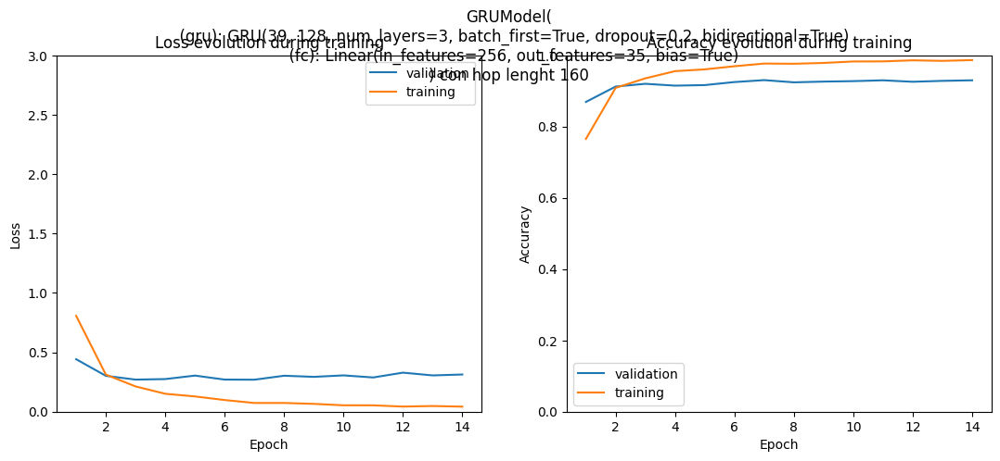

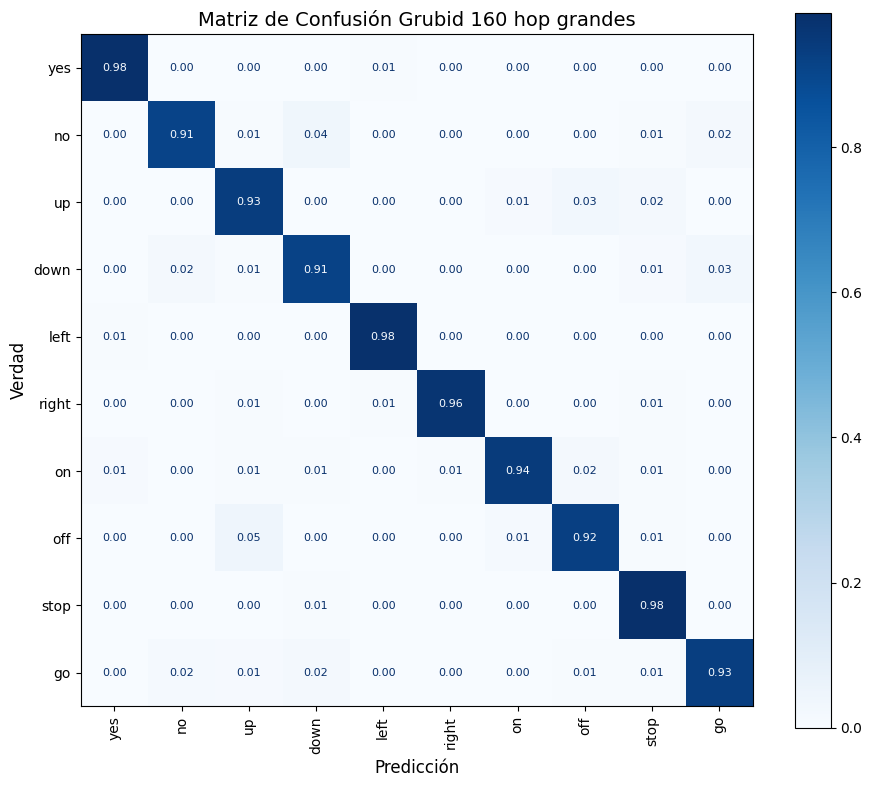

              precision    recall  f1-score   support

         yes       0.97      0.99      0.98       395
          no       0.96      0.92      0.94       391
          up       0.92      0.94      0.93       393
        down       0.93      0.94      0.93       387
        left       0.98      0.99      0.99       392
       right       0.99      0.97      0.98       391
          on       0.97      0.95      0.96       393
         off       0.94      0.93      0.93       394
        stop       0.94      0.99      0.97       393
          go       0.95      0.94      0.94       391

    accuracy                           0.96      3920
   macro avg       0.96      0.96      0.96      3920
weighted avg       0.96      0.96      0.96      3920

Precisión global (Accuracy): 0.9554
📁 Métricas guardadas en: metricas_Grubid_160_hop_grandes.json

========== Iteración 4/3 ==========
Epoch 1/40
Iteration 84 - Batch 84/508 - Train loss: 1.8047, Train acc: 49.80%
Iteration 168 - Batch 168/5

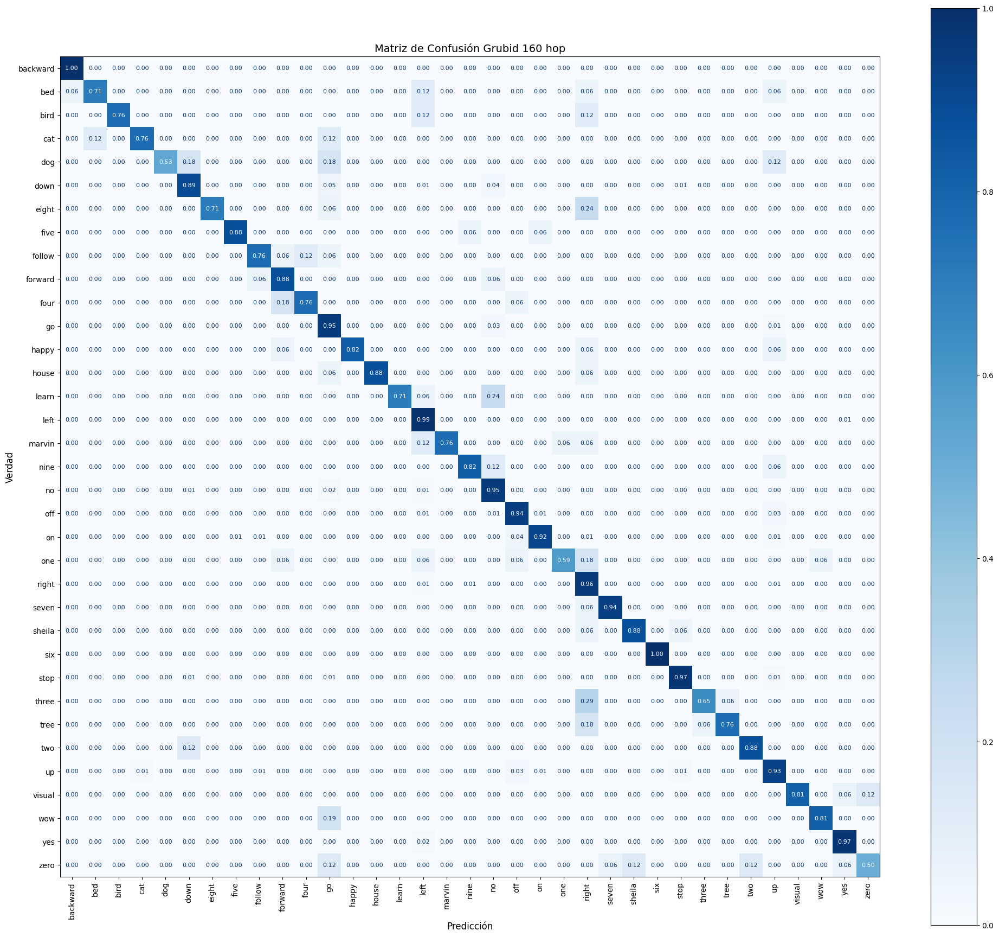

              precision    recall  f1-score   support

    backward       0.94      1.00      0.97        17
         bed       0.80      0.71      0.75        17
        bird       1.00      0.76      0.87        17
         cat       0.72      0.76      0.74        17
         dog       1.00      0.53      0.69        17
        down       0.97      0.89      0.93       396
       eight       0.92      0.71      0.80        17
        five       0.88      0.88      0.88        17
      follow       0.68      0.76      0.72        17
     forward       0.68      0.88      0.77        17
        four       0.87      0.76      0.81        17
          go       0.89      0.95      0.92       396
       happy       0.93      0.82      0.88        17
       house       1.00      0.88      0.94        17
       learn       1.00      0.71      0.83        17
        left       0.92      0.99      0.95       396
      marvin       1.00      0.76      0.87        17
        nine       0.78    

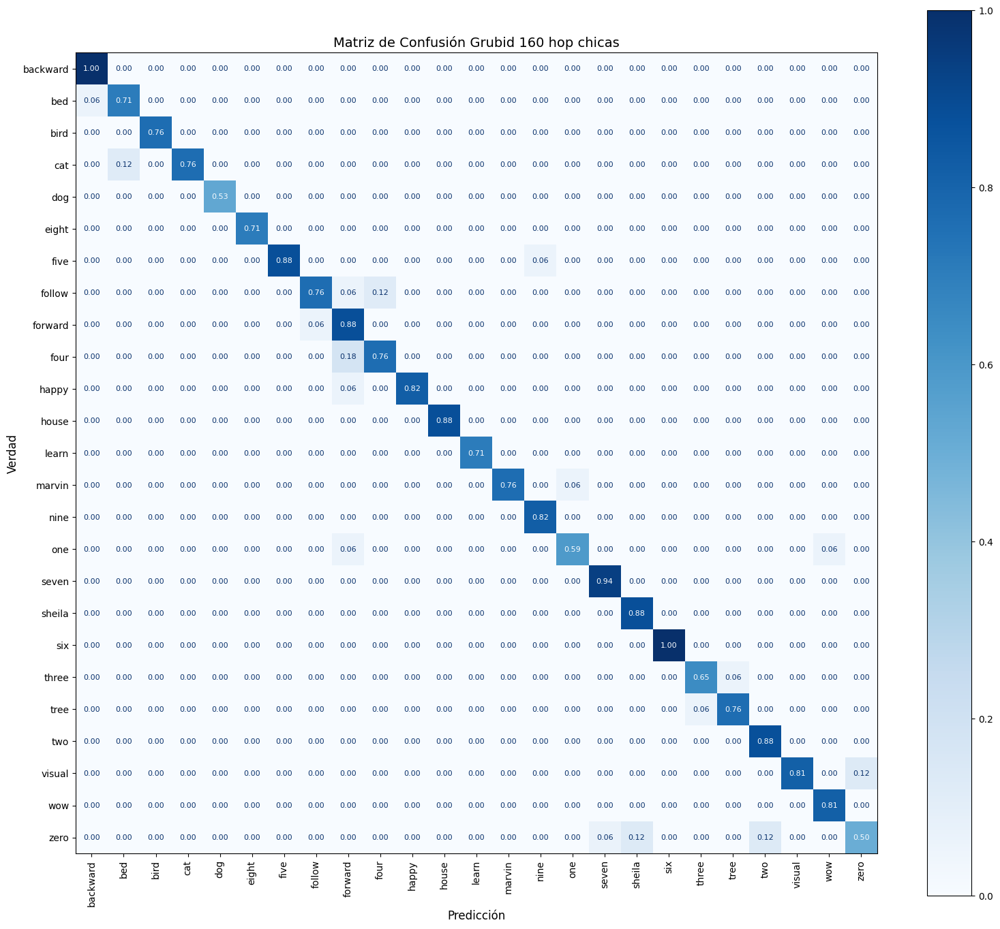

              precision    recall  f1-score   support

    backward       0.94      1.00      0.97        17
         bed       0.86      0.92      0.89        13
        bird       1.00      1.00      1.00        13
         cat       1.00      0.87      0.93        15
         dog       1.00      1.00      1.00         9
       eight       1.00      1.00      1.00        12
        five       1.00      0.94      0.97        16
      follow       0.93      0.81      0.87        16
     forward       0.71      0.94      0.81        16
        four       0.87      0.81      0.84        16
       happy       1.00      0.93      0.97        15
       house       1.00      1.00      1.00        15
       learn       1.00      1.00      1.00        12
      marvin       1.00      0.93      0.96        14
        nine       0.93      1.00      0.97        14
         one       0.91      0.83      0.87        12
       seven       0.94      1.00      0.97        16
      sheila       0.88    

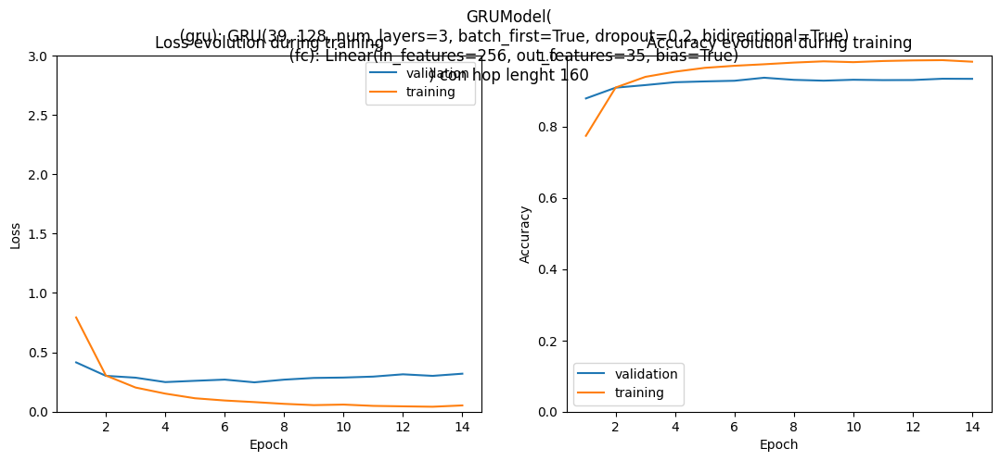

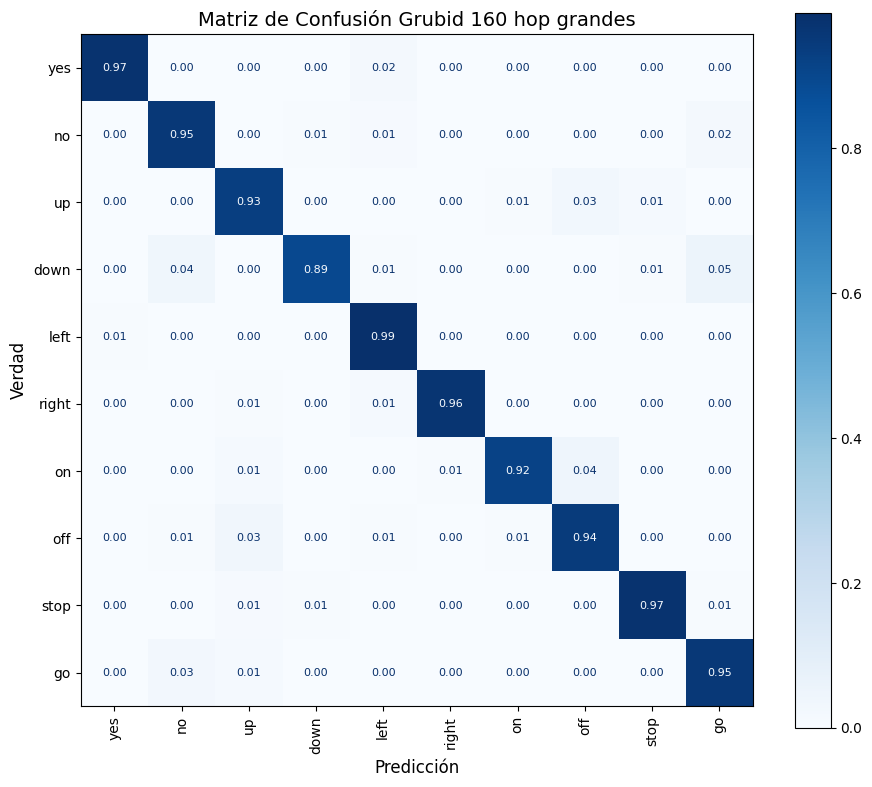

              precision    recall  f1-score   support

         yes       0.99      0.98      0.98       395
          no       0.93      0.95      0.94       396
          up       0.92      0.95      0.93       389
        down       0.98      0.90      0.94       393
        left       0.94      0.99      0.97       395
       right       0.99      0.97      0.98       393
          on       0.98      0.93      0.96       390
         off       0.93      0.94      0.93       396
        stop       0.98      0.98      0.98       395
          go       0.92      0.95      0.94       396

    accuracy                           0.95      3938
   macro avg       0.96      0.95      0.95      3938
weighted avg       0.96      0.95      0.95      3938

Precisión global (Accuracy): 0.9545
📁 Métricas guardadas en: metricas_Grubid_160_hop_grandes.json

========== Iteración 5/3 ==========
Epoch 1/40
Iteration 84 - Batch 84/508 - Train loss: 1.8326, Train acc: 48.00%
Iteration 168 - Batch 168/5

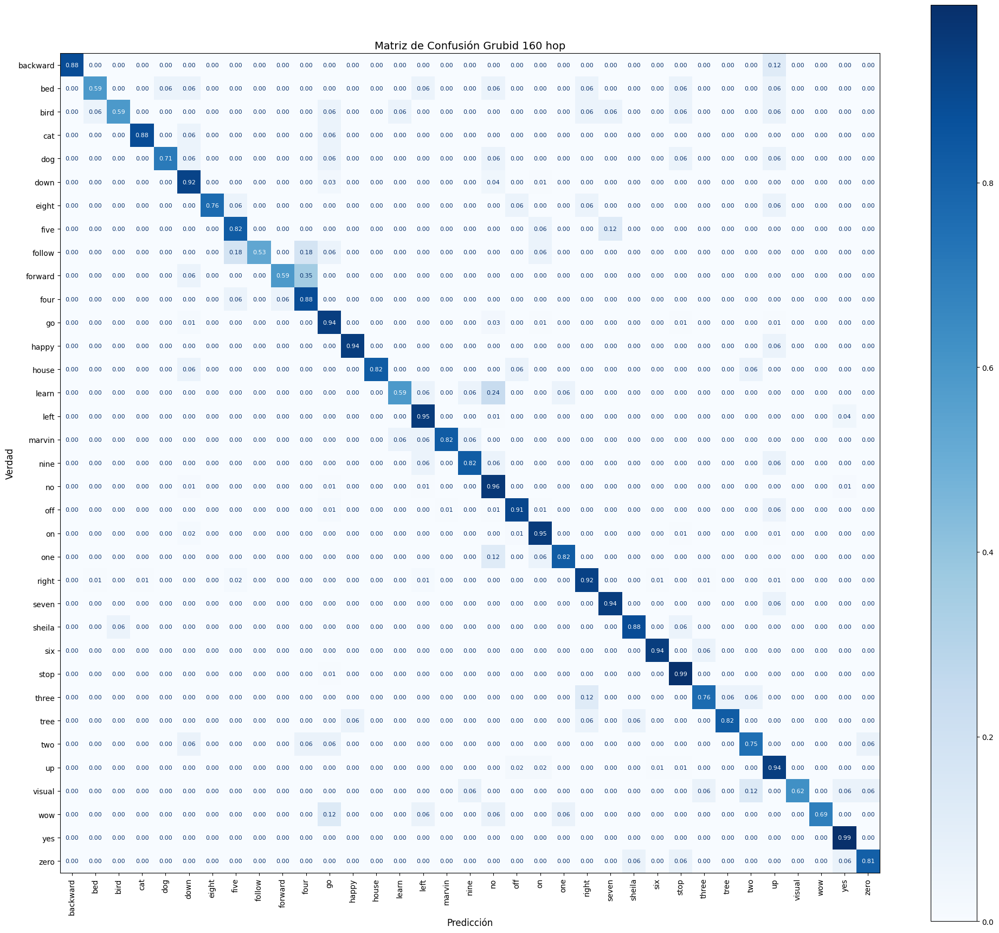

              precision    recall  f1-score   support

    backward       1.00      0.88      0.94        17
         bed       0.71      0.59      0.65        17
        bird       0.83      0.59      0.69        17
         cat       0.71      0.88      0.79        17
         dog       0.86      0.71      0.77        17
        down       0.94      0.92      0.93       396
       eight       1.00      0.76      0.87        17
        five       0.50      0.82      0.62        17
      follow       1.00      0.53      0.69        17
     forward       0.83      0.59      0.69        17
        four       0.58      0.88      0.70        17
          go       0.92      0.94      0.93       396
       happy       0.89      0.94      0.91        17
       house       1.00      0.82      0.90        17
       learn       0.83      0.59      0.69        17
        left       0.97      0.95      0.96       396
      marvin       0.82      0.82      0.82        17
        nine       0.82    

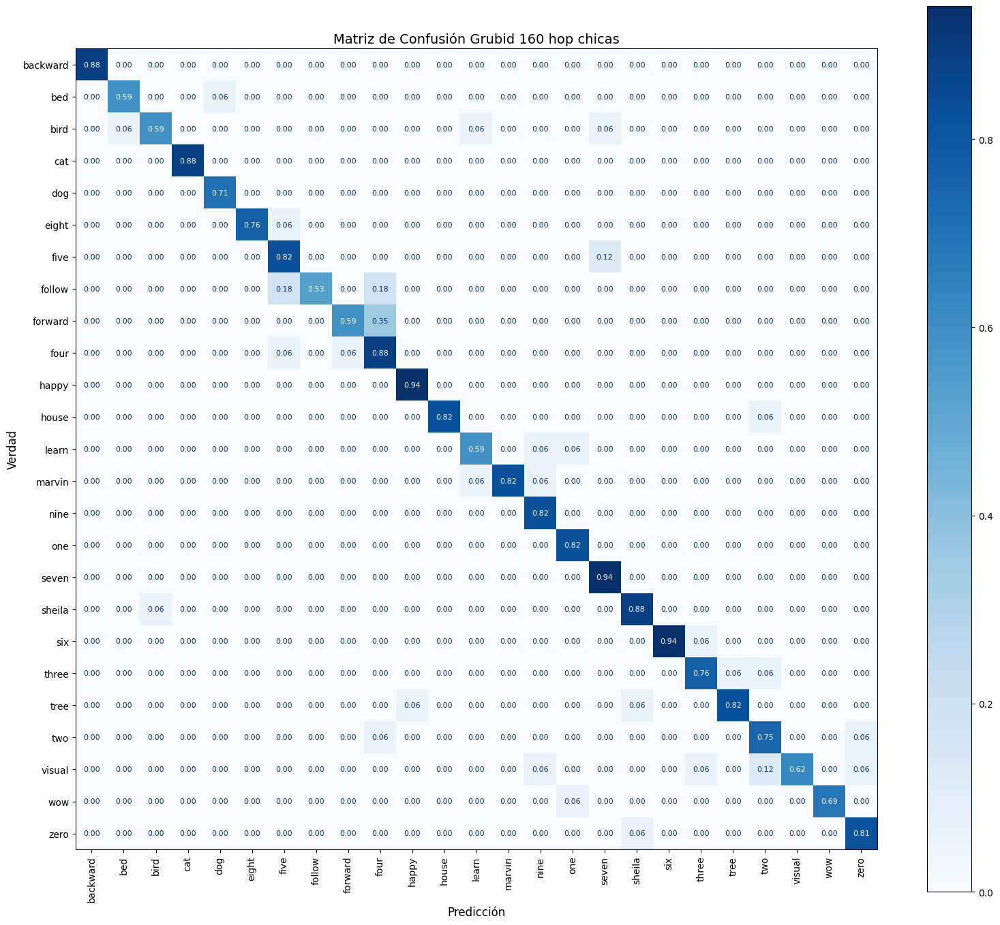

              precision    recall  f1-score   support

    backward       1.00      1.00      1.00        15
         bed       0.91      0.91      0.91        11
        bird       0.91      0.77      0.83        13
         cat       1.00      1.00      1.00        15
         dog       0.92      1.00      0.96        12
       eight       1.00      0.93      0.96        14
        five       0.74      0.88      0.80        16
      follow       1.00      0.60      0.75        15
     forward       0.91      0.62      0.74        16
        four       0.60      0.88      0.71        17
       happy       0.94      1.00      0.97        16
       house       1.00      0.93      0.97        15
       learn       0.83      0.83      0.83        12
      marvin       1.00      0.88      0.93        16
        nine       0.82      1.00      0.90        14
         one       0.88      1.00      0.93        14
       seven       0.84      1.00      0.91        16
      sheila       0.88    

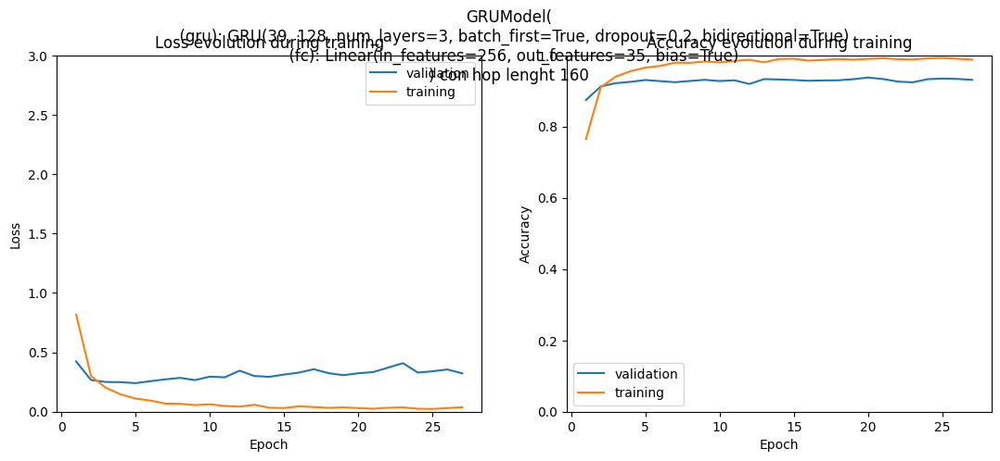

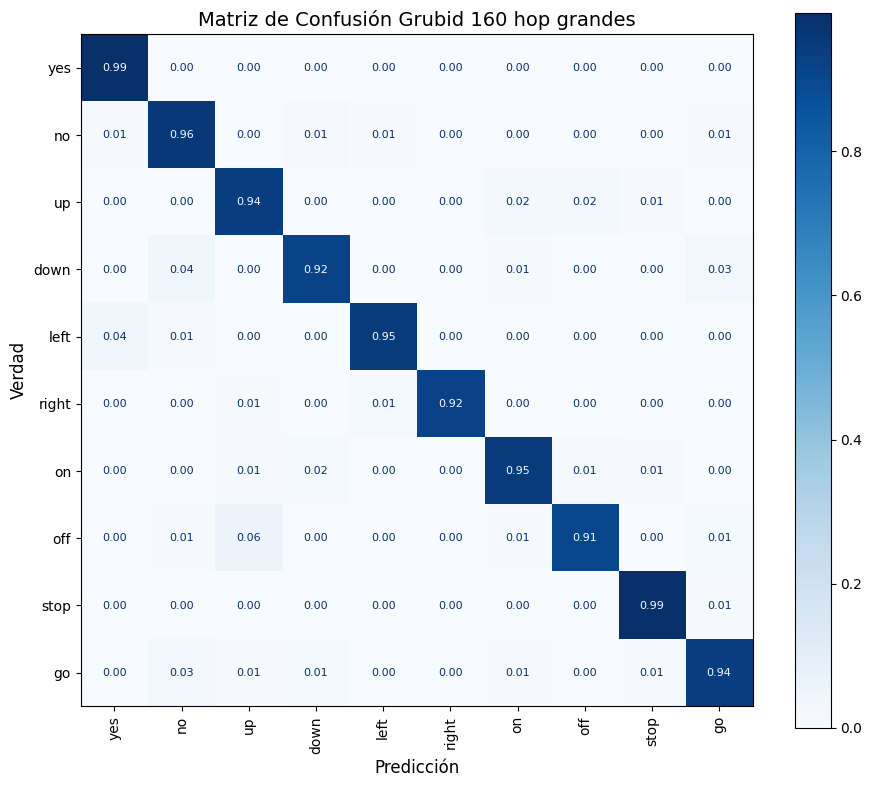

              precision    recall  f1-score   support

         yes       0.95      0.99      0.97       395
          no       0.93      0.96      0.95       394
          up       0.92      0.95      0.93       391
        down       0.95      0.92      0.94       394
        left       0.98      0.95      0.97       394
       right       0.99      0.97      0.98       377
          on       0.96      0.96      0.96       391
         off       0.97      0.92      0.94       392
        stop       0.97      0.99      0.98       395
          go       0.94      0.94      0.94       394

    accuracy                           0.96      3917
   macro avg       0.96      0.96      0.96      3917
weighted avg       0.96      0.96      0.96      3917

Precisión global (Accuracy): 0.9561
📁 Métricas guardadas en: metricas_Grubid_160_hop_grandes.json

===== Resultados finales =====
Precisión promedio (5 runs): 93.28% ± 0.50%
Modelo final guardado


In [ ]:
device = "cuda" if torch.cuda.is_available() else "cpu"

# Datos y clases
train_dl, val_dl, test_dl = load2(MFCC_train_10, MFCC_val_10, MFCC_test_10, batch_size=64)

# Función para obtener predicciones
@torch.no_grad()
def get_predictions(loader, model, device="cpu"):
    model = model.to(device)
    model.eval()
    all_predictions, all_true_labels = [], []
    for xb, yb in loader:
        xb, yb = xb.to(device), yb.to(device)
        pred = model(xb).argmax(1)
        all_predictions.extend(pred.cpu().numpy())
        all_true_labels.extend(yb.cpu().numpy())
    return np.array(all_true_labels), np.array(all_predictions)

# Loop de 5 iteraciones
accuracies = []

for i in range(5):
    print(f"\n========== Iteración {i+1}/3 ==========")
    model = GRUModel(
        input_size=39,
        hidden_size=128,
        num_layers=3,
        bidirectional=True,
        num_classes=len(label_map)
    ).to(device)

    criterion = nn.CrossEntropyLoss()

    curves = train_model(
        model, train_dl, val_dl,
        epochs=40, lr=1e-3,
        criterion=criterion,
        device=device,
        early_stopping_patience=7
    )

    true_labels, predictions = get_predictions(test_dl, model, device)
    acc = (predictions == true_labels).mean() * 100
    accuracies.append(acc)
    print(f"✅ Precisión iteración {i+1}: {acc:.2f}%")
    modelo = "Grubid"
    hop = 160
    # Matriz de confusión del último modelo entrenado
    show_confusion_matrix(
        true_labels, predictions,
        clases_10,
        title=f"Matriz de Confusión {modelo} {hop} hop",
        filename=f"matriz_confusion_{modelo}_{hop}_hop.png",
        metrics_filename=f"metricas_{modelo}_{hop}_hop.json"
    )

    # Matriz de confusión del último modelo entrenado
    show_confusion_matrix(
        true_labels, predictions,
        clases_10,
        title=f"Matriz de Confusión {modelo} {hop} hop chicas",
        filename=f"matriz_confusion_{modelo}_{hop}_hop_chicas.png",
        selected_classes = clases_chicas,
        metrics_filename=f"metricas_{modelo}_{hop}_hop_chicas.json"
    )
    show_curves(curves, title=f"{model} con hop lenght {hop}" , filename=f"Curva_{model}_{hop}_hop.png")

    # Matriz de confusión del último modelo entrenado
    show_confusion_matrix(
        true_labels, predictions,
        clases_10,
        title=f"Matriz de Confusión {modelo} {hop} hop grandes",
        filename=f"matriz_confusion_{modelo}_{hop}_hop_grandes.png",
        selected_classes = clases_grandes,
        metrics_filename=f"metricas_{modelo}_{hop}_hop_grandes.json"
    )
# Promedio y desviación estándar
mean_acc = np.mean(accuracies)
std_acc = np.std(accuracies)

print("\n===== Resultados finales =====")
print(f"Precisión promedio (5 runs): {mean_acc:.2f}% ± {std_acc:.2f}%")

torch.save(model.state_dict(), "modelo_Grubid_160.pth")
print("Modelo final guardado")




In [ ]:
model_summary(model)
time_per_sample, total_time = measure_inference_time(model, test_dl, device)

print(f"⏱️ Tiempo promedio por muestra: {time_per_sample*1000:.3f} ms")
print(f"⏱️ Tiempo total sobre el test: {total_time:.2f} s")

📌 Parámetros entrenables: 731,683
📦 Tamaño aproximado en memoria: 2.79 MB
💾 Tamaño real del archivo .pth: 2.80 MB
⏱️ Tiempo promedio por muestra: 0.095 ms
⏱️ Tiempo total sobre el test: 0.41 s


##### Transformer

{'backward': 0, 'bed': 1, 'bird': 2, 'cat': 3, 'dog': 4, 'down': 5, 'eight': 6, 'five': 7, 'follow': 8, 'forward': 9, 'four': 10, 'go': 11, 'happy': 12, 'house': 13, 'learn': 14, 'left': 15, 'marvin': 16, 'nine': 17, 'no': 18, 'off': 19, 'on': 20, 'one': 21, 'right': 22, 'seven': 23, 'sheila': 24, 'six': 25, 'stop': 26, 'three': 27, 'tree': 28, 'two': 29, 'up': 30, 'visual': 31, 'wow': 32, 'yes': 33, 'zero': 34}
{'backward': 0, 'bed': 1, 'bird': 2, 'cat': 3, 'dog': 4, 'down': 5, 'eight': 6, 'five': 7, 'follow': 8, 'forward': 9, 'four': 10, 'go': 11, 'happy': 12, 'house': 13, 'learn': 14, 'left': 15, 'marvin': 16, 'nine': 17, 'no': 18, 'off': 19, 'on': 20, 'one': 21, 'right': 22, 'seven': 23, 'sheila': 24, 'six': 25, 'stop': 26, 'three': 27, 'tree': 28, 'two': 29, 'up': 30, 'visual': 31, 'wow': 32, 'yes': 33, 'zero': 34}
{'backward': 0, 'bed': 1, 'bird': 2, 'cat': 3, 'dog': 4, 'down': 5, 'eight': 6, 'five': 7, 'follow': 8, 'forward': 9, 'four': 10, 'go': 11, 'happy': 12, 'house': 13, 'l

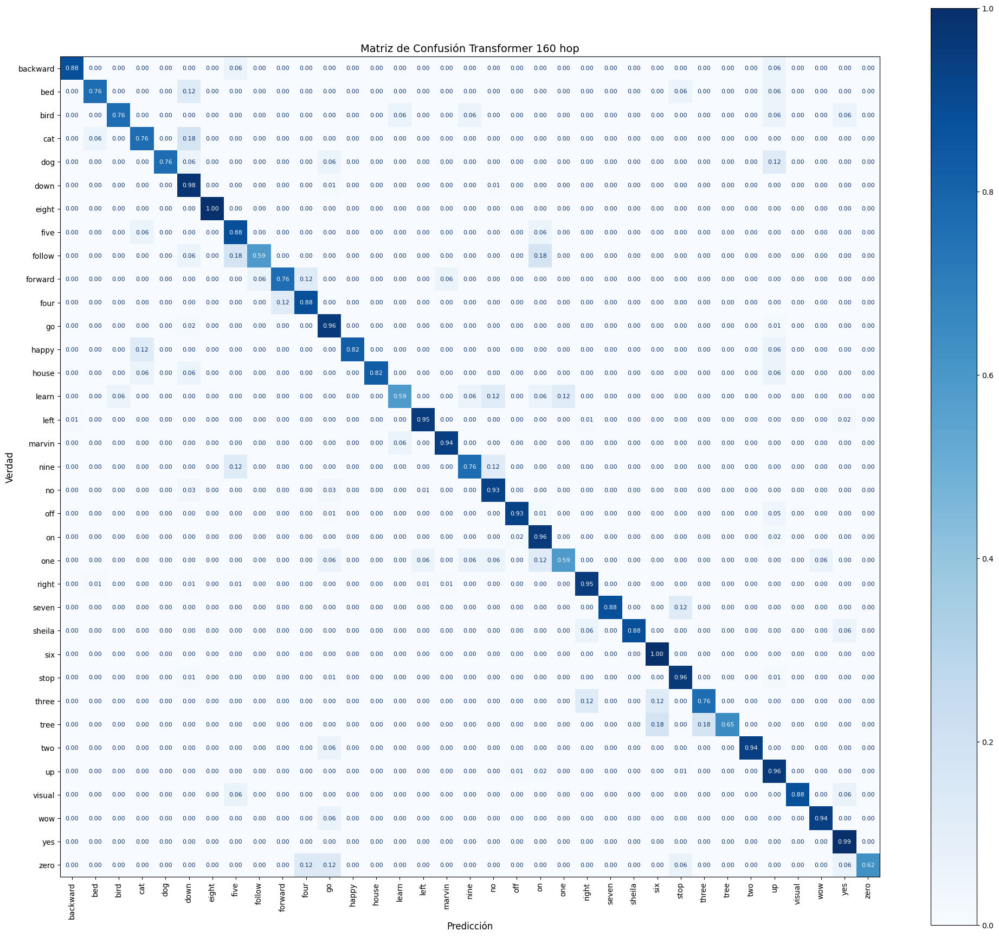

              precision    recall  f1-score   support

    backward       0.88      0.88      0.88        17
         bed       0.72      0.76      0.74        17
        bird       0.76      0.76      0.76        17
         cat       0.68      0.76      0.72        17
         dog       0.93      0.76      0.84        17
        down       0.92      0.98      0.95       396
       eight       0.94      1.00      0.97        17
        five       0.62      0.88      0.73        17
      follow       0.91      0.59      0.71        17
     forward       0.81      0.76      0.79        17
        four       0.75      0.88      0.81        17
          go       0.93      0.96      0.95       396
       happy       1.00      0.82      0.90        17
       house       1.00      0.82      0.90        17
       learn       0.67      0.59      0.62        17
        left       0.98      0.95      0.97       396
      marvin       0.84      0.94      0.89        17
        nine       0.76    

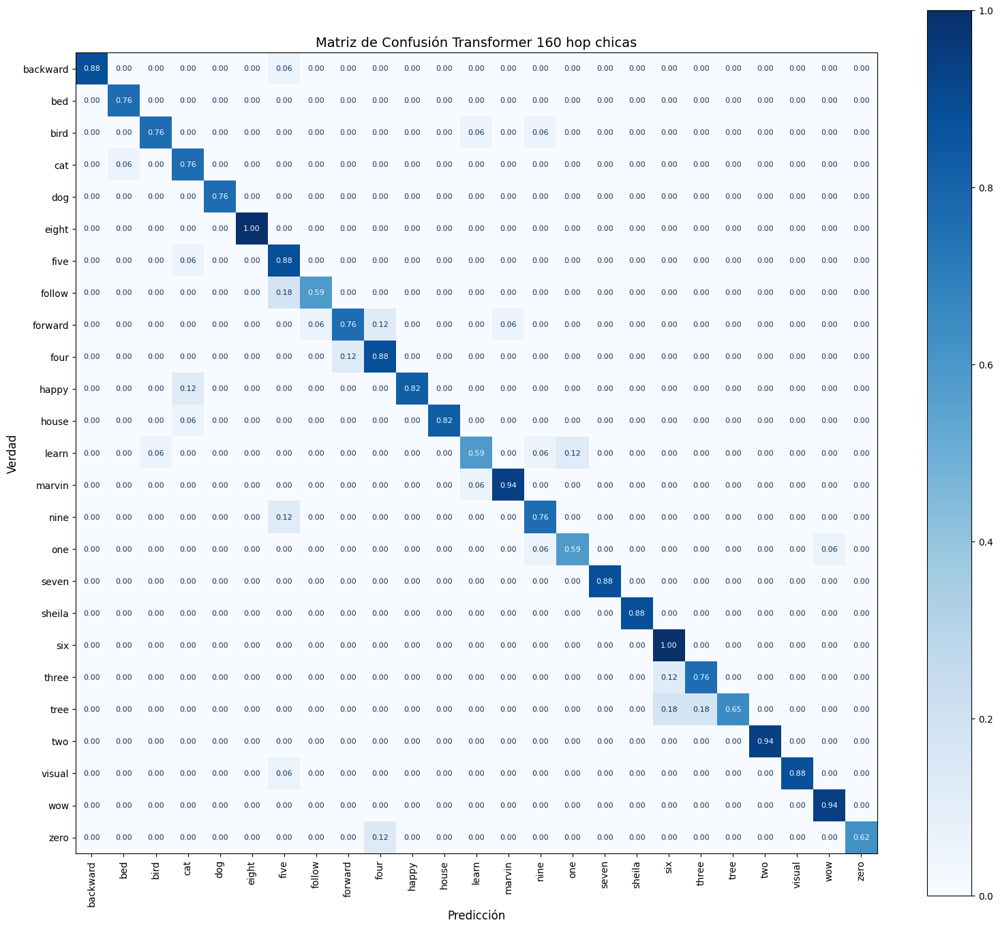

              precision    recall  f1-score   support

    backward       1.00      0.94      0.97        16
         bed       0.93      1.00      0.96        13
        bird       0.93      0.87      0.90        15
         cat       0.76      0.93      0.84        14
         dog       1.00      1.00      1.00        13
       eight       1.00      1.00      1.00        17
        five       0.68      0.94      0.79        16
      follow       0.91      0.77      0.83        13
     forward       0.87      0.76      0.81        17
        four       0.79      0.88      0.83        17
       happy       1.00      0.88      0.93        16
       house       1.00      0.93      0.97        15
       learn       0.83      0.71      0.77        14
      marvin       0.94      0.94      0.94        17
        nine       0.81      0.87      0.84        15
         one       0.83      0.83      0.83        12
       seven       1.00      1.00      1.00        15
      sheila       1.00    

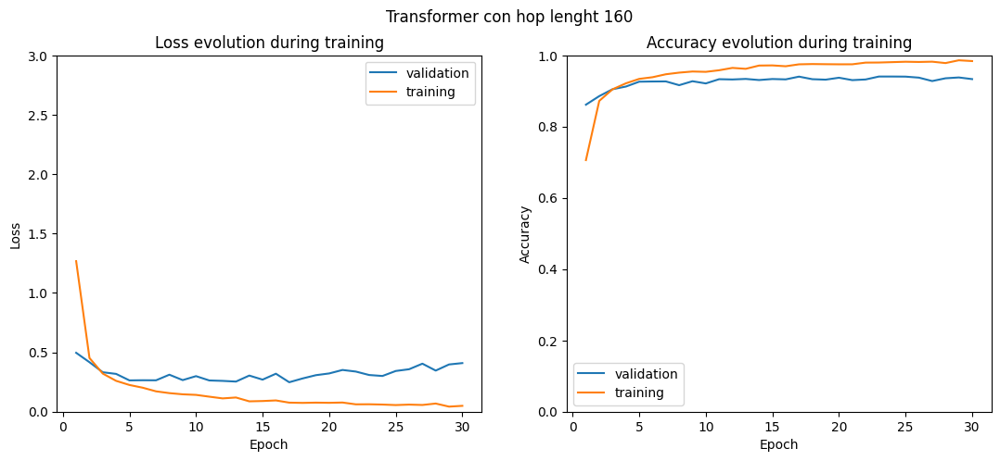

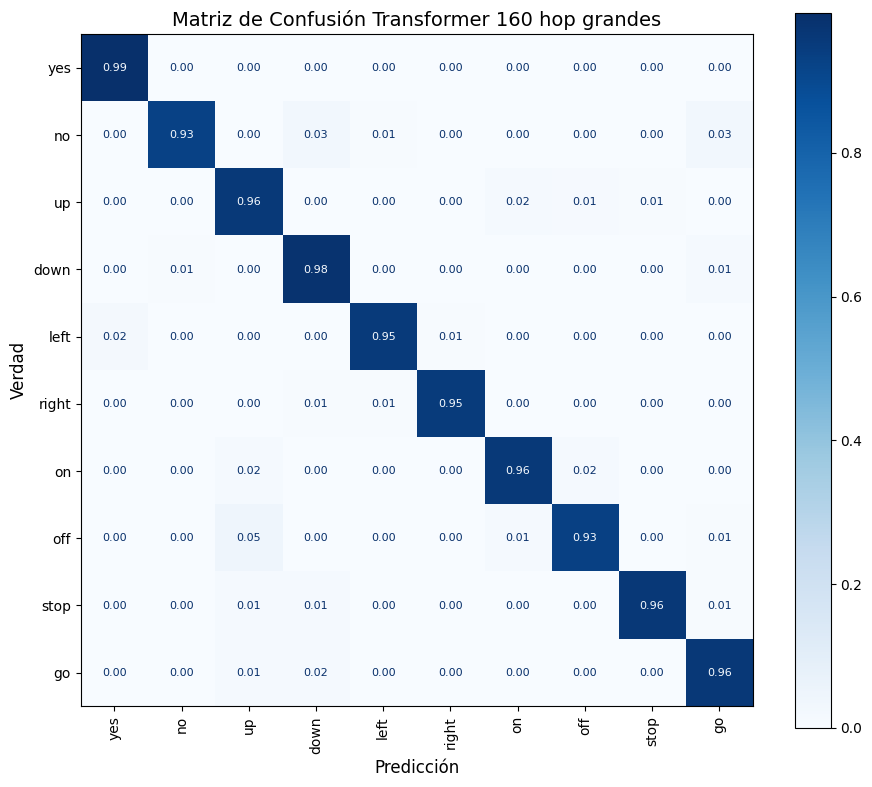

              precision    recall  f1-score   support

         yes       0.98      0.99      0.98       396
          no       0.99      0.93      0.96       394
          up       0.91      0.96      0.94       395
        down       0.93      0.98      0.96       396
        left       0.98      0.96      0.97       392
       right       0.99      0.98      0.99       385
          on       0.96      0.96      0.96       394
         off       0.97      0.93      0.95       395
        stop       0.99      0.97      0.98       393
          go       0.94      0.96      0.95       395

    accuracy                           0.96      3935
   macro avg       0.97      0.96      0.96      3935
weighted avg       0.96      0.96      0.96      3935

Precisión global (Accuracy): 0.9642
📁 Métricas guardadas en: metricas_Transformer_160_hop_grandes.json

========== Iteración 2/3 ==========
Epoch 1/40


/usr/local/lib/python3.12/dist-packages/torch/nn/modules/transformer.py:392: UserWarning: enable_nested_tensor is True, but self.use_nested_tensor is False because encoder_layer.norm_first was True
  warnings.warn(


Iteration 84 - Batch 84/508 - Train loss: 3.2079, Train acc: 38.47%
Iteration 168 - Batch 168/508 - Train loss: 2.1831, Train acc: 54.01%
Iteration 252 - Batch 252/508 - Train loss: 1.7397, Train acc: 61.46%
Iteration 336 - Batch 336/508 - Train loss: 1.4894, Train acc: 66.08%
Iteration 420 - Batch 420/508 - Train loss: 1.3189, Train acc: 69.33%
Iteration 504 - Batch 504/508 - Train loss: 1.1958, Train acc: 71.70%
Val loss: 0.5041, Val acc: 85.19%
Epoch 2/40
Iteration 592 - Batch 84/508 - Train loss: 0.5217, Train acc: 85.11%
Iteration 676 - Batch 168/508 - Train loss: 0.4747, Train acc: 86.55%
Iteration 760 - Batch 252/508 - Train loss: 0.4605, Train acc: 86.91%
Iteration 844 - Batch 336/508 - Train loss: 0.4524, Train acc: 86.99%
Iteration 928 - Batch 420/508 - Train loss: 0.4374, Train acc: 87.41%
Iteration 1012 - Batch 504/508 - Train loss: 0.4248, Train acc: 87.68%
Val loss: 0.3703, Val acc: 88.65%
Epoch 3/40
Iteration 1100 - Batch 84/508 - Train loss: 0.3177, Train acc: 90.33%
It

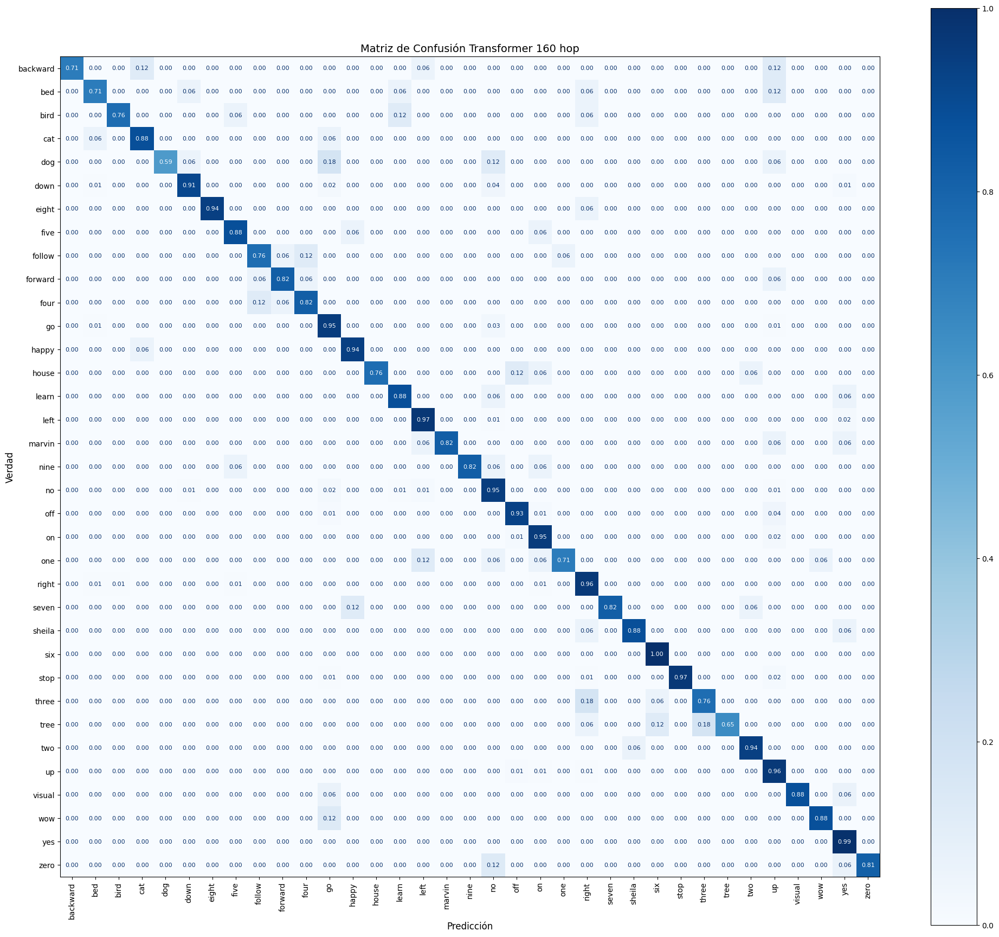

              precision    recall  f1-score   support

    backward       1.00      0.71      0.83        17
         bed       0.60      0.71      0.65        17
        bird       0.87      0.76      0.81        17
         cat       0.75      0.88      0.81        17
         dog       1.00      0.59      0.74        17
        down       0.98      0.91      0.94       396
       eight       0.94      0.94      0.94        17
        five       0.75      0.88      0.81        17
      follow       0.76      0.76      0.76        17
     forward       0.82      0.82      0.82        17
        four       0.82      0.82      0.82        17
          go       0.92      0.95      0.93       396
       happy       0.76      0.94      0.84        17
       house       1.00      0.76      0.87        17
       learn       0.68      0.88      0.77        17
        left       0.97      0.97      0.97       396
      marvin       1.00      0.82      0.90        17
        nine       0.93    

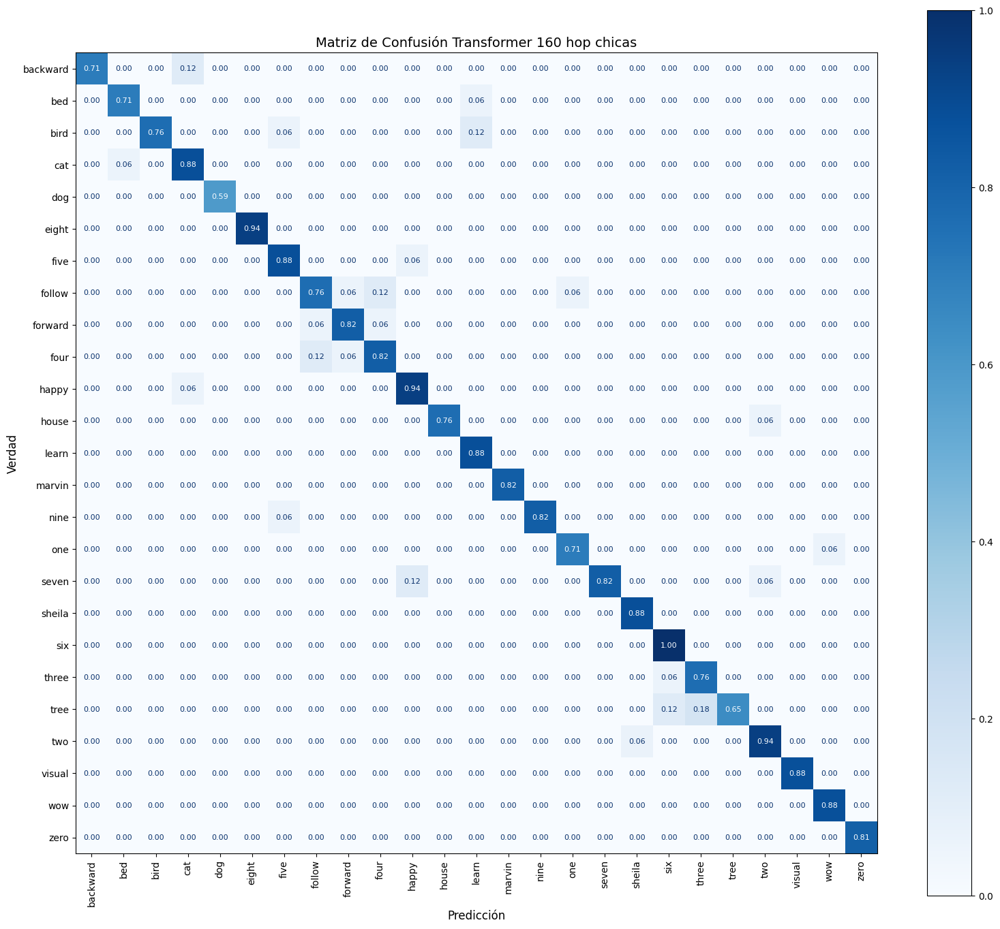

              precision    recall  f1-score   support

    backward       1.00      0.86      0.92        14
         bed       0.92      0.92      0.92        13
        bird       1.00      0.81      0.90        16
         cat       0.83      0.94      0.88        16
         dog       1.00      1.00      1.00        10
       eight       1.00      1.00      1.00        16
        five       0.88      0.94      0.91        16
      follow       0.81      0.76      0.79        17
     forward       0.88      0.88      0.88        16
        four       0.82      0.82      0.82        17
       happy       0.84      0.94      0.89        17
       house       1.00      0.93      0.96        14
       learn       0.83      1.00      0.91        15
      marvin       1.00      1.00      1.00        14
        nine       1.00      0.93      0.97        15
         one       0.92      0.92      0.92        13
       seven       1.00      0.82      0.90        17
      sheila       0.94    

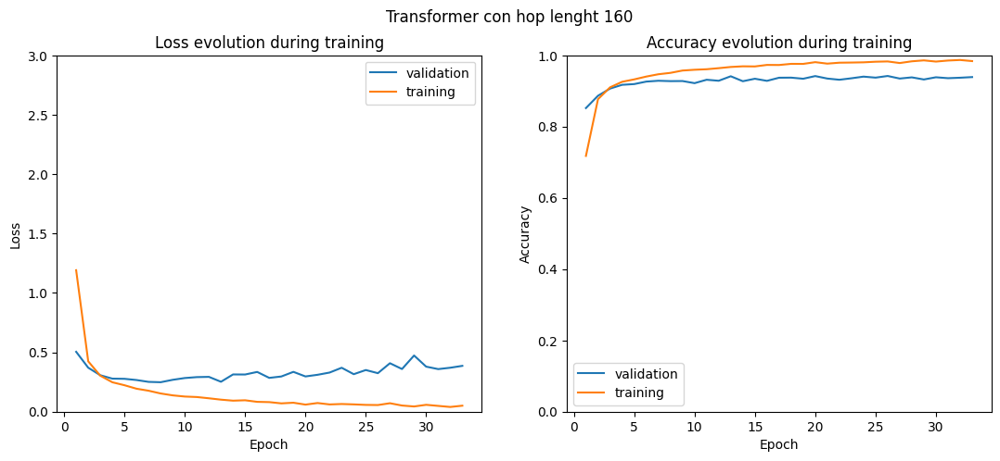

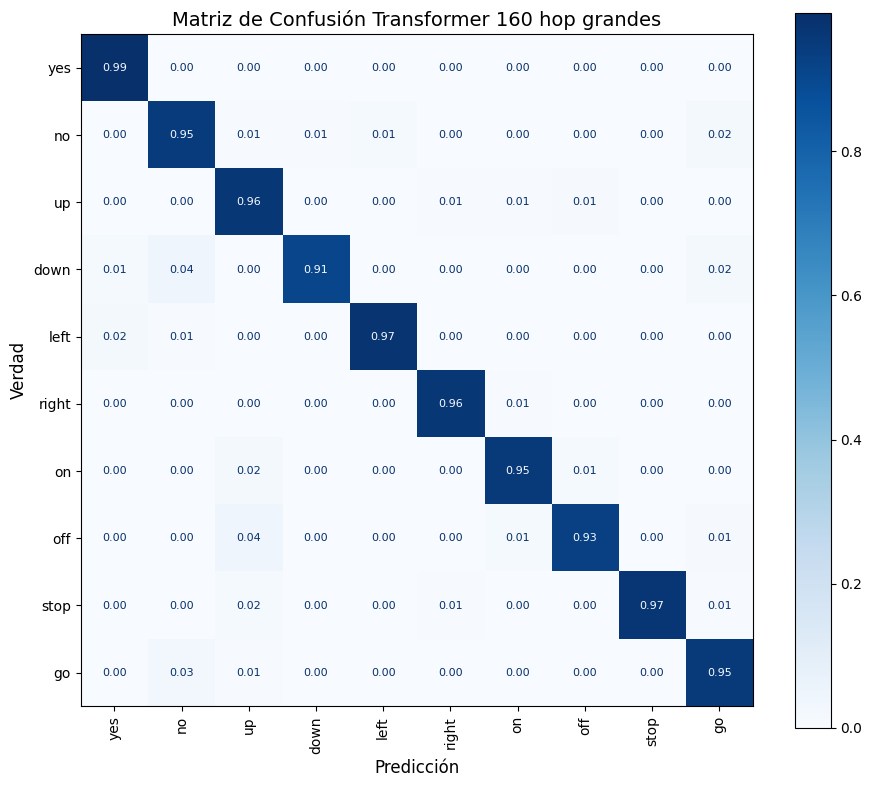

              precision    recall  f1-score   support

         yes       0.97      1.00      0.98       394
          no       0.92      0.95      0.94       393
          up       0.91      0.97      0.94       395
        down       0.99      0.92      0.95       392
        left       0.98      0.97      0.98       395
       right       0.98      0.98      0.98       388
          on       0.97      0.96      0.97       393
         off       0.97      0.93      0.95       396
        stop       0.99      0.97      0.98       395
          go       0.93      0.96      0.95       392

    accuracy                           0.96      3933
   macro avg       0.96      0.96      0.96      3933
weighted avg       0.96      0.96      0.96      3933

Precisión global (Accuracy): 0.9614
📁 Métricas guardadas en: metricas_Transformer_160_hop_grandes.json

========== Iteración 3/3 ==========
Epoch 1/40


/usr/local/lib/python3.12/dist-packages/torch/nn/modules/transformer.py:392: UserWarning: enable_nested_tensor is True, but self.use_nested_tensor is False because encoder_layer.norm_first was True
  warnings.warn(


Iteration 84 - Batch 84/508 - Train loss: 2.9517, Train acc: 40.28%
Iteration 168 - Batch 168/508 - Train loss: 2.0871, Train acc: 54.09%
Iteration 252 - Batch 252/508 - Train loss: 1.7127, Train acc: 60.55%
Iteration 336 - Batch 336/508 - Train loss: 1.4826, Train acc: 64.88%
Iteration 420 - Batch 420/508 - Train loss: 1.3224, Train acc: 68.12%
Iteration 504 - Batch 504/508 - Train loss: 1.2050, Train acc: 70.52%
Val loss: 0.5350, Val acc: 84.59%
Epoch 2/40
Iteration 592 - Batch 84/508 - Train loss: 0.5600, Train acc: 84.15%
Iteration 676 - Batch 168/508 - Train loss: 0.5236, Train acc: 84.95%
Iteration 760 - Batch 252/508 - Train loss: 0.4995, Train acc: 85.67%
Iteration 844 - Batch 336/508 - Train loss: 0.4817, Train acc: 86.11%
Iteration 928 - Batch 420/508 - Train loss: 0.4694, Train acc: 86.45%
Iteration 1012 - Batch 504/508 - Train loss: 0.4561, Train acc: 86.85%
Val loss: 0.4257, Val acc: 88.70%
Epoch 3/40
Iteration 1100 - Batch 84/508 - Train loss: 0.3282, Train acc: 90.51%
It

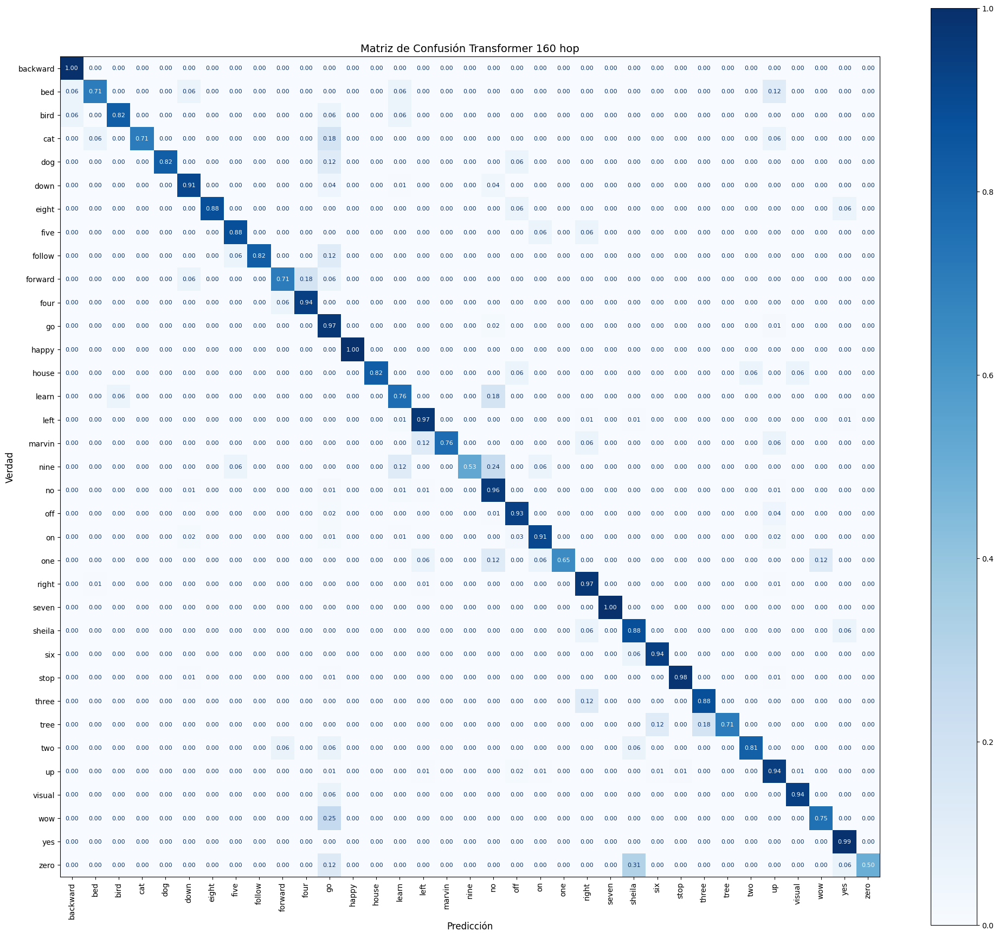

              precision    recall  f1-score   support

    backward       0.89      1.00      0.94        17
         bed       0.80      0.71      0.75        17
        bird       0.78      0.82      0.80        17
         cat       1.00      0.71      0.83        17
         dog       0.93      0.82      0.88        17
        down       0.96      0.91      0.93       396
       eight       1.00      0.88      0.94        17
        five       0.88      0.88      0.88        17
      follow       1.00      0.82      0.90        17
     forward       0.80      0.71      0.75        17
        four       0.84      0.94      0.89        17
          go       0.87      0.97      0.92       396
       happy       0.94      1.00      0.97        17
       house       1.00      0.82      0.90        17
       learn       0.38      0.76      0.51        17
        left       0.97      0.97      0.97       396
      marvin       1.00      0.76      0.87        17
        nine       1.00    

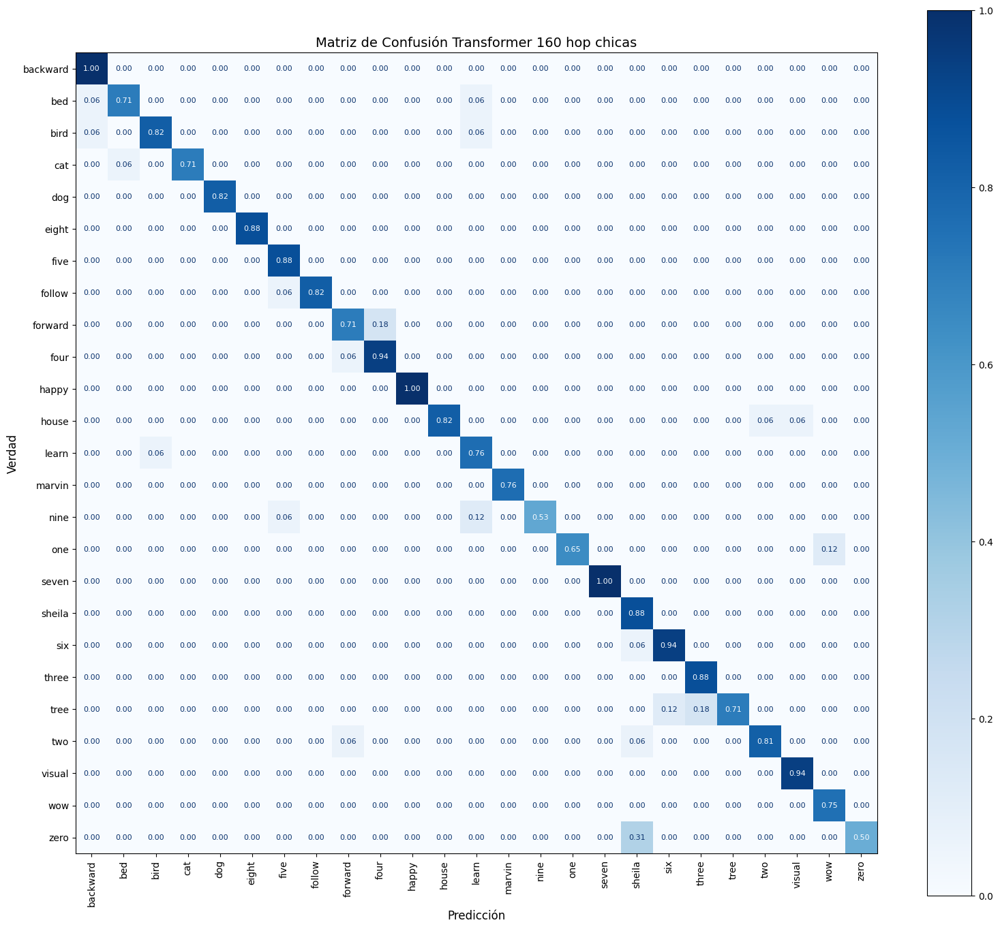

              precision    recall  f1-score   support

    backward       0.89      1.00      0.94        17
         bed       0.92      0.86      0.89        14
        bird       0.93      0.88      0.90        16
         cat       1.00      0.92      0.96        13
         dog       1.00      1.00      1.00        14
       eight       1.00      1.00      1.00        15
        five       0.88      1.00      0.94        15
      follow       1.00      0.93      0.97        15
     forward       0.86      0.80      0.83        15
        four       0.84      0.94      0.89        17
       happy       1.00      1.00      1.00        17
       house       1.00      0.88      0.93        16
       learn       0.76      0.93      0.84        14
      marvin       1.00      1.00      1.00        13
        nine       1.00      0.75      0.86        12
         one       1.00      0.85      0.92        13
       seven       1.00      1.00      1.00        17
      sheila       0.68    

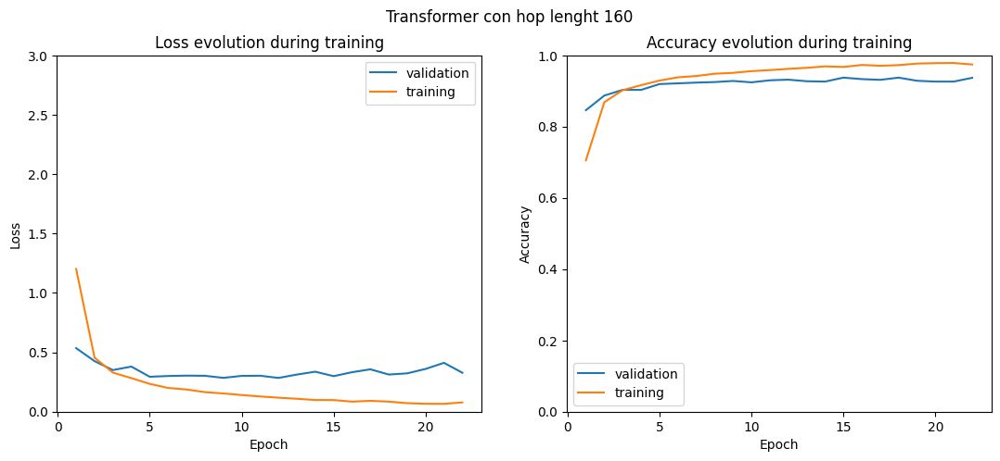

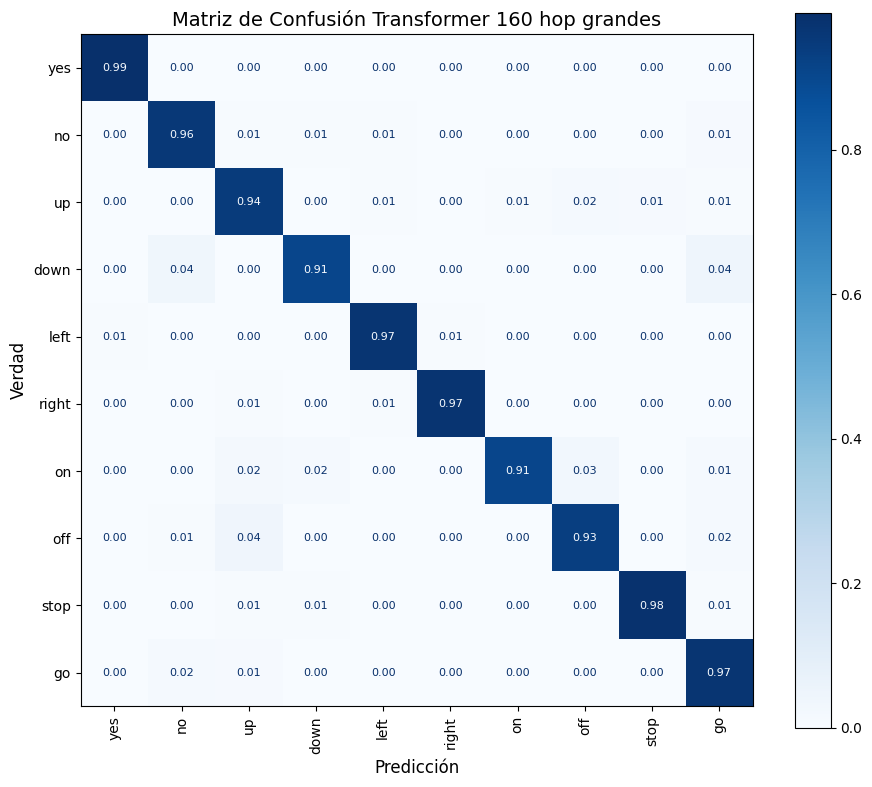

              precision    recall  f1-score   support

         yes       0.99      0.99      0.99       395
          no       0.94      0.97      0.96       391
          up       0.92      0.96      0.94       391
        down       0.97      0.92      0.94       391
        left       0.97      0.99      0.98       389
       right       0.99      0.98      0.99       392
          on       0.99      0.92      0.95       392
         off       0.96      0.93      0.95       396
        stop       0.98      0.98      0.98       395
          go       0.91      0.97      0.94       395

    accuracy                           0.96      3927
   macro avg       0.96      0.96      0.96      3927
weighted avg       0.96      0.96      0.96      3927

Precisión global (Accuracy): 0.9610
📁 Métricas guardadas en: metricas_Transformer_160_hop_grandes.json

========== Iteración 4/3 ==========
Epoch 1/40


/usr/local/lib/python3.12/dist-packages/torch/nn/modules/transformer.py:392: UserWarning: enable_nested_tensor is True, but self.use_nested_tensor is False because encoder_layer.norm_first was True
  warnings.warn(


Iteration 84 - Batch 84/508 - Train loss: 2.9661, Train acc: 37.92%
Iteration 168 - Batch 168/508 - Train loss: 2.1099, Train acc: 52.96%
Iteration 252 - Batch 252/508 - Train loss: 1.7202, Train acc: 60.04%
Iteration 336 - Batch 336/508 - Train loss: 1.4776, Train acc: 64.97%
Iteration 420 - Batch 420/508 - Train loss: 1.3189, Train acc: 68.16%
Iteration 504 - Batch 504/508 - Train loss: 1.1990, Train acc: 70.56%
Val loss: 0.5646, Val acc: 84.46%
Epoch 2/40
Iteration 592 - Batch 84/508 - Train loss: 0.5153, Train acc: 84.76%
Iteration 676 - Batch 168/508 - Train loss: 0.5001, Train acc: 85.52%
Iteration 760 - Batch 252/508 - Train loss: 0.4957, Train acc: 85.73%
Iteration 844 - Batch 336/508 - Train loss: 0.4800, Train acc: 86.22%
Iteration 928 - Batch 420/508 - Train loss: 0.4657, Train acc: 86.64%
Iteration 1012 - Batch 504/508 - Train loss: 0.4502, Train acc: 87.04%
Val loss: 0.4165, Val acc: 88.18%
Epoch 3/40
Iteration 1100 - Batch 84/508 - Train loss: 0.3536, Train acc: 89.83%
It

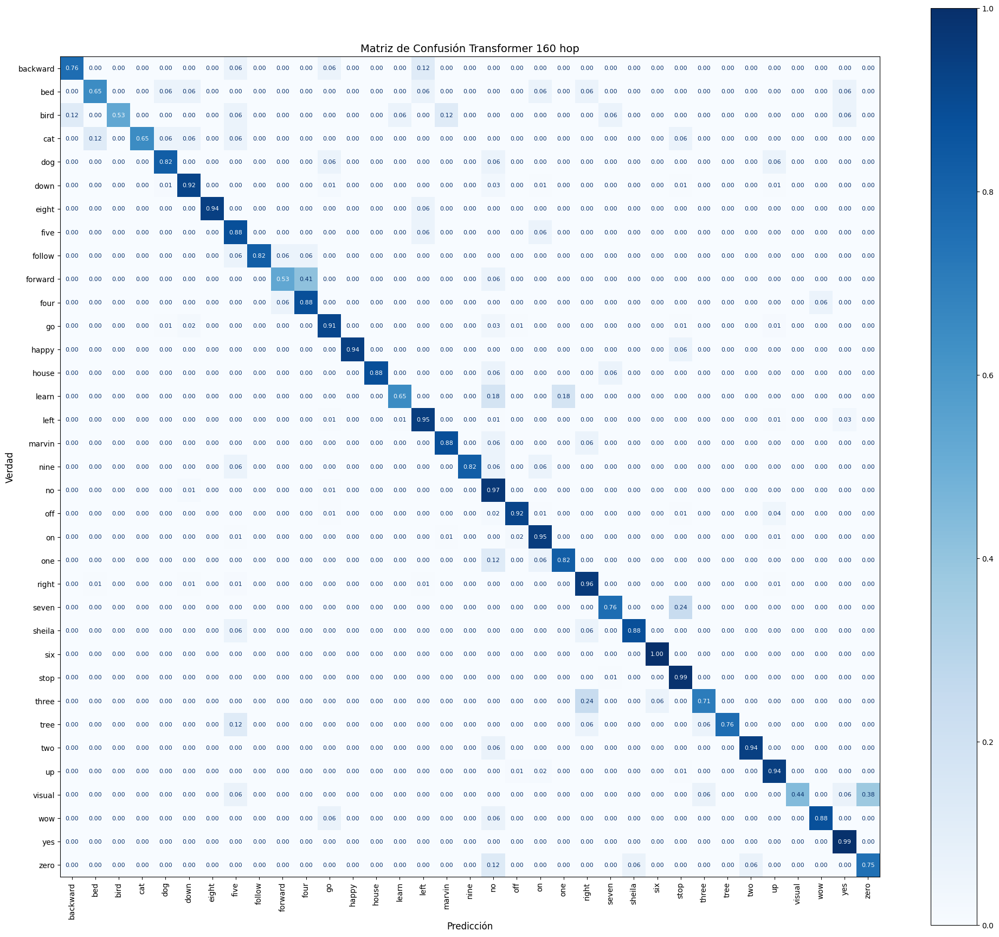

              precision    recall  f1-score   support

    backward       0.81      0.76      0.79        17
         bed       0.69      0.65      0.67        17
        bird       1.00      0.53      0.69        17
         cat       0.79      0.65      0.71        17
         dog       0.54      0.82      0.65        17
        down       0.96      0.92      0.94       396
       eight       1.00      0.94      0.97        17
        five       0.50      0.88      0.64        17
      follow       0.93      0.82      0.88        17
     forward       0.82      0.53      0.64        17
        four       0.62      0.88      0.73        17
          go       0.96      0.91      0.93       396
       happy       0.94      0.94      0.94        17
       house       0.94      0.88      0.91        17
       learn       0.73      0.65      0.69        17
        left       0.97      0.95      0.96       396
      marvin       0.71      0.88      0.79        17
        nine       0.88    

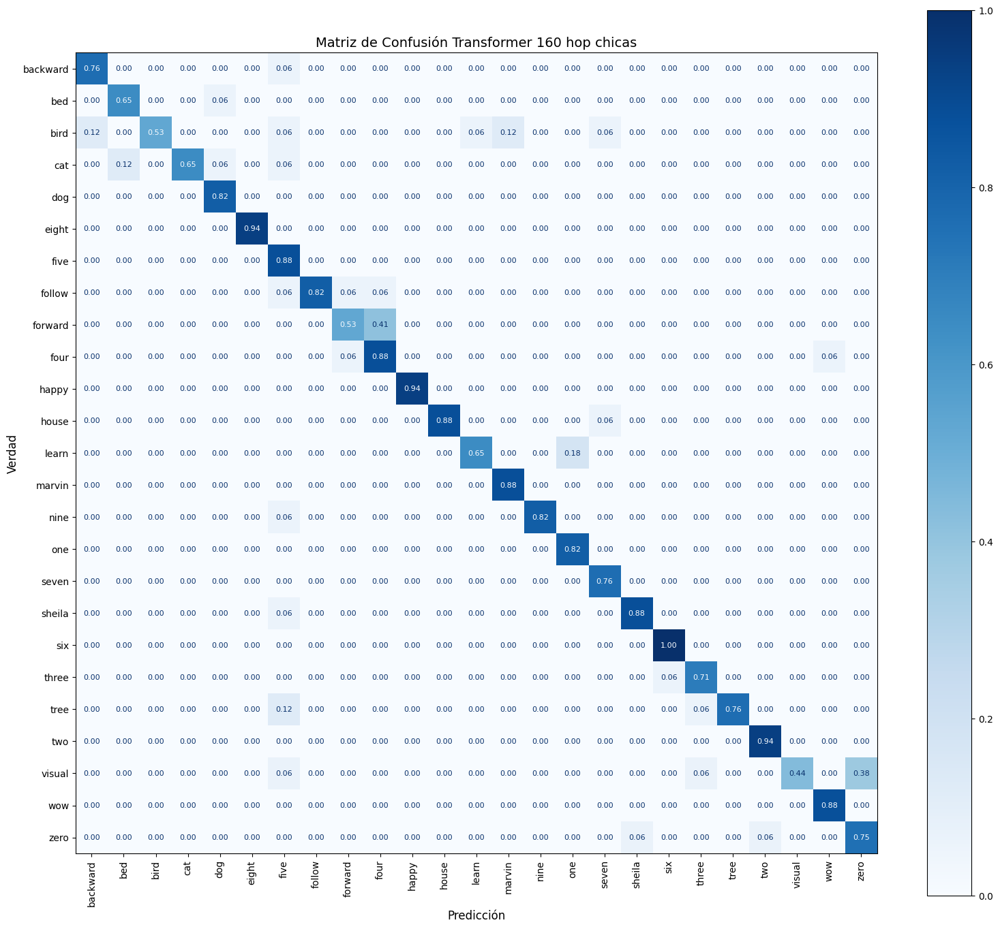

              precision    recall  f1-score   support

    backward       0.87      0.93      0.90        14
         bed       0.85      0.92      0.88        12
        bird       1.00      0.56      0.72        16
         cat       1.00      0.73      0.85        15
         dog       0.88      1.00      0.93        14
       eight       1.00      1.00      1.00        16
        five       0.62      1.00      0.77        15
      follow       1.00      0.82      0.90        17
     forward       0.82      0.56      0.67        16
        four       0.65      0.88      0.75        17
       happy       1.00      1.00      1.00        16
       house       1.00      0.94      0.97        16
       learn       0.92      0.79      0.85        14
      marvin       0.88      1.00      0.94        15
        nine       1.00      0.93      0.97        15
         one       0.82      1.00      0.90        14
       seven       0.87      1.00      0.93        13
      sheila       0.94    

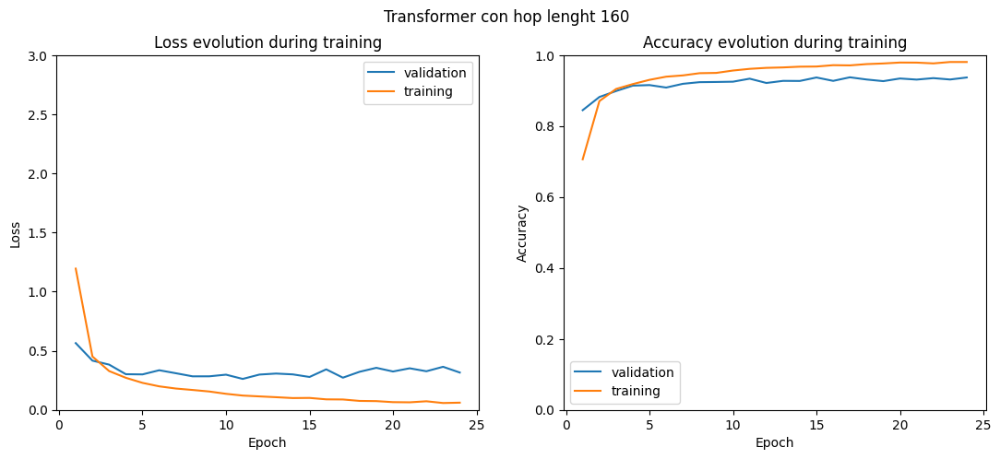

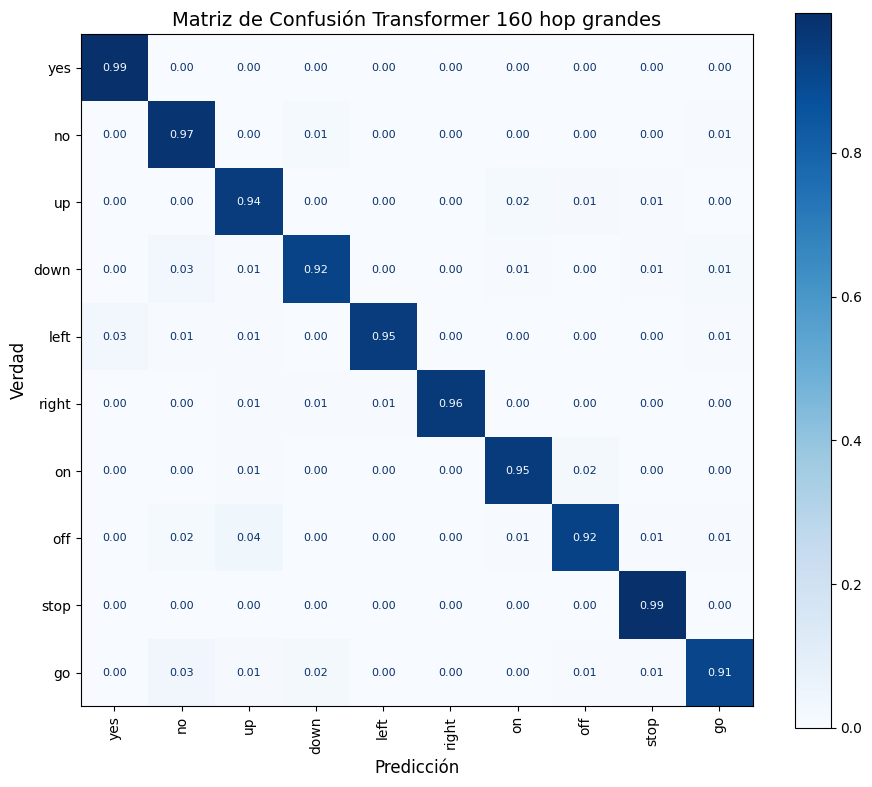

              precision    recall  f1-score   support

         yes       0.97      1.00      0.98       394
          no       0.92      0.98      0.95       394
          up       0.93      0.96      0.94       390
        down       0.96      0.94      0.95       388
        left       0.99      0.95      0.97       394
       right       1.00      0.97      0.99       389
          on       0.97      0.96      0.97       390
         off       0.96      0.93      0.95       393
        stop       0.97      1.00      0.98       393
          go       0.96      0.93      0.94       390

    accuracy                           0.96      3915
   macro avg       0.96      0.96      0.96      3915
weighted avg       0.96      0.96      0.96      3915

Precisión global (Accuracy): 0.9617
📁 Métricas guardadas en: metricas_Transformer_160_hop_grandes.json

========== Iteración 5/3 ==========
Epoch 1/40


/usr/local/lib/python3.12/dist-packages/torch/nn/modules/transformer.py:392: UserWarning: enable_nested_tensor is True, but self.use_nested_tensor is False because encoder_layer.norm_first was True
  warnings.warn(


Iteration 84 - Batch 84/508 - Train loss: 3.5316, Train acc: 32.79%
Iteration 168 - Batch 168/508 - Train loss: 2.4133, Train acc: 49.71%
Iteration 252 - Batch 252/508 - Train loss: 1.9224, Train acc: 58.14%
Iteration 336 - Batch 336/508 - Train loss: 1.6366, Train acc: 63.30%
Iteration 420 - Batch 420/508 - Train loss: 1.4465, Train acc: 66.82%
Iteration 504 - Batch 504/508 - Train loss: 1.3069, Train acc: 69.57%
Val loss: 0.6263, Val acc: 81.91%
Epoch 2/40
Iteration 592 - Batch 84/508 - Train loss: 0.5551, Train acc: 85.02%
Iteration 676 - Batch 168/508 - Train loss: 0.5166, Train acc: 85.61%
Iteration 760 - Batch 252/508 - Train loss: 0.5092, Train acc: 85.84%
Iteration 844 - Batch 336/508 - Train loss: 0.4856, Train acc: 86.54%
Iteration 928 - Batch 420/508 - Train loss: 0.4660, Train acc: 86.92%
Iteration 1012 - Batch 504/508 - Train loss: 0.4524, Train acc: 87.25%
Val loss: 0.4334, Val acc: 87.56%
Epoch 3/40
Iteration 1100 - Batch 84/508 - Train loss: 0.3518, Train acc: 89.19%
It

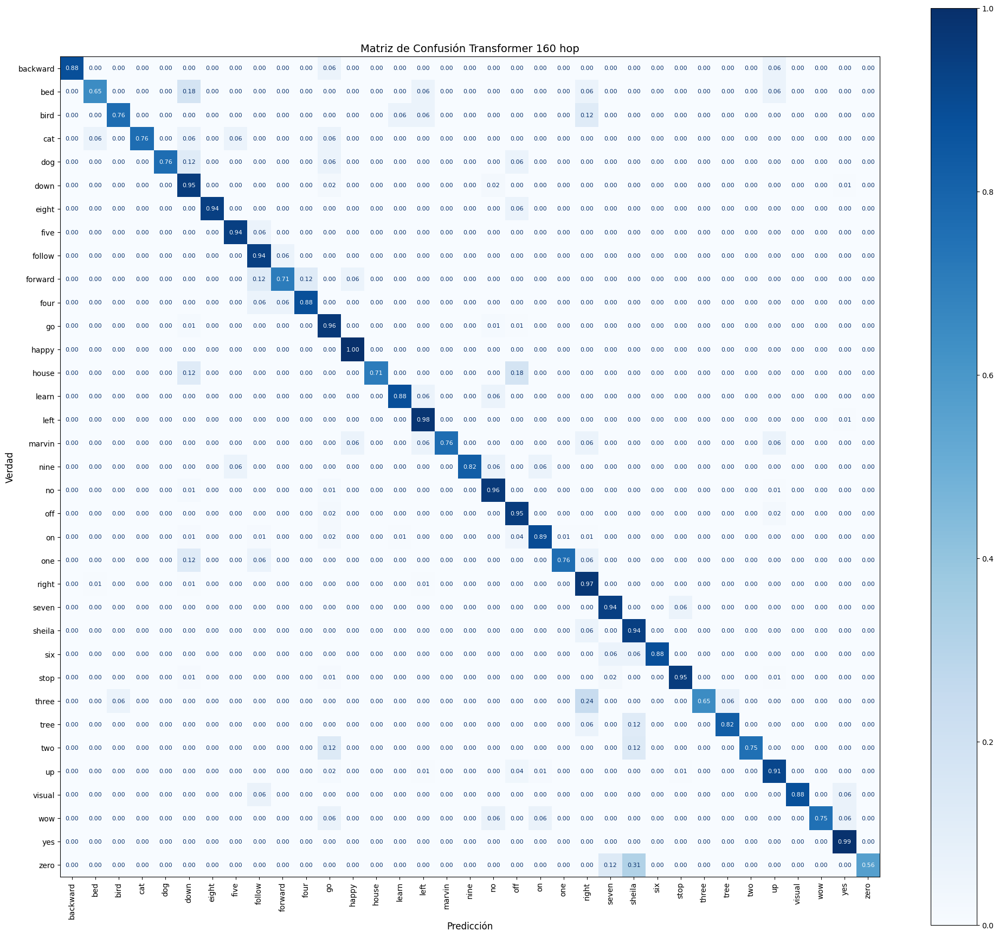

              precision    recall  f1-score   support

    backward       1.00      0.88      0.94        17
         bed       0.65      0.65      0.65        17
        bird       0.81      0.76      0.79        17
         cat       1.00      0.76      0.87        17
         dog       0.93      0.76      0.84        17
        down       0.92      0.95      0.94       396
       eight       0.94      0.94      0.94        17
        five       0.84      0.94      0.89        17
      follow       0.59      0.94      0.73        17
     forward       0.86      0.71      0.77        17
        four       0.88      0.88      0.88        17
          go       0.89      0.96      0.92       396
       happy       0.85      1.00      0.92        17
       house       1.00      0.71      0.83        17
       learn       0.71      0.88      0.79        17
        left       0.96      0.98      0.97       396
      marvin       1.00      0.76      0.87        17
        nine       0.88    

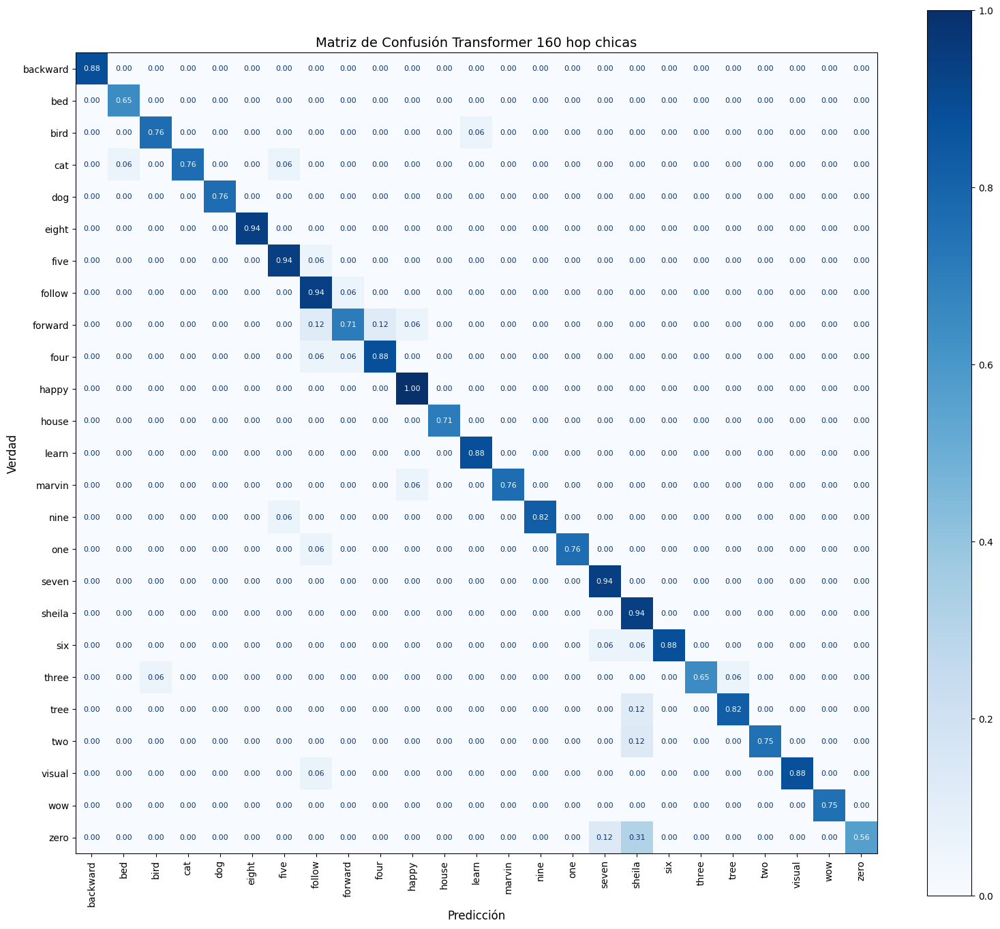

              precision    recall  f1-score   support

    backward       1.00      1.00      1.00        15
         bed       0.92      1.00      0.96        11
        bird       0.93      0.93      0.93        14
         cat       1.00      0.87      0.93        15
         dog       1.00      1.00      1.00        13
       eight       1.00      1.00      1.00        16
        five       0.89      0.94      0.91        17
      follow       0.73      0.94      0.82        17
     forward       0.86      0.71      0.77        17
        four       0.88      0.88      0.88        17
       happy       0.89      1.00      0.94        17
       house       1.00      1.00      1.00        12
       learn       0.94      1.00      0.97        15
      marvin       1.00      0.93      0.96        14
        nine       1.00      0.93      0.97        15
         one       1.00      0.93      0.96        14
       seven       0.84      1.00      0.91        16
      sheila       0.62    

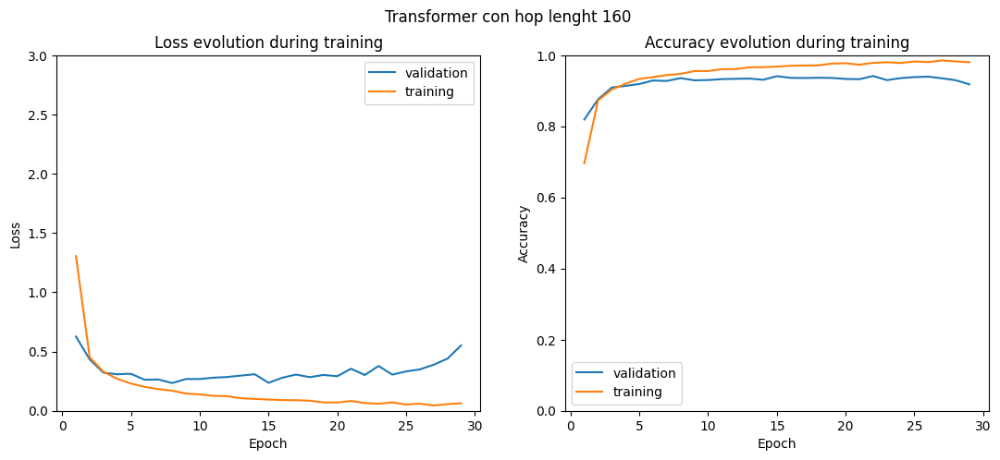

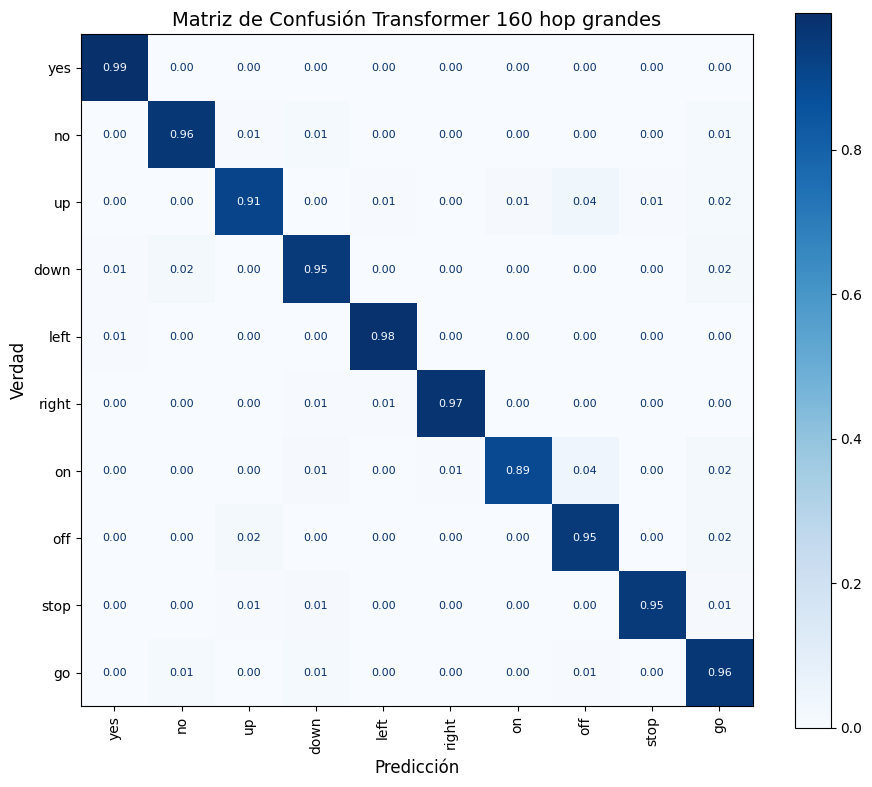

              precision    recall  f1-score   support

         yes       0.99      0.99      0.99       395
          no       0.96      0.97      0.96       393
          up       0.97      0.92      0.94       393
        down       0.95      0.95      0.95       394
        left       0.97      0.98      0.98       394
       right       0.99      0.98      0.99       390
          on       0.98      0.91      0.95       386
         off       0.92      0.95      0.93       395
        stop       0.99      0.97      0.98       389
          go       0.90      0.96      0.93       396

    accuracy                           0.96      3925
   macro avg       0.96      0.96      0.96      3925
weighted avg       0.96      0.96      0.96      3925

Precisión global (Accuracy): 0.9603
📁 Métricas guardadas en: metricas_Transformer_160_hop_grandes.json

===== Resultados finales =====
Precisión promedio (5 runs): 93.95% ± 0.29%
Modelo final guardado


In [ ]:
device = "cuda" if torch.cuda.is_available() else "cpu"

# Datos y clases
train_dl, val_dl, test_dl = load2(MFCC_train_10, MFCC_val_10, MFCC_test_10, batch_size=64)

# Función para obtener predicciones
@torch.no_grad()
def get_predictions(loader, model, device="cpu"):
    model = model.to(device)
    model.eval()
    all_predictions, all_true_labels = [], []
    for xb, yb in loader:
        xb, yb = xb.to(device), yb.to(device)
        pred = model(xb).argmax(1)
        all_predictions.extend(pred.cpu().numpy())
        all_true_labels.extend(yb.cpu().numpy())
    return np.array(all_true_labels), np.array(all_predictions)

# Loop de 5 iteraciones
accuracies = []

for i in range(5):
    print(f"\n========== Iteración {i+1}/3 ==========")

    model = AudioTransformer(
        input_dim=39,
        nhead=4,
        num_layers=2,
        embed_dim=64,
        num_classes=35).to(device)

    criterion = nn.CrossEntropyLoss()

    curves = train_model(
        model, train_dl, val_dl,
        epochs=40, lr=1e-3,
        criterion=criterion,
        device=device,
        early_stopping_patience=7
    )

    true_labels, predictions = get_predictions(test_dl, model, device)
    acc = (predictions == true_labels).mean() * 100
    accuracies.append(acc)
    print(f"✅ Precisión iteración {i+1}: {acc:.2f}%")
    modelo = "Transformer"
    hop = 160
    # Matriz de confusión del último modelo entrenado
    show_confusion_matrix(
        true_labels, predictions,
        clases_10,
        title=f"Matriz de Confusión {modelo} {hop} hop",
        filename=f"matriz_confusion_{modelo}_{hop}_hop.png",
        metrics_filename=f"metricas_{modelo}_{hop}_hop.json"
    )

    # Matriz de confusión del último modelo entrenado
    show_confusion_matrix(
        true_labels, predictions,
        clases_10,
        title=f"Matriz de Confusión {modelo} {hop} hop chicas",
        filename=f"matriz_confusion_{modelo}_{hop}_hop_chicas.png",
        selected_classes = clases_chicas,
        metrics_filename=f"metricas_{modelo}_{hop}_hop_chicas.json"
    )
    show_curves(curves, title=f"{modelo} con hop lenght {hop}" , filename=f"Curva_{modelo}_{hop}_hop.png")

    # Matriz de confusión del último modelo entrenado
    show_confusion_matrix(
        true_labels, predictions,
        clases_10,
        title=f"Matriz de Confusión {modelo} {hop} hop grandes",
        filename=f"matriz_confusion_{modelo}_{hop}_hop_grandes.png",
        selected_classes = clases_grandes,
        metrics_filename=f"metricas_{modelo}_{hop}_hop_grandes.json"
    )

# Promedio y desviación estándar
mean_acc = np.mean(accuracies)
std_acc = np.std(accuracies)

print("\n===== Resultados finales =====")
print(f"Precisión promedio (5 runs): {mean_acc:.2f}% ± {std_acc:.2f}%")

torch.save(model.state_dict(), "modelo_Grubid_160.pth")
print("Modelo final guardado")



In [ ]:
model_summary(model)
time_per_sample, total_time = measure_inference_time(model, test_dl, device)

print(f"⏱️ Tiempo promedio por muestra: {time_per_sample*1000:.3f} ms")
print(f"⏱️ Tiempo total sobre el test: {total_time:.2f} s")

📌 Parámetros entrenables: 569,379
📦 Tamaño aproximado en memoria: 2.17 MB
💾 Tamaño real del archivo .pth: 2.18 MB
⏱️ Tiempo promedio por muestra: 0.094 ms
⏱️ Tiempo total sobre el test: 0.41 s


##### RNN Atención

Se creó nueva función de train y de inferencia para modelo RNN atención al requerir tensores traspuestos de entrada.

In [ ]:
import time
import torch
import torch.nn as nn
import numpy as np

def train_model(model, train_dl, val_dl, epochs, lr, criterion, device="cpu",
                early_stopping_patience=7, print_every=84):

    start_time = time.time()   # ← empieza medición

    model = model.to(device)
    optimizer = torch.optim.Adam(model.parameters(), lr=lr)

    best_val_loss = float("inf")
    patience_counter = 0

    train_losses, val_losses = [], []
    train_accs, val_accs = [], []

    global_iter = 0

    for epoch in range(1, epochs + 1):
        model.train()
        running_loss = 0
        running_correct = 0
        running_total = 0

        print(f"\nEpoch {epoch}/{epochs}")

        for batch_idx, (xb, yb) in enumerate(train_dl, 1):
            xb = xb.to(device).transpose(1, 2)
            yb = yb.to(device)

            optimizer.zero_grad()
            logits = model(xb)
            loss = criterion(logits, yb)
            loss.backward()
            optimizer.step()

            pred = logits.argmax(1)
            running_correct += (pred == yb).sum().item()
            running_total += yb.size(0)
            running_loss += loss.item()

            global_iter += 1

            if batch_idx % print_every == 0 or batch_idx == len(train_dl):
                print(f"Iteration {global_iter} - Batch {batch_idx}/{len(train_dl)} - "
                      f"Train loss: {running_loss / batch_idx:.4f}, "
                      f"Train acc: {100 * running_correct / running_total:.2f}%")

        # ---- epoch train summary ----
        train_losses.append(running_loss / len(train_dl))
        train_accs.append(running_correct / running_total)

        # ---- VALIDATION ----
        model.eval()
        val_loss = 0
        val_correct = 0
        val_total = 0

        with torch.no_grad():
            for xb, yb in val_dl:
                xb = xb.to(device).transpose(1, 2)
                yb = yb.to(device)

                logits = model(xb)
                loss = criterion(logits, yb)

                pred = logits.argmax(1)
                val_correct += (pred == yb).sum().item()
                val_total += yb.size(0)
                val_loss += loss.item()

        avg_val_loss = val_loss / len(val_dl)
        avg_val_acc  = val_correct / val_total

        print(f"Val loss: {avg_val_loss:.4f}, Val acc: {100*avg_val_acc:.2f}%")

        val_losses.append(avg_val_loss)
        val_accs.append(avg_val_acc)

        # ---- EARLY STOPPING ----
        if avg_val_loss < best_val_loss:
            best_val_loss = avg_val_loss
            best_weights = model.state_dict()
            patience_counter = 0
        else:
            patience_counter += 1
            if patience_counter >= early_stopping_patience:
                print("⛔ Early Stopping activado")
                break

    # Restaurar mejores pesos
    model.load_state_dict(best_weights)

    end_time = time.time()
    total_time = end_time - start_time

    print(f"\n⏳ Tiempo total de entrenamiento: {total_time:.4f} [s]")

    return {
        "train_loss": train_losses,
        "val_loss": val_losses,
        "train_acc": train_accs,
        "val_acc": val_accs,
        "train_time_seconds": total_time
    }


{'backward': 0, 'bed': 1, 'bird': 2, 'cat': 3, 'dog': 4, 'down': 5, 'eight': 6, 'five': 7, 'follow': 8, 'forward': 9, 'four': 10, 'go': 11, 'happy': 12, 'house': 13, 'learn': 14, 'left': 15, 'marvin': 16, 'nine': 17, 'no': 18, 'off': 19, 'on': 20, 'one': 21, 'right': 22, 'seven': 23, 'sheila': 24, 'six': 25, 'stop': 26, 'three': 27, 'tree': 28, 'two': 29, 'up': 30, 'visual': 31, 'wow': 32, 'yes': 33, 'zero': 34}
{'backward': 0, 'bed': 1, 'bird': 2, 'cat': 3, 'dog': 4, 'down': 5, 'eight': 6, 'five': 7, 'follow': 8, 'forward': 9, 'four': 10, 'go': 11, 'happy': 12, 'house': 13, 'learn': 14, 'left': 15, 'marvin': 16, 'nine': 17, 'no': 18, 'off': 19, 'on': 20, 'one': 21, 'right': 22, 'seven': 23, 'sheila': 24, 'six': 25, 'stop': 26, 'three': 27, 'tree': 28, 'two': 29, 'up': 30, 'visual': 31, 'wow': 32, 'yes': 33, 'zero': 34}
{'backward': 0, 'bed': 1, 'bird': 2, 'cat': 3, 'dog': 4, 'down': 5, 'eight': 6, 'five': 7, 'follow': 8, 'forward': 9, 'four': 10, 'go': 11, 'happy': 12, 'house': 13, 'l

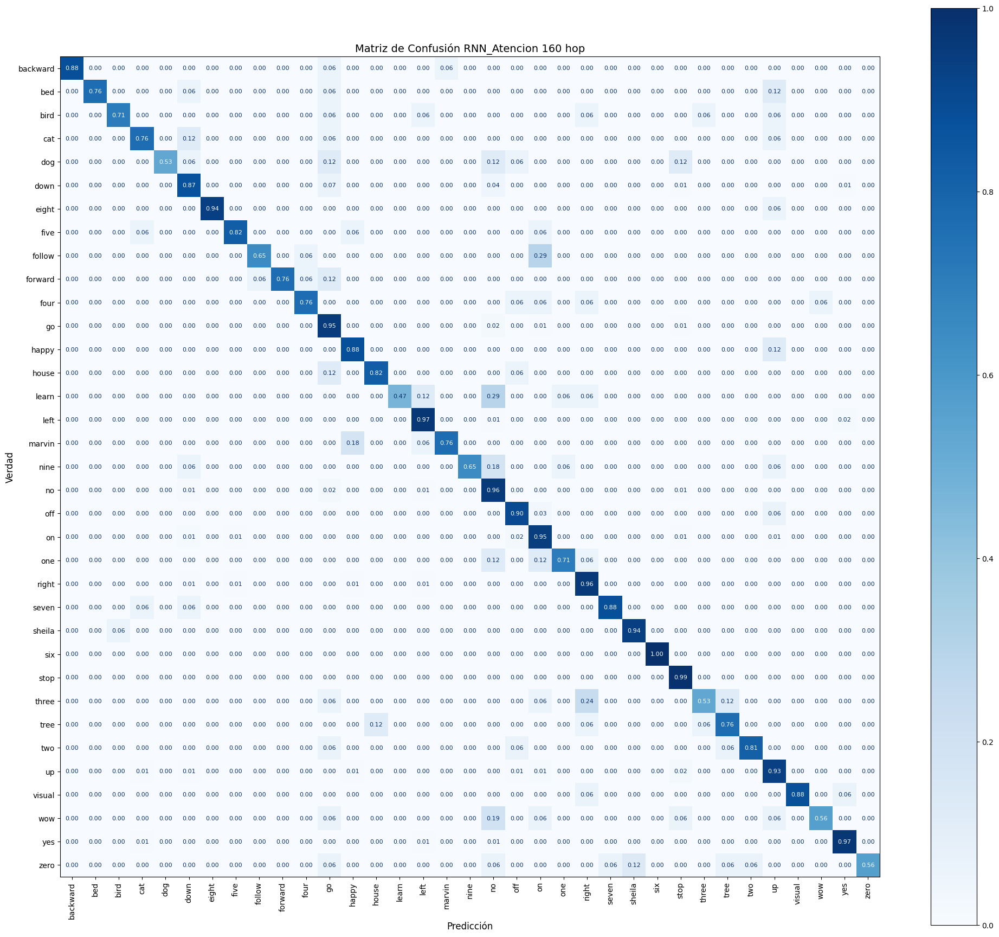

              precision    recall  f1-score   support

    backward       1.00      0.88      0.94        17
         bed       0.93      0.76      0.84        17
        bird       0.86      0.71      0.77        17
         cat       0.59      0.76      0.67        17
         dog       0.90      0.53      0.67        17
        down       0.95      0.87      0.91       396
       eight       0.89      0.94      0.91        17
        five       0.78      0.82      0.80        17
      follow       0.85      0.65      0.73        17
     forward       1.00      0.76      0.87        17
        four       0.87      0.76      0.81        17
          go       0.89      0.95      0.92       396
       happy       0.65      0.88      0.75        17
       house       0.88      0.82      0.85        17
       learn       1.00      0.47      0.64        17
        left       0.97      0.97      0.97       396
      marvin       0.93      0.76      0.84        17
        nine       1.00    

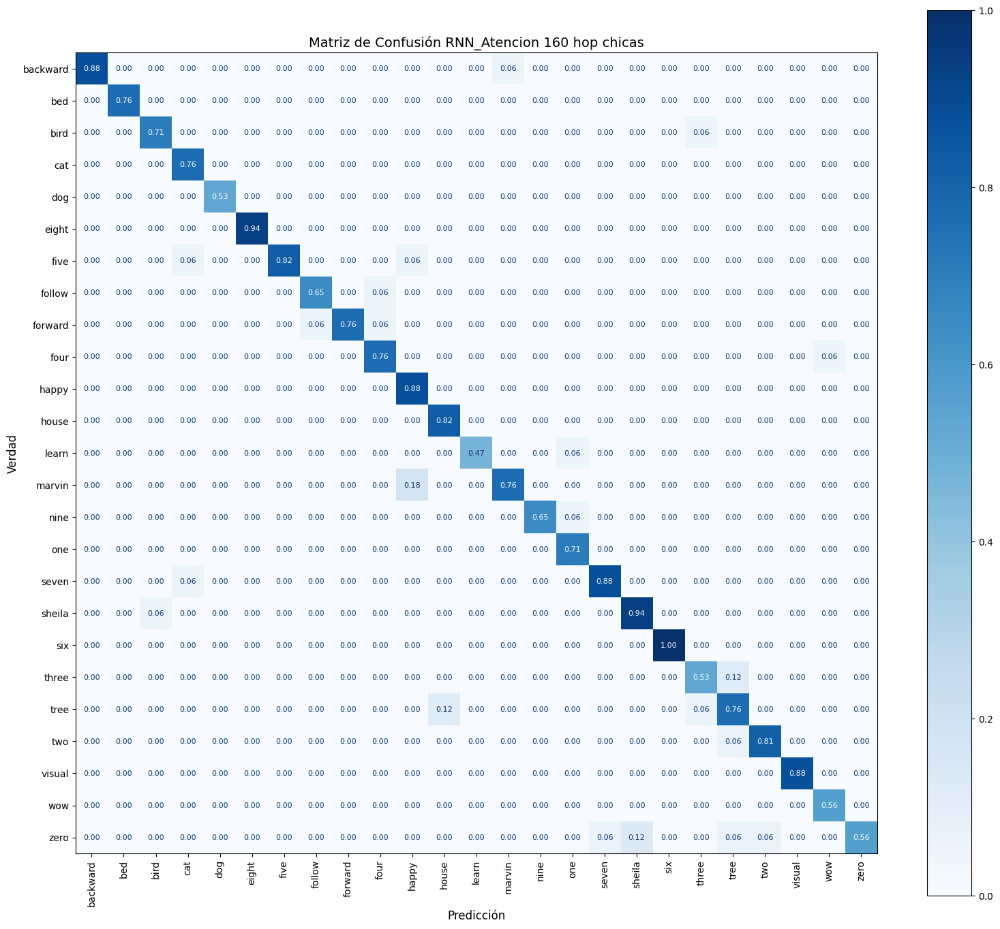

              precision    recall  f1-score   support

    backward       1.00      0.94      0.97        16
         bed       1.00      1.00      1.00        13
        bird       0.92      0.92      0.92        13
         cat       0.87      1.00      0.93        13
         dog       1.00      1.00      1.00         9
       eight       1.00      1.00      1.00        16
        five       1.00      0.88      0.93        16
      follow       0.92      0.92      0.92        12
     forward       1.00      0.87      0.93        15
        four       0.87      0.93      0.90        14
       happy       0.79      1.00      0.88        15
       house       0.88      1.00      0.93        14
       learn       1.00      0.89      0.94         9
      marvin       0.93      0.81      0.87        16
        nine       1.00      0.92      0.96        12
         one       0.86      1.00      0.92        12
       seven       0.94      0.94      0.94        16
      sheila       0.89    

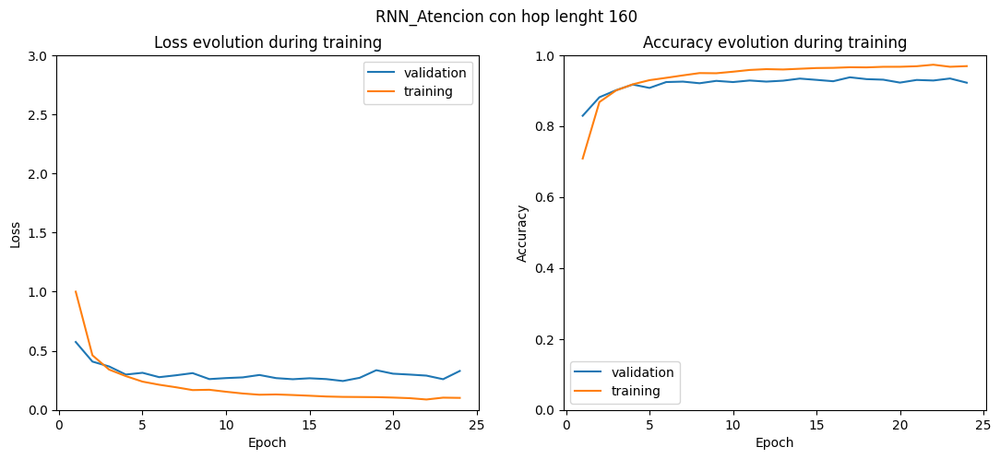

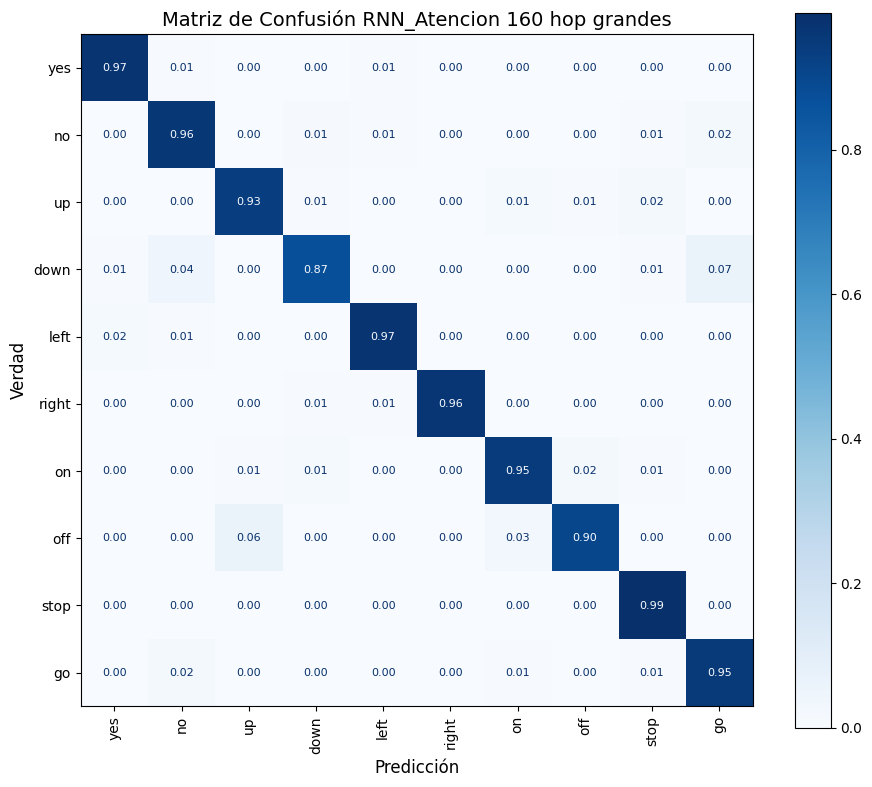

              precision    recall  f1-score   support

         yes       0.98      0.98      0.98       392
          no       0.92      0.96      0.94       395
          up       0.92      0.95      0.93       391
        down       0.96      0.88      0.92       393
        left       0.98      0.97      0.98       395
       right       0.99      0.98      0.99       390
          on       0.94      0.95      0.95       393
         off       0.97      0.91      0.94       394
        stop       0.95      0.99      0.97       394
          go       0.92      0.96      0.94       395

    accuracy                           0.95      3932
   macro avg       0.95      0.95      0.95      3932
weighted avg       0.95      0.95      0.95      3932

Precisión global (Accuracy): 0.9535
📁 Métricas guardadas en: metricas_RNN_Atencion_160_hop_grandes.json

========== Iteración 2/3 ==========

Epoch 1/40
Iteration 84 - Batch 84/508 - Train loss: 1.9440, Train acc: 40.89%
Iteration 168 - Batc

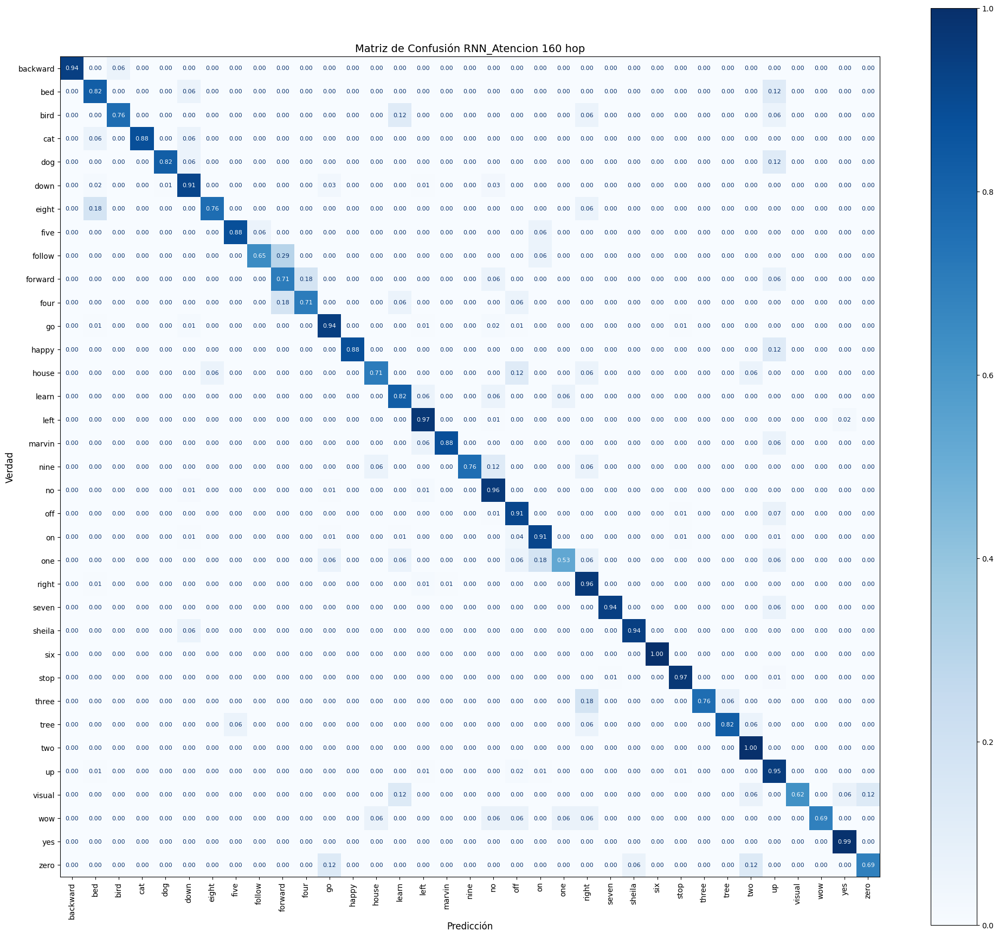

              precision    recall  f1-score   support

    backward       1.00      0.94      0.97        17
         bed       0.44      0.82      0.57        17
        bird       0.87      0.76      0.81        17
         cat       0.88      0.88      0.88        17
         dog       0.78      0.82      0.80        17
        down       0.96      0.91      0.93       396
       eight       0.87      0.76      0.81        17
        five       0.88      0.88      0.88        17
      follow       0.85      0.65      0.73        17
     forward       0.57      0.71      0.63        17
        four       0.80      0.71      0.75        17
          go       0.95      0.94      0.94       396
       happy       0.94      0.88      0.91        17
       house       0.80      0.71      0.75        17
       learn       0.56      0.82      0.67        17
        left       0.95      0.97      0.96       396
      marvin       0.83      0.88      0.86        17
        nine       1.00    

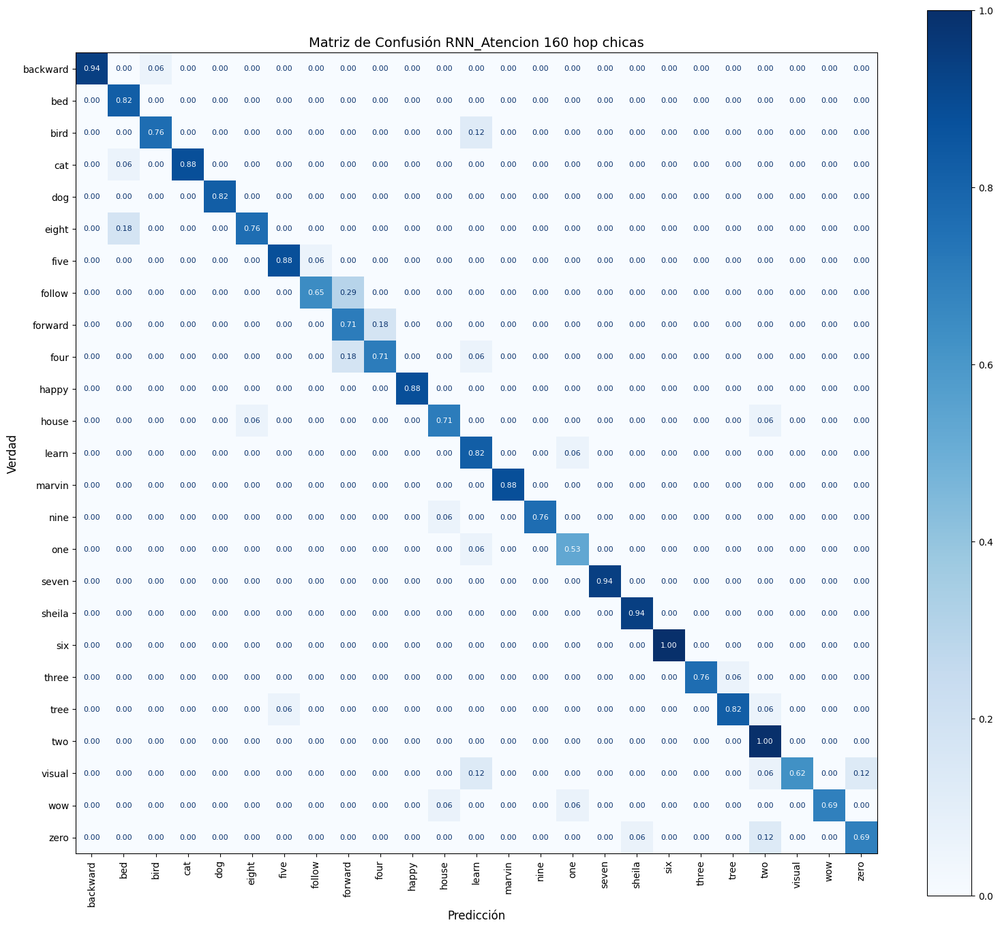

              precision    recall  f1-score   support

    backward       1.00      0.94      0.97        17
         bed       0.78      1.00      0.88        14
        bird       0.93      0.87      0.90        15
         cat       1.00      0.94      0.97        16
         dog       1.00      1.00      1.00        14
       eight       0.93      0.81      0.87        16
        five       0.94      0.94      0.94        16
      follow       0.92      0.69      0.79        16
     forward       0.60      0.80      0.69        15
        four       0.80      0.75      0.77        16
       happy       1.00      1.00      1.00        15
       house       0.86      0.86      0.86        14
       learn       0.70      0.93      0.80        15
      marvin       1.00      1.00      1.00        15
        nine       1.00      0.93      0.96        14
         one       0.82      0.90      0.86        10
       seven       1.00      1.00      1.00        16
      sheila       0.94    

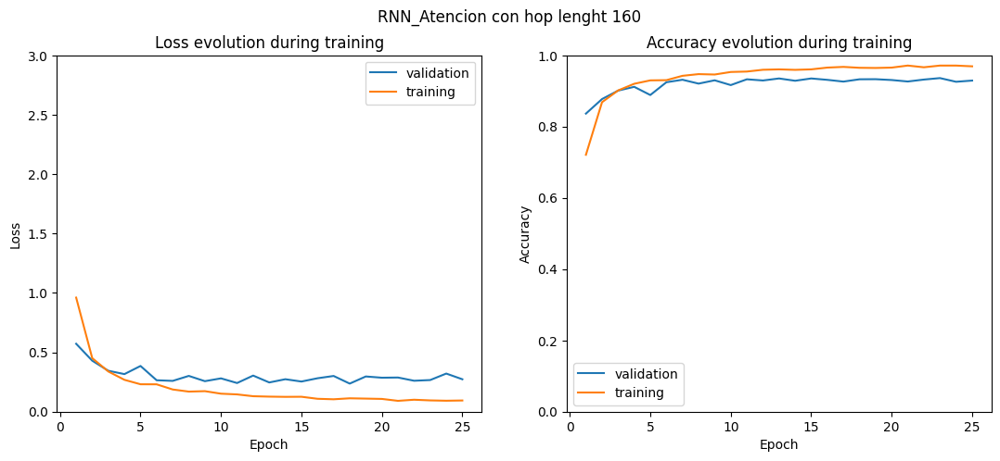

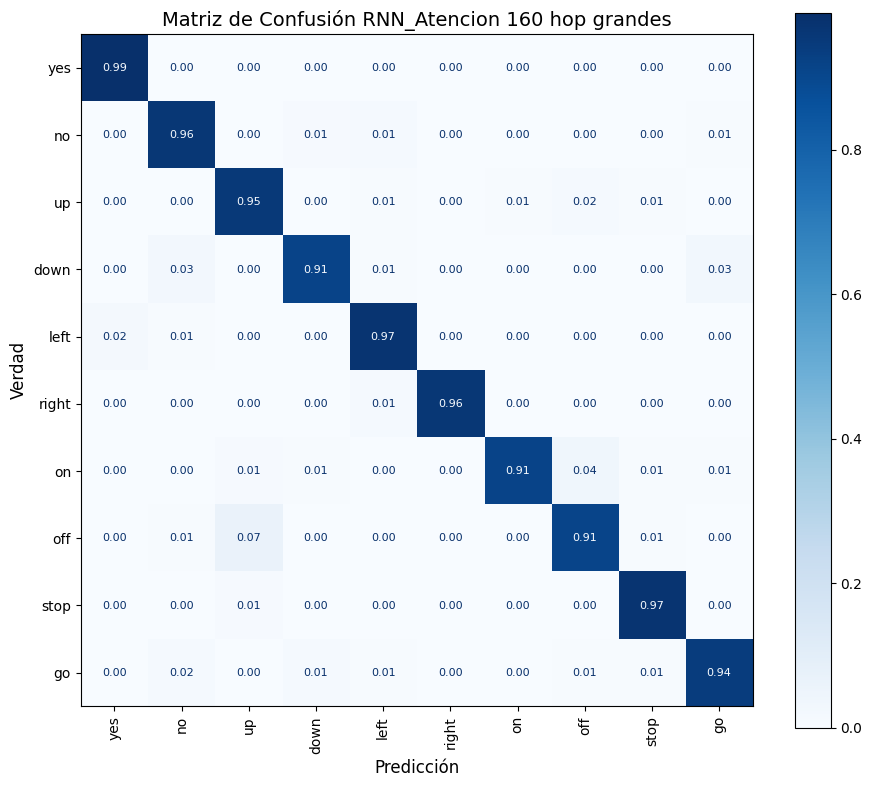

              precision    recall  f1-score   support

         yes       0.98      0.99      0.98       395
          no       0.95      0.97      0.96       393
          up       0.91      0.96      0.94       391
        down       0.97      0.94      0.95       387
        left       0.95      0.97      0.96       395
       right       0.99      0.98      0.99       389
          on       0.99      0.93      0.96       390
         off       0.94      0.92      0.93       393
        stop       0.97      0.98      0.98       392
          go       0.95      0.95      0.95       393

    accuracy                           0.96      3918
   macro avg       0.96      0.96      0.96      3918
weighted avg       0.96      0.96      0.96      3918

Precisión global (Accuracy): 0.9594
📁 Métricas guardadas en: metricas_RNN_Atencion_160_hop_grandes.json

========== Iteración 3/3 ==========

Epoch 1/40
Iteration 84 - Batch 84/508 - Train loss: 1.7590, Train acc: 47.67%
Iteration 168 - Batc

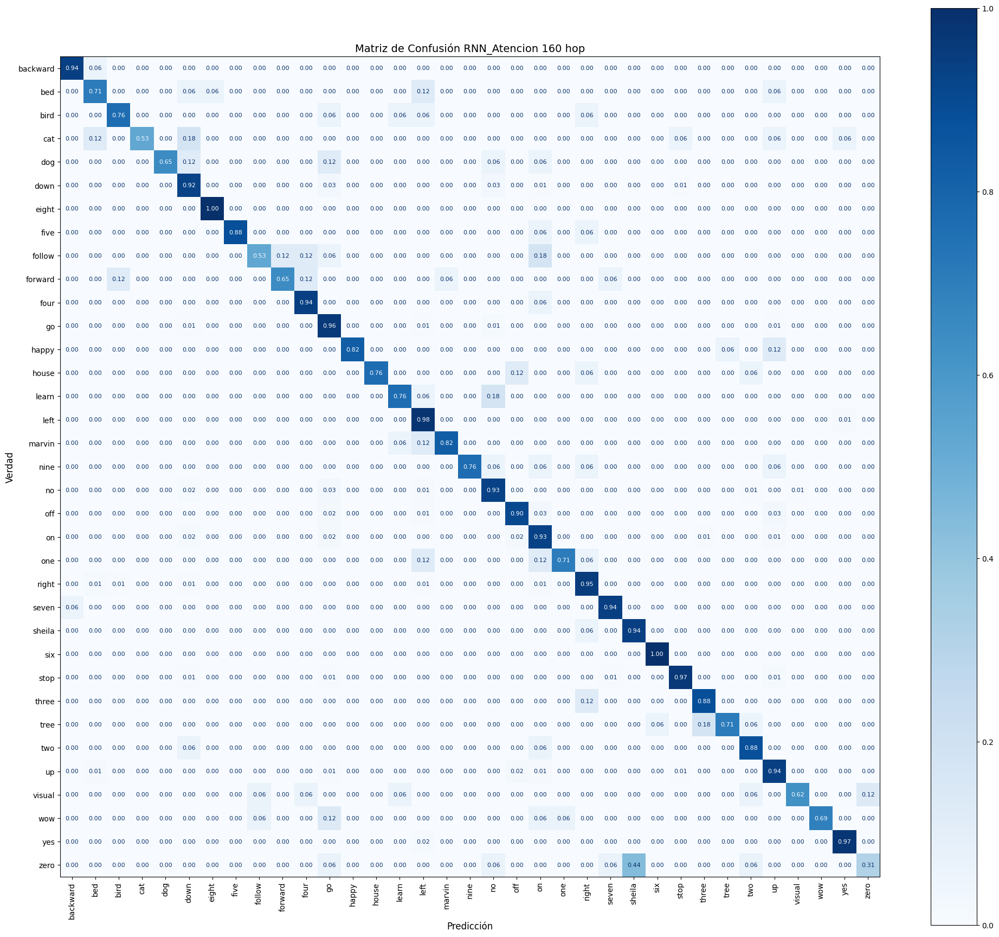

              precision    recall  f1-score   support

    backward       0.84      0.94      0.89        17
         bed       0.48      0.71      0.57        17
        bird       0.76      0.76      0.76        17
         cat       0.90      0.53      0.67        17
         dog       0.85      0.65      0.73        17
        down       0.93      0.92      0.93       396
       eight       0.89      1.00      0.94        17
        five       1.00      0.88      0.94        17
      follow       0.82      0.53      0.64        17
     forward       0.79      0.65      0.71        17
        four       0.76      0.94      0.84        17
          go       0.88      0.96      0.92       396
       happy       1.00      0.82      0.90        17
       house       1.00      0.76      0.87        17
       learn       0.72      0.76      0.74        17
        left       0.93      0.98      0.96       396
      marvin       0.93      0.82      0.88        17
        nine       1.00    

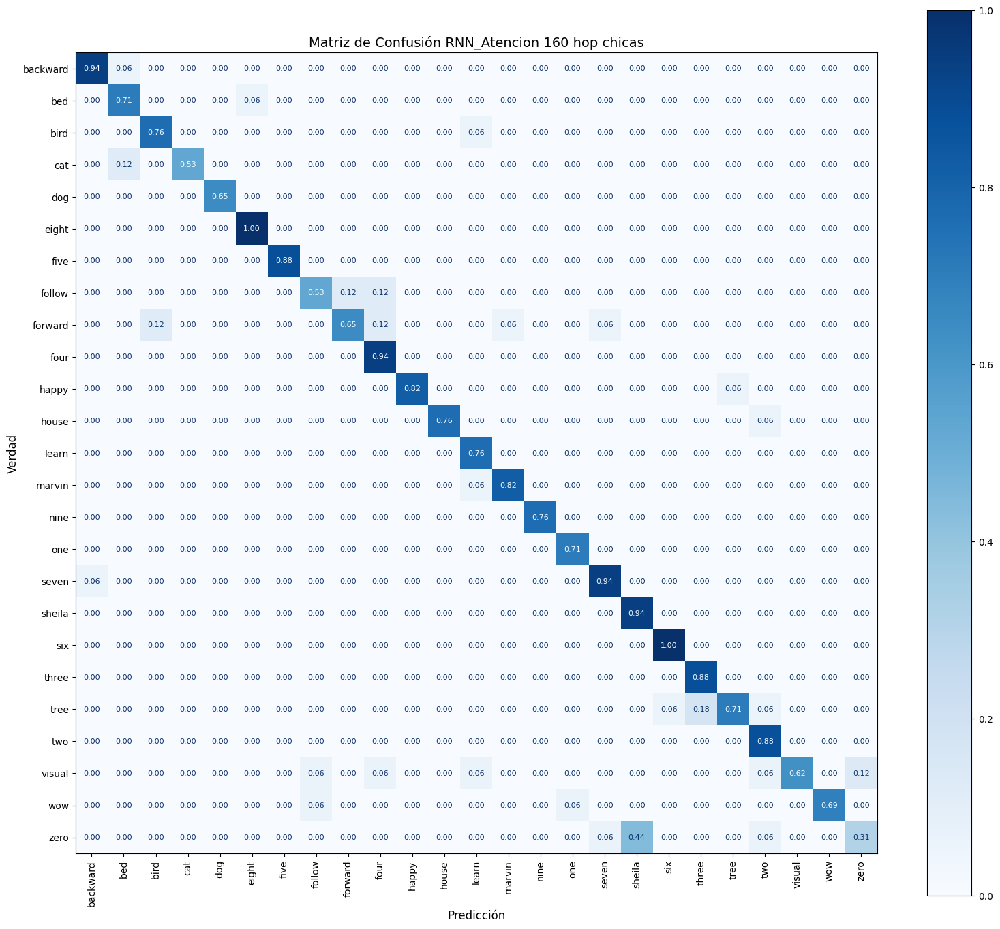

              precision    recall  f1-score   support

    backward       0.94      0.94      0.94        17
         bed       0.80      0.92      0.86        13
        bird       0.87      0.93      0.90        14
         cat       1.00      0.82      0.90        11
         dog       1.00      1.00      1.00        11
       eight       0.94      1.00      0.97        17
        five       1.00      1.00      1.00        15
      follow       0.82      0.69      0.75        13
     forward       0.85      0.65      0.73        17
        four       0.76      1.00      0.86        16
       happy       1.00      0.93      0.97        15
       house       1.00      0.93      0.96        14
       learn       0.81      1.00      0.90        13
      marvin       0.93      0.93      0.93        15
        nine       1.00      1.00      1.00        13
         one       0.92      1.00      0.96        12
       seven       0.89      0.94      0.91        17
      sheila       0.70    

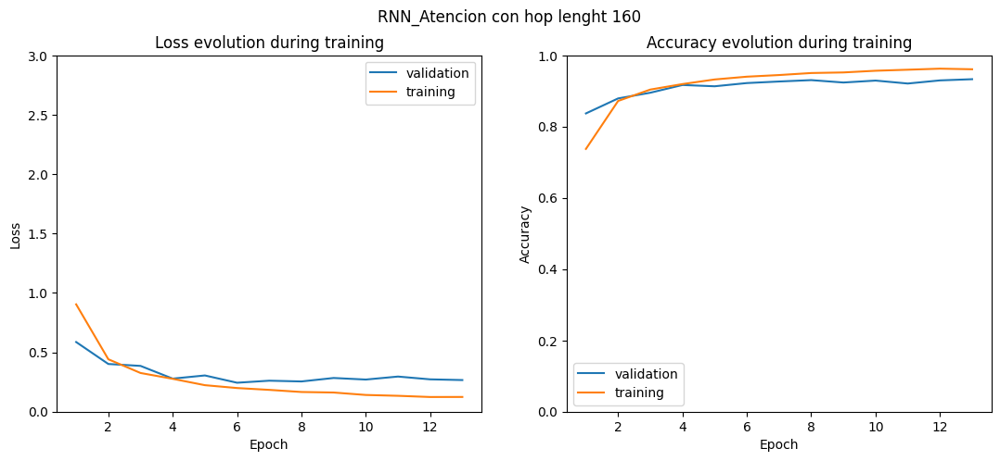

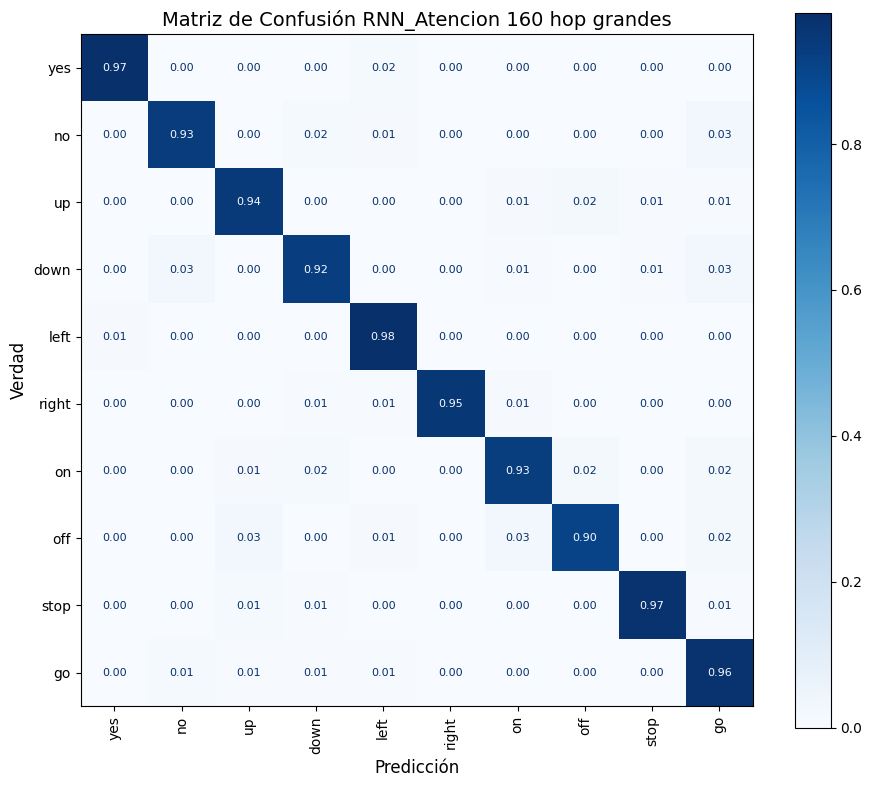

              precision    recall  f1-score   support

         yes       0.99      0.98      0.98       394
          no       0.95      0.94      0.94       391
          up       0.93      0.95      0.94       392
        down       0.95      0.93      0.94       393
        left       0.95      0.98      0.97       395
       right       0.99      0.97      0.98       387
          on       0.95      0.93      0.94       394
         off       0.96      0.91      0.93       394
        stop       0.98      0.97      0.98       393
          go       0.90      0.97      0.93       395

    accuracy                           0.95      3928
   macro avg       0.95      0.95      0.95      3928
weighted avg       0.95      0.95      0.95      3928

Precisión global (Accuracy): 0.9542
📁 Métricas guardadas en: metricas_RNN_Atencion_160_hop_grandes.json

========== Iteración 4/3 ==========

Epoch 1/40
Iteration 84 - Batch 84/508 - Train loss: 1.9578, Train acc: 39.94%
Iteration 168 - Batc

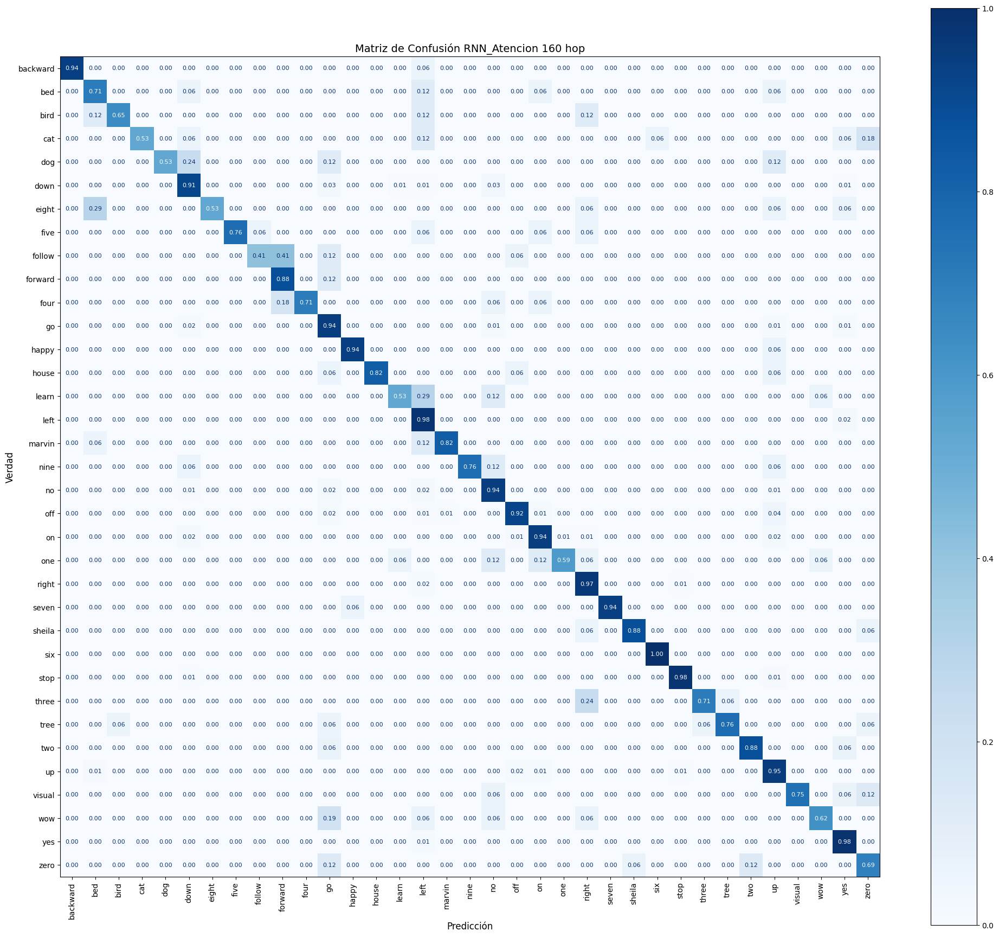

              precision    recall  f1-score   support

    backward       0.94      0.94      0.94        17
         bed       0.48      0.71      0.57        17
        bird       0.92      0.65      0.76        17
         cat       1.00      0.53      0.69        17
         dog       1.00      0.53      0.69        17
        down       0.93      0.91      0.92       396
       eight       0.90      0.53      0.67        17
        five       1.00      0.76      0.87        17
      follow       0.88      0.41      0.56        17
     forward       0.60      0.88      0.71        17
        four       1.00      0.71      0.83        17
          go       0.90      0.94      0.92       396
       happy       0.94      0.94      0.94        17
       house       1.00      0.82      0.90        17
       learn       0.69      0.53      0.60        17
        left       0.90      0.98      0.94       396
      marvin       0.82      0.82      0.82        17
        nine       0.93    

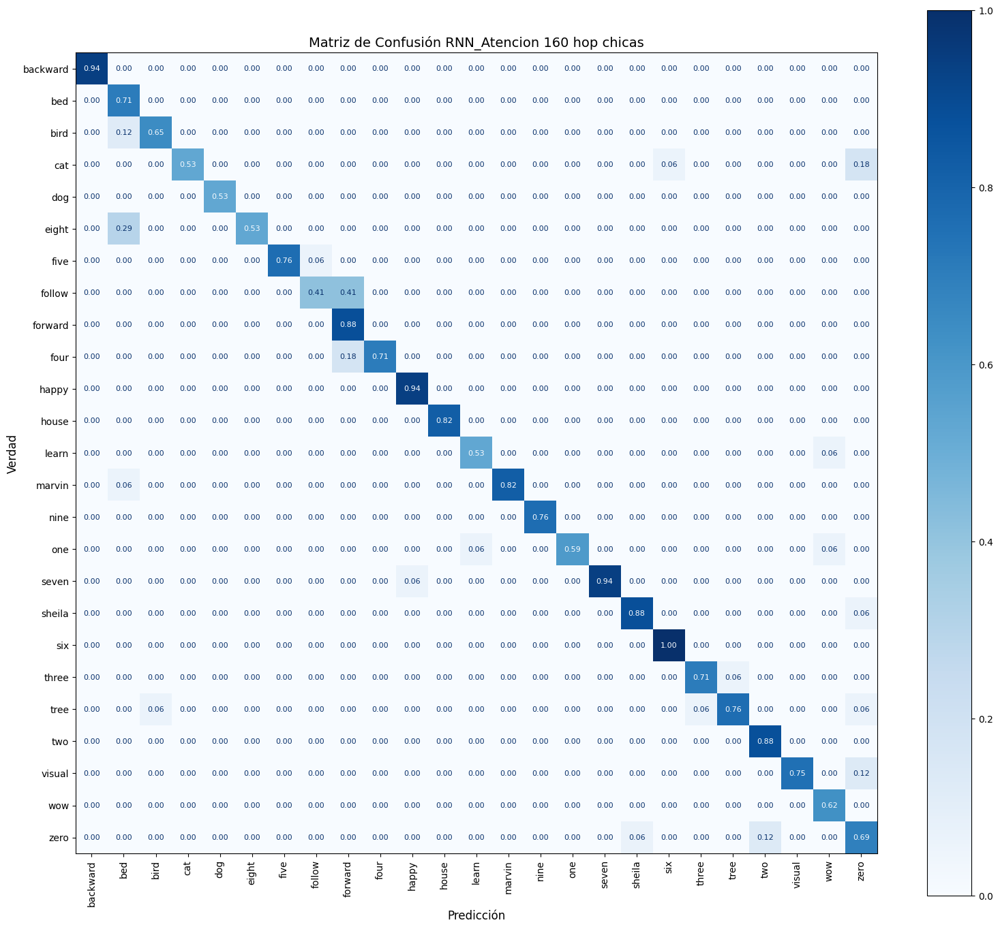

              precision    recall  f1-score   support

    backward       1.00      1.00      1.00        16
         bed       0.60      1.00      0.75        12
        bird       0.92      0.85      0.88        13
         cat       1.00      0.69      0.82        13
         dog       1.00      1.00      1.00         9
       eight       1.00      0.64      0.78        14
        five       1.00      0.93      0.96        14
      follow       0.88      0.50      0.64        14
     forward       0.60      1.00      0.75        15
        four       1.00      0.80      0.89        15
       happy       0.94      1.00      0.97        16
       house       1.00      1.00      1.00        14
       learn       0.90      0.90      0.90        10
      marvin       1.00      0.93      0.97        15
        nine       1.00      1.00      1.00        13
         one       1.00      0.83      0.91        12
       seven       1.00      0.94      0.97        17
      sheila       0.94    

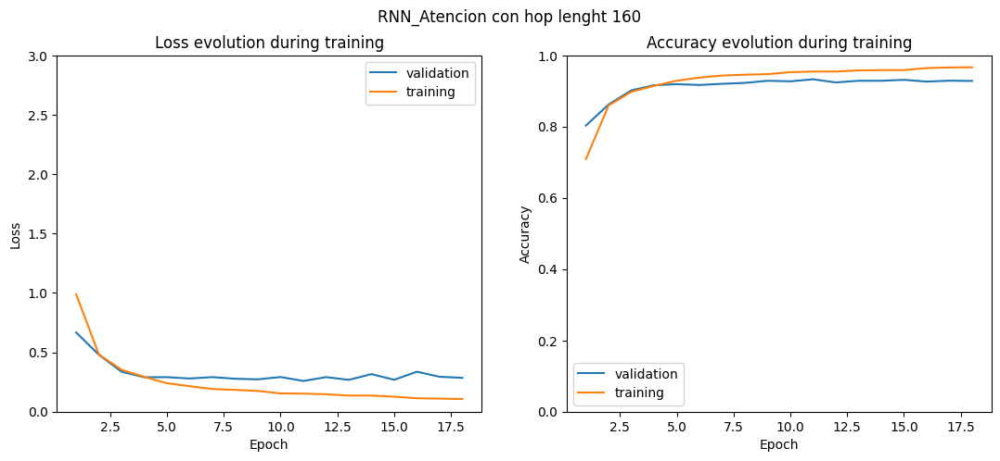

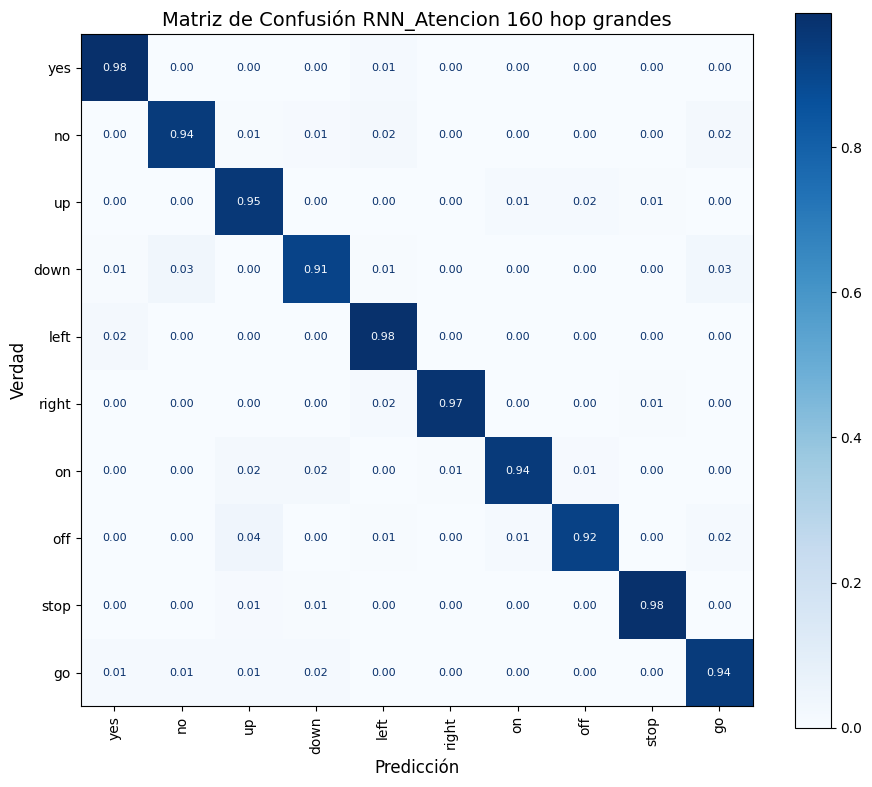

              precision    recall  f1-score   support

         yes       0.96      0.98      0.97       396
          no       0.95      0.94      0.95       395
          up       0.91      0.96      0.94       391
        down       0.95      0.92      0.93       391
        left       0.94      0.98      0.96       395
       right       0.99      0.97      0.98       393
          on       0.97      0.95      0.96       394
         off       0.97      0.92      0.95       394
        stop       0.99      0.98      0.98       396
          go       0.93      0.94      0.94       396

    accuracy                           0.96      3941
   macro avg       0.96      0.96      0.96      3941
weighted avg       0.96      0.96      0.96      3941

Precisión global (Accuracy): 0.9566
📁 Métricas guardadas en: metricas_RNN_Atencion_160_hop_grandes.json

========== Iteración 5/3 ==========

Epoch 1/40
Iteration 84 - Batch 84/508 - Train loss: 1.8175, Train acc: 46.28%
Iteration 168 - Batc

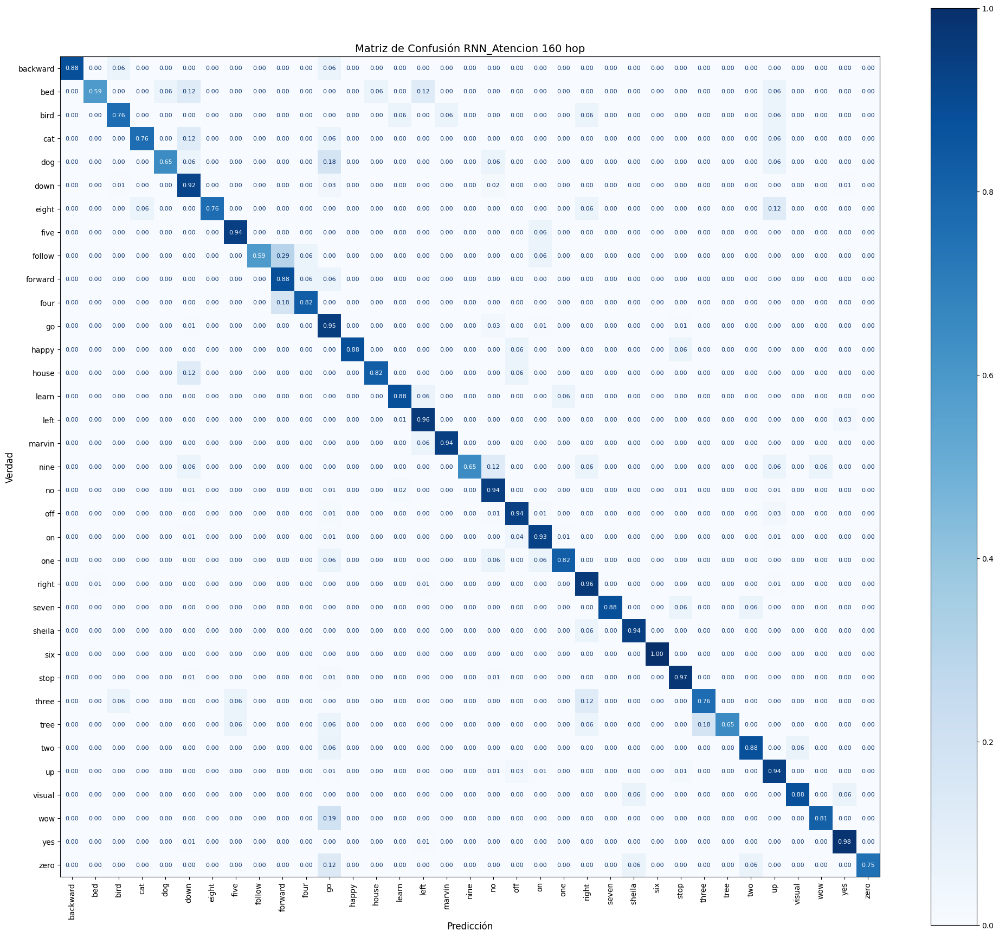

              precision    recall  f1-score   support

    backward       1.00      0.88      0.94        17
         bed       0.77      0.59      0.67        17
        bird       0.68      0.76      0.72        17
         cat       0.76      0.76      0.76        17
         dog       0.92      0.65      0.76        17
        down       0.94      0.92      0.93       396
       eight       1.00      0.76      0.87        17
        five       0.89      0.94      0.91        17
      follow       0.91      0.59      0.71        17
     forward       0.65      0.88      0.75        17
        four       0.88      0.82      0.85        17
          go       0.89      0.95      0.92       396
       happy       1.00      0.88      0.94        17
       house       0.93      0.82      0.88        17
       learn       0.56      0.88      0.68        17
        left       0.97      0.96      0.96       396
      marvin       0.94      0.94      0.94        17
        nine       1.00    

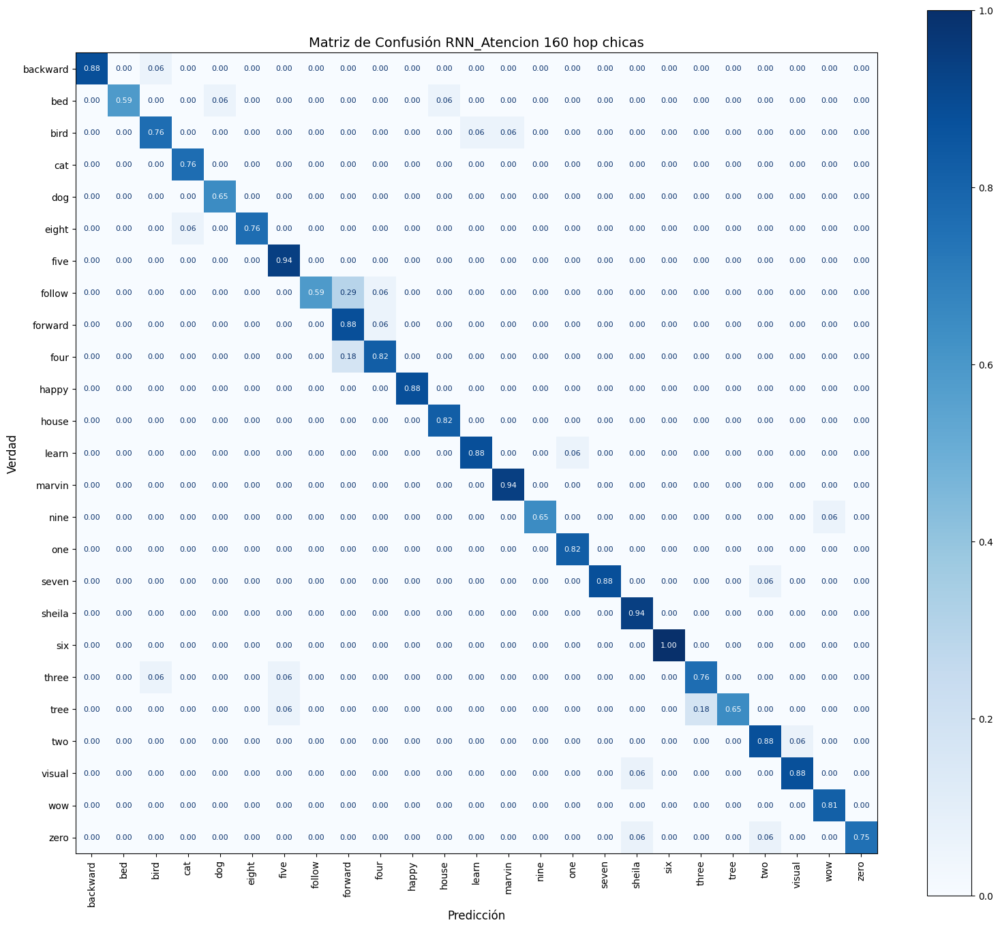

              precision    recall  f1-score   support

    backward       1.00      0.94      0.97        16
         bed       1.00      0.83      0.91        12
        bird       0.87      0.87      0.87        15
         cat       0.93      1.00      0.96        13
         dog       0.92      1.00      0.96        11
       eight       1.00      0.93      0.96        14
        five       0.89      1.00      0.94        16
      follow       1.00      0.62      0.77        16
     forward       0.65      0.94      0.77        16
        four       0.88      0.82      0.85        17
       happy       1.00      1.00      1.00        15
       house       0.93      1.00      0.97        14
       learn       0.94      0.94      0.94        16
      marvin       0.94      1.00      0.97        16
        nine       1.00      0.92      0.96        12
         one       0.93      1.00      0.97        14
       seven       1.00      0.94      0.97        16
      sheila       0.89    

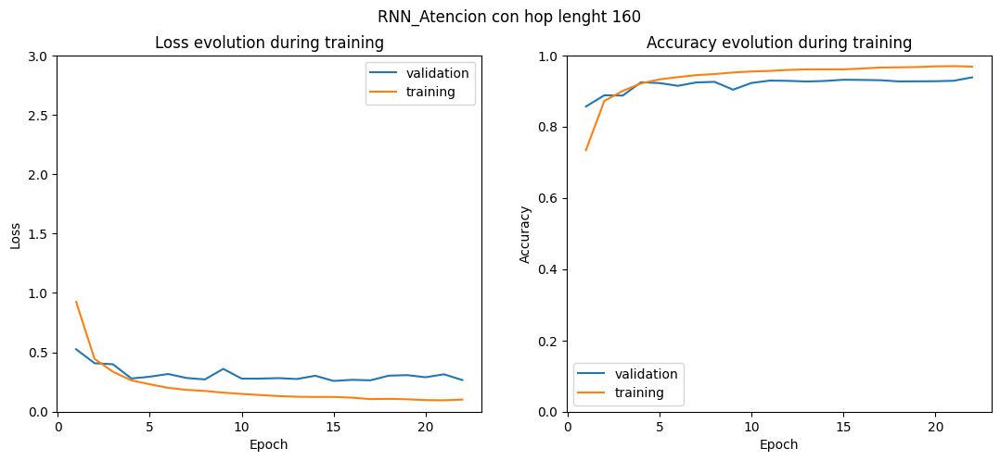

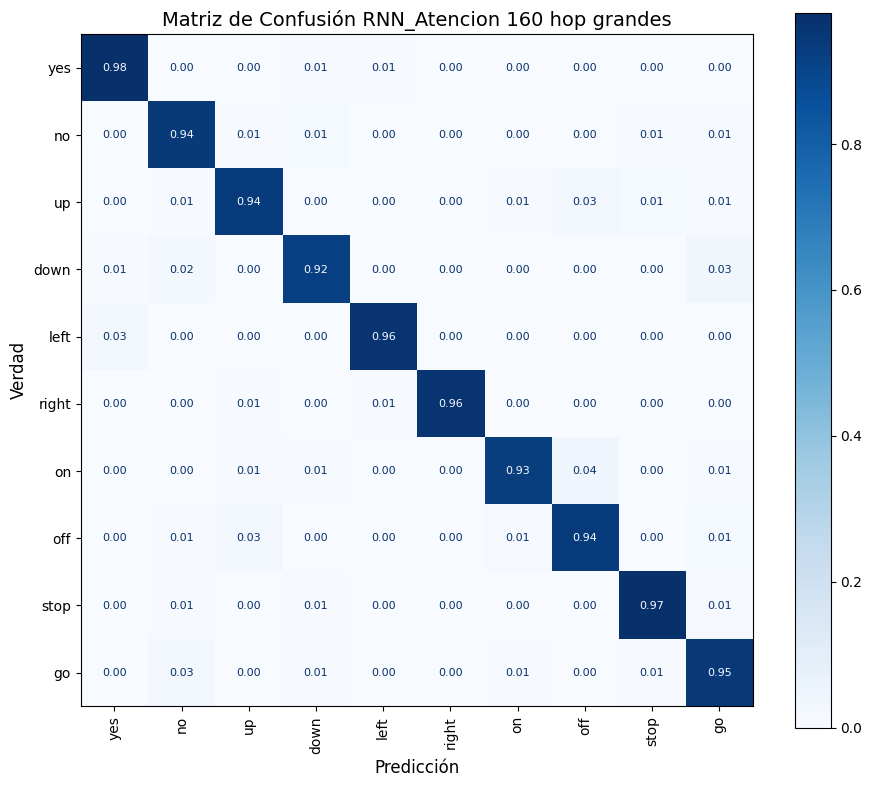

              precision    recall  f1-score   support

         yes       0.97      0.98      0.97       395
          no       0.93      0.97      0.95       387
          up       0.95      0.94      0.94       396
        down       0.96      0.93      0.94       390
        left       0.98      0.97      0.97       393
       right       1.00      0.98      0.99       390
          on       0.97      0.94      0.96       391
         off       0.93      0.94      0.93       395
        stop       0.97      0.97      0.97       395
          go       0.92      0.95      0.93       396

    accuracy                           0.96      3928
   macro avg       0.96      0.96      0.96      3928
weighted avg       0.96      0.96      0.96      3928

Precisión global (Accuracy): 0.9565
📁 Métricas guardadas en: metricas_RNN_Atencion_160_hop_grandes.json

===== Resultados finales =====
Precisión promedio (5 runs): 93.18% ± 0.29%
Modelo final guardado


In [ ]:
device = "cuda" if torch.cuda.is_available() else "cpu"

# Datos y clases
train_dl, val_dl, test_dl = load2(MFCC_train_10, MFCC_val_10, MFCC_test_10, batch_size=64)

# Función para obtener predicciones (CORREGIDA)
@torch.no_grad()
def get_predictions(loader, model, device="cpu"):
    model = model.to(device)
    model.eval()
    all_predictions, all_true_labels = [], []

    for xb, yb in loader:  # ✅ CAMBIO: usa 'loader' no 'train_dl'
        xb = xb.to(device)   # (batch, seq, feat)
        xb = xb.transpose(1, 2)     # ✅ (batch, seq, feat) = (64, 98, 39)
        yb = yb.to(device)

        logits = model(xb)  # No transponer
        pred = logits.argmax(1)
        all_predictions.extend(pred.cpu().numpy())
        all_true_labels.extend(yb.cpu().numpy())

    return np.array(all_true_labels), np.array(all_predictions)


# Loop de 5 iteraciones
accuracies = []

for i in range(5):
    print(f"\n========== Iteración {i+1}/3 ==========")
    model = RNN_MHAP(
    hidden_size=256,
    input_size=39,  # n_mfcc típicos
    num_clases=35)

    criterion = nn.CrossEntropyLoss()

    curves = train_model(
        model, train_dl, val_dl,
        epochs=40, lr=1e-3,
        criterion=criterion,
        device=device,
        early_stopping_patience=7
    )

    true_labels, predictions = get_predictions(test_dl, model, device)
    acc = (predictions == true_labels).mean() * 100
    accuracies.append(acc)
    print(f"✅ Precisión iteración {i+1}: {acc:.2f}%")
    modelo = "RNN_Atencion"
    hop = 160
    # Matriz de confusión del último modelo entrenado
    show_confusion_matrix(
        true_labels, predictions,
        clases_10,
        title=f"Matriz de Confusión {modelo} {hop} hop",
        filename=f"matriz_confusion_{modelo}_{hop}_hop.png",
        metrics_filename=f"metricas_{modelo}_{hop}_hop.json"
    )

    # Matriz de confusión del último modelo entrenado
    show_confusion_matrix(
        true_labels, predictions,
        clases_10,
        title=f"Matriz de Confusión {modelo} {hop} hop chicas",
        filename=f"matriz_confusion_{modelo}_{hop}_hop_chicas.png",
        selected_classes = clases_chicas,
        metrics_filename=f"metricas_{modelo}_{hop}_hop_chicas.json"
    )
    show_curves(curves, title=f"{modelo} con hop lenght {hop}" , filename=f"Curva_{modelo}_{hop}_hop.png")

    # Matriz de confusión del último modelo entrenado
    show_confusion_matrix(
        true_labels, predictions,
        clases_10,
        title=f"Matriz de Confusión {modelo} {hop} hop grandes",
        filename=f"matriz_confusion_{modelo}_{hop}_hop_grandes.png",
        selected_classes = clases_grandes,
        metrics_filename=f"metricas_{modelo}_{hop}_hop_grandes.json"
    )
# Promedio y desviación estándar
mean_acc = np.mean(accuracies)
std_acc = np.std(accuracies)

print("\n===== Resultados finales =====")
print(f"Precisión promedio (5 runs): {mean_acc:.2f}% ± {std_acc:.2f}%")

torch.save(model.state_dict(), "modelo_Grubid_160.pth")
print("Modelo final guardado")




In [ ]:
import os
def count_parameters(model):
    return sum(p.numel() for p in model.parameters() if p.requires_grad)


def model_size_in_mb(model):
    param_size = 0
    for param in model.parameters():
        param_size += param.nelement() * param.element_size()
    buffer_size = 0
    for buffer in model.buffers():
        buffer_size += buffer.nelement() * buffer.element_size()
    size_all_bytes = param_size + buffer_size
    return size_all_bytes / (1024 ** 2)  # MB


def model_summary(model):
    params = count_parameters(model)
    size = model_size_in_mb(model)

    print(f"📌 Parámetros entrenables: {params:,}")
    print(f"📦 Tamaño aproximado en memoria: {size:.2f} MB")

    # Tamaño real en disco
    torch.save(model.state_dict(), "temp_weight_test.pth")
    real_size = os.path.getsize("temp_weight_test.pth") / (1024**2)
    print(f"💾 Tamaño real del archivo .pth: {real_size:.2f} MB")

    os.remove("temp_weight_test.pth")
import time
import torch

def measure_inference_time(model, loader, device="cpu"):
    model.eval()
    model.to(device)

    total_time = 0
    total_samples = 0

    with torch.no_grad():
        for xb, yb in loader:

            xb = xb.to(device)
            xb = xb.transpose(1, 2)

            # 🚀 Asegurar que la GPU esté sincronizada antes de medir
            if device == "cuda":
                torch.cuda.synchronize()

            start = time.time()

            _ = model(xb)

            # 🚀 Volver a sincronizar antes de leer el tiempo
            if device == "cuda":
                torch.cuda.synchronize()

            end = time.time()

            batch_time = end - start
            total_time += batch_time
            total_samples += xb.shape[0]

    time_per_sample = total_time / total_samples

    return time_per_sample, total_time


In [ ]:
model_summary(model)
time_per_sample, total_time = measure_inference_time(model, test_dl, device)

print(f"⏱️ Tiempo promedio por muestra: {time_per_sample*1000:.3f} ms")
print(f"⏱️ Tiempo total sobre el test: {total_time:.2f} s")

📌 Parámetros entrenables: 3,635,747
📦 Tamaño aproximado en memoria: 13.87 MB
💾 Tamaño real del archivo .pth: 13.88 MB
⏱️ Tiempo promedio por muestra: 0.272 ms
⏱️ Tiempo total sobre el test: 1.19 s


Se vuelven a poner las funciones normales

In [ ]:
def train_model(
    model,
    train_loader,
    val_loader,
    epochs,
    criterion,
    lr,
    device="cpu",
    n_evaluations_per_epoch=6,
    early_stopping_patience=None,
):
    if device == "cuda" and torch.cuda.is_available():
        model = model.cuda()

    optimizer = torch.optim.Adam(model.parameters(), lr=lr)

    curves = {"train_acc": [], "val_acc": [], "train_loss": [], "val_loss": []}
    t0 = time.perf_counter()
    iteration = 0
    n_batches = len(train_loader)

    best_val_acc = -1.0
    best_state = None
    patience = 0

    for epoch in range(epochs):
        print(f"\rEpoch {epoch + 1}/{epochs}")
        cumulative_train_loss = 0.0
        cumulative_train_corrects = 0
        train_loss_count = 0
        train_acc_count = 0

        model.train()
        for i, (x_batch, y_batch) in enumerate(train_loader):
            x_batch = x_batch.to(device)
            y_batch = y_batch.to(device)

            y_predicted, loss = train_step(x_batch, y_batch, model, optimizer, criterion)

            cumulative_train_loss += loss.item()
            train_loss_count += 1
            train_acc_count += y_batch.size(0)

            class_prediction = torch.argmax(y_predicted, dim=1).long()
            cumulative_train_corrects += (y_batch == class_prediction).sum().item()

            if (i % max(1, (n_batches // max(1, n_evaluations_per_epoch))) == 0) and (i > 0):
                train_loss = cumulative_train_loss / train_loss_count
                train_acc = cumulative_train_corrects / train_acc_count
                print(f"Iteration {iteration} - Batch {i}/{len(train_loader)} - "
                      f"Train loss: {train_loss:.4f}, Train acc: {train_acc:.2%}")
            iteration += 1

        # validación
        val_acc, val_loss = evaluate(val_loader, model, criterion, device=device)
        train_loss = cumulative_train_loss / max(1, train_loss_count)
        train_acc = cumulative_train_corrects / max(1, train_acc_count)

        print(f"Val loss: {val_loss:.4f}, Val acc: {val_acc:.2%}")

        curves["train_acc"].append(train_acc)
        curves["val_acc"].append(val_acc)
        curves["train_loss"].append(train_loss)
        curves["val_loss"].append(val_loss)

        # early stopping
        if early_stopping_patience is not None:
            if val_acc > best_val_acc:
                best_val_acc = val_acc
                best_state = {k: v.detach().cpu() for k, v in model.state_dict().items()}
                patience = 0
            else:
                patience += 1
                if patience >= early_stopping_patience:
                    print(f"Early stopping: sin mejora en {early_stopping_patience} épocas.")
                    if best_state is not None:
                        model.load_state_dict(best_state)
                    break

    print(f"\nTiempo total de entrenamiento: {time.perf_counter() - t0:.4f} [s]")
    model.cpu()
    return curves



In [ ]:
import os
def count_parameters(model):
    return sum(p.numel() for p in model.parameters() if p.requires_grad)


def model_size_in_mb(model):
    param_size = 0
    for param in model.parameters():
        param_size += param.nelement() * param.element_size()
    buffer_size = 0
    for buffer in model.buffers():
        buffer_size += buffer.nelement() * buffer.element_size()
    size_all_bytes = param_size + buffer_size
    return size_all_bytes / (1024 ** 2)  # MB


def model_summary(model):
    params = count_parameters(model)
    size = model_size_in_mb(model)

    print(f"📌 Parámetros entrenables: {params:,}")
    print(f"📦 Tamaño aproximado en memoria: {size:.2f} MB")

    # Tamaño real en disco
    torch.save(model.state_dict(), "temp_weight_test.pth")
    real_size = os.path.getsize("temp_weight_test.pth") / (1024**2)
    print(f"💾 Tamaño real del archivo .pth: {real_size:.2f} MB")

    os.remove("temp_weight_test.pth")
import time
import torch

def measure_inference_time(model, loader, device="cpu"):
    model.eval()
    model.to(device)

    total_time = 0
    total_samples = 0

    with torch.no_grad():
        for xb, yb in loader:

            xb = xb.to(device)

            # 🚀 Asegurar que la GPU esté sincronizada antes de medir
            if device == "cuda":
                torch.cuda.synchronize()

            start = time.time()

            _ = model(xb)

            # 🚀 Volver a sincronizar antes de leer el tiempo
            if device == "cuda":
                torch.cuda.synchronize()

            end = time.time()

            batch_time = end - start
            total_time += batch_time
            total_samples += xb.shape[0]

    time_per_sample = total_time / total_samples

    return time_per_sample, total_time

#### 35 hop lenght

In [ ]:
transform = T.MFCC(sample_rate=sample_rate, n_mfcc=13, melkwargs={"n_fft": 400, "hop_length": 35, "n_mels": 23, "center": False},)
MFCC_train_10 = aplicar_MFCC(transform, train_adaptado_original)
MFCC_val_10 = aplicar_MFCC(transform, val_adaptado_original)
MFCC_test_10 = aplicar_MFCC(transform, test_adaptado_original)

##### CNN con RNN Vanilla

In [ ]:
device = "cuda" if torch.cuda.is_available() else "cpu"

# Datos y clases
train_dl, val_dl, test_dl = load2(MFCC_train_10, MFCC_val_10, MFCC_test_10, batch_size=64)

# Función para obtener predicciones
@torch.no_grad()
def get_predictions(loader, model, device="cpu"):
    model = model.to(device)
    model.eval()
    all_predictions, all_true_labels = [], []
    for xb, yb in loader:
        xb, yb = xb.to(device), yb.to(device)
        pred = model(xb).argmax(1)
        all_predictions.extend(pred.cpu().numpy())
        all_true_labels.extend(yb.cpu().numpy())
    return np.array(all_true_labels), np.array(all_predictions)

# Loop de 5 iteraciones
accuracies = []

for i in range(5):
    print(f"\n========== Iteración {i+1}/3 ==========")
    model = CNN1DModel_RNN(
        input_size=39,
        hidden_size=128,
        num_layers=1,
        bidirectional=False,
        num_classes=len(label_map)
    ).to(device)

    criterion = nn.CrossEntropyLoss()

    curves = train_model(
        model, train_dl, val_dl,
        epochs=40, lr=1e-3,
        criterion=criterion,
        device=device,
        early_stopping_patience=7
    )

    true_labels, predictions = get_predictions(test_dl, model, device)
    acc = (predictions == true_labels).mean() * 100
    accuracies.append(acc)
    print(f"✅ Precisión iteración {i+1}: {acc:.2f}%")

# Promedio y desviación estándar
mean_acc = np.mean(accuracies)
std_acc = np.std(accuracies)

print("\n===== Resultados finales =====")
print(f"Precisión promedio (5 runs): {mean_acc:.2f}% ± {std_acc:.2f}%")

torch.save(model.state_dict(), "modelo_CNN_35.pth")
print("Modelo final guardado")

# Matriz de confusión del último modelo entrenado
show_confusion_matrix(
    true_labels, predictions,
    clases_10,
    title=f"Matriz de Confusión CNN 35 hop",
    filename="matriz_confusion_CNN_35_hop.png",
    metrics_filename="metricas_CNN_35_hop.json"
)

# Matriz de confusión del último modelo entrenado
show_confusion_matrix(
    true_labels, predictions,
    clases_10,
    title=f"Matriz de Confusión CNN 35 hop chicas",
    filename="matriz_confusion_CNN_35_hop_chicas.png",
    selected_classes = clases_chicas,
    metrics_filename="metricas_CNN_35_hop_chicas.json"
)
show_curves(curves, title="CNN-RNN con hop lenght 35" , filename="Curva_CNN_35_hop.png")

# Matriz de confusión del último modelo entrenado
show_confusion_matrix(
    true_labels, predictions,
    clases_10,
    title=f"Matriz de Confusión CNN 35 hop grandes",
    filename="matriz_confusion_CNN_35_hop_grandes.png",
    selected_classes = clases_grandes,
    metrics_filename="metricas_CNN_35_hop_grandes.json"
)

{'backward': 0, 'bed': 1, 'bird': 2, 'cat': 3, 'dog': 4, 'down': 5, 'eight': 6, 'five': 7, 'follow': 8, 'forward': 9, 'four': 10, 'go': 11, 'happy': 12, 'house': 13, 'learn': 14, 'left': 15, 'marvin': 16, 'nine': 17, 'no': 18, 'off': 19, 'on': 20, 'one': 21, 'right': 22, 'seven': 23, 'sheila': 24, 'six': 25, 'stop': 26, 'three': 27, 'tree': 28, 'two': 29, 'up': 30, 'visual': 31, 'wow': 32, 'yes': 33, 'zero': 34}
{'backward': 0, 'bed': 1, 'bird': 2, 'cat': 3, 'dog': 4, 'down': 5, 'eight': 6, 'five': 7, 'follow': 8, 'forward': 9, 'four': 10, 'go': 11, 'happy': 12, 'house': 13, 'learn': 14, 'left': 15, 'marvin': 16, 'nine': 17, 'no': 18, 'off': 19, 'on': 20, 'one': 21, 'right': 22, 'seven': 23, 'sheila': 24, 'six': 25, 'stop': 26, 'three': 27, 'tree': 28, 'two': 29, 'up': 30, 'visual': 31, 'wow': 32, 'yes': 33, 'zero': 34}
{'backward': 0, 'bed': 1, 'bird': 2, 'cat': 3, 'dog': 4, 'down': 5, 'eight': 6, 'five': 7, 'follow': 8, 'forward': 9, 'four': 10, 'go': 11, 'happy': 12, 'house': 13, 'l

KeyboardInterrupt: 

##### T-CNN

In [ ]:
device = "cuda" if torch.cuda.is_available() else "cpu"

# Datos y clases
train_dl, val_dl, test_dl = load2(MFCC_train_10, MFCC_val_10, MFCC_test_10, batch_size=64)

# Función para obtener predicciones
@torch.no_grad()
def get_predictions(loader, model, device="cpu"):
    model = model.to(device)
    model.eval()
    all_predictions, all_true_labels = [], []
    for xb, yb in loader:
        xb, yb = xb.to(device), yb.to(device)
        pred = model(xb).argmax(1)
        all_predictions.extend(pred.cpu().numpy())
        all_true_labels.extend(yb.cpu().numpy())
    return np.array(all_true_labels), np.array(all_predictions)

# Loop de 5 iteraciones
accuracies = []

for i in range(5):
    print(f"\n========== Iteración {i+1}/3 ==========")
    model = T_CNN(num_inputs=39,
        num_layers=7,
        channels_per_layer=50,
        kernel_size=3,
        n_classes=35,
        dropout=0.2,
        causal=True).to(device)

    criterion = nn.CrossEntropyLoss()

    curves = train_model(
        model, train_dl, val_dl,
        epochs=40, lr=1e-3,
        criterion=criterion,
        device=device,
        early_stopping_patience=7
    )

    true_labels, predictions = get_predictions(test_dl, model, device)
    acc = (predictions == true_labels).mean() * 100
    accuracies.append(acc)
    print(f"✅ Precisión iteración {i+1}: {acc:.2f}%")

# Promedio y desviación estándar
mean_acc = np.mean(accuracies)
std_acc = np.std(accuracies)

print("\n===== Resultados finales =====")
print(f"Precisión promedio (5 runs): {mean_acc:.2f}% ± {std_acc:.2f}%")

torch.save(model.state_dict(), "modelo_T-CNN_35.pth")
print("Modelo final guardado")

# Matriz de confusión del último modelo entrenado
show_confusion_matrix(
    true_labels, predictions,
    clases_10,
    title=f"Matriz de Confusión T-CNN 35 hop",
    filename="matriz_confusion_T-CNN_35_hop.png",
    metrics_filename="metricas_T-CNN_35_hop.json"
)

# Matriz de confusión del último modelo entrenado
show_confusion_matrix(
    true_labels, predictions,
    clases_10,
    title=f"Matriz de Confusión T-CNN 35 hop chicas",
    filename="matriz_confusion_T-CNN_35_hop_chicas.png",
    selected_classes = clases_chicas,
    metrics_filename="metricas_T-CNN_35_hop_chicas.json"
)
show_curves(curves, title="T-CNN con hop lenght 35" , filename="Curva_T-CNN_35_hop.png")

# Matriz de confusión del último modelo entrenado
show_confusion_matrix(
    true_labels, predictions,
    clases_10,
    title=f"Matriz de Confusión T-CNN 35 hop grandes",
    filename="matriz_confusion_T-CNN_35_hop_grandes.png",
    selected_classes = clases_grandes,
    metrics_filename="metricas_T-CNN_35_hop_grandes.json"
)

##### GRU

In [ ]:
device = "cuda" if torch.cuda.is_available() else "cpu"

# Datos y clases
train_dl, val_dl, test_dl = load2(MFCC_train_10, MFCC_val_10, MFCC_test_10, batch_size=64)

# Función para obtener predicciones
@torch.no_grad()
def get_predictions(loader, model, device="cpu"):
    model = model.to(device)
    model.eval()
    all_predictions, all_true_labels = [], []
    for xb, yb in loader:
        xb, yb = xb.to(device), yb.to(device)
        pred = model(xb).argmax(1)
        all_predictions.extend(pred.cpu().numpy())
        all_true_labels.extend(yb.cpu().numpy())
    return np.array(all_true_labels), np.array(all_predictions)

# Loop de 5 iteraciones
accuracies = []

for i in range(5):
    print(f"\n========== Iteración {i+1}/3 ==========")
    model = GRUModel(
        input_size=39,
        hidden_size=128,
        num_layers=3,
        bidirectional=False,
        num_classes=len(label_map)
    ).to(device)

    criterion = nn.CrossEntropyLoss()

    curves = train_model(
        model, train_dl, val_dl,
        epochs=40, lr=1e-3,
        criterion=criterion,
        device=device,
        early_stopping_patience=7
    )

    true_labels, predictions = get_predictions(test_dl, model, device)
    acc = (predictions == true_labels).mean() * 100
    accuracies.append(acc)
    print(f"✅ Precisión iteración {i+1}: {acc:.2f}%")

# Promedio y desviación estándar
mean_acc = np.mean(accuracies)
std_acc = np.std(accuracies)

print("\n===== Resultados finales =====")
print(f"Precisión promedio (5 runs): {mean_acc:.2f}% ± {std_acc:.2f}%")

torch.save(model.state_dict(), "modelo_GRU_35.pth")
print("Modelo final guardado")

# Matriz de confusión del último modelo entrenado
show_confusion_matrix(
    true_labels, predictions,
    clases_10,
    title=f"Matriz de Confusión GRU 35 hop",
    filename="matriz_confusion_GRU_35_hop.png",
    metrics_filename="metricas_GRU_35_hop.json"
)

# Matriz de confusión del último modelo entrenado
show_confusion_matrix(
    true_labels, predictions,
    clases_10,
    title=f"Matriz de Confusión GRU 35 hop chicas",
    filename="matriz_confusion_GRU_35_hop_chicas.png",
    selected_classes = clases_chicas,
    metrics_filename="metricas_GRU_35_hop_chicas.json"
)
show_curves(curves, title="GRU con hop lenght 35" , filename="Curva_GRU_35_hop.png")

# Matriz de confusión del último modelo entrenado
show_confusion_matrix(
    true_labels, predictions,
    clases_10,
    title=f"Matriz de Confusión GRU 35 hop grandes",
    filename="matriz_confusion_GRU_35_hop_grandes.png",
    selected_classes = clases_grandes,
    metrics_filename="metricas_GRU_35_hop_grandes.json")

##### LSTM

In [ ]:
device = "cuda" if torch.cuda.is_available() else "cpu"

# Datos y clases
train_dl, val_dl, test_dl = load2(MFCC_train_10, MFCC_val_10, MFCC_test_10, batch_size=64)

# Función para obtener predicciones
@torch.no_grad()
def get_predictions(loader, model, device="cpu"):
    model = model.to(device)
    model.eval()
    all_predictions, all_true_labels = [], []
    for xb, yb in loader:
        xb, yb = xb.to(device), yb.to(device)
        pred = model(xb).argmax(1)
        all_predictions.extend(pred.cpu().numpy())
        all_true_labels.extend(yb.cpu().numpy())
    return np.array(all_true_labels), np.array(all_predictions)

# Loop de 5 iteraciones
accuracies = []

for i in range(5):
    print(f"\n========== Iteración {i+1}/3 ==========")
    model = LSTMModel(
        input_size=39,
        hidden_size=128,
        num_layers=3,
        bidirectional=False,
        num_classes=len(label_map)
    ).to(device)

    criterion = nn.CrossEntropyLoss()

    curves = train_model(
        model, train_dl, val_dl,
        epochs=40, lr=1e-3,
        criterion=criterion,
        device=device,
        early_stopping_patience=7
    )

    true_labels, predictions = get_predictions(test_dl, model, device)
    acc = (predictions == true_labels).mean() * 100
    accuracies.append(acc)
    print(f"✅ Precisión iteración {i+1}: {acc:.2f}%")

# Promedio y desviación estándar
mean_acc = np.mean(accuracies)
std_acc = np.std(accuracies)

print("\n===== Resultados finales =====")
print(f"Precisión promedio (5 runs): {mean_acc:.2f}% ± {std_acc:.2f}%")

torch.save(model.state_dict(), "modelo_LSTM_35.pth")
print("Modelo final guardado")

# Matriz de confusión del último modelo entrenado
show_confusion_matrix(
    true_labels, predictions,
    clases_10,
    title=f"Matriz de Confusión LSTM 35 hop",
    filename="matriz_confusion_LSTM_35_hop.png",
    metrics_filename="metricas_LSTM_35_hop.json"
)

# Matriz de confusión del último modelo entrenado
show_confusion_matrix(
    true_labels, predictions,
    clases_10,
    title=f"Matriz de Confusión LSTM 35 hop chicas",
    filename="matriz_confusion_LSTM_35_hop_chicas.png",
    selected_classes = clases_chicas,
    metrics_filename="metricas_LSTM_35_hop_chicas.json"
)
show_curves(curves, title="LSTM con hop lenght 35" , filename="Curva_LSTM_35_hop.png")

# Matriz de confusión del último modelo entrenado
show_confusion_matrix(
    true_labels, predictions,
    clases_10,
    title=f"Matriz de Confusión LSTM 35 hop grandes",
    filename="matriz_confusion_LSTM_35_hop_grandes.png",
    selected_classes = clases_grandes,
    metrics_filename="metricas_LSTM_35_hop_grandes.json"
)

##### GRU  bidireccional

In [ ]:
device = "cuda" if torch.cuda.is_available() else "cpu"

# Datos y clases
train_dl, val_dl, test_dl = load2(MFCC_train_10, MFCC_val_10, MFCC_test_10, batch_size=64)

# Función para obtener predicciones
@torch.no_grad()
def get_predictions(loader, model, device="cpu"):
    model = model.to(device)
    model.eval()
    all_predictions, all_true_labels = [], []
    for xb, yb in loader:
        xb, yb = xb.to(device), yb.to(device)
        pred = model(xb).argmax(1)
        all_predictions.extend(pred.cpu().numpy())
        all_true_labels.extend(yb.cpu().numpy())
    return np.array(all_true_labels), np.array(all_predictions)

# Loop de 5 iteraciones
accuracies = []

for i in range(5):
    print(f"\n========== Iteración {i+1}/3 ==========")
    model = GRUModel(
        input_size=39,
        hidden_size=128,
        num_layers=3,
        bidirectional=True,
        num_classes=len(label_map)
    ).to(device)

    criterion = nn.CrossEntropyLoss()

    curves = train_model(
        model, train_dl, val_dl,
        epochs=40, lr=1e-3,
        criterion=criterion,
        device=device,
        early_stopping_patience=7
    )

    true_labels, predictions = get_predictions(test_dl, model, device)
    acc = (predictions == true_labels).mean() * 100
    accuracies.append(acc)
    print(f"✅ Precisión iteración {i+1}: {acc:.2f}%")

# Promedio y desviación estándar
mean_acc = np.mean(accuracies)
std_acc = np.std(accuracies)

print("\n===== Resultados finales =====")
print(f"Precisión promedio (5 runs): {mean_acc:.2f}% ± {std_acc:.2f}%")

torch.save(model.state_dict(), "modelo_GRUbid_35.pth")
print("Modelo final guardado")

model = "Grubid"
hop = 35
# Matriz de confusión del último modelo entrenado
show_confusion_matrix(
    true_labels, predictions,
    clases_10,
    title=f"Matriz de Confusión {model} {hop} hop",
    filename=f"matriz_confusion_{model}_{hop}_hop.png",
    metrics_filename=f"metricas_{model}_{hop}_hop.json"
)

# Matriz de confusión del último modelo entrenado
show_confusion_matrix(
    true_labels, predictions,
    clases_10,
    title=f"Matriz de Confusión {model} {hop} hop chicas",
    filename=f"matriz_confusion_{model}_{hop}_hop_chicas.png",
    selected_classes = clases_chicas,
    metrics_filename=f"metricas_{model}_{hop}_hop_chicas.json"
)
show_curves(curves, title=f"{model} con hop lenght {hop}" , filename=f"Curva_{model}_{hop}_hop.png")

# Matriz de confusión del último modelo entrenado
show_confusion_matrix(
    true_labels, predictions,
    clases_10,
    title=f"Matriz de Confusión {model} {hop} hop grandes",
    filename=f"matriz_confusion_{model}_{hop}_hop_grandes.png",
    selected_classes = clases_grandes,
    metrics_filename=f"metricas_{model}_{hop}_hop_grandes.json"
)

#### 50 hop lenght

In [ ]:
# Con 50 hop (mayor largo de secuencia)
transform = T.MFCC(sample_rate=sample_rate, n_mfcc=13, melkwargs={"n_fft": 400, "hop_length": 50, "n_mels": 23, "center": False},)
MFCC_train_10 = aplicar_MFCC(transform, train_adaptado_original)
MFCC_val_10 = aplicar_MFCC(transform, val_adaptado_original)
MFCC_test_10 = aplicar_MFCC(transform, test_adaptado_original)

##### CNN con RNN Vanilla

In [ ]:
device = "cuda" if torch.cuda.is_available() else "cpu"

# Datos y clases
train_dl, val_dl, test_dl = load2(MFCC_train_10, MFCC_val_10, MFCC_test_10, batch_size=64)

# Función para obtener predicciones
@torch.no_grad()
def get_predictions(loader, model, device="cpu"):
    model = model.to(device)
    model.eval()
    all_predictions, all_true_labels = [], []
    for xb, yb in loader:
        xb, yb = xb.to(device), yb.to(device)
        pred = model(xb).argmax(1)
        all_predictions.extend(pred.cpu().numpy())
        all_true_labels.extend(yb.cpu().numpy())
    return np.array(all_true_labels), np.array(all_predictions)

# Loop de 5 iteraciones
accuracies = []

for i in range(5):
    print(f"\n========== Iteración {i+1}/3 ==========")
    model = CNN1DModel_RNN(
        input_size=39,
        hidden_size=128,
        num_layers=1,
        bidirectional=False,
        num_classes=len(label_map)
    ).to(device)

    criterion = nn.CrossEntropyLoss()

    curves = train_model(
        model, train_dl, val_dl,
        epochs=40, lr=1e-3,
        criterion=criterion,
        device=device,
        early_stopping_patience=7
    )

    true_labels, predictions = get_predictions(test_dl, model, device)
    acc = (predictions == true_labels).mean() * 100
    accuracies.append(acc)
    print(f"✅ Precisión iteración {i+1}: {acc:.2f}%")

# Promedio y desviación estándar
mean_acc = np.mean(accuracies)
std_acc = np.std(accuracies)

print("\n===== Resultados finales =====")
print(f"Precisión promedio (5 runs): {mean_acc:.2f}% ± {std_acc:.2f}%")

torch.save(model.state_dict(), "modelo_CNN_50.pth")
print("Modelo final guardado")

# Matriz de confusión del último modelo entrenado
show_confusion_matrix(
    true_labels, predictions,
    clases_10,
    title=f"Matriz de Confusión CNN 50 hop",
    filename="matriz_confusion_CNN_50_hop.png",
    metrics_filename="metricas_CNN_50_hop.json"
)

# Matriz de confusión del último modelo entrenado
show_confusion_matrix(
    true_labels, predictions,
    clases_10,
    title=f"Matriz de Confusión CNN 50 hop chicas",
    filename="matriz_confusion_CNN_50_hop_chicas.png",
    selected_classes = clases_chicas,
    metrics_filename="metricas_CNN_50_hop_chicas.json"
)
show_curves(curves, title="CNN-RNN con hop lenght 50" , filename="Curva_CNN_50_hop.png")

# Matriz de confusión del último modelo entrenado
show_confusion_matrix(
    true_labels, predictions,
    clases_10,
    title=f"Matriz de Confusión CNN 50 hop grandes",
    filename="matriz_confusion_CNN_50_hop_grandes.png",
    selected_classes = clases_grandes,
    metrics_filename="metricas_CNN_50_hop_grandes.json"
)

##### T-CNN

In [ ]:
device = "cuda" if torch.cuda.is_available() else "cpu"

# Datos y clases
train_dl, val_dl, test_dl = load2(MFCC_train_10, MFCC_val_10, MFCC_test_10, batch_size=64)

# Función para obtener predicciones
@torch.no_grad()
def get_predictions(loader, model, device="cpu"):
    model = model.to(device)
    model.eval()
    all_predictions, all_true_labels = [], []
    for xb, yb in loader:
        xb, yb = xb.to(device), yb.to(device)
        pred = model(xb).argmax(1)
        all_predictions.extend(pred.cpu().numpy())
        all_true_labels.extend(yb.cpu().numpy())
    return np.array(all_true_labels), np.array(all_predictions)

# Loop de 5 iteraciones
accuracies = []

for i in range(5):
    print(f"\n========== Iteración {i+1}/3 ==========")
    model = T_CNN(num_inputs=39,
        num_layers=7,
        channels_per_layer=50,
        kernel_size=3,
        n_classes=35,
        dropout=0.2,
        causal=True).to(device)

    criterion = nn.CrossEntropyLoss()

    curves = train_model(
        model, train_dl, val_dl,
        epochs=40, lr=1e-3,
        criterion=criterion,
        device=device,
        early_stopping_patience=7
    )

    true_labels, predictions = get_predictions(test_dl, model, device)
    acc = (predictions == true_labels).mean() * 100
    accuracies.append(acc)
    print(f"✅ Precisión iteración {i+1}: {acc:.2f}%")

# Promedio y desviación estándar
mean_acc = np.mean(accuracies)
std_acc = np.std(accuracies)

print("\n===== Resultados finales =====")
print(f"Precisión promedio (5 runs): {mean_acc:.2f}% ± {std_acc:.2f}%")

torch.save(model.state_dict(), "modelo_T-CNN_50.pth")
print("Modelo final guardado")

# Matriz de confusión del último modelo entrenado
show_confusion_matrix(
    true_labels, predictions,
    clases_10,
    title=f"Matriz de Confusión T-CNN 50 hop",
    filename="matriz_confusion_T-CNN_50_hop.png",
    metrics_filename="metricas_T-CNN_50_hop.json"
)

# Matriz de confusión del último modelo entrenado
show_confusion_matrix(
    true_labels, predictions,
    clases_10,
    title=f"Matriz de Confusión T-CNN 50 hop chicas",
    filename="matriz_confusion_T-CNN_50_hop_chicas.png",
    selected_classes = clases_chicas,
    metrics_filename="metricas_T-CNN_50_hop_chicas.json"
)
show_curves(curves, title="T-CNN con hop lenght 50" , filename="Curva_T-CNN_50_hop.png")

# Matriz de confusión del último modelo entrenado
show_confusion_matrix(
    true_labels, predictions,
    clases_10,
    title=f"Matriz de Confusión T-CNN 50 hop grandes",
    filename="matriz_confusion_T-CNN_50_hop_grandes.png",
    selected_classes = clases_grandes,
    metrics_filename="metricas_T-CNN_50_hop_grandes.json"
)

##### GRU

In [ ]:
device = "cuda" if torch.cuda.is_available() else "cpu"

# Datos y clases
train_dl, val_dl, test_dl = load2(MFCC_train_10, MFCC_val_10, MFCC_test_10, batch_size=64)

# Función para obtener predicciones
@torch.no_grad()
def get_predictions(loader, model, device="cpu"):
    model = model.to(device)
    model.eval()
    all_predictions, all_true_labels = [], []
    for xb, yb in loader:
        xb, yb = xb.to(device), yb.to(device)
        pred = model(xb).argmax(1)
        all_predictions.extend(pred.cpu().numpy())
        all_true_labels.extend(yb.cpu().numpy())
    return np.array(all_true_labels), np.array(all_predictions)

# Loop de 5 iteraciones
accuracies = []

for i in range(5):
    print(f"\n========== Iteración {i+1}/3 ==========")
    model = GRUModel(
        input_size=39,
        hidden_size=128,
        num_layers=3,
        bidirectional=False,
        num_classes=len(label_map)
    ).to(device)

    criterion = nn.CrossEntropyLoss()

    curves = train_model(
        model, train_dl, val_dl,
        epochs=40, lr=1e-3,
        criterion=criterion,
        device=device,
        early_stopping_patience=7
    )

    true_labels, predictions = get_predictions(test_dl, model, device)
    acc = (predictions == true_labels).mean() * 100
    accuracies.append(acc)
    print(f"✅ Precisión iteración {i+1}: {acc:.2f}%")

# Promedio y desviación estándar
mean_acc = np.mean(accuracies)
std_acc = np.std(accuracies)

print("\n===== Resultados finales =====")
print(f"Precisión promedio (5 runs): {mean_acc:.2f}% ± {std_acc:.2f}%")

torch.save(model.state_dict(), "modelo_GRU_50.pth")
print("Modelo final guardado")

# Matriz de confusión del último modelo entrenado
show_confusion_matrix(
    true_labels, predictions,
    clases_10,
    title=f"Matriz de Confusión GRU 50 hop",
    filename="matriz_confusion_GRU_50_hop.png",
    metrics_filename="metricas_GRU_50_hop.json"
)

# Matriz de confusión del último modelo entrenado
show_confusion_matrix(
    true_labels, predictions,
    clases_10,
    title=f"Matriz de Confusión GRU 50 hop chicas",
    filename="matriz_confusion_GRU_50_hop_chicas.png",
    selected_classes = clases_chicas,
    metrics_filename="metricas_GRU_50_hop_chicas.json"
)
show_curves(curves, title="GRU con hop lenght 50" , filename="Curva_GRU_50_hop.png")

# Matriz de confusión del último modelo entrenado
show_confusion_matrix(
    true_labels, predictions,
    clases_10,
    title=f"Matriz de Confusión GRU 50 hop grandes",
    filename="matriz_confusion_GRU_50_hop_grandes.png",
    selected_classes = clases_grandes,
    metrics_filename="metricas_GRU_50_hop_grandes.json")

##### LSTM

In [ ]:
device = "cuda" if torch.cuda.is_available() else "cpu"

# Datos y clases
train_dl, val_dl, test_dl = load2(MFCC_train_10, MFCC_val_10, MFCC_test_10, batch_size=64)

# Función para obtener predicciones
@torch.no_grad()
def get_predictions(loader, model, device="cpu"):
    model = model.to(device)
    model.eval()
    all_predictions, all_true_labels = [], []
    for xb, yb in loader:
        xb, yb = xb.to(device), yb.to(device)
        pred = model(xb).argmax(1)
        all_predictions.extend(pred.cpu().numpy())
        all_true_labels.extend(yb.cpu().numpy())
    return np.array(all_true_labels), np.array(all_predictions)

# Loop de 5 iteraciones
accuracies = []

for i in range(5):
    print(f"\n========== Iteración {i+1}/3 ==========")
    model = LSTMModel(
        input_size=39,
        hidden_size=128,
        num_layers=3,
        bidirectional=False,
        num_classes=len(label_map)
    ).to(device)

    criterion = nn.CrossEntropyLoss()

    curves = train_model(
        model, train_dl, val_dl,
        epochs=40, lr=1e-3,
        criterion=criterion,
        device=device,
        early_stopping_patience=7
    )

    true_labels, predictions = get_predictions(test_dl, model, device)
    acc = (predictions == true_labels).mean() * 100
    accuracies.append(acc)
    print(f"✅ Precisión iteración {i+1}: {acc:.2f}%")

# Promedio y desviación estándar
mean_acc = np.mean(accuracies)
std_acc = np.std(accuracies)

print("\n===== Resultados finales =====")
print(f"Precisión promedio (5 runs): {mean_acc:.2f}% ± {std_acc:.2f}%")

torch.save(model.state_dict(), "modelo_LSTM_50.pth")
print("Modelo final guardado")

model = "LSTM"
hop = 50
# Matriz de confusión del último modelo entrenado
show_confusion_matrix(
    true_labels, predictions,
    clases_10,
    title=f"Matriz de Confusión {model} {hop} hop",
    filename=f"matriz_confusion_{model}_{hop}_hop.png",
    metrics_filename=f"metricas_{model}_{hop}_hop.json"
)

# Matriz de confusión del último modelo entrenado
show_confusion_matrix(
    true_labels, predictions,
    clases_10,
    title=f"Matriz de Confusión {model} {hop} hop chicas",
    filename=f"matriz_confusion_{model}_{hop}_hop_chicas.png",
    selected_classes = clases_chicas,
    metrics_filename=f"metricas_{model}_{hop}_hop_chicas.json"
)
show_curves(curves, title=f"{model} con hop lenght {hop}" , filename=f"Curva_{model}_{hop}_hop.png")

# Matriz de confusión del último modelo entrenado
show_confusion_matrix(
    true_labels, predictions,
    clases_10,
    title=f"Matriz de Confusión {model} {hop} hop grandes",
    filename=f"matriz_confusion_{model}_{hop}_hop_grandes.png",
    selected_classes = clases_grandes,
    metrics_filename=f"metricas_{model}_{hop}_hop_grandes.json"
)

##### GRU bidireccional

In [ ]:
device = "cuda" if torch.cuda.is_available() else "cpu"

# Datos y clases
train_dl, val_dl, test_dl = load2(MFCC_train_10, MFCC_val_10, MFCC_test_10, batch_size=64)

# Función para obtener predicciones
@torch.no_grad()
def get_predictions(loader, model, device="cpu"):
    model = model.to(device)
    model.eval()
    all_predictions, all_true_labels = [], []
    for xb, yb in loader:
        xb, yb = xb.to(device), yb.to(device)
        pred = model(xb).argmax(1)
        all_predictions.extend(pred.cpu().numpy())
        all_true_labels.extend(yb.cpu().numpy())
    return np.array(all_true_labels), np.array(all_predictions)

# Loop de 5 iteraciones
accuracies = []

for i in range(5):
    print(f"\n========== Iteración {i+1}/3 ==========")
    model = GRUModel(
        input_size=39,
        hidden_size=128,
        num_layers=3,
        bidirectional=True,
        num_classes=len(label_map)
    ).to(device)

    criterion = nn.CrossEntropyLoss()

    curves = train_model(
        model, train_dl, val_dl,
        epochs=40, lr=1e-3,
        criterion=criterion,
        device=device,
        early_stopping_patience=7
    )

    true_labels, predictions = get_predictions(test_dl, model, device)
    acc = (predictions == true_labels).mean() * 100
    accuracies.append(acc)
    print(f"✅ Precisión iteración {i+1}: {acc:.2f}%")

# Promedio y desviación estándar
mean_acc = np.mean(accuracies)
std_acc = np.std(accuracies)

print("\n===== Resultados finales =====")
print(f"Precisión promedio (5 runs): {mean_acc:.2f}% ± {std_acc:.2f}%")

torch.save(model.state_dict(), "modelo_Grubid_50.pth")
print("Modelo final guardado")

model = "Grubid"
hop = 50
# Matriz de confusión del último modelo entrenado
show_confusion_matrix(
    true_labels, predictions,
    clases_10,
    title=f"Matriz de Confusión {model} {hop} hop",
    filename=f"matriz_confusion_{model}_{hop}_hop.png",
    metrics_filename=f"metricas_{model}_{hop}_hop.json"
)

# Matriz de confusión del último modelo entrenado
show_confusion_matrix(
    true_labels, predictions,
    clases_10,
    title=f"Matriz de Confusión {model} {hop} hop chicas",
    filename=f"matriz_confusion_{model}_{hop}_hop_chicas.png",
    selected_classes = clases_chicas,
    metrics_filename=f"metricas_{model}_{hop}_hop_chicas.json"
)
show_curves(curves, title=f"{model} con hop lenght {hop}" , filename=f"Curva_{model}_{hop}_hop.png")

# Matriz de confusión del último modelo entrenado
show_confusion_matrix(
    true_labels, predictions,
    clases_10,
    title=f"Matriz de Confusión {model} {hop} hop grandes",
    filename=f"matriz_confusion_{model}_{hop}_hop_grandes.png",
    selected_classes = clases_grandes,
    metrics_filename=f"metricas_{model}_{hop}_hop_grandes.json"
)

#### 75 hop lenght

In [ ]:

# Con 75 hop
transform = T.MFCC(sample_rate=sample_rate, n_mfcc=13, melkwargs={"n_fft": 400, "hop_length": 75, "n_mels": 23, "center": False},)
MFCC_train_10 = aplicar_MFCC(transform, train_adaptado_original)
MFCC_val_10 = aplicar_MFCC(transform, val_adaptado_original)
MFCC_test_10 = aplicar_MFCC(transform, test_adaptado_original)

##### CNN con RNN Vanilla

In [ ]:
device = "cuda" if torch.cuda.is_available() else "cpu"

# Datos y clases
train_dl, val_dl, test_dl = load2(MFCC_train_10, MFCC_val_10, MFCC_test_10, batch_size=64)

# Función para obtener predicciones
@torch.no_grad()
def get_predictions(loader, model, device="cpu"):
    model = model.to(device)
    model.eval()
    all_predictions, all_true_labels = [], []
    for xb, yb in loader:
        xb, yb = xb.to(device), yb.to(device)
        pred = model(xb).argmax(1)
        all_predictions.extend(pred.cpu().numpy())
        all_true_labels.extend(yb.cpu().numpy())
    return np.array(all_true_labels), np.array(all_predictions)

# Loop de 5 iteraciones
accuracies = []

for i in range(5):
    print(f"\n========== Iteración {i+1}/5 ==========")
    model = CNN1DModel_RNN(
        input_size=39,
        hidden_size=128,
        num_layers=1,
        bidirectional=False,
        num_classes=len(label_map)
    ).to(device)

    criterion = nn.CrossEntropyLoss()

    curves = train_model(
        model, train_dl, val_dl,
        epochs=40, lr=1e-3,
        criterion=criterion,
        device=device,
        early_stopping_patience=7
    )

    true_labels, predictions = get_predictions(test_dl, model, device)
    acc = (predictions == true_labels).mean() * 100
    accuracies.append(acc)
    print(f"✅ Precisión iteración {i+1}: {acc:.2f}%")

# Promedio y desviación estándar
mean_acc = np.mean(accuracies)
std_acc = np.std(accuracies)

print("\n===== Resultados finales =====")
print(f"Precisión promedio (5 runs): {mean_acc:.2f}% ± {std_acc:.2f}%")

torch.save(model.state_dict(), "modelo_CNN_75.pth")
print("Modelo final guardado")

# Matriz de confusión del último modelo entrenado
show_confusion_matrix(
    true_labels, predictions,
    clases_10,
    title=f"Matriz de Confusión CNN 75 hop",
    filename="matriz_confusion_CNN_75_hop.png",
    metrics_filename="metricas_CNN_75_hop.json"
)

# Matriz de confusión del último modelo entrenado
show_confusion_matrix(
    true_labels, predictions,
    clases_10,
    title=f"Matriz de Confusión CNN 75 hop chicas",
    filename="matriz_confusion_CNN_75_hop_chicas.png",
    selected_classes = clases_chicas,
    metrics_filename="metricas_CNN_75_hop_chicas.json"
)
show_curves(curves, title="CNN-RNN con hop lenght 75" , filename="Curva_CNN_75_hop.png")

# Matriz de confusión del último modelo entrenado
show_confusion_matrix(
    true_labels, predictions,
    clases_10,
    title=f"Matriz de Confusión CNN 75 hop grandes",
    filename="matriz_confusion_CNN_75_hop_grandes.png",
    selected_classes = clases_grandes,
    metrics_filename="metricas_CNN_75_hop_grandes.json"
)

##### T-CNN

In [ ]:
device = "cuda" if torch.cuda.is_available() else "cpu"

# Datos y clases
train_dl, val_dl, test_dl = load2(MFCC_train_10, MFCC_val_10, MFCC_test_10, batch_size=64)

# Función para obtener predicciones
@torch.no_grad()
def get_predictions(loader, model, device="cpu"):
    model = model.to(device)
    model.eval()
    all_predictions, all_true_labels = [], []
    for xb, yb in loader:
        xb, yb = xb.to(device), yb.to(device)
        pred = model(xb).argmax(1)
        all_predictions.extend(pred.cpu().numpy())
        all_true_labels.extend(yb.cpu().numpy())
    return np.array(all_true_labels), np.array(all_predictions)

# Loop de 5 iteraciones
accuracies = []

for i in range(5):
    print(f"\n========== Iteración {i+1}/3 ==========")
    model = T_CNN(num_inputs=39,
        num_layers=6,
        channels_per_layer=50,
        kernel_size=3,
        n_classes=35,
        dropout=0.2,
        causal=True).to(device)

    criterion = nn.CrossEntropyLoss()

    curves = train_model(
        model, train_dl, val_dl,
        epochs=40, lr=1e-3,
        criterion=criterion,
        device=device,
        early_stopping_patience=7
    )

    true_labels, predictions = get_predictions(test_dl, model, device)
    acc = (predictions == true_labels).mean() * 100
    accuracies.append(acc)
    print(f"✅ Precisión iteración {i+1}: {acc:.2f}%")

# Promedio y desviación estándar
mean_acc = np.mean(accuracies)
std_acc = np.std(accuracies)

print("\n===== Resultados finales =====")
print(f"Precisión promedio (5 runs): {mean_acc:.2f}% ± {std_acc:.2f}%")

torch.save(model.state_dict(), "modelo_T-CNN_75.pth")
print("Modelo final guardado")

# Matriz de confusión del último modelo entrenado
show_confusion_matrix(
    true_labels, predictions,
    clases_10,
    title=f"Matriz de Confusión T-CNN 75 hop",
    filename="matriz_confusion_T-CNN_75_hop.png",
    metrics_filename="metricas_T-CNN_75_hop.json"
)

# Matriz de confusión del último modelo entrenado
show_confusion_matrix(
    true_labels, predictions,
    clases_10,
    title=f"Matriz de Confusión T-CNN 75 hop chicas",
    filename="matriz_confusion_T-CNN_75_hop_chicas.png",
    selected_classes = clases_chicas,
    metrics_filename="metricas_T-CNN_75_hop_chicas.json"
)
show_curves(curves, title="T-CNN con hop lenght 75" , filename="Curva_T-CNN_75_hop.png")

# Matriz de confusión del último modelo entrenado
show_confusion_matrix(
    true_labels, predictions,
    clases_10,
    title=f"Matriz de Confusión T-CNN 75 hop grandes",
    filename="matriz_confusion_T-CNN_75_hop_grandes.png",
    selected_classes = clases_grandes,
    metrics_filename="metricas_T-CNN_75_hop_grandes.json"
)

##### GRU

In [ ]:
device = "cuda" if torch.cuda.is_available() else "cpu"

# Datos y clases
train_dl, val_dl, test_dl = load2(MFCC_train_10, MFCC_val_10, MFCC_test_10, batch_size=64)

# Función para obtener predicciones
@torch.no_grad()
def get_predictions(loader, model, device="cpu"):
    model = model.to(device)
    model.eval()
    all_predictions, all_true_labels = [], []
    for xb, yb in loader:
        xb, yb = xb.to(device), yb.to(device)
        pred = model(xb).argmax(1)
        all_predictions.extend(pred.cpu().numpy())
        all_true_labels.extend(yb.cpu().numpy())
    return np.array(all_true_labels), np.array(all_predictions)

# Loop de 5 iteraciones
accuracies = []

for i in range(5):
    print(f"\n========== Iteración {i+1}/3 ==========")
    model = GRUModel(
        input_size=39,
        hidden_size=128,
        num_layers=3,
        bidirectional=False,
        num_classes=len(label_map)
    ).to(device)

    criterion = nn.CrossEntropyLoss()

    curves = train_model(
        model, train_dl, val_dl,
        epochs=40, lr=1e-3,
        criterion=criterion,
        device=device,
        early_stopping_patience=7
    )

    true_labels, predictions = get_predictions(test_dl, model, device)
    acc = (predictions == true_labels).mean() * 100
    accuracies.append(acc)
    print(f"✅ Precisión iteración {i+1}: {acc:.2f}%")

# Promedio y desviación estándar
mean_acc = np.mean(accuracies)
std_acc = np.std(accuracies)

print("\n===== Resultados finales =====")
print(f"Precisión promedio (5 runs): {mean_acc:.2f}% ± {std_acc:.2f}%")

torch.save(model.state_dict(), "modelo_GRU_75.pth")
print("Modelo final guardado")

# Matriz de confusión del último modelo entrenado
show_confusion_matrix(
    true_labels, predictions,
    clases_10,
    title=f"Matriz de Confusión GRU 75 hop",
    filename="matriz_confusion_GRU_75_hop.png",
    metrics_filename="metricas_GRU_75_hop.json"
)

# Matriz de confusión del último modelo entrenado
show_confusion_matrix(
    true_labels, predictions,
    clases_10,
    title=f"Matriz de Confusión GRU 75 hop chicas",
    filename="matriz_confusion_GRU_75_hop_chicas.png",
    selected_classes = clases_chicas,
    metrics_filename="metricas_GRU_75_hop_chicas.json"
)
show_curves(curves, title="GRU con hop lenght 75" , filename="Curva_GRU_75_hop.png")

# Matriz de confusión del último modelo entrenado
show_confusion_matrix(
    true_labels, predictions,
    clases_10,
    title=f"Matriz de Confusión GRU 75 hop grandes",
    filename="matriz_confusion_GRU_75_hop_grandes.png",
    selected_classes = clases_grandes,
    metrics_filename="metricas_GRU_75_hop_grandes.json")

##### LSTM

In [ ]:
device = "cuda" if torch.cuda.is_available() else "cpu"

# Datos y clases
train_dl, val_dl, test_dl = load2(MFCC_train_10, MFCC_val_10, MFCC_test_10, batch_size=64)

# Función para obtener predicciones
@torch.no_grad()
def get_predictions(loader, model, device="cpu"):
    model = model.to(device)
    model.eval()
    all_predictions, all_true_labels = [], []
    for xb, yb in loader:
        xb, yb = xb.to(device), yb.to(device)
        pred = model(xb).argmax(1)
        all_predictions.extend(pred.cpu().numpy())
        all_true_labels.extend(yb.cpu().numpy())
    return np.array(all_true_labels), np.array(all_predictions)

# Loop de 5 iteraciones
accuracies = []

for i in range(5):
    print(f"\n========== Iteración {i+1}/3 ==========")
    model = LSTMModel(
        input_size=39,
        hidden_size=128,
        num_layers=3,
        bidirectional=False,
        num_classes=len(label_map)
    ).to(device)

    criterion = nn.CrossEntropyLoss()

    curves = train_model(
        model, train_dl, val_dl,
        epochs=40, lr=1e-3,
        criterion=criterion,
        device=device,
        early_stopping_patience=7
    )

    true_labels, predictions = get_predictions(test_dl, model, device)
    acc = (predictions == true_labels).mean() * 100
    accuracies.append(acc)
    print(f"✅ Precisión iteración {i+1}: {acc:.2f}%")

# Promedio y desviación estándar
mean_acc = np.mean(accuracies)
std_acc = np.std(accuracies)

print("\n===== Resultados finales =====")
print(f"Precisión promedio (5 runs): {mean_acc:.2f}% ± {std_acc:.2f}%")

torch.save(model.state_dict(), "modelo_LSTM_75.pth")
print("Modelo final guardado")

model = "LSTM"
hop = 75
# Matriz de confusión del último modelo entrenado
show_confusion_matrix(
    true_labels, predictions,
    clases_10,
    title=f"Matriz de Confusión {model} {hop} hop",
    filename=f"matriz_confusion_{model}_{hop}_hop.png",
    metrics_filename=f"metricas_{model}_{hop}_hop.json"
)

# Matriz de confusión del último modelo entrenado
show_confusion_matrix(
    true_labels, predictions,
    clases_10,
    title=f"Matriz de Confusión {model} {hop} hop chicas",
    filename=f"matriz_confusion_{model}_{hop}_hop_chicas.png",
    selected_classes = clases_chicas,
    metrics_filename=f"metricas_{model}_{hop}_hop_chicas.json"
)
show_curves(curves, title=f"{model} con hop lenght {hop}" , filename=f"Curva_{model}_{hop}_hop.png")

# Matriz de confusión del último modelo entrenado
show_confusion_matrix(
    true_labels, predictions,
    clases_10,
    title=f"Matriz de Confusión {model} {hop} hop grandes",
    filename=f"matriz_confusion_{model}_{hop}_hop_grandes.png",
    selected_classes = clases_grandes,
    metrics_filename=f"metricas_{model}_{hop}_hop_grandes.json"
)

##### GRU bidireccional

In [ ]:
device = "cuda" if torch.cuda.is_available() else "cpu"

# Datos y clases
train_dl, val_dl, test_dl = load2(MFCC_train_10, MFCC_val_10, MFCC_test_10, batch_size=64)

# Función para obtener predicciones
@torch.no_grad()
def get_predictions(loader, model, device="cpu"):
    model = model.to(device)
    model.eval()
    all_predictions, all_true_labels = [], []
    for xb, yb in loader:
        xb, yb = xb.to(device), yb.to(device)
        pred = model(xb).argmax(1)
        all_predictions.extend(pred.cpu().numpy())
        all_true_labels.extend(yb.cpu().numpy())
    return np.array(all_true_labels), np.array(all_predictions)

# Loop de 5 iteraciones
accuracies = []

for i in range(5):
    print(f"\n========== Iteración {i+1}/3 ==========")
    model = GRUModel(
        input_size=39,
        hidden_size=128,
        num_layers=3,
        bidirectional=True,
        num_classes=len(label_map)
    ).to(device)

    criterion = nn.CrossEntropyLoss()

    curves = train_model(
        model, train_dl, val_dl,
        epochs=40, lr=1e-3,
        criterion=criterion,
        device=device,
        early_stopping_patience=7
    )

    true_labels, predictions = get_predictions(test_dl, model, device)
    acc = (predictions == true_labels).mean() * 100
    accuracies.append(acc)
    print(f"✅ Precisión iteración {i+1}: {acc:.2f}%")

# Promedio y desviación estándar
mean_acc = np.mean(accuracies)
std_acc = np.std(accuracies)

print("\n===== Resultados finales =====")
print(f"Precisión promedio (5 runs): {mean_acc:.2f}% ± {std_acc:.2f}%")

torch.save(model.state_dict(), "modelo_Grubid_75.pth")
print("Modelo final guardado")

model = "Grubid"
hop = 75
# Matriz de confusión del último modelo entrenado
show_confusion_matrix(
    true_labels, predictions,
    clases_10,
    title=f"Matriz de Confusión {model} {hop} hop",
    filename=f"matriz_confusion_{model}_{hop}_hop.png",
    metrics_filename=f"metricas_{model}_{hop}_hop.json"
)

# Matriz de confusión del último modelo entrenado
show_confusion_matrix(
    true_labels, predictions,
    clases_10,
    title=f"Matriz de Confusión {model} {hop} hop chicas",
    filename=f"matriz_confusion_{model}_{hop}_hop_chicas.png",
    selected_classes = clases_chicas,
    metrics_filename=f"metricas_{model}_{hop}_hop_chicas.json"
)
show_curves(curves, title=f"{model} con hop lenght {hop}" , filename=f"Curva_{model}_{hop}_hop.png")

# Matriz de confusión del último modelo entrenado
show_confusion_matrix(
    true_labels, predictions,
    clases_10,
    title=f"Matriz de Confusión {model} {hop} hop grandes",
    filename=f"matriz_confusion_{model}_{hop}_hop_grandes.png",
    selected_classes = clases_grandes,
    metrics_filename=f"metricas_{model}_{hop}_hop_grandes.json"
)

#### 360 hop lenght

In [ ]:
# Con 360 hop
transform = T.MFCC(sample_rate=sample_rate, n_mfcc=13, melkwargs={"n_fft": 400, "hop_length": 360, "n_mels": 23, "center": False},)
MFCC_train_10 = aplicar_MFCC(transform, train_adaptado_original)
MFCC_val_10 = aplicar_MFCC(transform, val_adaptado_original)
MFCC_test_10 = aplicar_MFCC(transform, test_adaptado_original)

##### CNN con RNN Vanilla

In [ ]:
device = "cuda" if torch.cuda.is_available() else "cpu"

# Datos y clases
train_dl, val_dl, test_dl = load2(MFCC_train_10, MFCC_val_10, MFCC_test_10, batch_size=64)

# Función para obtener predicciones
@torch.no_grad()
def get_predictions(loader, model, device="cpu"):
    model = model.to(device)
    model.eval()
    all_predictions, all_true_labels = [], []
    for xb, yb in loader:
        xb, yb = xb.to(device), yb.to(device)
        pred = model(xb).argmax(1)
        all_predictions.extend(pred.cpu().numpy())
        all_true_labels.extend(yb.cpu().numpy())
    return np.array(all_true_labels), np.array(all_predictions)

# Loop de 5 iteraciones
accuracies = []

for i in range(5):
    print(f"\n========== Iteración {i+1}/5 ==========")
    model = CNN1DModel_RNN(
        input_size=39,
        hidden_size=128,
        num_layers=1,
        bidirectional=False,
        num_classes=len(label_map)
    ).to(device)

    criterion = nn.CrossEntropyLoss()

    curves = train_model(
        model, train_dl, val_dl,
        epochs=40, lr=1e-3,
        criterion=criterion,
        device=device,
        early_stopping_patience=7
    )

    true_labels, predictions = get_predictions(test_dl, model, device)
    acc = (predictions == true_labels).mean() * 100
    accuracies.append(acc)
    print(f"✅ Precisión iteración {i+1}: {acc:.2f}%")

# Promedio y desviación estándar
mean_acc = np.mean(accuracies)
std_acc = np.std(accuracies)

print("\n===== Resultados finales =====")
print(f"Precisión promedio (5 runs): {mean_acc:.2f}% ± {std_acc:.2f}%")

torch.save(model.state_dict(), "modelo_CNN_360.pth")
print("Modelo final guardado")

# Matriz de confusión del último modelo entrenado
show_confusion_matrix(
    true_labels, predictions,
    clases_10,
    title=f"Matriz de Confusión CNN 360 hop",
    filename="matriz_confusion_CNN_360_hop.png",
    metrics_filename="metricas_CNN_360_hop.json"
)

# Matriz de confusión del último modelo entrenado
show_confusion_matrix(
    true_labels, predictions,
    clases_10,
    title=f"Matriz de Confusión CNN 360 hop chicas",
    filename="matriz_confusion_CNN_360_hop_chicas.png",
    selected_classes = clases_chicas,
    metrics_filename="metricas_CNN_360_hop_chicas.json"
)
show_curves(curves, title="CNN-RNN con hop lenght 360" , filename="Curva_CNN_360_hop.png")

# Matriz de confusión del último modelo entrenado
show_confusion_matrix(
    true_labels, predictions,
    clases_10,
    title=f"Matriz de Confusión CNN 360 hop grandes",
    filename="matriz_confusion_CNN_360_hop_grandes.png",
    selected_classes = clases_grandes,
    metrics_filename="metricas_CNN_360_hop_grandes.json"
)

##### T-CNN

In [ ]:
device = "cuda" if torch.cuda.is_available() else "cpu"

# Datos y clases
train_dl, val_dl, test_dl = load2(MFCC_train_10, MFCC_val_10, MFCC_test_10, batch_size=64)

# Función para obtener predicciones
@torch.no_grad()
def get_predictions(loader, model, device="cpu"):
    model = model.to(device)
    model.eval()
    all_predictions, all_true_labels = [], []
    for xb, yb in loader:
        xb, yb = xb.to(device), yb.to(device)
        pred = model(xb).argmax(1)
        all_predictions.extend(pred.cpu().numpy())
        all_true_labels.extend(yb.cpu().numpy())
    return np.array(all_true_labels), np.array(all_predictions)

# Loop de 5 iteraciones
accuracies = []

for i in range(5):
    print(f"\n========== Iteración {i+1}/3 ==========")
    model = T_CNN(num_inputs=39,
        num_layers=4,
        channels_per_layer=50,
        kernel_size=3,
        n_classes=35,
        dropout=0.2,
        causal=True).to(device)

    criterion = nn.CrossEntropyLoss()

    curves = train_model(
        model, train_dl, val_dl,
        epochs=40, lr=1e-3,
        criterion=criterion,
        device=device,
        early_stopping_patience=7
    )

    true_labels, predictions = get_predictions(test_dl, model, device)
    acc = (predictions == true_labels).mean() * 100
    accuracies.append(acc)
    print(f"✅ Precisión iteración {i+1}: {acc:.2f}%")

# Promedio y desviación estándar
mean_acc = np.mean(accuracies)
std_acc = np.std(accuracies)

print("\n===== Resultados finales =====")
print(f"Precisión promedio (5 runs): {mean_acc:.2f}% ± {std_acc:.2f}%")


torch.save(model.state_dict(), "modelo_T-CNN_360.pth")
print("Modelo final guardado")

# Matriz de confusión del último modelo entrenado
show_confusion_matrix(
    true_labels, predictions,
    clases_10,
    title=f"Matriz de Confusión T-CNN 360 hop",
    filename="matriz_confusion_T-CNN_360_hop.png",
    metrics_filename="metricas_T-CNN_360_hop.json"
)

# Matriz de confusión del último modelo entrenado
show_confusion_matrix(
    true_labels, predictions,
    clases_10,
    title=f"Matriz de Confusión T-CNN 360 hop chicas",
    filename="matriz_confusion_T-CNN_360_hop_chicas.png",
    selected_classes = clases_chicas,
    metrics_filename="metricas_T-CNN_360_hop_chicas.json"
)
show_curves(curves, title="T-CNN con hop lenght 360" , filename="Curva_T-CNN_360_hop.png")

# Matriz de confusión del último modelo entrenado
show_confusion_matrix(
    true_labels, predictions,
    clases_10,
    title=f"Matriz de Confusión T-CNN 360 hop grandes",
    filename="matriz_confusion_T-CNN_360_hop_grandes.png",
    selected_classes = clases_grandes,
    metrics_filename="metricas_T-CNN_360_hop_grandes.json"
)

##### GRU

In [ ]:
device = "cuda" if torch.cuda.is_available() else "cpu"

# Datos y clases
train_dl, val_dl, test_dl = load2(MFCC_train_10, MFCC_val_10, MFCC_test_10, batch_size=64)

# Función para obtener predicciones
@torch.no_grad()
def get_predictions(loader, model, device="cpu"):
    model = model.to(device)
    model.eval()
    all_predictions, all_true_labels = [], []
    for xb, yb in loader:
        xb, yb = xb.to(device), yb.to(device)
        pred = model(xb).argmax(1)
        all_predictions.extend(pred.cpu().numpy())
        all_true_labels.extend(yb.cpu().numpy())
    return np.array(all_true_labels), np.array(all_predictions)

# Loop de 5 iteraciones
accuracies = []

for i in range(5):
    print(f"\n========== Iteración {i+1}/3 ==========")
    model = GRUModel(
        input_size=39,
        hidden_size=128,
        num_layers=3,
        bidirectional=False,
        num_classes=len(label_map)
    ).to(device)

    criterion = nn.CrossEntropyLoss()

    curves = train_model(
        model, train_dl, val_dl,
        epochs=40, lr=1e-3,
        criterion=criterion,
        device=device,
        early_stopping_patience=7
    )

    true_labels, predictions = get_predictions(test_dl, model, device)
    acc = (predictions == true_labels).mean() * 100
    accuracies.append(acc)
    print(f"✅ Precisión iteración {i+1}: {acc:.2f}%")

# Promedio y desviación estándar
mean_acc = np.mean(accuracies)
std_acc = np.std(accuracies)

print("\n===== Resultados finales =====")
print(f"Precisión promedio (5 runs): {mean_acc:.2f}% ± {std_acc:.2f}%")


torch.save(model.state_dict(), "modelo_GRU_360.pth")
print("Modelo final guardado")

# Matriz de confusión del último modelo entrenado
show_confusion_matrix(
    true_labels, predictions,
    clases_10,
    title=f"Matriz de Confusión GRU 360 hop",
    filename="matriz_confusion_GRU_360_hop.png",
    metrics_filename="metricas_GRU_360_hop.json"
)

# Matriz de confusión del último modelo entrenado
show_confusion_matrix(
    true_labels, predictions,
    clases_10,
    title=f"Matriz de Confusión GRU 360 hop chicas",
    filename="matriz_confusion_GRU_360_hop_chicas.png",
    selected_classes = clases_chicas,
    metrics_filename="metricas_GRU_360_hop_chicas.json"
)
show_curves(curves, title="GRU con hop lenght 360" , filename="Curva_GRU_360_hop.png")

# Matriz de confusión del último modelo entrenado
show_confusion_matrix(
    true_labels, predictions,
    clases_10,
    title=f"Matriz de Confusión GRU 360 hop grandes",
    filename="matriz_confusion_GRU_360_hop_grandes.png",
    selected_classes = clases_grandes,
    metrics_filename="metricas_GRU_360_hop_grandes.json"
)

##### LSTM

In [ ]:
device = "cuda" if torch.cuda.is_available() else "cpu"

# Datos y clases
train_dl, val_dl, test_dl = load2(MFCC_train_10, MFCC_val_10, MFCC_test_10, batch_size=64)

# Función para obtener predicciones
@torch.no_grad()
def get_predictions(loader, model, device="cpu"):
    model = model.to(device)
    model.eval()
    all_predictions, all_true_labels = [], []
    for xb, yb in loader:
        xb, yb = xb.to(device), yb.to(device)
        pred = model(xb).argmax(1)
        all_predictions.extend(pred.cpu().numpy())
        all_true_labels.extend(yb.cpu().numpy())
    return np.array(all_true_labels), np.array(all_predictions)

# Loop de 5 iteraciones
accuracies = []

for i in range(5):
    print(f"\n========== Iteración {i+1}/3 ==========")
    model = LSTMModel(
        input_size=39,
        hidden_size=128,
        num_layers=3,
        bidirectional=False,
        num_classes=len(label_map)
    ).to(device)

    criterion = nn.CrossEntropyLoss()

    curves = train_model(
        model, train_dl, val_dl,
        epochs=40, lr=1e-3,
        criterion=criterion,
        device=device,
        early_stopping_patience=7
    )

    true_labels, predictions = get_predictions(test_dl, model, device)
    acc = (predictions == true_labels).mean() * 100
    accuracies.append(acc)
    print(f"✅ Precisión iteración {i+1}: {acc:.2f}%")

# Promedio y desviación estándar
mean_acc = np.mean(accuracies)
std_acc = np.std(accuracies)

print("\n===== Resultados finales =====")
print(f"Precisión promedio (5 runs): {mean_acc:.2f}% ± {std_acc:.2f}%")



torch.save(model.state_dict(), "modelo_LSTM_360.pth")
print("Modelo final guardado")
model = "LSTM"
hop = 360
# Matriz de confusión del último modelo entrenado
show_confusion_matrix(
    true_labels, predictions,
    clases_10,
    title=f"Matriz de Confusión {model} {hop} hop",
    filename=f"matriz_confusion_{model}_{hop}_hop.png",
    metrics_filename=f"metricas_{model}_{hop}_hop.json"
)

# Matriz de confusión del último modelo entrenado
show_confusion_matrix(
    true_labels, predictions,
    clases_10,
    title=f"Matriz de Confusión {model} {hop} hop chicas",
    filename=f"matriz_confusion_{model}_{hop}_hop_chicas.png",
    selected_classes = clases_chicas,
    metrics_filename=f"metricas_{model}_{hop}_hop_chicas.json"
)
show_curves(curves, title=f"{model} con hop lenght {hop}" , filename=f"Curva_{model}_{hop}_hop.png")

# Matriz de confusión del último modelo entrenado
show_confusion_matrix(
    true_labels, predictions,
    clases_10,
    title=f"Matriz de Confusión {model} {hop} hop grandes",
    filename=f"matriz_confusion_{model}_{hop}_hop_grandes.png",
    selected_classes = clases_grandes,
    metrics_filename=f"metricas_{model}_{hop}_hop_grandes.json"
)

##### GRU Bidireccional

In [ ]:
device = "cuda" if torch.cuda.is_available() else "cpu"

# Datos y clases
train_dl, val_dl, test_dl = load2(MFCC_train_10, MFCC_val_10, MFCC_test_10, batch_size=64)

# Función para obtener predicciones
@torch.no_grad()
def get_predictions(loader, model, device="cpu"):
    model = model.to(device)
    model.eval()
    all_predictions, all_true_labels = [], []
    for xb, yb in loader:
        xb, yb = xb.to(device), yb.to(device)
        pred = model(xb).argmax(1)
        all_predictions.extend(pred.cpu().numpy())
        all_true_labels.extend(yb.cpu().numpy())
    return np.array(all_true_labels), np.array(all_predictions)

# Loop de 5 iteraciones
accuracies = []

for i in range(5):
    print(f"\n========== Iteración {i+1}/3 ==========")
    model = GRUModel(
        input_size=39,
        hidden_size=128,
        num_layers=3,
        bidirectional=True,
        num_classes=len(label_map)
    ).to(device)

    criterion = nn.CrossEntropyLoss()

    curves = train_model(
        model, train_dl, val_dl,
        epochs=40, lr=1e-3,
        criterion=criterion,
        device=device,
        early_stopping_patience=7
    )

    true_labels, predictions = get_predictions(test_dl, model, device)
    acc = (predictions == true_labels).mean() * 100
    accuracies.append(acc)
    print(f"✅ Precisión iteración {i+1}: {acc:.2f}%")

# Promedio y desviación estándar
mean_acc = np.mean(accuracies)
std_acc = np.std(accuracies)

print("\n===== Resultados finales =====")
print(f"Precisión promedio (5 runs): {mean_acc:.2f}% ± {std_acc:.2f}%")


torch.save(model.state_dict(), "modelo_Grubid_360.pth")
print("Modelo final guardado")

model = "Grubid"
hop = 360
# Matriz de confusión del último modelo entrenado
show_confusion_matrix(
    true_labels, predictions,
    clases_10,
    title=f"Matriz de Confusión {model} {hop} hop",
    filename=f"matriz_confusion_{model}_{hop}_hop.png",
    metrics_filename=f"metricas_{model}_{hop}_hop.json"
)

# Matriz de confusión del último modelo entrenado
show_confusion_matrix(
    true_labels, predictions,
    clases_10,
    title=f"Matriz de Confusión {model} {hop} hop chicas",
    filename=f"matriz_confusion_{model}_{hop}_hop_chicas.png",
    selected_classes = clases_chicas,
    metrics_filename=f"metricas_{model}_{hop}_hop_chicas.json"
)
show_curves(curves, title=f"{model} con hop lenght {hop}" , filename=f"Curva_{model}_{hop}_hop.png")

# Matriz de confusión del último modelo entrenado
show_confusion_matrix(
    true_labels, predictions,
    clases_10,
    title=f"Matriz de Confusión {model} {hop} hop grandes",
    filename=f"matriz_confusion_{model}_{hop}_hop_grandes.png",
    selected_classes = clases_grandes,
    metrics_filename=f"metricas_{model}_{hop}_hop_grandes.json"
)

### Prueba con Wav2Rec

#### Modelos

In [ ]:
pip install pytorch-tcn --no-dependencies

In [ ]:
from pytorch_tcn import TCN

######################################################################
# 1. RNN SIMPLE (RNNVanilla)
######################################################################

class RNNVanilla(nn.Module):
    def __init__(self, input_size=768, hidden_size=128, num_layers=1,
                 bidirectional=False, nonlinearity="tanh", num_classes=11):
        super().__init__()

        self.rnn = nn.RNN(
            input_size=input_size,
            hidden_size=hidden_size,
            num_layers=num_layers,
            nonlinearity=nonlinearity,
            bidirectional=bidirectional,
            batch_first=True
        )

        out_dim = hidden_size * (2 if bidirectional else 1)
        self.fc = nn.Linear(out_dim, num_classes)

    def forward(self, x):
        # x: (B, T, 768)
        _, h = self.rnn(x)

        if self.rnn.bidirectional:
            h = torch.cat([h[-2], h[-1]], dim=1)
        else:
            h = h[-1]

        return self.fc(h)


######################################################################
# 2. GRU SIMPLE
######################################################################

class GRUModel(nn.Module):
    def __init__(self, input_size=768, hidden_size=128, num_layers=1,
                 bidirectional=False, num_classes=11):
        super().__init__()

        self.gru = nn.GRU(
            input_size=input_size,
            hidden_size=hidden_size,
            num_layers=num_layers,
            bidirectional=bidirectional,
            batch_first=True
        )

        out_dim = hidden_size * (2 if bidirectional else 1)
        self.fc = nn.Linear(out_dim, num_classes)

    def forward(self, x):
        # x: (B, T, 768)
        _, h = self.gru(x)

        if self.gru.bidirectional:
            h = torch.cat([h[-2], h[-1]], dim=1)
        else:
            h = h[-1]

        return self.fc(h)


######################################################################
# 3. LSTM SIMPLE
######################################################################

class LSTMModel(nn.Module):
    def __init__(self, input_size=768, hidden_size=128, num_layers=1,
                 bidirectional=False, num_classes=11):
        super().__init__()

        self.lstm = nn.LSTM(
            input_size=input_size,
            hidden_size=hidden_size,
            num_layers=num_layers,
            bidirectional=bidirectional,
            batch_first=True
        )

        out_dim = hidden_size * (2 if bidirectional else 1)
        self.fc = nn.Linear(out_dim, num_classes)

    def forward(self, x):
        # x: (B, T, 768)
        _, (h, _) = self.lstm(x)

        if self.lstm.bidirectional:
            h = torch.cat([h[-2], h[-1]], dim=1)
        else:
            h = h[-1]

        return self.fc(h)


######################################################################
# 4. CNN + RNN
######################################################################

class CNN1DModel_RNN(nn.Module):
    def __init__(self, input_size=768, hidden_size=128, num_layers=1,
                 bidirectional=False, num_classes=11):
        super().__init__()

        self.conv_blocks = nn.Sequential(
            nn.Conv1d(input_size, input_size * 2, kernel_size=11, padding="same"),
            nn.ReLU(),
            # nn.MaxPool1d(kernel_size=2),

            nn.Conv1d(input_size * 2, input_size * 2, kernel_size=8, padding="same"),
            nn.ReLU(),
            # nn.MaxPool1d(kernel_size=2),

            nn.Conv1d(input_size * 2, input_size * 2, kernel_size=5, padding="same"),
            nn.ReLU(),
            # nn.MaxPool1d(kernel_size=2),
        )

        self.rnn_block = RNNVanilla(
            input_size=input_size * 2,  # 1536 canales finales
            hidden_size=hidden_size,
            num_layers=num_layers,
            bidirectional=bidirectional,
            num_classes=num_classes
        )

    def forward(self, x):
        # x: (B, T, 768)
        # x: (B, T, 768)
        # Normalización
        x = (x - x.mean(dim=1, keepdim=True)) / (x.std(dim=1, keepdim=True) + 1e-5)
        x = x.permute(0, 2, 1)  # → (B, 768, T)
        out = self.conv_blocks(x)  # → (B, 1536, T')

        out = out.permute(0, 2, 1)  # → (B, T', 1536)
        return self.rnn_block(out)


######################################################################
# 5. TCN
######################################################################

class T_CNN(nn.Module):
    def __init__(self, num_inputs=768, num_layers=2,
                 channels_per_layer=64, kernel_size=3,
                 n_classes=11, dropout=0.2, causal=True):
        super().__init__()

        num_channels = [channels_per_layer] * num_layers

        self.tcn = TCN(
            num_inputs=num_inputs,
            num_channels=num_channels,
            kernel_size=kernel_size,
            dropout=dropout,
            causal=causal
        )

        self.final_channels = num_channels[-1]
        self.pool = nn.AdaptiveAvgPool1d(1)

        self.classifier = nn.Sequential(
            nn.Linear(self.final_channels, 128),
            nn.ReLU(),
            nn.Dropout(dropout),
            nn.Linear(128, n_classes)
        )

    def forward(self, x):
        # x: (B, T, 768)
        # x: (B, T, 768)
        x = (x - x.mean(dim=1, keepdim=True)) / (x.std(dim=1, keepdim=True) + 1e-5)

        x = x.permute(0, 2, 1)  # → (B, 768, T)

        out = self.tcn(x)  # → (B, C, T)
        out = self.pool(out).squeeze(-1)  # → (B, C)

        return self.classifier(out)



In [ ]:
class FastGRU(nn.Module):
    def __init__(self, num_classes=35):
        super().__init__()

        # fuerte reducción de dimensión
        self.pre_ff = nn.Sequential(
            nn.Linear(768, 128),
            nn.ReLU(),
            nn.Linear(128, 32),
            nn.ReLU()
        )

        # GRU super liviano
        self.gru = nn.GRU(
            input_size=32,
            hidden_size=64,
            num_layers=1,
            batch_first=True
        )

        self.fc = nn.Linear(64, num_classes)

    def forward(self, x):
        # x: (batch, seq, 768)
        x = self.pre_ff(x)
        _, h = self.gru(x)
        return self.fc(h[-1])



#### Crear dataset

In [ ]:
# Cargar modelo pre-entrenado
bundle = torchaudio.pipelines.WAV2VEC2_ASR_BASE_960H
model = bundle.get_model()

# Cargar y resamplear audio
waveform, sample_rate, label, speaker_id, utterance_number = train_dataset[0]
if sample_rate != bundle.sample_rate:
    waveform = torchaudio.functional.resample(waveform, sample_rate, bundle.sample_rate)

# Extraer features
with torch.inference_mode():
    features, _ = model.extract_features(waveform)
# features es una lista de tensores (uno por capa transformer)

fig, ax = plt.subplots(len(features), 1, figsize=(16, 4.3 * len(features)))
for i, feats in enumerate(features):
    ax[i].imshow(feats[0].cpu(), interpolation="nearest")
    ax[i].set_title(f"Feature from transformer layer {i+1}")
    ax[i].set_xlabel("Feature dimension")
    ax[i].set_ylabel("Frame (time-axis)")
fig.tight_layout()

Downloading: "https://download.pytorch.org/torchaudio/models/wav2vec2_fairseq_base_ls960_asr_ls960.pth" to /root/.cache/torch/hub/checkpoints/wav2vec2_fairseq_base_ls960_asr_ls960.pth


100%|██████████| 360M/360M [00:01<00:00, 361MB/s]


NameError: name 'train_dataset' is not defined

In [ ]:
# file: dataloaders_wav2vec2_streaming.py
import torch
from torch.utils.data import Dataset, DataLoader
import os
from glob import glob

class Wav2Vec2BatchDataset(Dataset):
    """
    Dataset que lee batches guardados como archivos .pt en disco.
    No carga todo a memoria, solo el batch necesario cuando se usa.
    """

    def __init__(self, batches_dir: str, labels_path: str):
        self.batch_files = sorted(glob(os.path.join(batches_dir, "batch_*.pt")))
        self.labels = torch.load(labels_path)
        self.batch_index = []
        self._build_index()
        unique_labels = sorted(set(self.labels))
        self.label_to_idx = {lbl: i for i, lbl in enumerate(unique_labels)}

    def _build_index(self):
        """Construye un índice global: (batch_id, item_in_batch)"""
        for i, path in enumerate(self.batch_files):
            feats = torch.load(path, map_location="cpu")
            n = feats.shape[0]
            self.batch_index.extend([(i, j) for j in range(n)])
            del feats

    def __len__(self):
        return len(self.batch_index)

    def __getitem__(self, idx):
        batch_id, item_id = self.batch_index[idx]
        batch_path = self.batch_files[batch_id]
        batch = torch.load(batch_path, map_location="cpu")
        x = batch[item_id]
        y = self.labels[idx]

        # 🔹 Convertir etiquetas a tensor numérico si no lo son
        if not torch.is_tensor(y):
            if isinstance(y, (int, float)):
                y = torch.tensor(y, dtype=torch.long)
            elif isinstance(y, (list, tuple)):
                y = torch.tensor(y, dtype=torch.long)
            else:
                # si son strings, necesitas un mapeo label→índice
                y = torch.tensor(self.label_to_idx[y], dtype=torch.long)

        return x, y


def load2(train_dir, val_dir, test_dir, batch_size=64, num_workers=4):
    """
    Carga datasets desde carpetas con batches guardados por extract_wav2vec2_features().
    Cada carpeta debe contener archivos: batch_0000.pt, batch_0001.pt, ... y labels.pt
    """

    def _get_paths(folder):
        return folder, os.path.join(folder, "labels.pt")

    train_ds = Wav2Vec2BatchDataset(*_get_paths(train_dir))
    val_ds = Wav2Vec2BatchDataset(*_get_paths(val_dir))
    test_ds = Wav2Vec2BatchDataset(*_get_paths(test_dir))

    train_dl = DataLoader(train_ds, batch_size=batch_size, shuffle=True, num_workers=num_workers)
    val_dl = DataLoader(val_ds, batch_size=batch_size, shuffle=False, num_workers=num_workers)
    test_dl = DataLoader(test_ds, batch_size=batch_size, shuffle=False, num_workers=num_workers)

    return train_dl, val_dl, test_dl


In [ ]:
# file: extract_wav2vec2_streaming.py
import torch
import torchaudio
from torch.utils.data import DataLoader
import os

def extract_wav2vec2_features(
    dataset,
    batch_size: int = 16,
    num_workers: int = 4,
    output_dir: str = "wav2vec2_batches",
    model_bundle = torchaudio.pipelines.WAV2VEC2_ASR_BASE_960H
):
    """
    Extrae y guarda features Wav2Vec2 por lotes (streaming a disco) para evitar saturar la RAM.
    Guarda un archivo .pt por batch y un índice con las etiquetas.

    Args:
        dataset: Dataset de audio compatible con torchaudio
        batch_size: tamaño de batch
        num_workers: hilos de DataLoader
        output_dir: carpeta donde guardar los archivos .pt
        model_bundle: pipeline de torchaudio (ej. WAV2VEC2_ASR_BASE_960H)
    """
    os.makedirs(output_dir, exist_ok=True)
    device = "cuda" if torch.cuda.is_available() else "cpu"
    bundle = model_bundle
    model = bundle.get_model().to(device).eval()

    # ---- collate_fn con resample y pad ----
    def collate_fn(batch):
        waveforms, labels = [], []
        for waveform, sample_rate, label, *_ in batch:
            if sample_rate != bundle.sample_rate:
                waveform = torchaudio.functional.resample(
                    waveform, sample_rate, bundle.sample_rate
                )
            waveform = waveform.squeeze(0)  # quitar canal mono extra
            waveforms.append(waveform)
            labels.append(label)
        waveforms = torch.nn.utils.rnn.pad_sequence(waveforms, batch_first=True)
        return waveforms, labels

    loader = DataLoader(
        dataset,
        batch_size=batch_size,
        shuffle=False,
        num_workers=num_workers,
        collate_fn=collate_fn,
    )

    all_labels = []
    print(f"🚀 Extrayendo features en {device} y guardando en {output_dir}/")

    with torch.inference_mode():
        for i, (waveforms, labels) in enumerate(loader):
            waveforms = waveforms.to(device)
            features, _ = model.extract_features(waveforms)
            feats = features[-1].cpu()  # usar última capa
            print(feats.shape)

            # Guardar batch
            batch_path = os.path.join(output_dir, f"batch_{i:04d}.pt")
            torch.save(feats, batch_path)
            all_labels.extend(labels)

            # liberar memoria
            del feats, waveforms
            torch.cuda.empty_cache()

            if (i + 1) % 10 == 0:
                print(f"✅ Guardados {i + 1} batches...")

    # Guardar etiquetas e índice
    index_path = os.path.join(output_dir, "labels.pt")
    torch.save(all_labels, index_path)
    print(f"\n🎯 Finalizado. {len(all_labels)} muestras procesadas.")
    print(f"Features guardados en: {output_dir}/batch_*.pt")
    print(f"Etiquetas guardadas en: {index_path}")

    return {
        "batches_dir": output_dir,
        "num_batches": len(all_labels) // batch_size + 1,
        "labels_path": index_path,
    }

In [ ]:
def train_step(x_batch, y_batch, model, optimizer, criterion):
    model.train()
    y_pred = model(x_batch)
    loss = criterion(y_pred, y_batch)
    optimizer.zero_grad()
    loss.backward()
    optimizer.step()
    return y_pred, loss

@torch.no_grad()
def evaluate(val_loader, model, criterion, device="cpu"):
    model.eval()
    cumulative_loss = 0.0
    cumulative_predictions = 0
    data_count = 0

    for x_val, y_val in val_loader:
        x_val, y_val = x_val.to(device), y_val.to(device)
        y_predicted = model(x_val)
        loss = criterion(y_predicted, y_val)
        class_prediction = torch.argmax(y_predicted, dim=1).long()

        cumulative_predictions += (y_val == class_prediction).sum().item()
        cumulative_loss += loss.item()
        data_count += y_val.size(0)

    val_acc = cumulative_predictions / data_count
    val_loss = cumulative_loss / max(1, len(val_loader))
    return val_acc, val_loss

def train_model(
    model,
    train_loader,
    val_loader,
    epochs,
    criterion,
    lr,
    device="cpu",
    n_evaluations_per_epoch=6,
    early_stopping_patience=None,
):
    if device == "cuda" and torch.cuda.is_available():
        model = model.cuda()

    optimizer = torch.optim.Adam(model.parameters(), lr=lr)

    curves = {"train_acc": [], "val_acc": [], "train_loss": [], "val_loss": []}
    t0 = time.perf_counter()
    iteration = 0
    n_batches = len(train_loader)

    best_val_acc = -1.0
    best_state = None
    patience = 0

    for epoch in range(epochs):
        print(f"\rEpoch {epoch + 1}/{epochs}")
        cumulative_train_loss = 0.0
        cumulative_train_corrects = 0
        train_loss_count = 0
        train_acc_count = 0

        model.train()
        for i, (x_batch, y_batch) in enumerate(train_loader):
            x_batch = x_batch.to(device)
            y_batch = y_batch.to(device)

            y_predicted, loss = train_step(x_batch, y_batch, model, optimizer, criterion)

            cumulative_train_loss += loss.item()
            train_loss_count += 1
            train_acc_count += y_batch.size(0)

            class_prediction = torch.argmax(y_predicted, dim=1).long()
            cumulative_train_corrects += (y_batch == class_prediction).sum().item()

            if (i % max(1, (n_batches // max(1, n_evaluations_per_epoch))) == 0) and (i > 0):
                train_loss = cumulative_train_loss / train_loss_count
                train_acc = cumulative_train_corrects / train_acc_count
                print(f"Iteration {iteration} - Batch {i}/{len(train_loader)} - "
                      f"Train loss: {train_loss:.4f}, Train acc: {train_acc:.2%}")
            iteration += 1

        # validación
        val_acc, val_loss = evaluate(val_loader, model, criterion, device=device)
        train_loss = cumulative_train_loss / max(1, train_loss_count)
        train_acc = cumulative_train_corrects / max(1, train_acc_count)

        print(f"Val loss: {val_loss:.4f}, Val acc: {val_acc:.2%}")

        curves["train_acc"].append(train_acc)
        curves["val_acc"].append(val_acc)
        curves["train_loss"].append(train_loss)
        curves["val_loss"].append(val_loss)

        # early stopping
        if early_stopping_patience is not None:
            if val_acc > best_val_acc:
                best_val_acc = val_acc
                best_state = {k: v.detach().cpu() for k, v in model.state_dict().items()}
                patience = 0
            else:
                patience += 1
                if patience >= early_stopping_patience:
                    print(f"Early stopping: sin mejora en {early_stopping_patience} épocas.")
                    if best_state is not None:
                        model.load_state_dict(best_state)
                    break

    print(f"\nTiempo total de entrenamiento: {time.perf_counter() - t0:.4f} [s]")
    model.cpu()
    return curves

In [ ]:
def show_curves(curves, title = None, filename = None):
    fig, ax = plt.subplots(1, 2, figsize=(13, 5))
    fig.set_facecolor('white')

    epochs = np.arange(len(curves["val_loss"])) + 1

    ax[0].plot(epochs, curves['val_loss'], label='validation')
    ax[0].plot(epochs, curves['train_loss'], label='training')
    ax[0].set_xlabel('Epoch')
    ax[0].set_ylabel('Loss')
    ax[0].set_ylim(0.0,3.0)
    ax[0].set_title('Loss evolution during training')
    ax[0].legend()

    ax[1].plot(epochs, curves['val_acc'], label='validation')
    ax[1].plot(epochs, curves['train_acc'], label='training')
    ax[1].set_xlabel('Epoch')
    ax[1].set_ylabel('Accuracy')
    ax[1].set_ylim(0.0,1.0)
    ax[1].set_title('Accuracy evolution during training')
    ax[1].legend()

    if title is not None:
        fig.suptitle(title)

    if filename is not None:
        plt.savefig(filename)

    plt.show()

import numpy as np
import json
import numpy as np
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay, classification_report, accuracy_score
import matplotlib.pyplot as plt

def show_confusion_matrix(
    y_true, y_pred, class_names,
    title=None, normalize=True,
    filename=None, selected_classes=None,
    metrics_filename=None
):
    # Índices completos
    labels = list(range(len(class_names)))

    # Matriz completa
    cm = confusion_matrix(y_true, y_pred, labels=labels)

    # Normalización
    if normalize:
        cm = cm.astype(float) / cm.sum(axis=1, keepdims=True).clip(min=1)

    # =====================================================
    # 🔹 FILTRO DE CLASES (versión corregida)
    # =====================================================
    if selected_classes is not None:

        selected_indices = [class_names.index(c) for c in selected_classes]

        # Filtrar matriz
        cm_filtered = cm[np.ix_(selected_indices, selected_indices)]

        # Remapear labels
        mask = np.isin(y_true, selected_indices)

        y_true_f = np.array([selected_indices.index(t) for t in np.array(y_true)[mask]])
        y_pred_f = np.array([
            selected_indices.index(p) if p in selected_indices else -1
            for p in np.array(y_pred)[mask]
        ])

        valid = y_pred_f != -1
        y_true_f = y_true_f[valid]
        y_pred_f = y_pred_f[valid]

        class_names_f = selected_classes
        cm = cm_filtered

    else:
        y_true_f = np.array(y_true)
        y_pred_f = np.array(y_pred)
        class_names_f = class_names

    # =====================================================
    # 🔹 GRÁFICO (idéntico al tuyo original)
    # =====================================================
    fig, ax = plt.subplots(figsize=(len(class_names_f)*0.6 + 6,
                                    len(class_names_f)*0.6 + 5))

    disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=class_names_f)
    disp.plot(ax=ax, xticks_rotation=90,
              values_format=".2f" if normalize else "d",
              cmap="Blues", colorbar=True)

    disp.ax_.tick_params(axis='x', labelsize=10)
    disp.ax_.tick_params(axis='y', labelsize=10)

    for text in disp.text_.ravel():
        text.set_fontsize(8)

    ax.set_xlabel("Predicción", fontsize=12)
    ax.set_ylabel("Verdad", fontsize=12)
    ax.set_title(title or "Matriz de Confusión", fontsize=14)

    plt.subplots_adjust(bottom=0.25, left=0.25, right=0.95, top=0.9)

    if filename:
        plt.savefig(filename, dpi=300, bbox_inches="tight")
    plt.show()

    # =====================================================
    # 🔹 PRINT DE MÉTRICAS (idéntico al tuyo)
    # =====================================================
    print(classification_report(
        y_true_f, y_pred_f,
        target_names=class_names_f
    ))

    accuracy = accuracy_score(y_true_f, y_pred_f)
    print(f"Precisión global (Accuracy): {accuracy:.4f}")

    # =====================================================
    # 🔹 GUARDAR JSON
    # =====================================================
    if metrics_filename is None:
        if filename:
            metrics_filename = filename.replace(".png", "_metrics.json")
        else:
            metrics_filename = "metrics.json"

    metrics_to_save = {
        "accuracy": float(accuracy),
        "classification_report": classification_report(
            y_true_f, y_pred_f,
            target_names=class_names_f,
            output_dict=True
        ),
        "confusion_matrix": cm.tolist(),
        "class_names": class_names_f,
        "normalized": normalize
    }

    with open(metrics_filename, "w") as f:
        json.dump(metrics_to_save, f, indent=4)

    print(f"📁 Métricas guardadas en: {metrics_filename}")




In [ ]:
""""MFCC_train_10 = extract_wav2vec2_features(train_dataset, batch_size = 16,
    num_workers =  4,
    output_dir = "wav2vec2_train_batches",
    model_bundle = torchaudio.pipelines.WAV2VEC2_ASR_BASE_960H
)
print ("1/3")

MFCC_val_10 = extract_wav2vec2_features(val_dataset, batch_size = 16,
    num_workers = 4,
    output_dir = "wav2vec2_val_batches",
    model_bundle = torchaudio.pipelines.WAV2VEC2_ASR_BASE_960H
)
print ("2/3")

MFCC_test_10 = extract_wav2vec2_features(test_dataset, batch_size = 16,
    num_workers = 4,
    output_dir = "wav2vec2_test_batches",
    model_bundle = torchaudio.pipelines.WAV2VEC2_ASR_BASE_960H
)
print ("3/3")
"""


🚀 Extrayendo features en cuda y guardando en wav2vec2_train_batches/
torch.Size([16, 49, 768])
torch.Size([16, 49, 768])
torch.Size([16, 49, 768])
torch.Size([16, 49, 768])
torch.Size([16, 49, 768])
torch.Size([16, 49, 768])
torch.Size([16, 49, 768])
torch.Size([16, 49, 768])
torch.Size([16, 49, 768])
torch.Size([16, 49, 768])
✅ Guardados 10 batches...
torch.Size([16, 49, 768])
torch.Size([16, 49, 768])
torch.Size([16, 49, 768])
torch.Size([16, 49, 768])
torch.Size([16, 49, 768])
torch.Size([16, 49, 768])
torch.Size([16, 49, 768])
torch.Size([16, 49, 768])
torch.Size([16, 49, 768])
torch.Size([16, 49, 768])
✅ Guardados 20 batches...
torch.Size([16, 49, 768])
torch.Size([16, 49, 768])
torch.Size([16, 49, 768])
torch.Size([16, 49, 768])
torch.Size([16, 49, 768])
torch.Size([16, 49, 768])
torch.Size([16, 49, 768])
torch.Size([16, 49, 768])
torch.Size([16, 49, 768])
torch.Size([16, 49, 768])
✅ Guardados 30 batches...
torch.Size([16, 49, 768])
torch.Size([16, 49, 768])
torch.Size([16, 49, 7

In [ ]:
!curl https://rclone.org/install.sh | sudo bash
!rclone config


  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100  4734  100  4734    0     0   7531      0 --:--:-- --:--:-- --:--:--  7538
Archive:  rclone-current-linux-amd64.zip
   creating: tmp_unzip_dir_for_rclone/rclone-v1.71.2-linux-amd64/
  inflating: tmp_unzip_dir_for_rclone/rclone-v1.71.2-linux-amd64/README.txt  [text]  
  inflating: tmp_unzip_dir_for_rclone/rclone-v1.71.2-linux-amd64/README.html  [text]  
  inflating: tmp_unzip_dir_for_rclone/rclone-v1.71.2-linux-amd64/rclone  [binary]
  inflating: tmp_unzip_dir_for_rclone/rclone-v1.71.2-linux-amd64/rclone.1  [text]  
  inflating: tmp_unzip_dir_for_rclone/rclone-v1.71.2-linux-amd64/git-log.txt  [text]  
Purging old database entries in /usr/share/man...
Processing manual pages under /usr/share/man...
Purging old database entries in /usr/share/man/zh_CN...
Processing manual pages under /usr/share/man/zh_CN...
Purging old database e

Guardar batches

In [ ]:
"""!rclone copy /content/wav2vec2_train_batches \
    mega:colab_backup/wav2vec2_train_batches_$(date +%Y%m%d_%H%M%S) \
    --progress
!rclone copy /content/wav2vec2_val_batches \
    mega:colab_backup/wav2vec2_val_batches_$(date +%Y%m%d_%H%M%S) \
    --progress
!rclone copy /content/wav2vec2_test_batches \
    mega:colab_backup/wav2vec2_test_batches_$(date +%Y%m%d_%H%M%S) \
    --progress

"""


2025/11/20 14:00:05 NOTICE: Config file "/root/.config/rclone/rclone.conf" not found - using defaults
2025/11/20 14:00:05 CRITICAL: Failed to create file system for "mega:colab_backup/wav2vec2_train_batches_20251120_140005": didn't find section in config file ("mega")
2025/11/20 14:00:05 NOTICE: Config file "/root/.config/rclone/rclone.conf" not found - using defaults
2025/11/20 14:00:05 CRITICAL: Failed to create file system for "mega:colab_backup/wav2vec2_val_batches_20251120_140005": didn't find section in config file ("mega")
2025/11/20 14:00:05 NOTICE: Config file "/root/.config/rclone/rclone.conf" not found - using defaults
2025/11/20 14:00:05 CRITICAL: Failed to create file system for "mega:colab_backup/wav2vec2_test_batches_20251120_140005": didn't find section in config file ("mega")


Cargar batches

In [ ]:
!rclone copy mega:colab_backup/wav2vec2_train_batches_20251119_053743 \
    /content/wav2vec2_train_batches --progress
!rclone copy mega:colab_backup/wav2vec2_val_batches_20251119_055223 \
    /content/wav2vec2_val_batches --progress
!rclone copy mega:colab_backup/wav2vec2_test_batches_20251119_055346 \
    /content/wav2vec2_test_batches --progress

Se han truncado las últimas 5000 líneas del flujo de salida.













































































































































































































































































































































































































































































































































































































































































































































































































































































































































































In [ ]:
def load_all_batches_into_ram(batches_dir):
    print(f"📥 Cargando batches desde: {batches_dir}")

    batch_files = sorted(glob(os.path.join(batches_dir, "batch_*.pt")))
    labels = torch.load(os.path.join(batches_dir, "labels.pt"))

    # ---------------------------
    # 1) Mapeo label → índice
    # ---------------------------
    # Si las etiquetas son strings, construir diccionario
    if isinstance(labels[0], str):
        unique = sorted(set(labels))
        label_to_idx = {lbl: i for i, lbl in enumerate(unique)}
        y = torch.tensor([label_to_idx[l] for l in labels], dtype=torch.long)
        print(f"🔤 Etiquetas string detectadas: {len(unique)} clases")
    else:
        # Ya son ints
        y = torch.tensor(labels, dtype=torch.long)

    # ---------------------------
    # 2) Inspeccionar primer batch
    # ---------------------------
    sample = torch.load(batch_files[0], map_location="cpu")
    B, T, D = sample.shape
    print(f"➡️ Cada batch: shape {sample.shape}")

    total = len(labels)
    print(f"➡️ Total de muestras: {total}")

    # ---------------------------
    # 3) Crear el gran tensor
    # ---------------------------
    X = torch.empty((total, T, D), dtype=sample.dtype)

    # ---------------------------
    # 4) Copia secuencial a RAM
    # ---------------------------
    write_index = 0
    for bf in batch_files:
        batch = torch.load(bf, map_location="cpu")
        n = batch.shape[0]
        X[write_index:write_index+n] = batch
        write_index += n
        del batch
        torch.cuda.empty_cache()

    print("✅ Dataset cargado completamente en RAM")
    return X, y



In [ ]:
clases_grandes = ['yes','no','up','down','left','right','on','off','stop','go']
print (clases_grandes)

clases_10= ['backward', 'bed', 'bird', 'cat', 'dog', 'down', 'eight', 'five', 'follow', 'forward', 'four', 'go', 'happy', 'house', 'learn', 'left', 'marvin', 'nine', 'no', 'off', 'on', 'one', 'right', 'seven', 'sheila', 'six', 'stop', 'three', 'tree', 'two', 'up', 'visual', 'wow', 'yes', 'zero']
print (clases_10)

clases_grandes = ['yes','no','up','down','left','right','on','off','stop','go']
print (clases_grandes)

clases_chicas = [c for c in clases_10 if c not in clases_grandes]
print(clases_chicas)


['yes', 'no', 'up', 'down', 'left', 'right', 'on', 'off', 'stop', 'go']
['backward', 'bed', 'bird', 'cat', 'dog', 'down', 'eight', 'five', 'follow', 'forward', 'four', 'go', 'happy', 'house', 'learn', 'left', 'marvin', 'nine', 'no', 'off', 'on', 'one', 'right', 'seven', 'sheila', 'six', 'stop', 'three', 'tree', 'two', 'up', 'visual', 'wow', 'yes', 'zero']
['yes', 'no', 'up', 'down', 'left', 'right', 'on', 'off', 'stop', 'go']
['backward', 'bed', 'bird', 'cat', 'dog', 'eight', 'five', 'follow', 'forward', 'four', 'happy', 'house', 'learn', 'marvin', 'nine', 'one', 'seven', 'sheila', 'six', 'three', 'tree', 'two', 'visual', 'wow', 'zero']


📥 Cargando batches desde: wav2vec2_train_batches
🔤 Etiquetas string detectadas: 35 clases
➡️ Cada batch: shape torch.Size([16, 49, 768])
➡️ Total de muestras: 32453
✅ Dataset cargado completamente en RAM
📥 Cargando batches desde: wav2vec2_val_batches
🔤 Etiquetas string detectadas: 35 clases
➡️ Cada batch: shape torch.Size([16, 49, 768])
➡️ Total de muestras: 3875
✅ Dataset cargado completamente en RAM
📥 Cargando batches desde: wav2vec2_test_batches
🔤 Etiquetas string detectadas: 35 clases
➡️ Cada batch: shape torch.Size([16, 49, 768])
➡️ Total de muestras: 4381
✅ Dataset cargado completamente en RAM

========== Iteración 1/3 ==========
Epoch 1/40
Iteration 84 - Batch 84/508 - Train loss: 2.7768, Train acc: 15.07%
Iteration 168 - Batch 168/508 - Train loss: 2.3403, Train acc: 32.54%
Iteration 252 - Batch 252/508 - Train loss: 1.9577, Train acc: 46.77%
Iteration 336 - Batch 336/508 - Train loss: 1.6795, Train acc: 55.40%
Iteration 420 - Batch 420/508 - Train loss: 1.4820, Train acc: 60.9

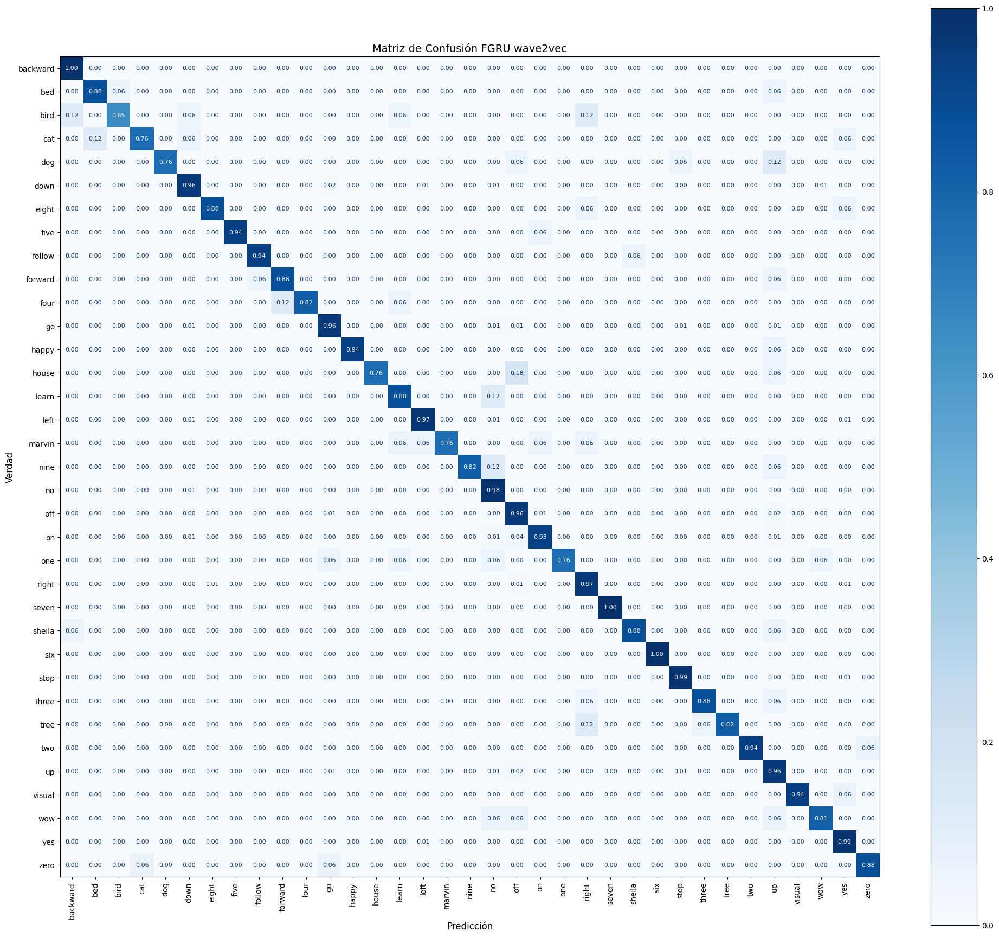

              precision    recall  f1-score   support

    backward       0.81      1.00      0.89        17
         bed       0.88      0.88      0.88        17
        bird       0.85      0.65      0.73        17
         cat       0.93      0.76      0.84        17
         dog       0.93      0.76      0.84        17
        down       0.96      0.96      0.96       396
       eight       0.88      0.88      0.88        17
        five       0.94      0.94      0.94        17
      follow       0.94      0.94      0.94        17
     forward       0.88      0.88      0.88        17
        four       1.00      0.82      0.90        17
          go       0.96      0.96      0.96       396
       happy       1.00      0.94      0.97        17
       house       1.00      0.76      0.87        17
       learn       0.79      0.88      0.83        17
        left       0.98      0.97      0.98       396
      marvin       1.00      0.76      0.87        17
        nine       0.93    

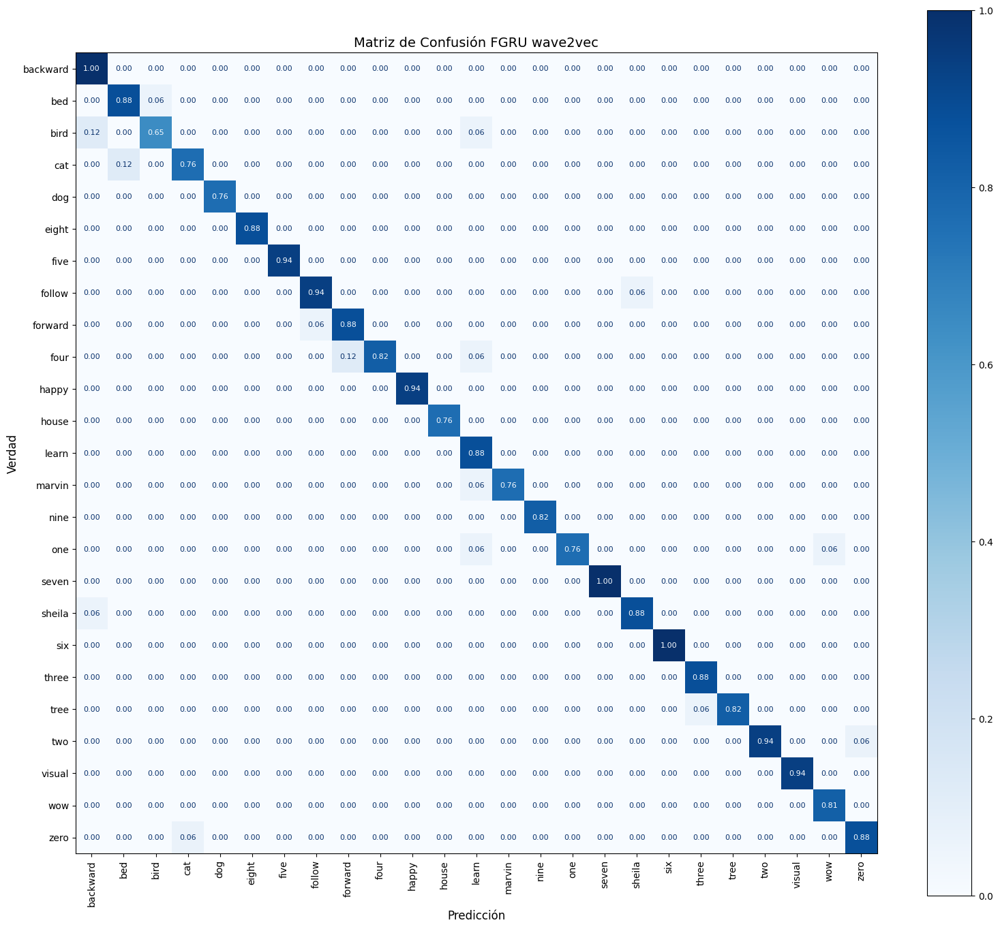

              precision    recall  f1-score   support

    backward       0.85      1.00      0.92        17
         bed       0.88      0.94      0.91        16
        bird       0.92      0.79      0.85        14
         cat       0.93      0.87      0.90        15
         dog       1.00      1.00      1.00        13
       eight       1.00      1.00      1.00        15
        five       1.00      1.00      1.00        16
      follow       0.94      0.94      0.94        17
     forward       0.88      0.94      0.91        16
        four       1.00      0.82      0.90        17
       happy       1.00      1.00      1.00        16
       house       1.00      1.00      1.00        13
       learn       0.79      1.00      0.88        15
      marvin       1.00      0.93      0.96        14
        nine       1.00      1.00      1.00        14
         one       1.00      0.87      0.93        15
       seven       1.00      1.00      1.00        17
      sheila       0.94    

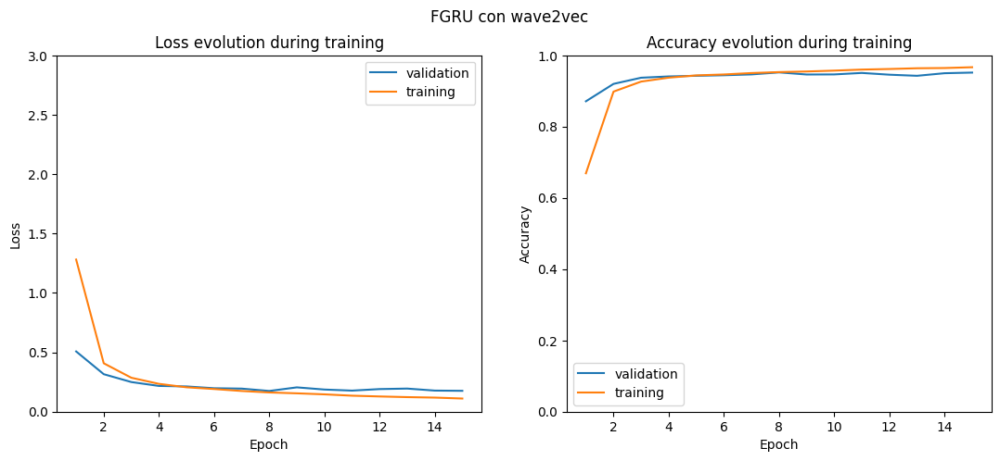

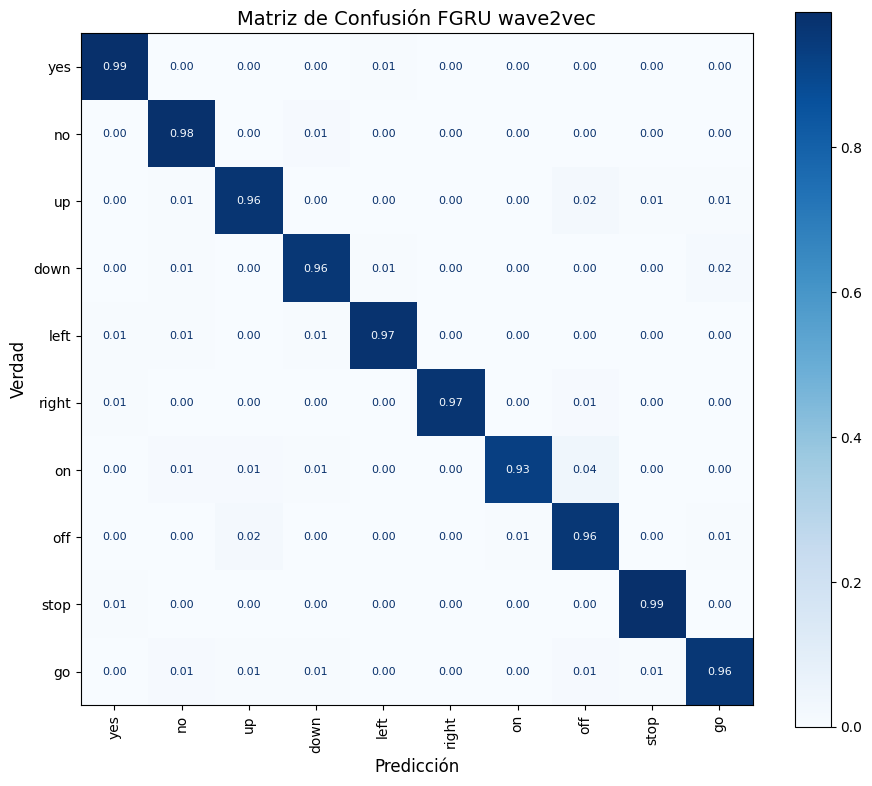

              precision    recall  f1-score   support

         yes       0.98      0.99      0.98       396
          no       0.96      0.98      0.97       394
          up       0.95      0.96      0.96       396
        down       0.96      0.97      0.96       392
        left       0.98      0.97      0.98       395
       right       0.99      0.97      0.98       393
          on       0.99      0.93      0.96       394
         off       0.92      0.96      0.94       396
        stop       0.98      0.99      0.99       396
          go       0.97      0.96      0.96       396

    accuracy                           0.97      3948
   macro avg       0.97      0.97      0.97      3948
weighted avg       0.97      0.97      0.97      3948

Precisión global (Accuracy): 0.9691
📁 Métricas guardadas en: metricas_FGRU_wave2vec_grandes.json


In [ ]:
from torch.utils.data import TensorDataset
import torch
import torch.nn as nn
import numpy as np
import os


device = "cuda" if torch.cuda.is_available() else "cpu"

X_train, y_train = load_all_batches_into_ram("wav2vec2_train_batches")
X_val, y_val     = load_all_batches_into_ram("wav2vec2_val_batches")
X_test, y_test   = load_all_batches_into_ram("wav2vec2_test_batches")

train_dl = DataLoader(TensorDataset(X_train, y_train), batch_size=64, shuffle=True)
val_dl   = DataLoader(TensorDataset(X_val,   y_val),   batch_size=64)
test_dl  = DataLoader(TensorDataset(X_test,  y_test),  batch_size=64)

# Función para obtener predicciones
@torch.no_grad()
def get_predictions(loader, model, device="cpu"):
    model = model.to(device)
    model.eval()
    all_predictions, all_true_labels = [], []
    for xb, yb in loader:
        xb, yb = xb.to(device), yb.to(device)
        pred = model(xb).argmax(1)
        all_predictions.extend(pred.cpu().numpy())
        all_true_labels.extend(yb.cpu().numpy())
    return np.array(all_true_labels), np.array(all_predictions)

# Loop de 5 iteraciones
accuracies = []

for i in range(5):
    print(f"\n========== Iteración {i+1}/3 ==========")
    model = FastGRU(num_classes=35).to(device)

    criterion = nn.CrossEntropyLoss()

    curves = train_model(
        model, train_dl, val_dl,
        epochs=40, lr=1e-3,
        criterion=criterion,
        device=device,
        early_stopping_patience=7
    )

    true_labels, predictions = get_predictions(test_dl, model, device)
    acc = (predictions == true_labels).mean() * 100
    accuracies.append(acc)
    print(f"✅ Precisión iteración {i+1}: {acc:.2f}%")

# Promedio y desviación estándar
mean_acc = np.mean(accuracies)
std_acc = np.std(accuracies)

print("\n===== Resultados finales =====")
print(f"Precisión promedio (5 runs): {mean_acc:.2f}% ± {std_acc:.2f}%")


torch.save(model.state_dict(), "modelo_FGru_wav2vec.pth")
print("Modelo final guardado")

# Matriz de confusión del último modelo entrenado
show_confusion_matrix(
    true_labels, predictions,
    clases_10,
    title=f"Matriz de Confusión FGRU wave2vec",
    filename="matriz_confusion_FGRU_wave2vec.png",
    metrics_filename="metricas_FGRU_wave2vec.json"
)

# Matriz de confusión del último modelo entrenado
show_confusion_matrix(
    true_labels, predictions,
    clases_10,
    title=f"Matriz de Confusión FGRU wave2vec",
    filename="matriz_confusion_FGRU_wave2vec_chicas.png",
    selected_classes = clases_chicas,
    metrics_filename="metricas_FGRU_wave2vec_chicas.json"
)
show_curves(curves, title="FGRU con wave2vec" , filename="Curva_FGRU_wave2vec.png")

# Matriz de confusión del último modelo entrenado
show_confusion_matrix(
    true_labels, predictions,
    clases_10,
    title=f"Matriz de Confusión FGRU wave2vec",
    filename="matriz_confusion_FGRU_wave2vec_grandes.png",
    selected_classes = clases_grandes,
    metrics_filename="metricas_FGRU_wave2vec_grandes.json"
)


#### T-CNN

In [ ]:
from torch.utils.data import TensorDataset
import torch
import torch.nn as nn
import numpy as np
import os

device = "cuda" if torch.cuda.is_available() else "cpu"

X_train, y_train = load_all_batches_into_ram("wav2vec2_train_batches")
X_val, y_val     = load_all_batches_into_ram("wav2vec2_val_batches")
X_test, y_test   = load_all_batches_into_ram("wav2vec2_test_batches")

train_dl = DataLoader(TensorDataset(X_train, y_train), batch_size=64, shuffle=True)
val_dl   = DataLoader(TensorDataset(X_val,   y_val),   batch_size=64)
test_dl  = DataLoader(TensorDataset(X_test,  y_test),  batch_size=64)



📥 Cargando batches desde: wav2vec2_train_batches
🔤 Etiquetas string detectadas: 35 clases
➡️ Cada batch: shape torch.Size([16, 49, 768])
➡️ Total de muestras: 32453
✅ Dataset cargado completamente en RAM
📥 Cargando batches desde: wav2vec2_val_batches
🔤 Etiquetas string detectadas: 35 clases
➡️ Cada batch: shape torch.Size([16, 49, 768])
➡️ Total de muestras: 3875
✅ Dataset cargado completamente en RAM
📥 Cargando batches desde: wav2vec2_test_batches
🔤 Etiquetas string detectadas: 35 clases
➡️ Cada batch: shape torch.Size([16, 49, 768])
➡️ Total de muestras: 4381
✅ Dataset cargado completamente en RAM



========== Iteración 1/3 ==========
Epoch 1/40
Iteration 84 - Batch 84/508 - Train loss: 1.3658, Train acc: 65.09%
Iteration 168 - Batch 168/508 - Train loss: 0.9799, Train acc: 74.74%
Iteration 252 - Batch 252/508 - Train loss: 0.8025, Train acc: 79.06%
Iteration 336 - Batch 336/508 - Train loss: 0.7061, Train acc: 81.47%
Iteration 420 - Batch 420/508 - Train loss: 0.6378, Train acc: 83.15%
Iteration 504 - Batch 504/508 - Train loss: 0.5835, Train acc: 84.52%
Val loss: 0.2429, Val acc: 93.47%
Epoch 2/40
Iteration 592 - Batch 84/508 - Train loss: 0.2813, Train acc: 92.26%
Iteration 676 - Batch 168/508 - Train loss: 0.2726, Train acc: 92.56%
Iteration 760 - Batch 252/508 - Train loss: 0.2704, Train acc: 92.51%
Iteration 844 - Batch 336/508 - Train loss: 0.2695, Train acc: 92.52%
Iteration 928 - Batch 420/508 - Train loss: 0.2623, Train acc: 92.70%
Iteration 1012 - Batch 504/508 - Train loss: 0.2606, Train acc: 92.75%
Val loss: 0.2229, Val acc: 94.04%
Epoch 3/40
Iteration 1100 - Batch 8

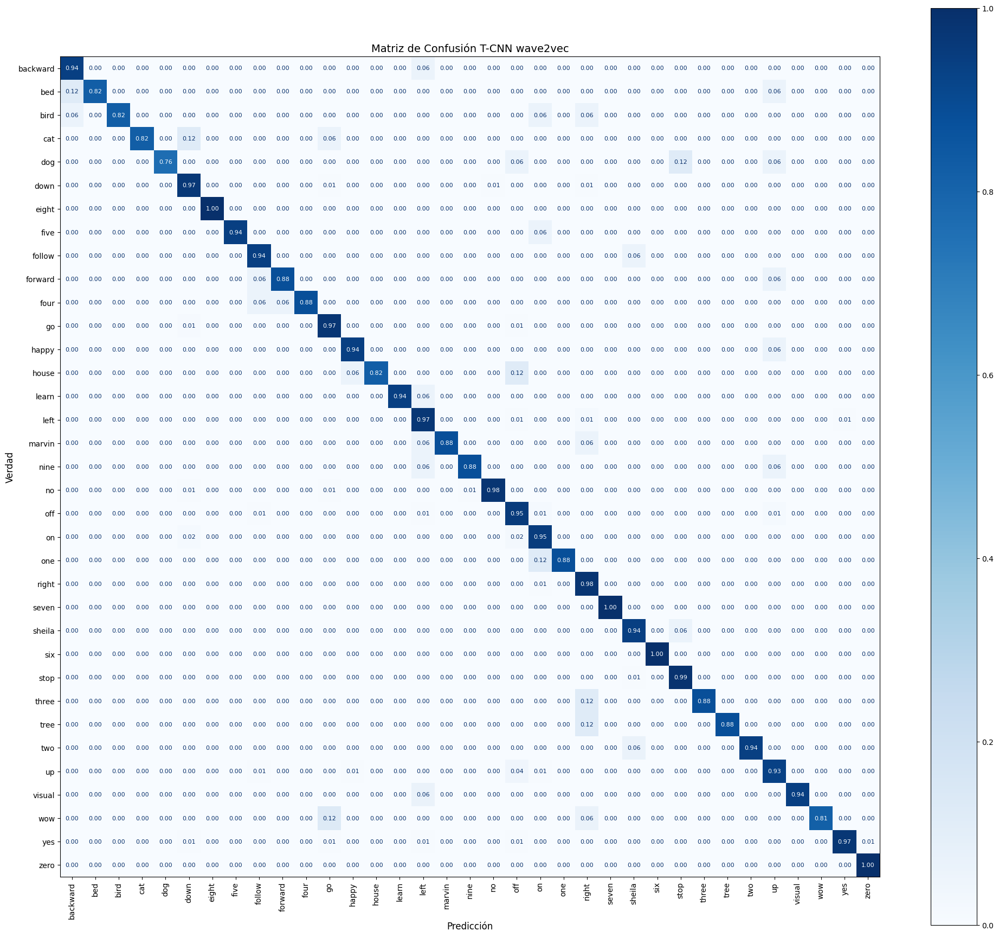

              precision    recall  f1-score   support

    backward       0.84      0.94      0.89        17
         bed       1.00      0.82      0.90        17
        bird       0.93      0.82      0.88        17
         cat       1.00      0.82      0.90        17
         dog       1.00      0.76      0.87        17
        down       0.95      0.97      0.96       396
       eight       1.00      1.00      1.00        17
        five       0.94      0.94      0.94        17
      follow       0.70      0.94      0.80        17
     forward       0.94      0.88      0.91        17
        four       1.00      0.88      0.94        17
          go       0.97      0.97      0.97       396
       happy       0.84      0.94      0.89        17
       house       0.93      0.82      0.88        17
       learn       0.94      0.94      0.94        17
        left       0.97      0.97      0.97       396
      marvin       1.00      0.88      0.94        17
        nine       0.88    

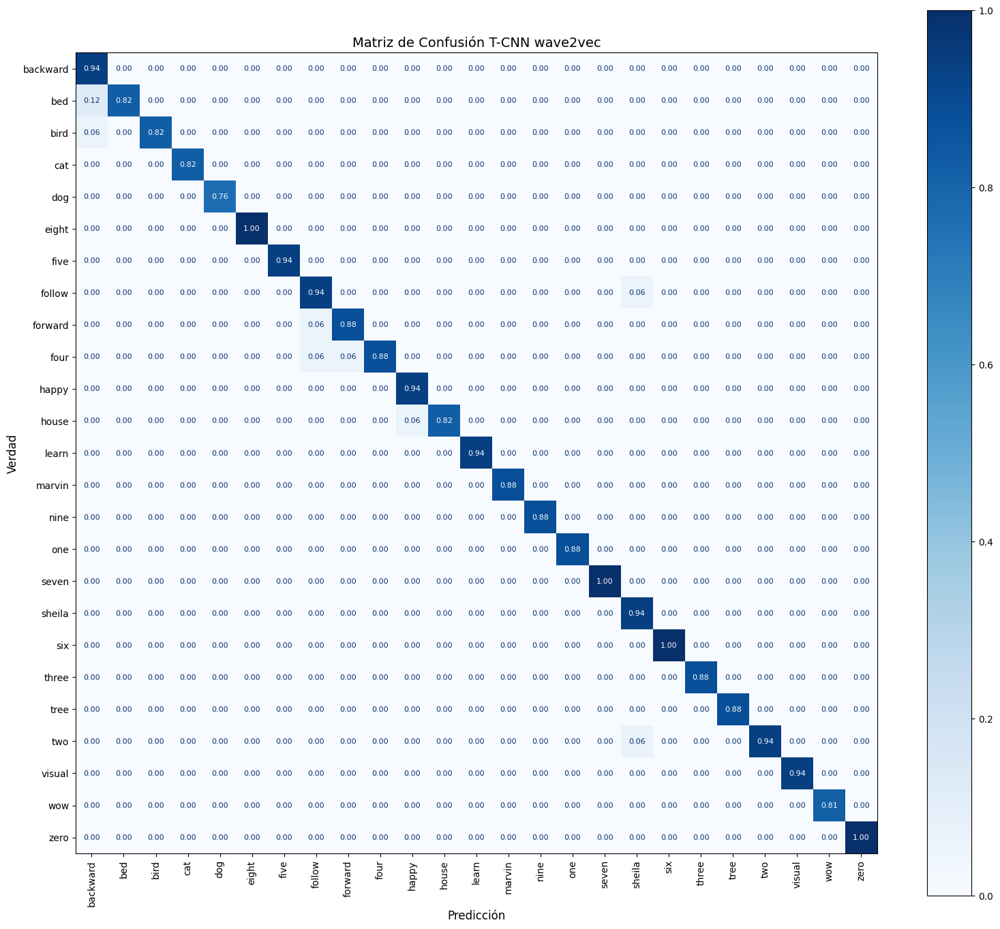

              precision    recall  f1-score   support

    backward       0.84      1.00      0.91        16
         bed       1.00      0.88      0.93        16
        bird       1.00      0.93      0.97        15
         cat       1.00      1.00      1.00        14
         dog       1.00      1.00      1.00        13
       eight       1.00      1.00      1.00        17
        five       1.00      1.00      1.00        16
      follow       0.89      0.94      0.91        17
     forward       0.94      0.94      0.94        16
        four       1.00      0.88      0.94        17
       happy       0.94      1.00      0.97        16
       house       1.00      0.93      0.97        15
       learn       1.00      1.00      1.00        16
      marvin       1.00      1.00      1.00        15
        nine       1.00      1.00      1.00        15
         one       1.00      1.00      1.00        15
       seven       1.00      1.00      1.00        17
      sheila       0.89    

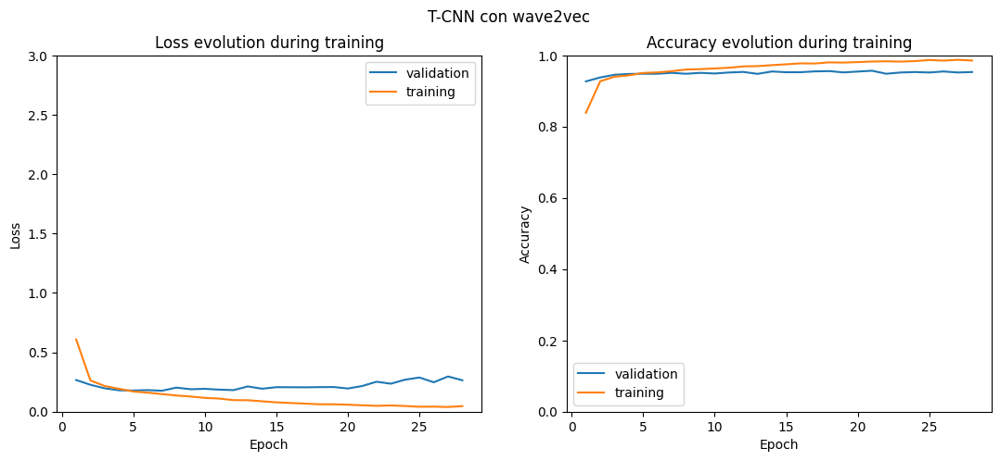

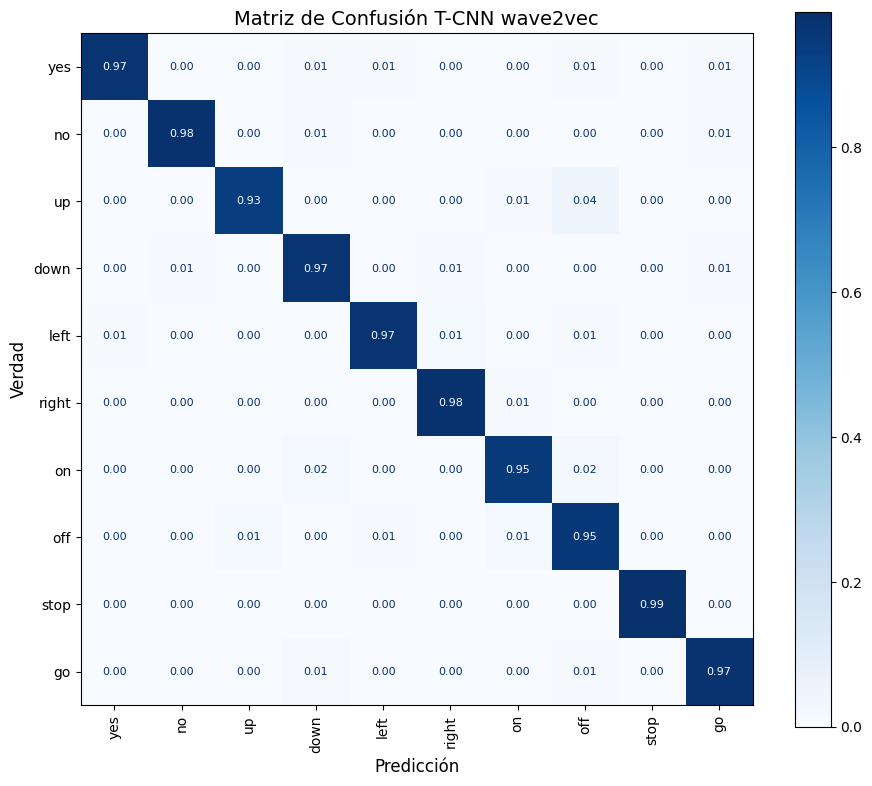

              precision    recall  f1-score   support

         yes       0.98      0.97      0.98       394
          no       0.98      0.98      0.98       393
          up       0.98      0.94      0.96       392
        down       0.96      0.97      0.96       394
        left       0.98      0.97      0.98       396
       right       0.98      0.99      0.98       392
          on       0.97      0.96      0.96       394
         off       0.92      0.96      0.94       393
        stop       0.99      0.99      0.99       394
          go       0.98      0.97      0.98       396

    accuracy                           0.97      3938
   macro avg       0.97      0.97      0.97      3938
weighted avg       0.97      0.97      0.97      3938

Precisión global (Accuracy): 0.9716
📁 Métricas guardadas en: metricas_T-CNN_wave2vec_grandes.json


In [ ]:
from torch.utils.data import TensorDataset
import torch
import torch.nn as nn
import numpy as np
import os

device = "cuda" if torch.cuda.is_available() else "cpu"

# Función para obtener predicciones
@torch.no_grad()
def get_predictions(loader, model, device="cpu"):
    model = model.to(device)
    model.eval()
    all_predictions, all_true_labels = [], []
    for xb, yb in loader:
        xb, yb = xb.to(device), yb.to(device)
        pred = model(xb).argmax(1)
        all_predictions.extend(pred.cpu().numpy())
        all_true_labels.extend(yb.cpu().numpy())
    return np.array(all_true_labels), np.array(all_predictions)

# Loop de 5 iteraciones
accuracies = []

for i in range(5):
    print(f"\n========== Iteración {i+1}/3 ==========")
    model = T_CNN(num_inputs=768,
        num_layers=2,
        channels_per_layer=256,
        kernel_size=3,
        n_classes=35,
        dropout=0.2,
        causal=True).to(device)

    criterion = nn.CrossEntropyLoss()

    curves = train_model(
        model, train_dl, val_dl,
        epochs=40, lr=1e-3,
        criterion=criterion,
        device=device,
        early_stopping_patience=7
    )

    true_labels, predictions = get_predictions(test_dl, model, device)
    acc = (predictions == true_labels).mean() * 100
    accuracies.append(acc)
    print(f"✅ Precisión iteración {i+1}: {acc:.2f}%")

# Promedio y desviación estándar
mean_acc = np.mean(accuracies)
std_acc = np.std(accuracies)

print("\n===== Resultados finales =====")
print(f"Precisión promedio (5 runs): {mean_acc:.2f}% ± {std_acc:.2f}%")

# Matriz de confusión del último modelo entrenado
show_confusion_matrix(
    true_labels, predictions,
    clases_10,
    title=f"Matriz de Confusión T-CNN wave2vec",
    filename="matriz_confusion_T-CNN_wave2vec.png",
    metrics_filename="metricas_T-CNN_wave2vec.json"
)

# Matriz de confusión del último modelo entrenado
show_confusion_matrix(
    true_labels, predictions,
    clases_10,
    title=f"Matriz de Confusión T-CNN wave2vec",
    filename="matriz_confusion_T-CNN_wave2vec_chicas.png",
    selected_classes = clases_chicas,
    metrics_filename="metricas_T-CNN_wave2vec_chicas.json"
)
show_curves(curves, title="T-CNN con wave2vec" , filename="Curva_T-CNN_wave2vec.png")

# Matriz de confusión del último modelo entrenado
show_confusion_matrix(
    true_labels, predictions,
    clases_10,
    title=f"Matriz de Confusión T-CNN wave2vec",
    filename="matriz_confusion_T-CNN_wave2vec_grandes.png",
    selected_classes = clases_grandes,
    metrics_filename="metricas_T-CNN_wave2vec_grandes.json"
)

#### GRU


========== Iteración 1/3 ==========
Epoch 1/40
Iteration 84 - Batch 84/508 - Train loss: 2.1033, Train acc: 50.06%
Iteration 168 - Batch 168/508 - Train loss: 1.4508, Train acc: 65.72%
Iteration 252 - Batch 252/508 - Train loss: 1.1475, Train acc: 72.41%
Iteration 336 - Batch 336/508 - Train loss: 0.9605, Train acc: 76.72%
Iteration 420 - Batch 420/508 - Train loss: 0.8371, Train acc: 79.75%
Iteration 504 - Batch 504/508 - Train loss: 0.7458, Train acc: 81.87%
Val loss: 0.2770, Val acc: 93.68%
Epoch 2/40
Iteration 592 - Batch 84/508 - Train loss: 0.2619, Train acc: 93.35%
Iteration 676 - Batch 168/508 - Train loss: 0.2575, Train acc: 93.32%
Iteration 760 - Batch 252/508 - Train loss: 0.2486, Train acc: 93.44%
Iteration 844 - Batch 336/508 - Train loss: 0.2384, Train acc: 93.71%
Iteration 928 - Batch 420/508 - Train loss: 0.2356, Train acc: 93.81%
Iteration 1012 - Batch 504/508 - Train loss: 0.2329, Train acc: 93.89%
Val loss: 0.2006, Val acc: 94.40%
Epoch 3/40
Iteration 1100 - Batch 8

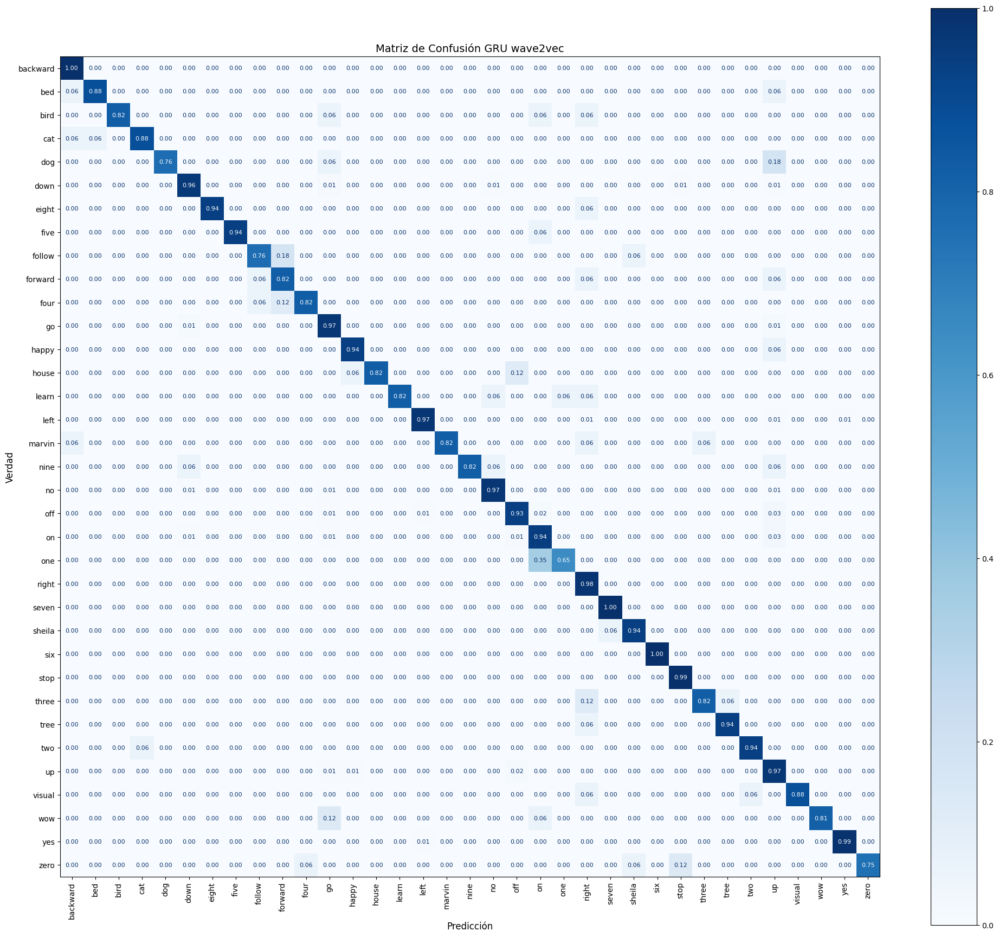

              precision    recall  f1-score   support

    backward       0.85      1.00      0.92        17
         bed       0.94      0.88      0.91        17
        bird       0.93      0.82      0.88        17
         cat       0.88      0.88      0.88        17
         dog       0.93      0.76      0.84        17
        down       0.97      0.96      0.97       396
       eight       1.00      0.94      0.97        17
        five       0.94      0.94      0.94        17
      follow       0.87      0.76      0.81        17
     forward       0.70      0.82      0.76        17
        four       0.93      0.82      0.88        17
          go       0.95      0.97      0.96       396
       happy       0.84      0.94      0.89        17
       house       1.00      0.82      0.90        17
       learn       0.88      0.82      0.85        17
        left       0.98      0.97      0.98       396
      marvin       0.93      0.82      0.88        17
        nine       1.00    

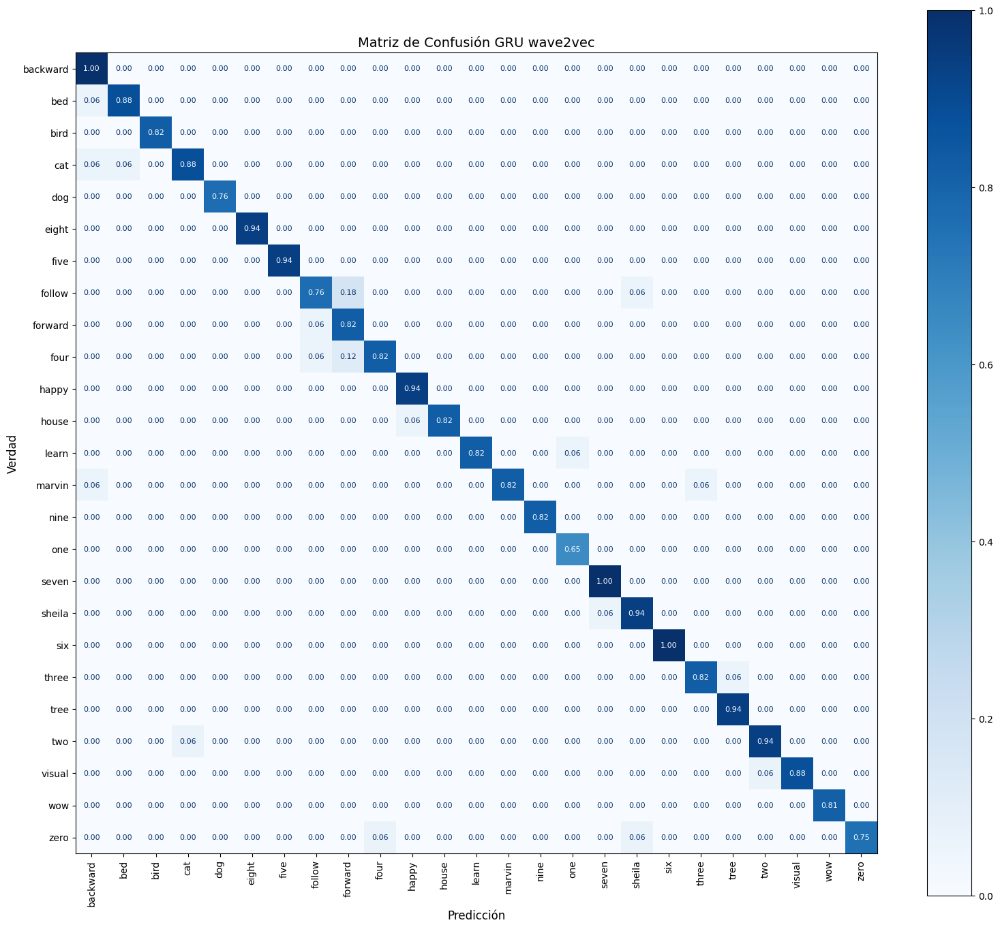

              precision    recall  f1-score   support

    backward       0.85      1.00      0.92        17
         bed       0.94      0.94      0.94        16
        bird       1.00      1.00      1.00        14
         cat       0.94      0.88      0.91        17
         dog       1.00      1.00      1.00        13
       eight       1.00      1.00      1.00        16
        five       1.00      1.00      1.00        16
      follow       0.87      0.76      0.81        17
     forward       0.74      0.93      0.82        15
        four       0.93      0.82      0.88        17
       happy       0.94      1.00      0.97        16
       house       1.00      0.93      0.97        15
       learn       1.00      0.93      0.97        15
      marvin       1.00      0.88      0.93        16
        nine       1.00      1.00      1.00        14
         one       0.92      1.00      0.96        11
       seven       0.94      1.00      0.97        17
      sheila       0.89    

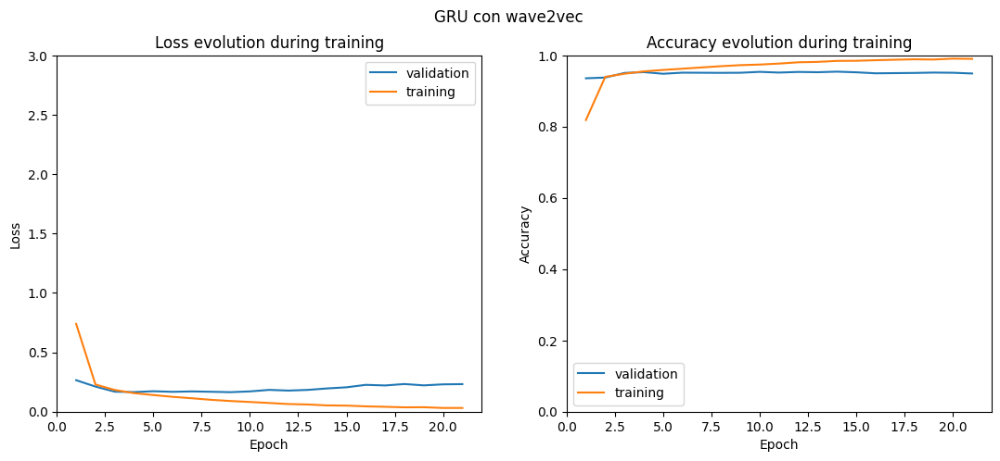

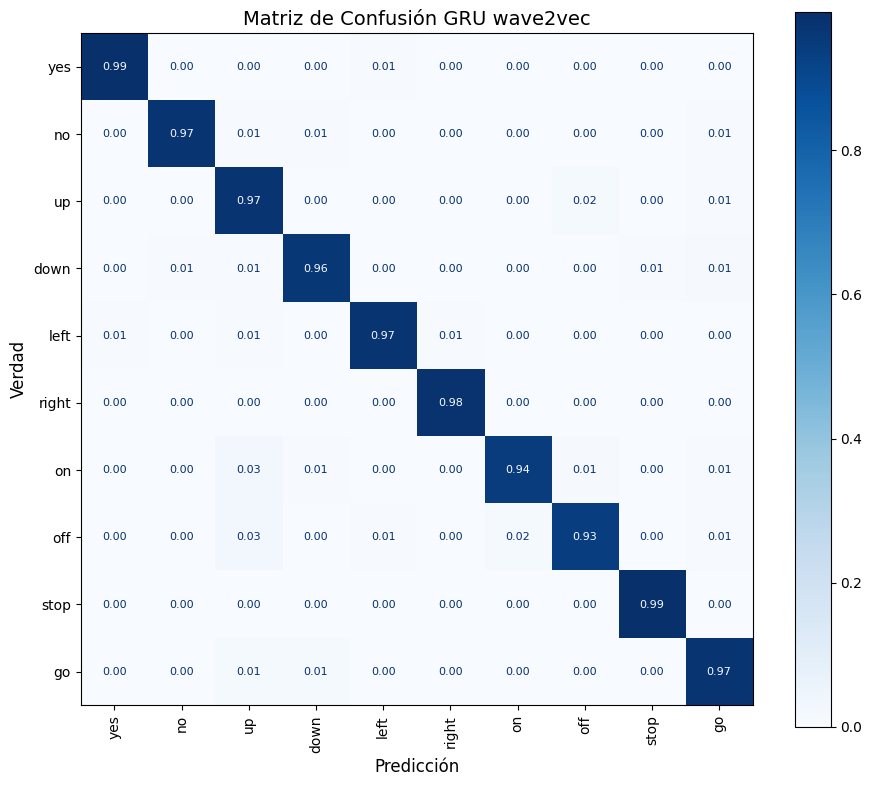

              precision    recall  f1-score   support

         yes       0.99      0.99      0.99       396
          no       0.99      0.98      0.98       395
          up       0.92      0.98      0.95       394
        down       0.97      0.97      0.97       395
        left       0.98      0.98      0.98       395
       right       0.99      0.99      0.99       391
          on       0.98      0.95      0.96       395
         off       0.97      0.94      0.95       395
        stop       0.98      0.99      0.99       395
          go       0.96      0.97      0.96       396

    accuracy                           0.97      3947
   macro avg       0.97      0.97      0.97      3947
weighted avg       0.97      0.97      0.97      3947

Precisión global (Accuracy): 0.9726
📁 Métricas guardadas en: metricas_GRU_wave2vec_grandes.json


In [ ]:
from torch.utils.data import TensorDataset
import torch
import torch.nn as nn
import numpy as np
import os

device = "cuda" if torch.cuda.is_available() else "cpu"


# Función para obtener predicciones
@torch.no_grad()
def get_predictions(loader, model, device="cpu"):
    model = model.to(device)
    model.eval()
    all_predictions, all_true_labels = [], []
    for xb, yb in loader:
        xb, yb = xb.to(device), yb.to(device)
        pred = model(xb).argmax(1)
        all_predictions.extend(pred.cpu().numpy())
        all_true_labels.extend(yb.cpu().numpy())
    return np.array(all_true_labels), np.array(all_predictions)

# Loop de 5 iteraciones
accuracies = []

for i in range(5):
    print(f"\n========== Iteración {i+1}/3 ==========")
    model = GRUModel(
        input_size=768,
        hidden_size=128,
        num_layers=1,
        bidirectional=False,
        num_classes=35
    ).to(device)

    criterion = nn.CrossEntropyLoss()

    curves = train_model(
        model, train_dl, val_dl,
        epochs=40, lr=1e-3,
        criterion=criterion,
        device=device,
        early_stopping_patience=7
    )

    true_labels, predictions = get_predictions(test_dl, model, device)
    acc = (predictions == true_labels).mean() * 100
    accuracies.append(acc)
    print(f"✅ Precisión iteración {i+1}: {acc:.2f}%")

# Promedio y desviación estándar
mean_acc = np.mean(accuracies)
std_acc = np.std(accuracies)

print("\n===== Resultados finales =====")
print(f"Precisión promedio (5 runs): {mean_acc:.2f}% ± {std_acc:.2f}%")

# Matriz de confusión del último modelo entrenado
show_confusion_matrix(
    true_labels, predictions,
    clases_10,
    title=f"Matriz de Confusión GRU wave2vec",
    filename="matriz_confusion_GRU_wave2vec.png",
    metrics_filename="metricas_GRU_wave2vec.json"
)

# Matriz de confusión del último modelo entrenado
show_confusion_matrix(
    true_labels, predictions,
    clases_10,
    title=f"Matriz de Confusión GRU wave2vec",
    filename="matriz_confusion_GRU_wave2vec_chicas.png",
    selected_classes = clases_chicas,
    metrics_filename="metricas_GRU_wave2vec_chicas.json"
)
show_curves(curves, title="GRU con wave2vec" , filename="Curva_GRU_wave2vec.png")

# Matriz de confusión del último modelo entrenado
show_confusion_matrix(
    true_labels, predictions,
    clases_10,
    title=f"Matriz de Confusión GRU wave2vec",
    filename="matriz_confusion_GRU_wave2vec_grandes.png",
    selected_classes = clases_grandes,
    metrics_filename="metricas_GRU_wave2vec_grandes.json"
)

#### LSTM


========== Iteración 1/3 ==========
Epoch 1/40
Iteration 84 - Batch 84/508 - Train loss: 2.0038, Train acc: 55.59%
Iteration 168 - Batch 168/508 - Train loss: 1.5131, Train acc: 66.80%
Iteration 252 - Batch 252/508 - Train loss: 1.2584, Train acc: 71.75%
Iteration 336 - Batch 336/508 - Train loss: 1.0901, Train acc: 75.02%
Iteration 420 - Batch 420/508 - Train loss: 0.9758, Train acc: 77.33%
Iteration 504 - Batch 504/508 - Train loss: 0.8910, Train acc: 79.16%
Val loss: 0.4264, Val acc: 89.81%
Epoch 2/40
Iteration 592 - Batch 84/508 - Train loss: 0.3960, Train acc: 90.28%
Iteration 676 - Batch 168/508 - Train loss: 0.3677, Train acc: 90.87%
Iteration 760 - Batch 252/508 - Train loss: 0.3543, Train acc: 91.30%
Iteration 844 - Batch 336/508 - Train loss: 0.3387, Train acc: 91.69%
Iteration 928 - Batch 420/508 - Train loss: 0.3310, Train acc: 91.82%
Iteration 1012 - Batch 504/508 - Train loss: 0.3186, Train acc: 92.07%
Val loss: 0.2399, Val acc: 93.57%
Epoch 3/40
Iteration 1100 - Batch 8

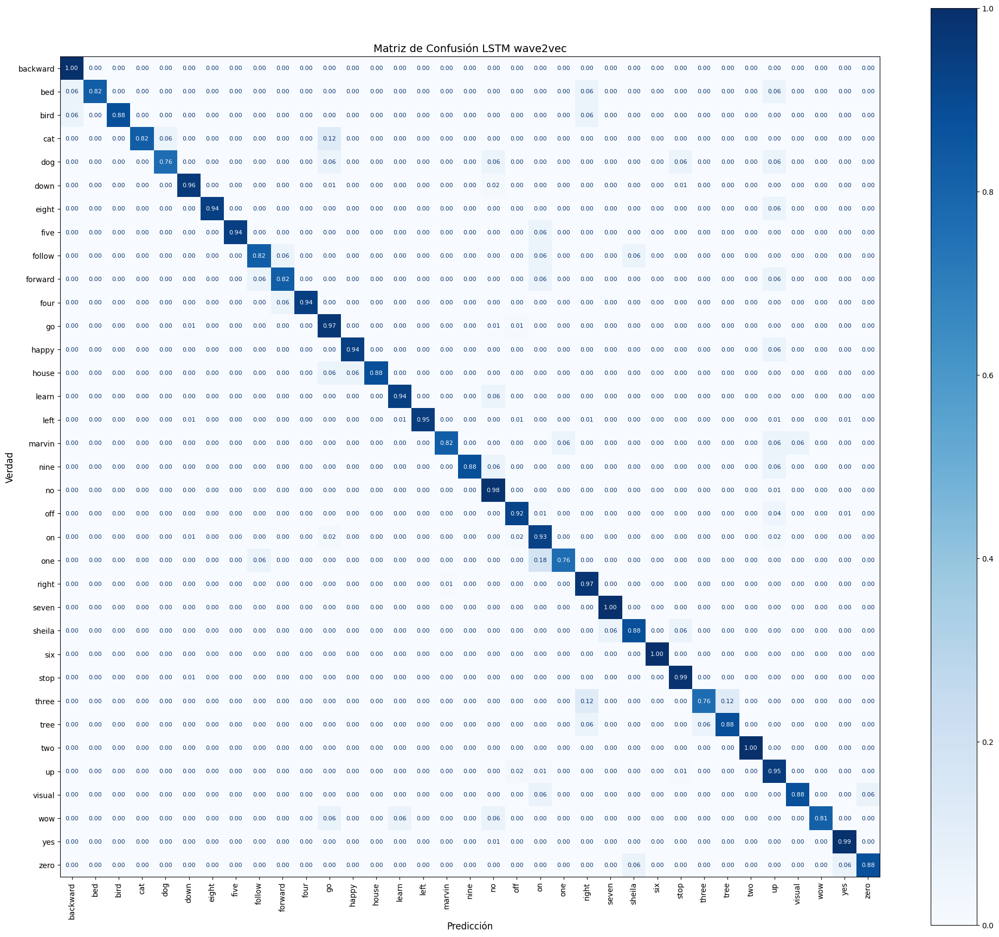

              precision    recall  f1-score   support

    backward       0.89      1.00      0.94        17
         bed       1.00      0.82      0.90        17
        bird       1.00      0.88      0.94        17
         cat       1.00      0.82      0.90        17
         dog       0.81      0.76      0.79        17
        down       0.97      0.96      0.96       396
       eight       1.00      0.94      0.97        17
        five       0.94      0.94      0.94        17
      follow       0.74      0.82      0.78        17
     forward       0.88      0.82      0.85        17
        four       0.89      0.94      0.91        17
          go       0.96      0.97      0.96       396
       happy       0.94      0.94      0.94        17
       house       0.94      0.88      0.91        17
       learn       0.76      0.94      0.84        17
        left       0.99      0.95      0.97       396
      marvin       0.82      0.82      0.82        17
        nine       0.94    

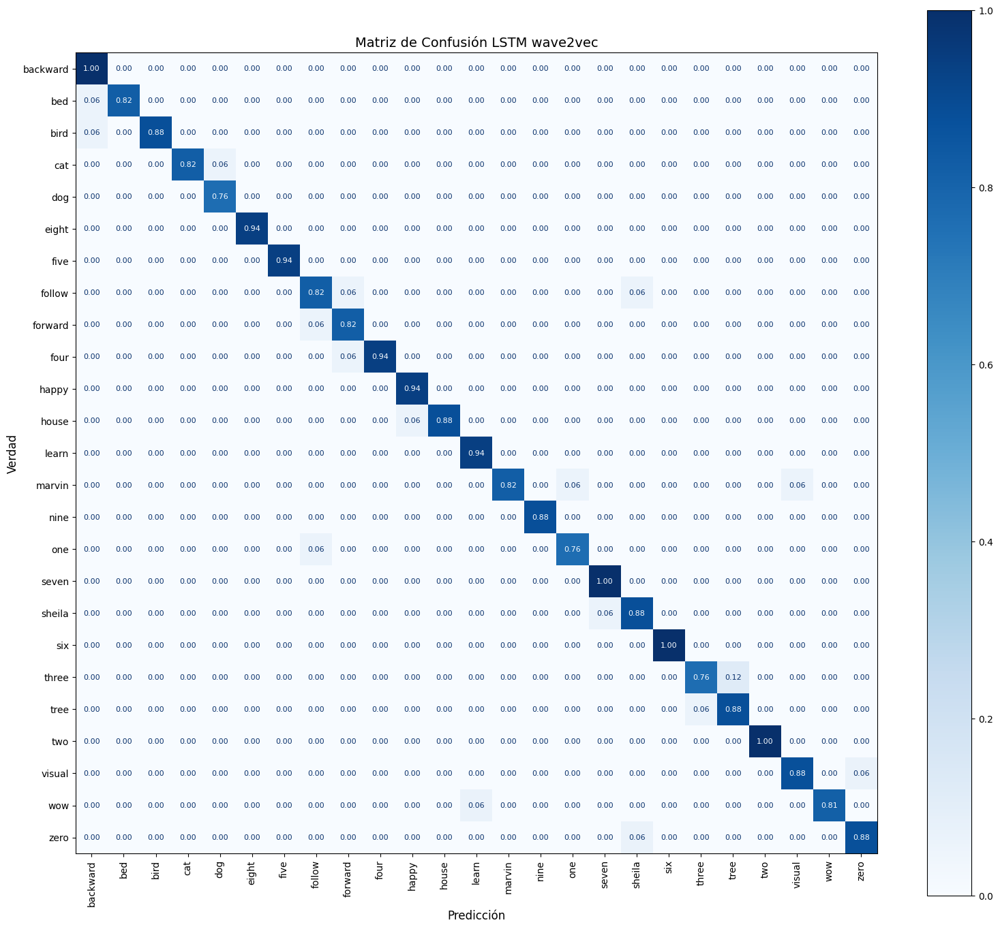

              precision    recall  f1-score   support

    backward       0.89      1.00      0.94        17
         bed       1.00      0.93      0.97        15
        bird       1.00      0.94      0.97        16
         cat       1.00      0.93      0.97        15
         dog       0.93      1.00      0.96        13
       eight       1.00      1.00      1.00        16
        five       1.00      1.00      1.00        16
      follow       0.88      0.88      0.88        16
     forward       0.88      0.93      0.90        15
        four       1.00      0.94      0.97        17
       happy       0.94      1.00      0.97        16
       house       1.00      0.94      0.97        16
       learn       0.94      1.00      0.97        16
      marvin       1.00      0.88      0.93        16
        nine       1.00      1.00      1.00        15
         one       0.93      0.93      0.93        14
       seven       0.94      1.00      0.97        17
      sheila       0.88    

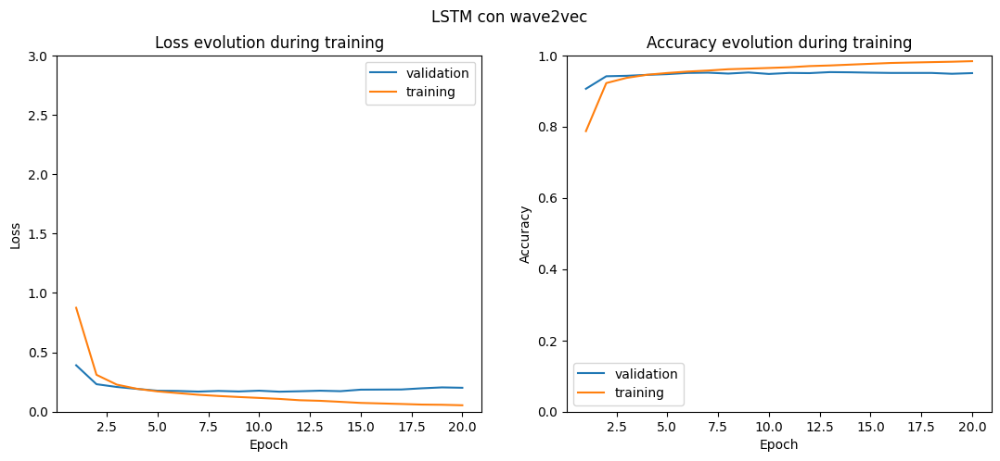

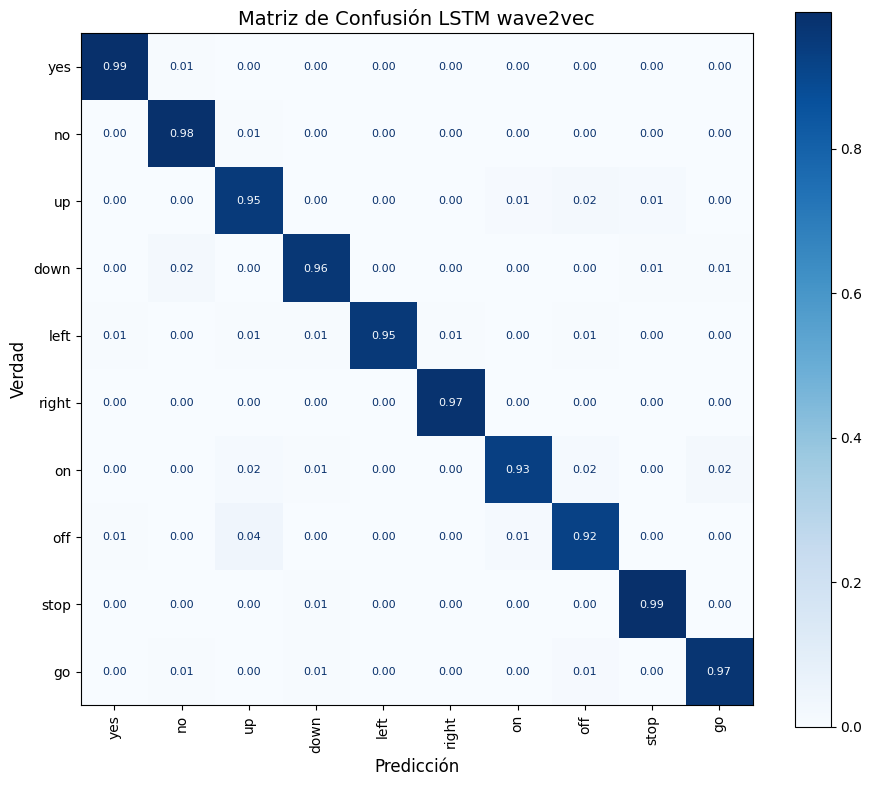

              precision    recall  f1-score   support

         yes       0.98      0.99      0.99       396
          no       0.97      0.99      0.98       393
          up       0.93      0.95      0.94       395
        down       0.97      0.96      0.97       395
        left       0.99      0.97      0.98       390
       right       0.99      0.99      0.99       389
          on       0.97      0.94      0.96       393
         off       0.95      0.93      0.94       393
        stop       0.97      0.99      0.98       393
          go       0.97      0.97      0.97       396

    accuracy                           0.97      3933
   macro avg       0.97      0.97      0.97      3933
weighted avg       0.97      0.97      0.97      3933

Precisión global (Accuracy): 0.9687
📁 Métricas guardadas en: metricas_LSTM_wave2vec_grandes.json


In [ ]:
from torch.utils.data import TensorDataset
import torch
import torch.nn as nn
import numpy as np
import os

device = "cuda" if torch.cuda.is_available() else "cpu"


# Función para obtener predicciones
@torch.no_grad()
def get_predictions(loader, model, device="cpu"):
    model = model.to(device)
    model.eval()
    all_predictions, all_true_labels = [], []
    for xb, yb in loader:
        xb, yb = xb.to(device), yb.to(device)
        pred = model(xb).argmax(1)
        all_predictions.extend(pred.cpu().numpy())
        all_true_labels.extend(yb.cpu().numpy())
    return np.array(all_true_labels), np.array(all_predictions)

# Loop de 5 iteraciones
accuracies = []

for i in range(5):
    print(f"\n========== Iteración {i+1}/3 ==========")
    model = LSTMModel(
        input_size=768,
        hidden_size=128,
        num_layers=1,
        bidirectional=False,
        num_classes=35
    ).to(device)

    criterion = nn.CrossEntropyLoss()

    curves = train_model(
        model, train_dl, val_dl,
        epochs=40, lr=1e-3,
        criterion=criterion,
        device=device,
        early_stopping_patience=7
    )

    true_labels, predictions = get_predictions(test_dl, model, device)
    acc = (predictions == true_labels).mean() * 100
    accuracies.append(acc)
    print(f"✅ Precisión iteración {i+1}: {acc:.2f}%")

# Promedio y desviación estándar
mean_acc = np.mean(accuracies)
std_acc = np.std(accuracies)

print("\n===== Resultados finales =====")
print(f"Precisión promedio (5 runs): {mean_acc:.2f}% ± {std_acc:.2f}%")

# Matriz de confusión del último modelo entrenado
show_confusion_matrix(
    true_labels, predictions,
    clases_10,
    title=f"Matriz de Confusión LSTM wave2vec",
    filename="matriz_confusion_LSTM_wave2vec.png",
    metrics_filename="metricas_LSTM_wave2vec.json"
)

# Matriz de confusión del último modelo entrenado
show_confusion_matrix(
    true_labels, predictions,
    clases_10,
    title=f"Matriz de Confusión LSTM wave2vec",
    filename="matriz_confusion_LSTM_wave2vec_chicas.png",
    selected_classes = clases_chicas,
    metrics_filename="metricas_LSTM_wave2vec_chicas.json"
)
show_curves(curves, title="LSTM con wave2vec" , filename="Curva_LSTM_wave2vec.png")

# Matriz de confusión del último modelo entrenado
show_confusion_matrix(
    true_labels, predictions,
    clases_10,
    title=f"Matriz de Confusión LSTM wave2vec",
    filename="matriz_confusion_LSTM_wave2vec_grandes.png",
    selected_classes = clases_grandes,
    metrics_filename="metricas_LSTM_wave2vec_grandes.json"
)

#### Gru bidireccional


========== Iteración 1/3 ==========
Epoch 1/40
Iteration 84 - Batch 84/508 - Train loss: 2.1183, Train acc: 46.89%
Iteration 168 - Batch 168/508 - Train loss: 1.5778, Train acc: 62.25%
Iteration 252 - Batch 252/508 - Train loss: 1.2834, Train acc: 69.27%
Iteration 336 - Batch 336/508 - Train loss: 1.1069, Train acc: 73.20%
Iteration 420 - Batch 420/508 - Train loss: 0.9850, Train acc: 75.98%
Iteration 504 - Batch 504/508 - Train loss: 0.8953, Train acc: 78.13%
Val loss: 0.3841, Val acc: 91.02%
Epoch 2/40
Iteration 592 - Batch 84/508 - Train loss: 0.3798, Train acc: 90.79%
Iteration 676 - Batch 168/508 - Train loss: 0.3534, Train acc: 91.33%
Iteration 760 - Batch 252/508 - Train loss: 0.3395, Train acc: 91.56%
Iteration 844 - Batch 336/508 - Train loss: 0.3277, Train acc: 91.88%
Iteration 928 - Batch 420/508 - Train loss: 0.3194, Train acc: 92.01%
Iteration 1012 - Batch 504/508 - Train loss: 0.3114, Train acc: 92.13%
Val loss: 0.2447, Val acc: 93.68%
Epoch 3/40
Iteration 1100 - Batch 8

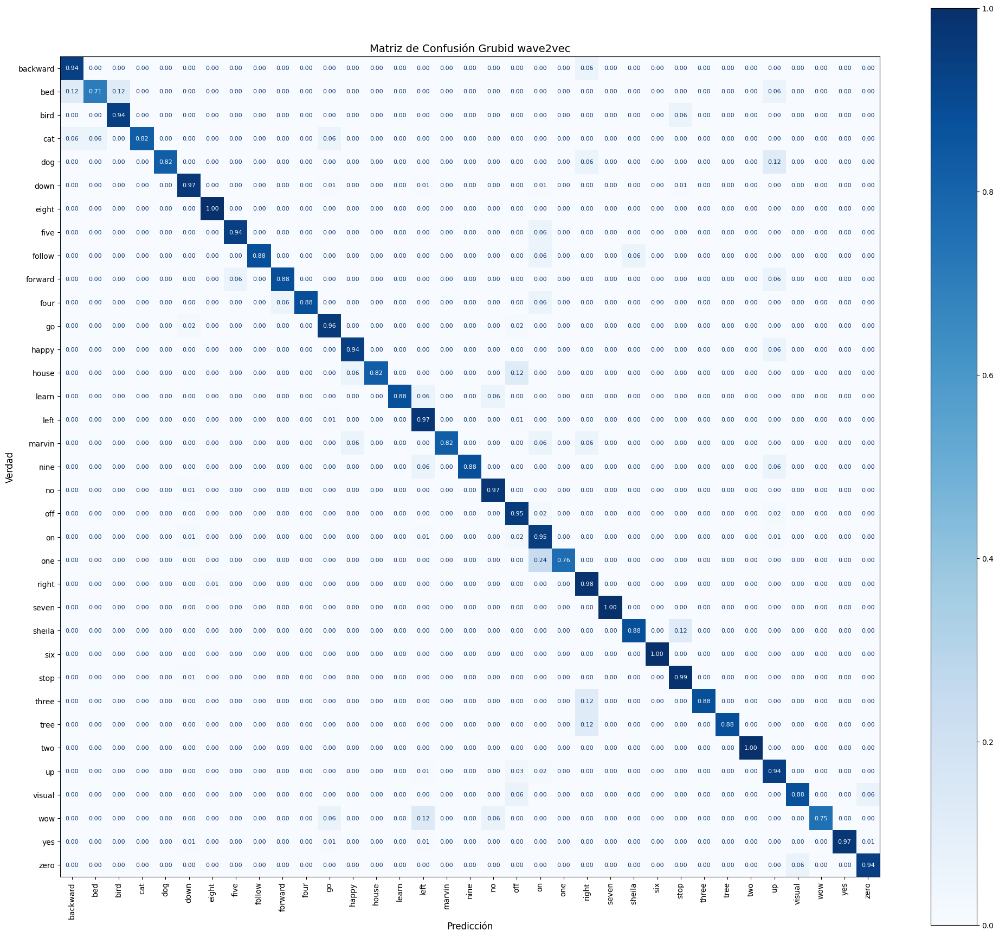

              precision    recall  f1-score   support

    backward       0.84      0.94      0.89        17
         bed       0.92      0.71      0.80        17
        bird       0.89      0.94      0.91        17
         cat       1.00      0.82      0.90        17
         dog       0.93      0.82      0.88        17
        down       0.95      0.97      0.96       396
       eight       0.85      1.00      0.92        17
        five       0.89      0.94      0.91        17
      follow       1.00      0.88      0.94        17
     forward       0.88      0.88      0.88        17
        four       1.00      0.88      0.94        17
          go       0.96      0.96      0.96       396
       happy       0.89      0.94      0.91        17
       house       1.00      0.82      0.90        17
       learn       1.00      0.88      0.94        17
        left       0.96      0.97      0.97       396
      marvin       1.00      0.82      0.90        17
        nine       0.88    

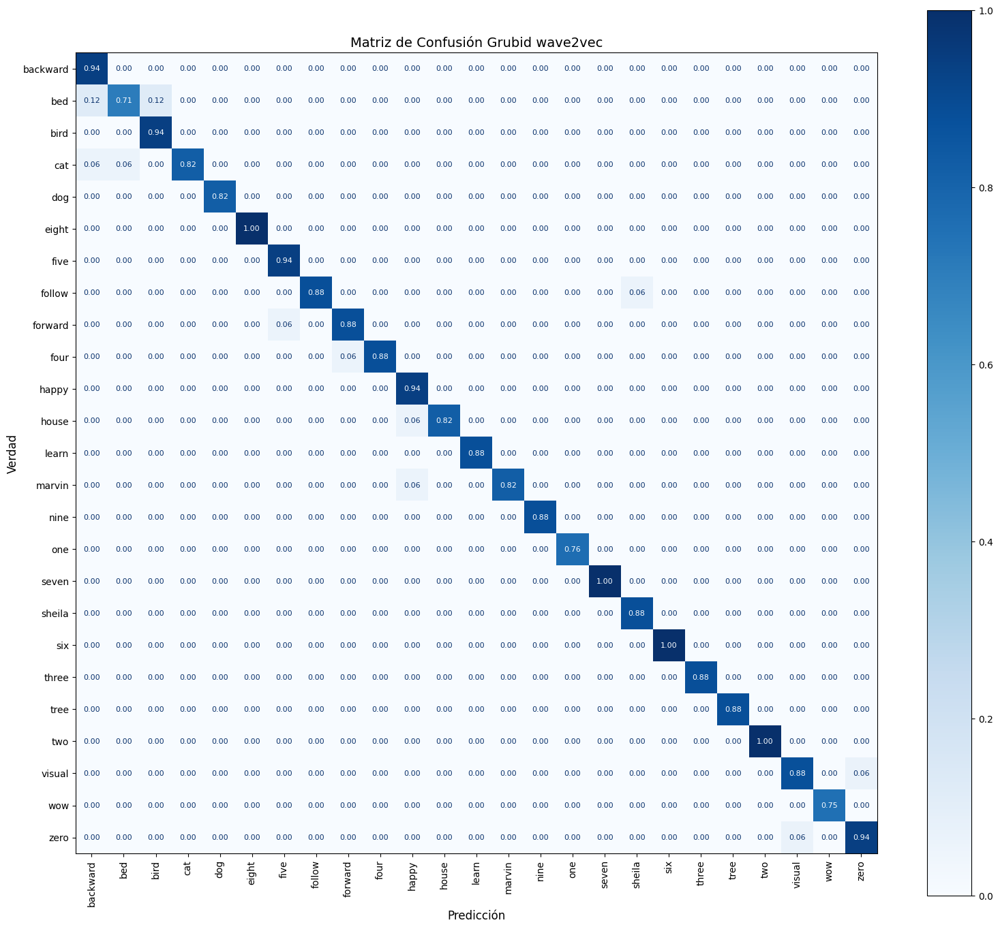

              precision    recall  f1-score   support

    backward       0.84      1.00      0.91        16
         bed       0.92      0.75      0.83        16
        bird       0.89      1.00      0.94        16
         cat       1.00      0.88      0.93        16
         dog       1.00      1.00      1.00        14
       eight       1.00      1.00      1.00        17
        five       0.94      1.00      0.97        16
      follow       1.00      0.94      0.97        16
     forward       0.94      0.94      0.94        16
        four       1.00      0.94      0.97        16
       happy       0.89      1.00      0.94        16
       house       1.00      0.93      0.97        15
       learn       1.00      1.00      1.00        15
      marvin       1.00      0.93      0.97        15
        nine       1.00      1.00      1.00        15
         one       1.00      1.00      1.00        13
       seven       1.00      1.00      1.00        17
      sheila       0.94    

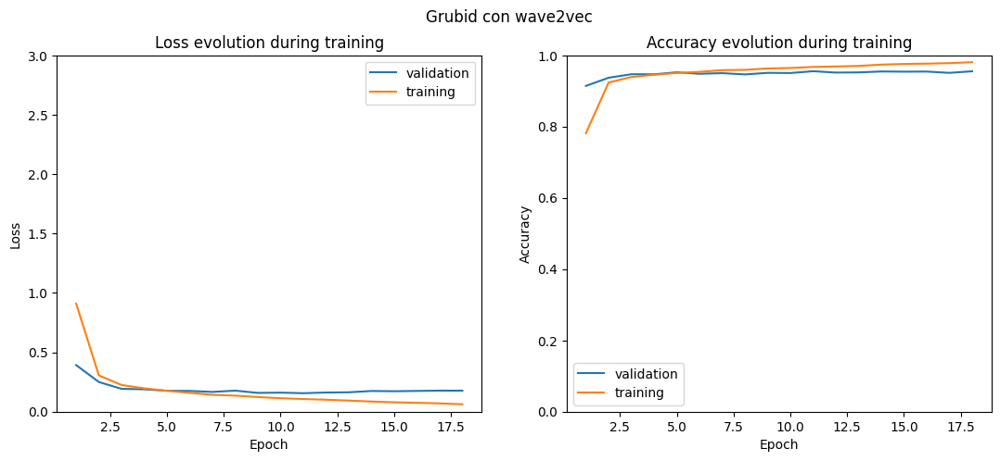

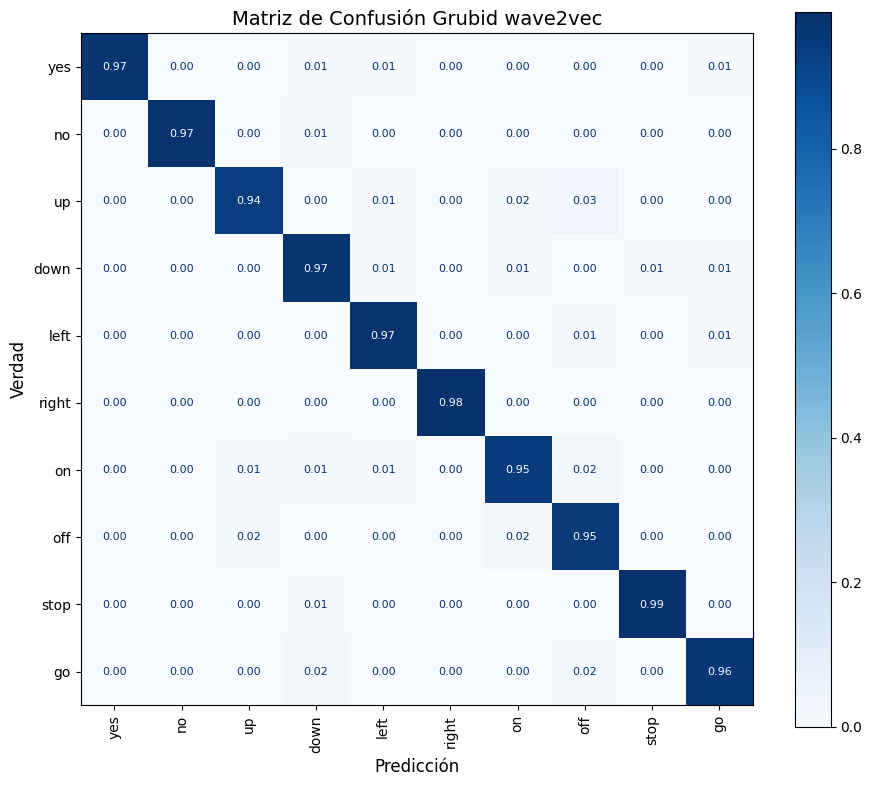

              precision    recall  f1-score   support

         yes       1.00      0.97      0.99       394
          no       0.99      0.98      0.98       394
          up       0.97      0.94      0.96       395
        down       0.95      0.97      0.96       396
        left       0.97      0.98      0.98       394
       right       0.99      0.99      0.99       393
          on       0.95      0.95      0.95       395
         off       0.92      0.96      0.94       395
        stop       0.99      0.99      0.99       395
          go       0.97      0.96      0.96       396

    accuracy                           0.97      3947
   macro avg       0.97      0.97      0.97      3947
weighted avg       0.97      0.97      0.97      3947

Precisión global (Accuracy): 0.9696
📁 Métricas guardadas en: metricas_Grubid_wave2vec_grandes.json


In [ ]:
from torch.utils.data import TensorDataset
import torch
import torch.nn as nn
import numpy as np
import os

device = "cuda" if torch.cuda.is_available() else "cpu"

# Función para obtener predicciones
@torch.no_grad()
def get_predictions(loader, model, device="cpu"):
    model = model.to(device)
    model.eval()
    all_predictions, all_true_labels = [], []
    for xb, yb in loader:
        xb, yb = xb.to(device), yb.to(device)
        pred = model(xb).argmax(1)
        all_predictions.extend(pred.cpu().numpy())
        all_true_labels.extend(yb.cpu().numpy())
    return np.array(all_true_labels), np.array(all_predictions)

# Loop de 5 iteraciones
accuracies = []

for i in range(5):
    print(f"\n========== Iteración {i+1}/3 ==========")
    model = LSTMModel(
        input_size=768,
        hidden_size=128,
        num_layers=1,
        bidirectional=False,
        num_classes=35
    ).to(device)

    criterion = nn.CrossEntropyLoss()

    curves = train_model(
        model, train_dl, val_dl,
        epochs=40, lr=1e-3,
        criterion=criterion,
        device=device,
        early_stopping_patience=7
    )

    true_labels, predictions = get_predictions(test_dl, model, device)
    acc = (predictions == true_labels).mean() * 100
    accuracies.append(acc)
    print(f"✅ Precisión iteración {i+1}: {acc:.2f}%")

# Promedio y desviación estándar
mean_acc = np.mean(accuracies)
std_acc = np.std(accuracies)

print("\n===== Resultados finales =====")
print(f"Precisión promedio (5 runs): {mean_acc:.2f}% ± {std_acc:.2f}%")

# Matriz de confusión del último modelo entrenado
show_confusion_matrix(
    true_labels, predictions,
    clases_10,
    title=f"Matriz de Confusión Grubid wave2vec",
    filename="matriz_confusion_Grubid_wave2vec.png",
    metrics_filename="metricas_Grubid_wave2vec.json"
)

# Matriz de confusión del último modelo entrenado
show_confusion_matrix(
    true_labels, predictions,
    clases_10,
    title=f"Matriz de Confusión Grubid wave2vec",
    filename="matriz_confusion_Grubid_wave2vec_chicas.png",
    selected_classes = clases_chicas,
    metrics_filename="metricas_Grubid_wave2vec_chicas.json"
)
show_curves(curves, title="Grubid con wave2vec" , filename="Curva_Grubid_wave2vec.png")

# Matriz de confusión del último modelo entrenado
show_confusion_matrix(
    true_labels, predictions,
    clases_10,
    title=f"Matriz de Confusión Grubid wave2vec",
    filename="matriz_confusion_Grubid_wave2vec_grandes.png",
    selected_classes = clases_grandes,
    metrics_filename="metricas_Grubid_wave2vec_grandes.json"
)